In [1]:
import scipy.io
import numpy as np
import itertools
from scipy.signal import butter, lfilter
from scipy.fftpack import fft, fftfreq
from random import randint
import scipy.signal
import pandas as pd
import time
from math import sqrt
import xarray as xr
from pprint import pprint
from functools import reduce
from matplotlib import pyplot as plt
from IPython.display import display, Markdown
import math
import pylab
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import KFold
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler, PolynomialFeatures
from sklearn import metrics, preprocessing 
from sklearn.svm import SVC 
from sklearn import neighbors
from sklearn.metrics import precision_recall_fscore_support
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score, mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_error
from sklearn import tree
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
import xlwt
from xlrd import open_workbook
from openpyxl import load_workbook
import xlrd
import xlutils
from xlutils.copy import copy
plt.rcParams['figure.figsize'] = (16, 9)
plt.style.use('ggplot')

## Define Function

In [2]:
def my_r2_score(v_true, v_pred):
    ssres = np.sum(np.square(v_true - v_pred))
    sstot = np.sum(np.square(v_true - np.mean(v_true)))
    return 1 - ssres / sstot
def curve_fitting(data):
    if len(data.shape) == 3:
        target_data = np.zeros((data.shape[0], data.shape[1], data.shape[2]))
        time_seq = np.linspace(1, int(data.shape[2]), int(data.shape[2]))
        #Data was used
        for p in range(data.shape[0]):
            for c in range(data.shape[1]):
                if c == 0:
                    X_data = data[p, c, :]
                    poly_features = PolynomialFeatures(degree = 1)
                    X_poly = poly_features.fit_transform(time_seq.reshape(-1,1))
                    poly_model = LinearRegression() 
                    poly_model.fit(X_poly, X_data)
                    pred = poly_model.predict(X_poly)
                    target_data[p, c, :] = pred
                else:
                    X_data = data[p, c, :]
                    poly_features = PolynomialFeatures(degree = 2)
                    X_poly = poly_features.fit_transform(time_seq.reshape(-1,1))
                    poly_model = LinearRegression() 
                    poly_model.fit(X_poly, X_data)
                    pred = poly_model.predict(X_poly)
                    target_data[p, c, :] = pred
    else:
        target_data = np.zeros((data.shape[0], data.shape[1]))
        time_seq = np.linspace(1, int(data.shape[1]), int(data.shape[1]))
        #Data was used
        for c in range(data.shape[0]):
            if c == 0:
                X_data = data[c, :]
                poly_features = PolynomialFeatures(degree = 1)
                X_poly = poly_features.fit_transform(time_seq.reshape(-1,1))
                poly_model = LinearRegression() 
                poly_model.fit(X_poly, X_data)
                pred = poly_model.predict(X_poly)
                target_data[c, :] = pred
            else:
                X_data = data[c, :]
                poly_features = PolynomialFeatures(degree = 2)
                X_poly = poly_features.fit_transform(time_seq.reshape(-1,1))
                poly_model = LinearRegression() 
                poly_model.fit(X_poly, X_data)
                pred = poly_model.predict(X_poly)
                target_data[c, :] = pred
        
    print("Done!!!")
    return target_data

## Main Programes

Dimesion of dataset:  (4, 16, 58, 750)
'''''Import successfully'''''
(16, 4, 58)
Dimension of data after applying swappaxes function (16, 4, 58, 750)
==== the test person number # 0 ====
==== the validated person number # 1 ====
==== the set of subject training data # [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.19534200e-09 4.00596529e-09 3.79618159e

n_neighbors: 28 weights_type:distance All_MSE: 0.014585789971251905 All_R2: -0.5017888129893957
n_neighbors: 29 weights_type:uniform All_MSE: 0.014696466263704928 All_R2: -0.5131843162975258
n_neighbors: 29 weights_type:distance All_MSE: 0.014680044147234481 All_R2: -0.511493454791256
n_neighbors: 30 weights_type:uniform All_MSE: 0.014540733286378098 All_R2: -0.4971496658861372
The best neighbors is: 30 The best weigths :uniform The best mse: 0.014540733286378098
n_neighbors: 30 weights_type:distance All_MSE: 0.014548347450254389 All_R2: -0.49793363892785925
n_neighbors: 31 weights_type:uniform All_MSE: 0.014240310309807528 All_R2: -0.4662173772498752
The best neighbors is: 31 The best weigths :uniform The best mse: 0.014240310309807528
n_neighbors: 31 weights_type:distance All_MSE: 0.014298167295396961 All_R2: -0.47217447480048813
n_neighbors: 32 weights_type:uniform All_MSE: 0.014228153675182981 All_R2: -0.46496570024652284
The best neighbors is: 32 The best weigths :uniform The best

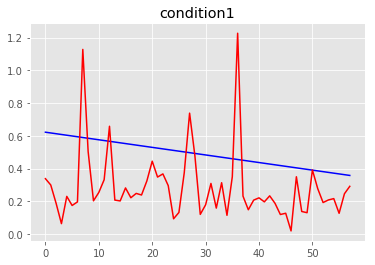

MSE condition1: 0.08667789384140955
R2 condition1: -13.426190559973618


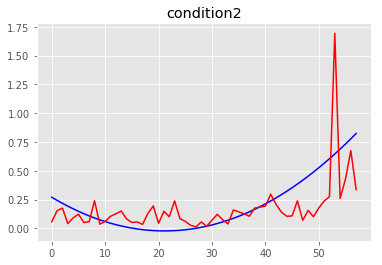

MSE condition2: 0.049304753864630006
R2 condition2: 0.07917824508564253


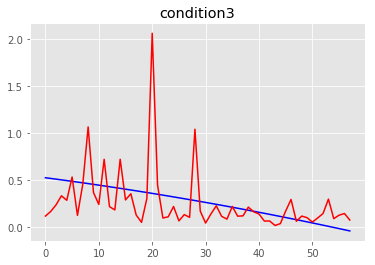

MSE condition3: 0.095012949474242
R2 condition3: -2.451978735502359


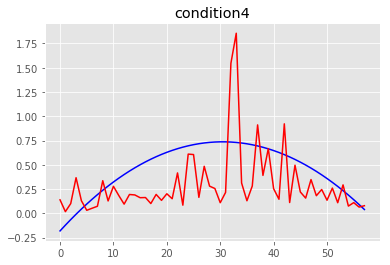

MSE condition4: 0.1319620371639688
R2 condition4: -1.0094589468919302
==== the test person number # 0 ====
==== the validated person number # 2 ====
==== the set of subject training data # [1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.24860551e-09 4.04936959e-09 3.85586975e-09 3.75710059e-09]
Global min values from training is:  [-4.23942601e-09 -4.061

n_neighbors: 29 weights_type:uniform All_MSE: 0.005197467104995092 All_R2: -0.3164177466092222
n_neighbors: 29 weights_type:distance All_MSE: 0.005163725140208512 All_R2: -0.30787156048563347
The best neighbors is: 29 The best weigths :distance The best mse: 0.005163725140208512
n_neighbors: 30 weights_type:uniform All_MSE: 0.005199612847649768 All_R2: -0.3169612216622064
n_neighbors: 30 weights_type:distance All_MSE: 0.005163224146965496 All_R2: -0.3077446686010452
The best neighbors is: 30 The best weigths :distance The best mse: 0.005163224146965496
n_neighbors: 31 weights_type:uniform All_MSE: 0.005257680006555879 All_R2: -0.33166850829528904
n_neighbors: 31 weights_type:distance All_MSE: 0.005208699627371795 All_R2: -0.3192627269616066
n_neighbors: 32 weights_type:uniform All_MSE: 0.005249967599551197 All_R2: -0.32971510498461143
n_neighbors: 32 weights_type:distance All_MSE: 0.00520348210684948 All_R2: -0.31794123007281017
n_neighbors: 33 weights_type:uniform All_MSE: 0.005172161

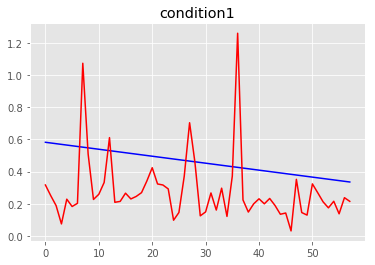

MSE condition1: 0.0741324516744272
R2 condition1: -13.092939277603511


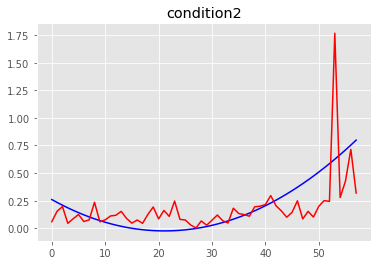

MSE condition2: 0.05013440906220324
R2 condition2: 0.010059254297673847


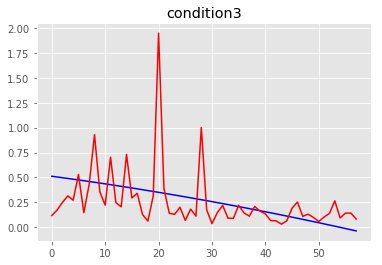

MSE condition3: 0.0829547043560002
R2 condition3: -2.1830200203061656


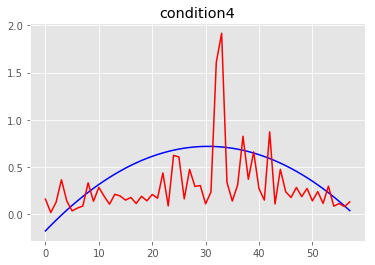

MSE condition4: 0.12677132575597594
R2 condition4: -1.0291978201559018
==== the test person number # 0 ====
==== the validated person number # 3 ====
==== the set of subject training data # [1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.23657233e-09 4.01064275e-09 3.84875635e-09 3.75438175e-09]
Global min values from training is:  [-4.22865966e-09 -4.02

n_neighbors: 24 weights_type:distance All_MSE: 0.008964908779600232 All_R2: 0.28604382162735165
n_neighbors: 25 weights_type:uniform All_MSE: 0.009027828459878645 All_R2: 0.28103296255667987
n_neighbors: 25 weights_type:distance All_MSE: 0.008937412546968787 All_R2: 0.28823359350923206
n_neighbors: 26 weights_type:uniform All_MSE: 0.009013952556049658 All_R2: 0.28213802536465327
n_neighbors: 26 weights_type:distance All_MSE: 0.008926341826771418 All_R2: 0.289115254358022
n_neighbors: 27 weights_type:uniform All_MSE: 0.009010416065920594 All_R2: 0.28241966782633043
n_neighbors: 27 weights_type:distance All_MSE: 0.00891734891274809 All_R2: 0.28983144084540036
n_neighbors: 28 weights_type:uniform All_MSE: 0.009066849418379028 All_R2: 0.277925373278051
n_neighbors: 28 weights_type:distance All_MSE: 0.008969089393947452 All_R2: 0.28571088177085435
n_neighbors: 29 weights_type:uniform All_MSE: 0.00905416781475057 All_R2: 0.2789353232379228
n_neighbors: 29 weights_type:distance All_MSE: 0.008

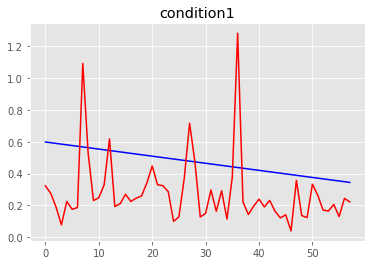

MSE condition1: 0.08132341264247095
R2 condition1: -13.5909238080446


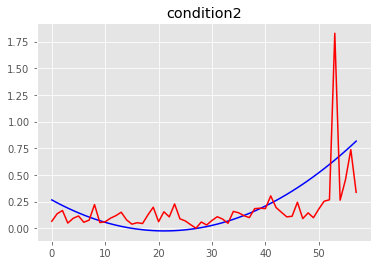

MSE condition2: 0.0530423183766918
R2 condition2: -0.0020798156855861283


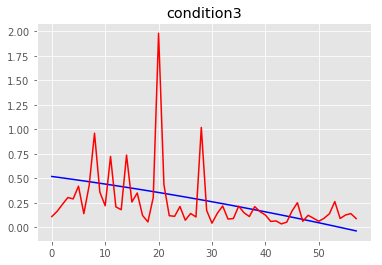

MSE condition3: 0.08807558082672944
R2 condition3: -2.2875391859665095


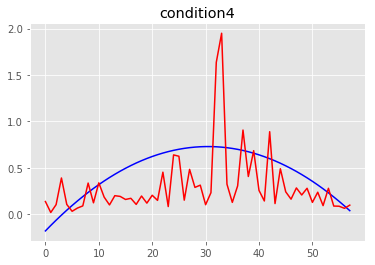

MSE condition4: 0.13393500447405335
R2 condition4: -1.0803084712785047
==== the test person number # 0 ====
==== the validated person number # 4 ====
==== the set of subject training data # [1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.32278515e-09 4.13145862e-09 3.83463111e-09 3.83866253e-09]
Global min values from training is:  [-4.31247419e-09 -4.14

n_neighbors: 29 weights_type:distance All_MSE: 0.0034977630486400023 All_R2: -3.740441282694415
n_neighbors: 30 weights_type:uniform All_MSE: 0.003514479078850214 All_R2: -3.763096150559768
n_neighbors: 30 weights_type:distance All_MSE: 0.003456123627525436 All_R2: -3.684008291638678
n_neighbors: 31 weights_type:uniform All_MSE: 0.0035349663248485114 All_R2: -3.790862064187568
n_neighbors: 31 weights_type:distance All_MSE: 0.0034718583744527817 All_R2: -3.7053332478663847
n_neighbors: 32 weights_type:uniform All_MSE: 0.0034984595880807085 All_R2: -3.741385287269291
n_neighbors: 32 weights_type:distance All_MSE: 0.003442708967367949 All_R2: -3.66582769795078
n_neighbors: 33 weights_type:uniform All_MSE: 0.0035179460579590053 All_R2: -3.767794871046264
n_neighbors: 33 weights_type:distance All_MSE: 0.0034592193366458236 All_R2: -3.688203838080627
n_neighbors: 34 weights_type:uniform All_MSE: 0.0035609082225054327 All_R2: -3.8260205471648856
n_neighbors: 34 weights_type:distance All_MSE: 

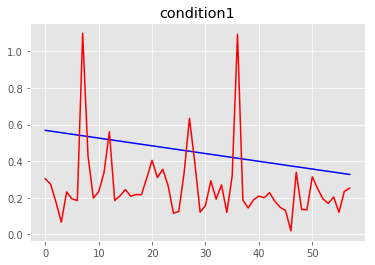

MSE condition1: 0.06950142281526642
R2 condition1: -12.843153823169223


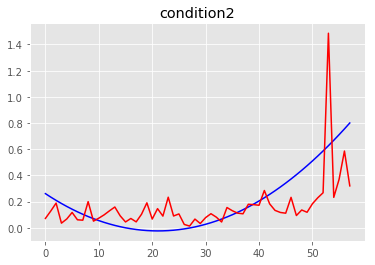

MSE condition2: 0.04217199130911144
R2 condition2: 0.17025183227817042


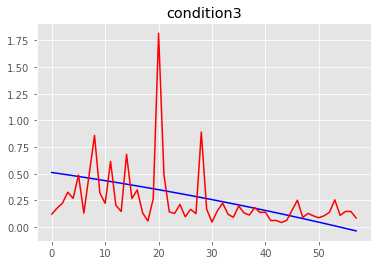

MSE condition3: 0.07242864887696271
R2 condition3: -1.786040832263331


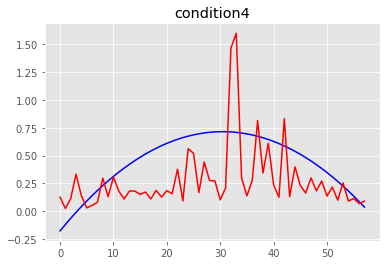

MSE condition4: 0.11457025758800249
R2 condition4: -0.8530687571188165
==== the test person number # 0 ====
==== the validated person number # 5 ====
==== the set of subject training data # [1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30328738e-09 3.85233593e-09 3.82769260e-09 3.79385937e-09]
Global min values from training is:  [-4.29392564e-09 -3.84

n_neighbors: 29 weights_type:distance All_MSE: 0.007909463818452648 All_R2: -5.3436256186870414
n_neighbors: 30 weights_type:uniform All_MSE: 0.007645037876561649 All_R2: -5.131548135594977
The best neighbors is: 30 The best weigths :uniform The best mse: 0.007645037876561649
n_neighbors: 30 weights_type:distance All_MSE: 0.007798220398901155 All_R2: -5.25440508207736
n_neighbors: 31 weights_type:uniform All_MSE: 0.007476309673059867 All_R2: -4.996223089688345
The best neighbors is: 31 The best weigths :uniform The best mse: 0.007476309673059867
n_neighbors: 31 weights_type:distance All_MSE: 0.007639141587018541 All_R2: -5.126819135720978
n_neighbors: 32 weights_type:uniform All_MSE: 0.007532882571465421 All_R2: -5.041596239611807
n_neighbors: 32 weights_type:distance All_MSE: 0.007681535071418346 All_R2: -5.160819973183134
n_neighbors: 33 weights_type:uniform All_MSE: 0.00798873808754587 All_R2: -5.407205944214193
n_neighbors: 33 weights_type:distance All_MSE: 0.008088860399674113 All

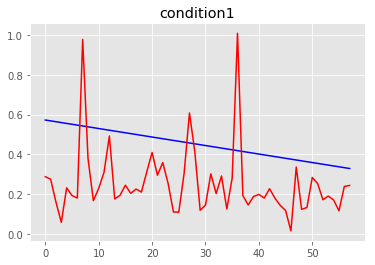

MSE condition1: 0.06903410214196815
R2 condition1: -12.552080187905055


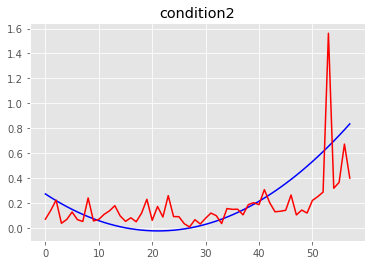

MSE condition2: 0.0439114995242267
R2 condition2: 0.2049904607656916


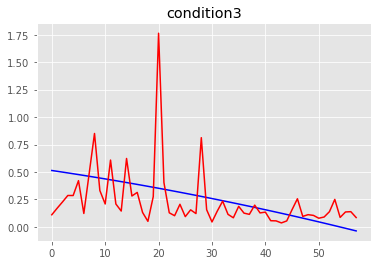

MSE condition3: 0.06829193043763138
R2 condition3: -1.6042570193448236


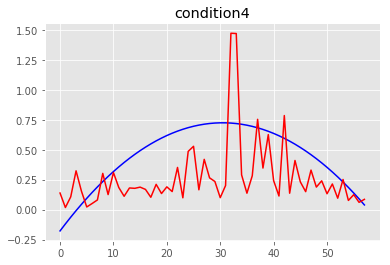

MSE condition4: 0.11536193269086709
R2 condition4: -0.8156822444432479
==== the test person number # 0 ====
==== the validated person number # 6 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30390406e-09 4.11891061e-09 3.84935371e-09 3.81303450e-09]
Global min values from training is:  [-4.29426577e-09 -4.13

n_neighbors: 26 weights_type:distance All_MSE: 0.0035135396916194934 All_R2: -2.182681964165506
n_neighbors: 27 weights_type:uniform All_MSE: 0.003492873242734301 All_R2: -2.1639616023926944
n_neighbors: 27 weights_type:distance All_MSE: 0.003511101332705961 All_R2: -2.1804732169711105
n_neighbors: 28 weights_type:uniform All_MSE: 0.0034808820122927573 All_R2: -2.153099544125505
The best neighbors is: 28 The best weigths :uniform The best mse: 0.0034808820122927573
n_neighbors: 28 weights_type:distance All_MSE: 0.0034968904503050536 All_R2: -2.1676005235957874
n_neighbors: 29 weights_type:uniform All_MSE: 0.0034492152810216637 All_R2: -2.1244147580332977
The best neighbors is: 29 The best weigths :uniform The best mse: 0.0034492152810216637
n_neighbors: 29 weights_type:distance All_MSE: 0.003467973969535753 All_R2: -2.141407006547693
n_neighbors: 30 weights_type:uniform All_MSE: 0.0034459017264307033 All_R2: -2.121413229273261
The best neighbors is: 30 The best weigths :uniform The bes

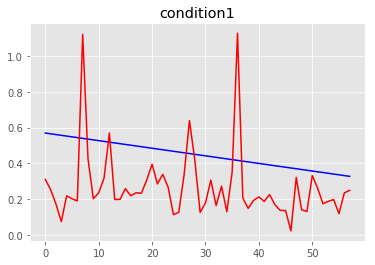

MSE condition1: 0.07026949555403045
R2 condition1: -12.937595251562733


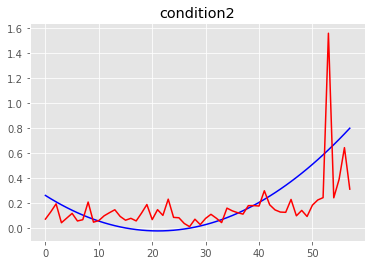

MSE condition2: 0.04411594566748329
R2 condition2: 0.12682226784039752


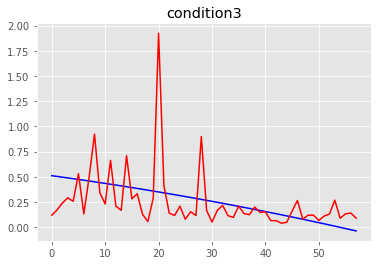

MSE condition3: 0.07956758565619389
R2 condition3: -2.06513397173434


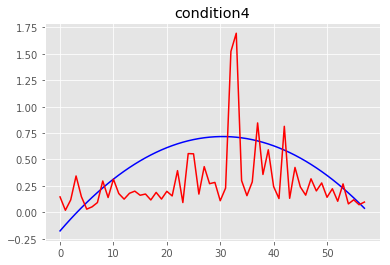

MSE condition4: 0.1177273210853943
R2 condition4: -0.8921348314653135
==== the test person number # 0 ====
==== the validated person number # 7 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.89944670e-09 3.76837666e-09 3.49352219e-09 3.42696105e-09]
Global min values from training is:  [-3.89340149e-09 -3.781

n_neighbors: 27 weights_type:uniform All_MSE: 0.32996187450708997 All_R2: -4.991206075371633
The best neighbors is: 27 The best weigths :uniform The best mse: 0.32996187450708997
n_neighbors: 27 weights_type:distance All_MSE: 0.33793406098525297 All_R2: -5.135959199147876
n_neighbors: 28 weights_type:uniform All_MSE: 0.322499449095519 All_R2: -4.855708819727781
The best neighbors is: 28 The best weigths :uniform The best mse: 0.322499449095519
n_neighbors: 28 weights_type:distance All_MSE: 0.33161096900628867 All_R2: -5.021149125601968
n_neighbors: 29 weights_type:uniform All_MSE: 0.31998289502129634 All_R2: -4.810015073803326
The best neighbors is: 29 The best weigths :uniform The best mse: 0.31998289502129634
n_neighbors: 29 weights_type:distance All_MSE: 0.3290667353217124 All_R2: -4.974952793583399
n_neighbors: 30 weights_type:uniform All_MSE: 0.31790755420046796 All_R2: -4.772332555019034
The best neighbors is: 30 The best weigths :uniform The best mse: 0.31790755420046796
n_neigh

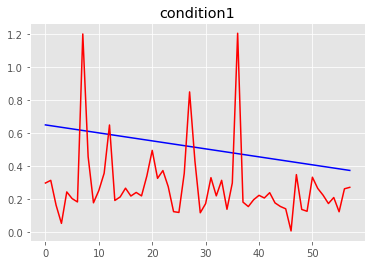

MSE condition1: 0.09893042621674544
R2 condition1: -14.137445308713861


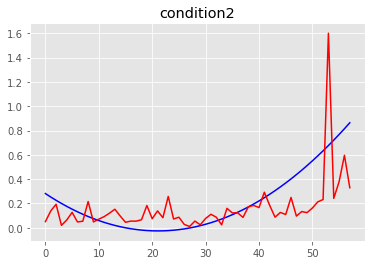

MSE condition2: 0.05185376849571106
R2 condition2: 0.12433829331417323


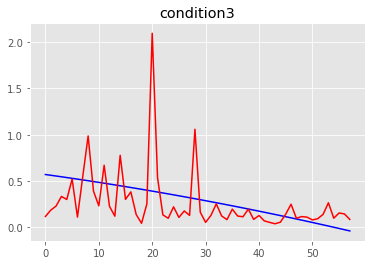

MSE condition3: 0.09945000897508169
R2 condition3: -2.0835462598959475


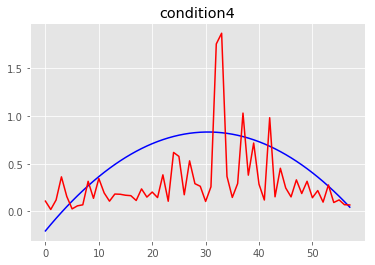

MSE condition4: 0.16518879499154165
R2 condition4: -0.9785567754907682
==== the test person number # 0 ====
==== the validated person number # 8 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.27915638e-09 4.09274745e-09 3.83101687e-09 3.70133942e-09]
Global min values from training is:  [-4.26816916e-09 -4.10

n_neighbors: 31 weights_type:distance All_MSE: 0.00465886139744082 All_R2: -2.326087190289532
n_neighbors: 32 weights_type:uniform All_MSE: 0.004696195055116571 All_R2: -2.3527406985115578
n_neighbors: 32 weights_type:distance All_MSE: 0.00460285244477188 All_R2: -2.2861008837391745
The best neighbors is: 32 The best weigths :distance The best mse: 0.00460285244477188
n_neighbors: 33 weights_type:uniform All_MSE: 0.00466821014662584 All_R2: -2.3327615152494037
n_neighbors: 33 weights_type:distance All_MSE: 0.004580612428108183 All_R2: -2.2702231341719554
The best neighbors is: 33 The best weigths :distance The best mse: 0.004580612428108183
n_neighbors: 34 weights_type:uniform All_MSE: 0.004557328145846436 All_R2: -2.2535998551432157
The best neighbors is: 34 The best weigths :uniform The best mse: 0.004557328145846436
n_neighbors: 34 weights_type:distance All_MSE: 0.004488511430821402 All_R2: -2.204469740551633
The best neighbors is: 34 The best weigths :distance The best mse: 0.00448

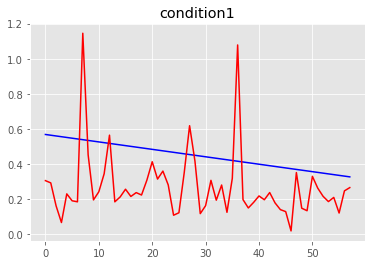

MSE condition1: 0.06832383799914477
R2 condition1: -12.59263558220364


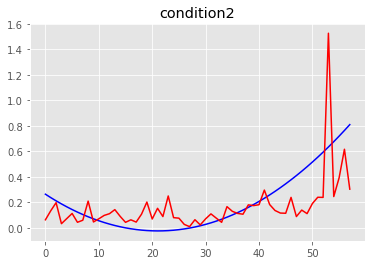

MSE condition2: 0.04406552384645555
R2 condition2: 0.15165103849391814


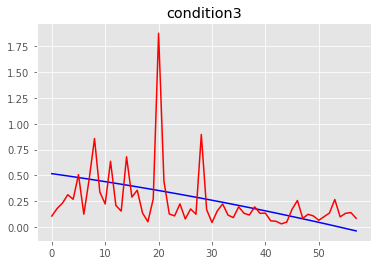

MSE condition3: 0.07608321804982073
R2 condition3: -1.8612258299390345


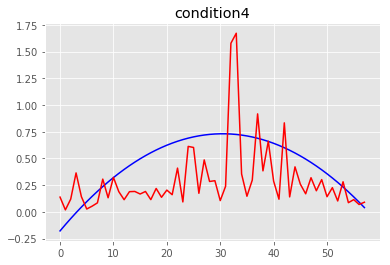

MSE condition4: 0.11924985867241263
R2 condition4: -0.8501574691379536
==== the test person number # 0 ====
==== the validated person number # 9 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.11157338e-09 4.00180341e-09 3.74456059e-09 3.64273057e-09]
Global min values from training is:  [-4.10459332e-09 -4.01

n_neighbors: 29 weights_type:uniform All_MSE: 0.09048683858864467 All_R2: -0.5849915854579024
n_neighbors: 29 weights_type:distance All_MSE: 0.08881039481428041 All_R2: -0.5556265494227712
n_neighbors: 30 weights_type:uniform All_MSE: 0.09087440524053808 All_R2: -0.5917803062446649
n_neighbors: 30 weights_type:distance All_MSE: 0.0890910293311185 All_R2: -0.560542218427404
n_neighbors: 31 weights_type:uniform All_MSE: 0.09062045608147144 All_R2: -0.587332065080173
n_neighbors: 31 weights_type:distance All_MSE: 0.0889456347979479 All_R2: -0.5579954490271093
n_neighbors: 32 weights_type:uniform All_MSE: 0.09190317572883556 All_R2: -0.609800524353197
n_neighbors: 32 weights_type:distance All_MSE: 0.09000562204583683 All_R2: -0.5765624682179804
n_neighbors: 33 weights_type:uniform All_MSE: 0.09076624053910479 All_R2: -0.589885664501298
n_neighbors: 33 weights_type:distance All_MSE: 0.08912005366219003 All_R2: -0.561050616347361
n_neighbors: 34 weights_type:uniform All_MSE: 0.09028728919555

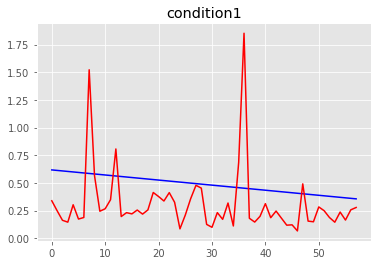

MSE condition1: 0.11758847567785082
R2 condition1: -18.919227438809415


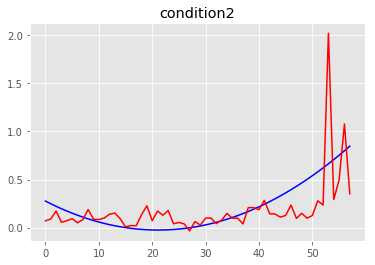

MSE condition2: 0.0648530206965199
R2 condition2: -0.14007866590076734


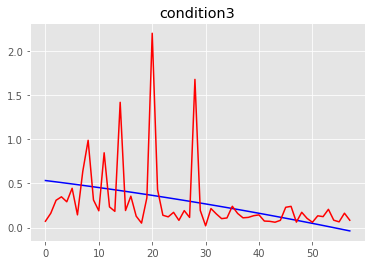

MSE condition3: 0.1428346031988986
R2 condition3: -4.070645889921788


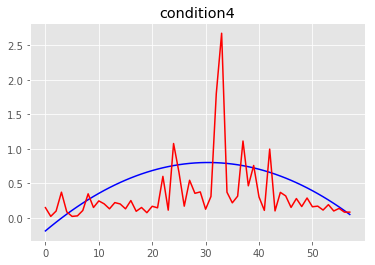

MSE condition4: 0.19517738667245285
R2 condition4: -1.5521891668157064
==== the test person number # 0 ====
==== the validated person number # 10 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.26748806e-09 4.05633511e-09 3.78175176e-09 3.74285703e-09]
Global min values from training is:  [-4.25543456e-09 -4.06

n_neighbors: 30 weights_type:uniform All_MSE: 0.01539283234514745 All_R2: 0.06479778846668793
n_neighbors: 30 weights_type:distance All_MSE: 0.01495851992894703 All_R2: 0.09118474071950389
n_neighbors: 31 weights_type:uniform All_MSE: 0.015686202937192535 All_R2: 0.04697385455202452
n_neighbors: 31 weights_type:distance All_MSE: 0.015199804882154605 All_R2: 0.07652530593909646
n_neighbors: 32 weights_type:uniform All_MSE: 0.015842765822800607 All_R2: 0.03746176778451904
n_neighbors: 32 weights_type:distance All_MSE: 0.015329784604412627 All_R2: 0.06862829770925571
n_neighbors: 33 weights_type:uniform All_MSE: 0.01578517656686759 All_R2: 0.04096064299484359
n_neighbors: 33 weights_type:distance All_MSE: 0.015293905330585535 All_R2: 0.07080816789031985
n_neighbors: 34 weights_type:uniform All_MSE: 0.01577590531104753 All_R2: 0.04152392457630916
n_neighbors: 34 weights_type:distance All_MSE: 0.015303887248902416 All_R2: 0.07020170951567017
n_neighbors: 35 weights_type:uniform All_MSE: 0.0

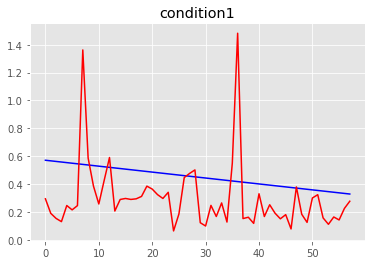

MSE condition1: 0.08083865760384301
R2 condition1: -14.95647710528749


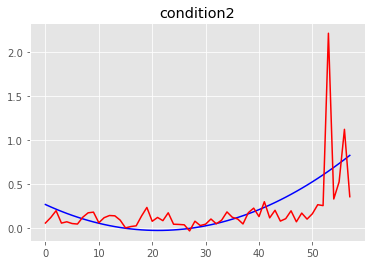

MSE condition2: 0.072548162379927
R2 condition2: -0.342700365845771


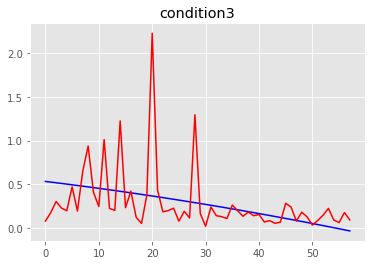

MSE condition3: 0.12432339008796213
R2 condition3: -3.466599262348957


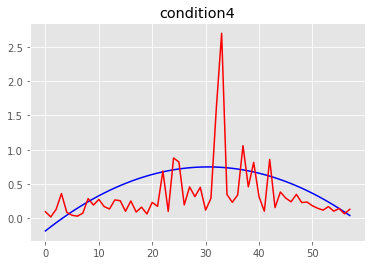

MSE condition4: 0.16891254856350357
R2 condition4: -1.4904910576540709
==== the test person number # 0 ====
==== the validated person number # 11 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.85131932e-09 3.66696108e-09 3.52645263e-09 3.44362682e-09]
Global min values from training is:  [-3.84804139e-09 -3.68

n_neighbors: 37 weights_type:distance All_MSE: 9.772763663396633 All_R2: -4.129190334417225
n_neighbors: 38 weights_type:uniform All_MSE: 10.069588646115635 All_R2: -4.28497756971876
n_neighbors: 38 weights_type:distance All_MSE: 9.809289437848618 All_R2: -4.14836072016777
n_neighbors: 39 weights_type:uniform All_MSE: 10.106839677207477 All_R2: -4.304528603101362
n_neighbors: 39 weights_type:distance All_MSE: 9.845785652102684 All_R2: -4.167515591383567
n_neighbors: 40 weights_type:uniform All_MSE: 10.136480649635997 All_R2: -4.320085531982445
n_neighbors: 40 weights_type:distance All_MSE: 9.875588813540919 All_R2: -4.183157644424982
n_neighbors: 41 weights_type:uniform All_MSE: 10.168559918090672 All_R2: -4.3369221893866525
n_neighbors: 41 weights_type:distance All_MSE: 9.907195132785002 All_R2: -4.199746076598007
n_neighbors: 42 weights_type:uniform All_MSE: 10.201567402339595 All_R2: -4.354246016607311
n_neighbors: 42 weights_type:distance All_MSE: 9.939628832426964 All_R2: -4.21676

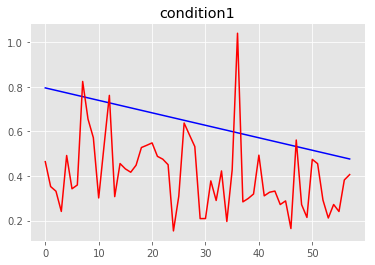

MSE condition1: 0.07925270225784402
R2 condition1: -8.047991102652729


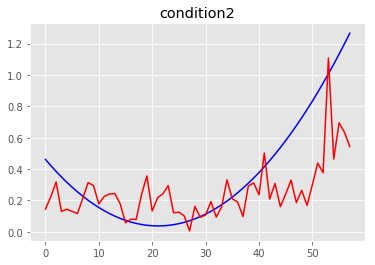

MSE condition2: 0.07294511993156491
R2 condition2: 0.35264461790434953


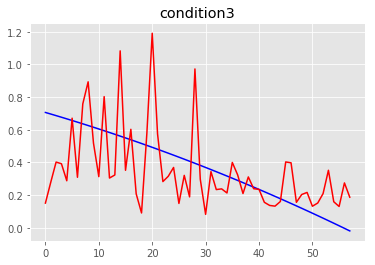

MSE condition3: 0.05977763686172086
R2 condition3: -0.31193152543062186


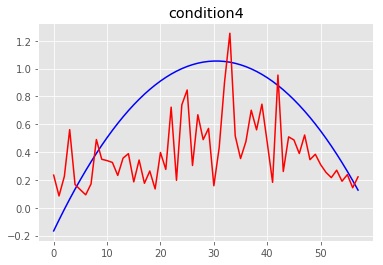

MSE condition4: 0.16936615127211213
R2 condition4: -0.4563702541825383
==== the test person number # 0 ====
==== the validated person number # 12 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.20851316e-09 3.97793309e-09 3.74122821e-09 3.73250645e-09]
Global min values from training is:  [-4.19851579e-09 -3.99

n_neighbors: 32 weights_type:uniform All_MSE: 0.020817408076636353 All_R2: -0.2683365596782459
n_neighbors: 32 weights_type:distance All_MSE: 0.020401652122015834 All_R2: -0.24300590971414437
n_neighbors: 33 weights_type:uniform All_MSE: 0.02069595395741152 All_R2: -0.260936757591008
n_neighbors: 33 weights_type:distance All_MSE: 0.02030454130761049 All_R2: -0.23708926553841447
n_neighbors: 34 weights_type:uniform All_MSE: 0.020741350625963283 All_R2: -0.2637026280682466
n_neighbors: 34 weights_type:distance All_MSE: 0.02034565597423313 All_R2: -0.23959424764879533
n_neighbors: 35 weights_type:uniform All_MSE: 0.020533538739522076 All_R2: -0.2510413297865983
n_neighbors: 35 weights_type:distance All_MSE: 0.020184773591730317 All_R2: -0.22979221048906529
n_neighbors: 36 weights_type:uniform All_MSE: 0.02031869118823716 All_R2: -0.237951371466675
n_neighbors: 36 weights_type:distance All_MSE: 0.020015610907363875 All_R2: -0.2194856816298809
n_neighbors: 37 weights_type:uniform All_MSE: 0

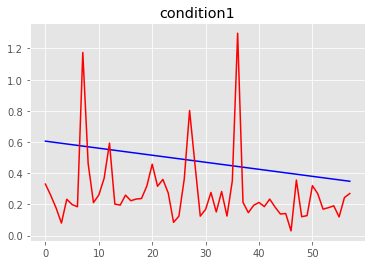

MSE condition1: 0.08701130014970831
R2 condition1: -14.260600198005298


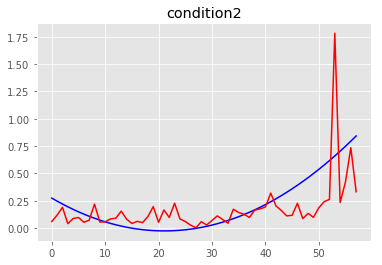

MSE condition2: 0.05413339071681926
R2 condition2: 0.03866300611305096


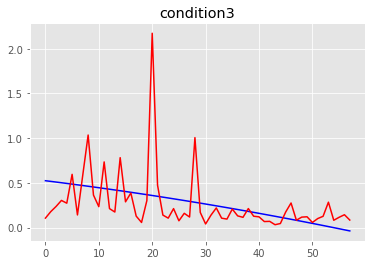

MSE condition3: 0.10130781025125704
R2 condition3: -2.7134550026688045


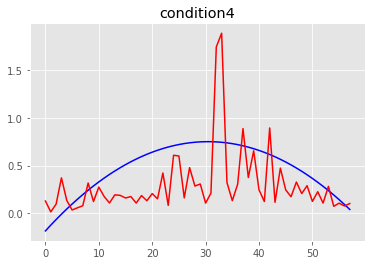

MSE condition4: 0.1409658450524797
R2 condition4: -1.0737119596502547
==== the test person number # 0 ====
==== the validated person number # 13 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.26286420e-09 4.06647918e-09 3.78795036e-09 3.80162848e-09]
Global min values from training is:  [-4.25447437e-09 -4.080

n_neighbors: 28 weights_type:distance All_MSE: 0.003950362260263053 All_R2: -0.34089040945472826
n_neighbors: 29 weights_type:uniform All_MSE: 0.00391923012956854 All_R2: -0.3303230810114417
The best neighbors is: 29 The best weigths :uniform The best mse: 0.00391923012956854
n_neighbors: 29 weights_type:distance All_MSE: 0.0039050258208461835 All_R2: -0.3255016443724956
The best neighbors is: 29 The best weigths :distance The best mse: 0.0039050258208461835
n_neighbors: 30 weights_type:uniform All_MSE: 0.003861364571578979 All_R2: -0.3106814971176186
The best neighbors is: 30 The best weigths :uniform The best mse: 0.003861364571578979
n_neighbors: 30 weights_type:distance All_MSE: 0.0038553469906061535 All_R2: -0.30863892074538457
The best neighbors is: 30 The best weigths :distance The best mse: 0.0038553469906061535
n_neighbors: 31 weights_type:uniform All_MSE: 0.0038883455202084923 All_R2: -0.31983976992192
n_neighbors: 31 weights_type:distance All_MSE: 0.003875438982582493 All_R2

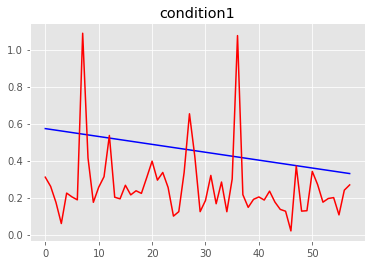

MSE condition1: 0.07052025918206623
R2 condition1: -12.830830551146265


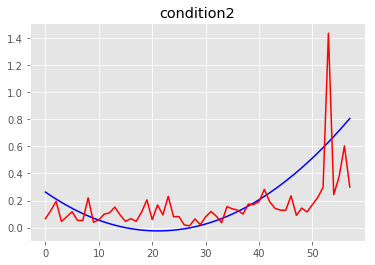

MSE condition2: 0.040780164728199404
R2 condition2: 0.20643766311232392


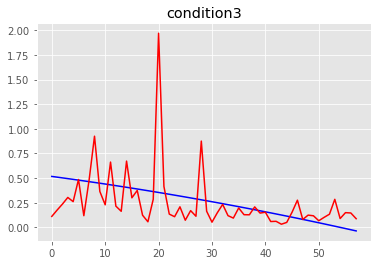

MSE condition3: 0.08215835309665347
R2 condition3: -2.098529357736953


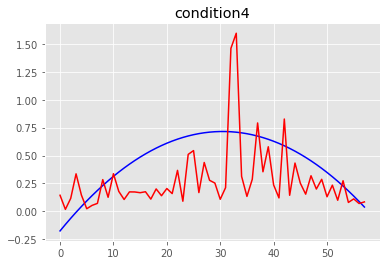

MSE condition4: 0.11391447312748967
R2 condition4: -0.8397702644612874
==== the test person number # 0 ====
==== the validated person number # 14 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.00737975e-09 3.82811449e-09 3.45734051e-09 3.59061275e-09]
Global min values from training is:  [-3.99242127e-09 -3.84

n_neighbors: 26 weights_type:distance All_MSE: 0.3297631416851849 All_R2: 0.43505655570108426
The best neighbors is: 26 The best weigths :distance The best mse: 0.3297631416851849
n_neighbors: 27 weights_type:uniform All_MSE: 0.33181920765632344 All_R2: 0.43153414569035686
n_neighbors: 27 weights_type:distance All_MSE: 0.3269672142421576 All_R2: 0.43984648119609804
The best neighbors is: 27 The best weigths :distance The best mse: 0.3269672142421576
n_neighbors: 28 weights_type:uniform All_MSE: 0.33179464903707095 All_R2: 0.43157621901267185
n_neighbors: 28 weights_type:distance All_MSE: 0.3267158544723999 All_R2: 0.44027710559323163
The best neighbors is: 28 The best weigths :distance The best mse: 0.3267158544723999
n_neighbors: 29 weights_type:uniform All_MSE: 0.3314962658813858 All_R2: 0.43208740290918657
n_neighbors: 29 weights_type:distance All_MSE: 0.3261493915617067 All_R2: 0.44124755822234973
The best neighbors is: 29 The best weigths :distance The best mse: 0.3261493915617067

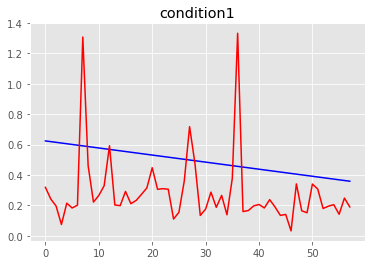

MSE condition1: 0.09441333896063854
R2 condition1: -14.59242461640578


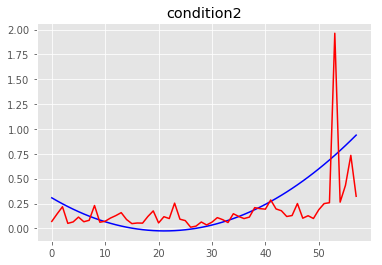

MSE condition2: 0.06831566250076954
R2 condition2: 0.015842474662836725


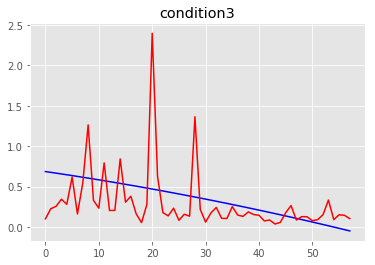

MSE condition3: 0.14274828179260005
R2 condition3: -2.055271080298982


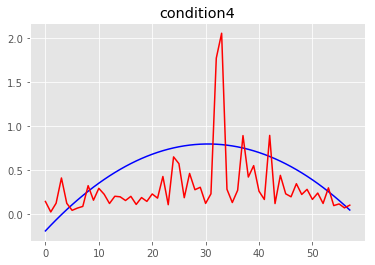

MSE condition4: 0.16066634243215425
R2 condition4: -1.107509790872785
==== the test person number # 0 ====
==== the validated person number # 15 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30993808e-09 4.12261209e-09 3.87308245e-09 3.85699694e-09]
Global min values from training is:  [-4.30063731e-09 -4.136

n_neighbors: 23 weights_type:distance All_MSE: 0.0026866277482716265 All_R2: 0.23312261488064057
The best neighbors is: 23 The best weigths :distance The best mse: 0.0026866277482716265
n_neighbors: 24 weights_type:uniform All_MSE: 0.0027376768754090084 All_R2: 0.21855103117056895
n_neighbors: 24 weights_type:distance All_MSE: 0.002695777675921627 All_R2: 0.23051083786956117
n_neighbors: 25 weights_type:uniform All_MSE: 0.002694133674705732 All_R2: 0.23098010546883685
n_neighbors: 25 weights_type:distance All_MSE: 0.0026620466328623606 All_R2: 0.24013910665941496
The best neighbors is: 25 The best weigths :distance The best mse: 0.0026620466328623606
n_neighbors: 26 weights_type:uniform All_MSE: 0.0027036918358655554 All_R2: 0.22825180131821143
n_neighbors: 26 weights_type:distance All_MSE: 0.002668574765801442 All_R2: 0.2382757009377794
n_neighbors: 27 weights_type:uniform All_MSE: 0.0027106966841708244 All_R2: 0.22625232083381674
n_neighbors: 27 weights_type:distance All_MSE: 0.00267

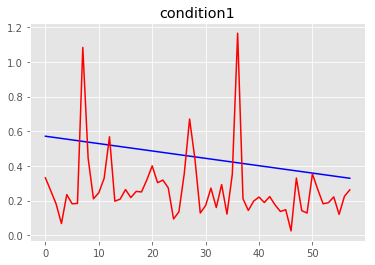

MSE condition1: 0.07038388263799225
R2 condition1: -12.87344712603786


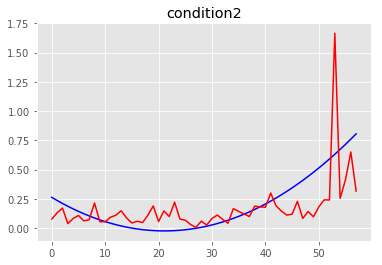

MSE condition2: 0.04749181529840096
R2 condition2: 0.07809463308686859


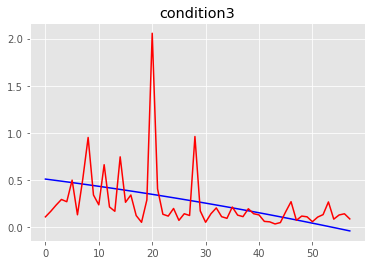

MSE condition3: 0.08962377629027495
R2 condition3: -2.4336753549114634


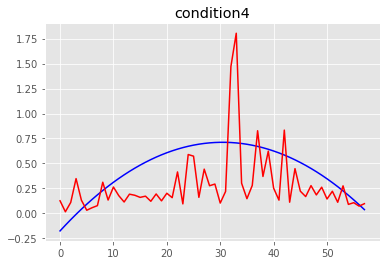

MSE condition4: 0.1188782515462932
R2 condition4: -0.9381535872507978
==== the test person number # 1 ====
==== the validated person number # 0 ====
==== the set of subject training data # [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.19534200e-09 4.00596529e-09 3.79618159e-09 3.79689779e-09]
Global min values from training is:  [-4.18395381e-09 -4.018

n_neighbors: 27 weights_type:distance All_MSE: 0.09716395209849545 All_R2: -0.8198690528615689
n_neighbors: 28 weights_type:uniform All_MSE: 0.0940567028425416 All_R2: -0.7616706506938051
The best neighbors is: 28 The best weigths :uniform The best mse: 0.0940567028425416
n_neighbors: 28 weights_type:distance All_MSE: 0.09538916009487305 All_R2: -0.7866274136229301
n_neighbors: 29 weights_type:uniform All_MSE: 0.09357126409829321 All_R2: -0.7525784418175949
The best neighbors is: 29 The best weigths :uniform The best mse: 0.09357126409829321
n_neighbors: 29 weights_type:distance All_MSE: 0.09493837016420754 All_R2: -0.778184172827947
n_neighbors: 30 weights_type:uniform All_MSE: 0.09243452466181223 All_R2: -0.7312874498710964
The best neighbors is: 30 The best weigths :uniform The best mse: 0.09243452466181223
n_neighbors: 30 weights_type:distance All_MSE: 0.09393631010721336 All_R2: -0.7594157093448664
n_neighbors: 31 weights_type:uniform All_MSE: 0.0922354163796973 All_R2: -0.7275581

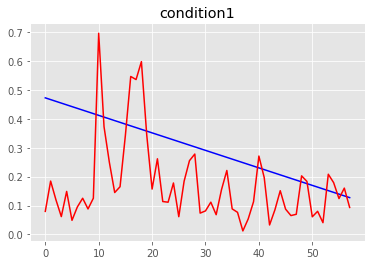

MSE condition1: 0.03839872112173697
R2 condition1: -2.7437118164551624


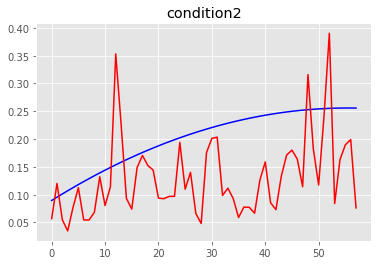

MSE condition2: 0.0104328088782838
R2 condition2: -3.0651834331882144


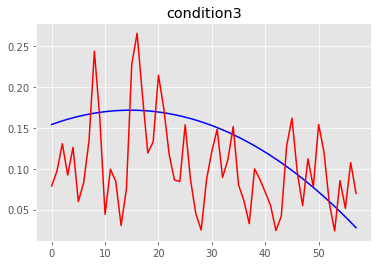

MSE condition3: 0.004199200143136585
R2 condition3: -1.3519249102363196


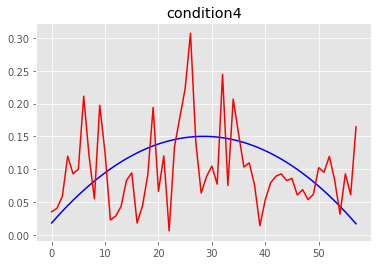

MSE condition4: 0.004273990652469849
R2 condition4: -1.5523591068641323
==== the test person number # 1 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30403955e-09 4.52059424e-09 4.01752881e-09 3.97219028e-09]
Global min values from training is:  [-4.29175015e-09 -4.5

n_neighbors: 26 weights_type:uniform All_MSE: 0.0046478960615156184 All_R2: -0.25947235400295576
n_neighbors: 26 weights_type:distance All_MSE: 0.004643641946419949 All_R2: -0.25831958718484516
n_neighbors: 27 weights_type:uniform All_MSE: 0.004626157212311372 All_R2: -0.2535816285611179
The best neighbors is: 27 The best weigths :uniform The best mse: 0.004626157212311372
n_neighbors: 27 weights_type:distance All_MSE: 0.0046214378815689185 All_R2: -0.2523027990604476
The best neighbors is: 27 The best weigths :distance The best mse: 0.0046214378815689185
n_neighbors: 28 weights_type:uniform All_MSE: 0.0046553534616082535 All_R2: -0.2614931369819862
n_neighbors: 28 weights_type:distance All_MSE: 0.004639106682734187 All_R2: -0.257090635600143
n_neighbors: 29 weights_type:uniform All_MSE: 0.004618227879009015 All_R2: -0.25143296259530956
The best neighbors is: 29 The best weigths :uniform The best mse: 0.004618227879009015
n_neighbors: 29 weights_type:distance All_MSE: 0.004606850190564

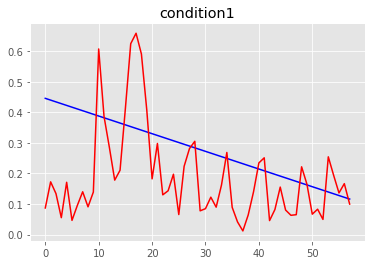

MSE condition1: 0.03244510334440872
R2 condition1: -2.455793213232891


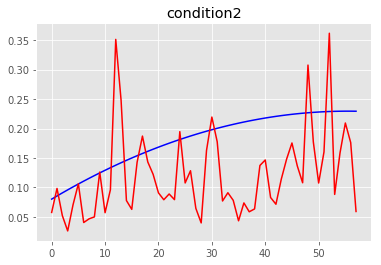

MSE condition2: 0.008934697186136072
R2 condition2: -3.325621729187618


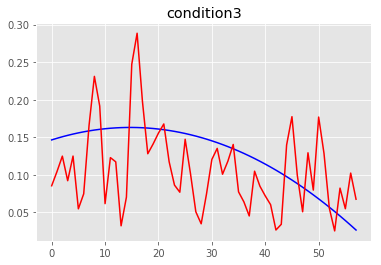

MSE condition3: 0.0036980747852179865
R2 condition3: -1.2948162225925652


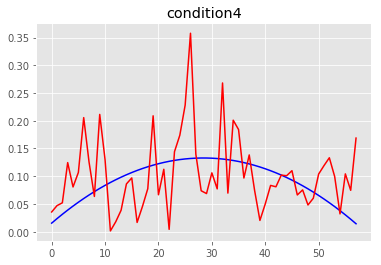

MSE condition4: 0.004949251584212385
R2 condition4: -2.7386966810255906
==== the test person number # 1 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.29200637e-09 4.48186740e-09 4.01041541e-09 3.96947143e-09]
Global min values from training is:  [-4.28098381e-09 -4.4

n_neighbors: 24 weights_type:distance All_MSE: 0.00858285263202202 All_R2: 0.2802341516957171
The best neighbors is: 24 The best weigths :distance The best mse: 0.00858285263202202
n_neighbors: 25 weights_type:uniform All_MSE: 0.008445650331700383 All_R2: 0.2917400617135425
The best neighbors is: 25 The best weigths :uniform The best mse: 0.008445650331700383
n_neighbors: 25 weights_type:distance All_MSE: 0.008443191308840418 All_R2: 0.2919462776129277
The best neighbors is: 25 The best weigths :distance The best mse: 0.008443191308840418
n_neighbors: 26 weights_type:uniform All_MSE: 0.008521838510922121 All_R2: 0.2853508515290757
n_neighbors: 26 weights_type:distance All_MSE: 0.008494823472129544 All_R2: 0.2876163573168562
n_neighbors: 27 weights_type:uniform All_MSE: 0.008529722565442226 All_R2: 0.284689687527661
n_neighbors: 27 weights_type:distance All_MSE: 0.008498484208002238 All_R2: 0.2873093646683983
n_neighbors: 28 weights_type:uniform All_MSE: 0.008417820729990935 All_R2: 0.2

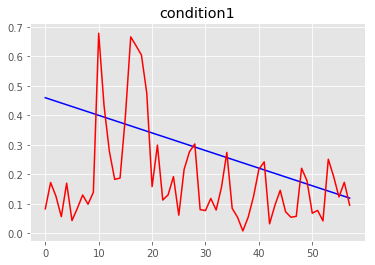

MSE condition1: 0.03669033887235095
R2 condition1: -2.6834111126367772


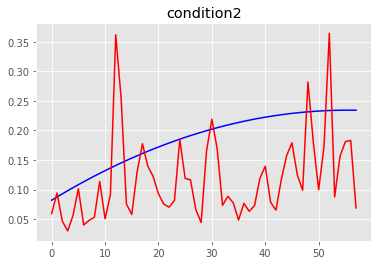

MSE condition2: 0.0096929283770483
R2 condition2: -3.5054037133295317


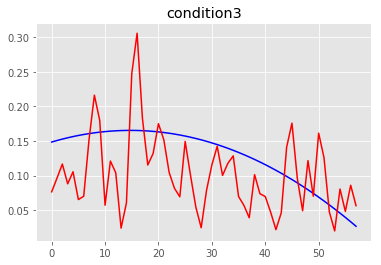

MSE condition3: 0.004067841522513237
R2 condition3: -1.4571904189803742


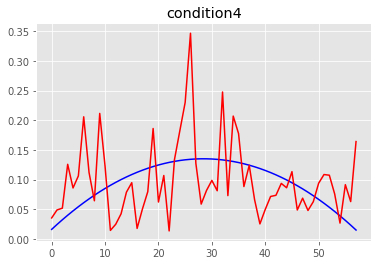

MSE condition4: 0.004473967918107735
R2 condition4: -2.288268572892013
==== the test person number # 1 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37821919e-09 4.60268327e-09 3.99629017e-09 4.05375221e-09]
Global min values from training is:  [-4.36479833e-09 -4.61

n_neighbors: 28 weights_type:uniform All_MSE: 0.0030172607075985435 All_R2: -3.4802653179832435
n_neighbors: 28 weights_type:distance All_MSE: 0.002999404572413041 All_R2: -3.4537511281476228
The best neighbors is: 28 The best weigths :distance The best mse: 0.002999404572413041
n_neighbors: 29 weights_type:uniform All_MSE: 0.003027302819053169 All_R2: -3.49517663259261
n_neighbors: 29 weights_type:distance All_MSE: 0.00300131386440595 All_R2: -3.456586194629014
n_neighbors: 30 weights_type:uniform All_MSE: 0.002988189285261689 All_R2: -3.437097790261081
The best neighbors is: 30 The best weigths :uniform The best mse: 0.002988189285261689
n_neighbors: 30 weights_type:distance All_MSE: 0.0029697254953912964 All_R2: -3.4096813070958962
The best neighbors is: 30 The best weigths :distance The best mse: 0.0029697254953912964
n_neighbors: 31 weights_type:uniform All_MSE: 0.003022137884422505 All_R2: -3.4875073326089723
n_neighbors: 31 weights_type:distance All_MSE: 0.002995303731219075 All

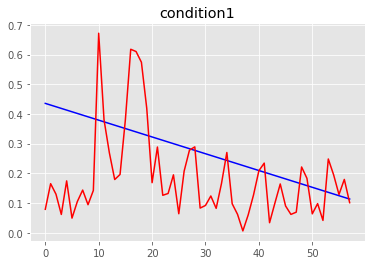

MSE condition1: 0.03085159757270288
R2 condition1: -2.446472484806232


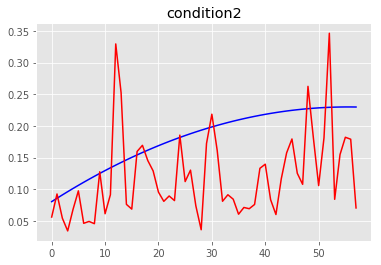

MSE condition2: 0.00837073498543209
R2 condition2: -3.0392576464320573


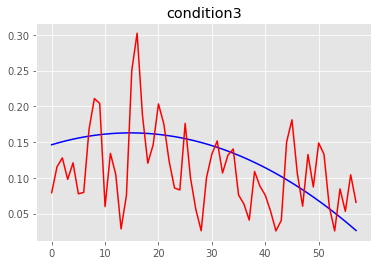

MSE condition3: 0.003572306592120827
R2 condition3: -1.2221541214129177


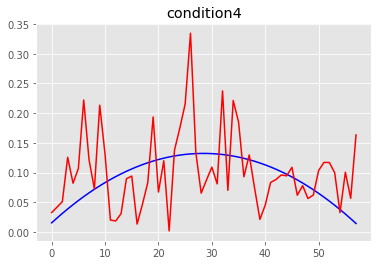

MSE condition4: 0.004548072957849198
R2 condition4: -2.468375273149313
==== the test person number # 1 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.35872142e-09 4.32356058e-09 3.98935166e-09 4.00894906e-09]
Global min values from training is:  [-4.34624978e-09 -4.31

n_neighbors: 29 weights_type:uniform All_MSE: 0.0063523925183162095 All_R2: -4.967710073587128
n_neighbors: 29 weights_type:distance All_MSE: 0.006404798231588593 All_R2: -5.0169422490402935
n_neighbors: 30 weights_type:uniform All_MSE: 0.006208761091804537 All_R2: -4.832776549185743
n_neighbors: 30 weights_type:distance All_MSE: 0.006264067821339408 All_R2: -4.884734063780558
n_neighbors: 31 weights_type:uniform All_MSE: 0.006057521427350256 All_R2: -4.690695519638628
The best neighbors is: 31 The best weigths :uniform The best mse: 0.006057521427350256
n_neighbors: 31 weights_type:distance All_MSE: 0.006125122274462251 All_R2: -4.754202655749955
n_neighbors: 32 weights_type:uniform All_MSE: 0.006301974249773774 All_R2: -4.920344988982238
n_neighbors: 32 weights_type:distance All_MSE: 0.006349967584658368 All_R2: -4.965431986870044
n_neighbors: 33 weights_type:uniform All_MSE: 0.00634633527591674 All_R2: -4.9620196401982515
n_neighbors: 33 weights_type:distance All_MSE: 0.006388819181

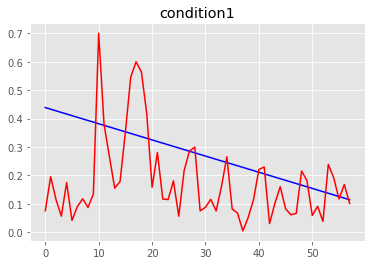

MSE condition1: 0.03243054602597932
R2 condition1: -2.5695491853714216


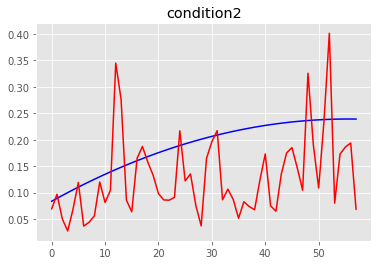

MSE condition2: 0.009373844474538377
R2 condition2: -3.1897486774997574


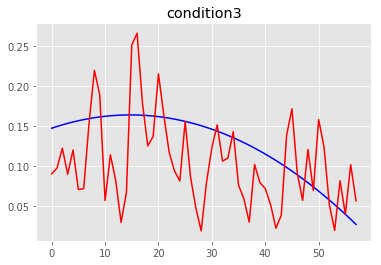

MSE condition3: 0.003803507807397124
R2 condition3: -1.3460445130759058


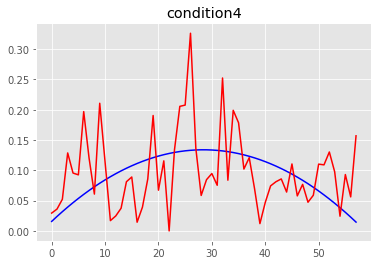

MSE condition4: 0.0044370061692769565
R2 condition4: -2.3006150849888054
==== the test person number # 1 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.35933810e-09 4.59013526e-09 4.01101277e-09 4.02812418e-09]
Global min values from training is:  [-4.34658991e-09 -4.

n_neighbors: 25 weights_type:distance All_MSE: 0.00294961332531458 All_R2: -2.094204412317408
The best neighbors is: 25 The best weigths :distance The best mse: 0.00294961332531458
n_neighbors: 26 weights_type:uniform All_MSE: 0.002909638465524415 All_R2: -2.0522699707813103
The best neighbors is: 26 The best weigths :uniform The best mse: 0.002909638465524415
n_neighbors: 26 weights_type:distance All_MSE: 0.002905359230744178 All_R2: -2.0477809664007314
The best neighbors is: 26 The best weigths :distance The best mse: 0.002905359230744178
n_neighbors: 27 weights_type:uniform All_MSE: 0.00288143367403714 All_R2: -2.022682570453469
The best neighbors is: 27 The best weigths :uniform The best mse: 0.00288143367403714
n_neighbors: 27 weights_type:distance All_MSE: 0.002883572833661169 All_R2: -2.0249265924378133
n_neighbors: 28 weights_type:uniform All_MSE: 0.0029161395110076983 All_R2: -2.0590896998103374
n_neighbors: 28 weights_type:distance All_MSE: 0.002905809066934985 All_R2: -2.048

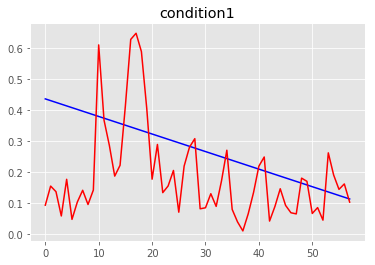

MSE condition1: 0.030418325488407536
R2 condition1: -2.383545852132806


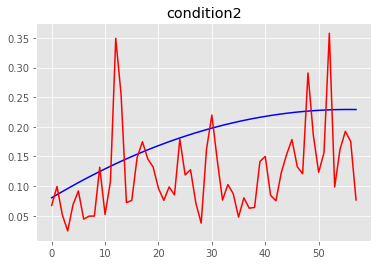

MSE condition2: 0.008284378453803622
R2 condition2: -3.019594816765186


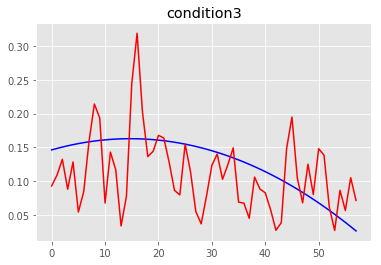

MSE condition3: 0.0035710656515997334
R2 condition3: -1.2245616313329784


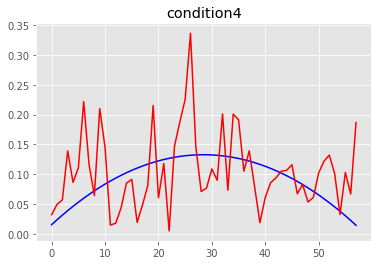

MSE condition4: 0.004708929715931625
R2 condition4: -2.570408496559381
==== the test person number # 1 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.95488074e-09 4.23960131e-09 3.65518125e-09 3.64205073e-09]
Global min values from training is:  [-3.94572564e-09 -4.24

n_neighbors: 30 weights_type:uniform All_MSE: 0.2661530248359832 All_R2: -4.326113087338568
The best neighbors is: 30 The best weigths :uniform The best mse: 0.2661530248359832
n_neighbors: 30 weights_type:distance All_MSE: 0.2728993743667994 All_R2: -4.461117453905447
n_neighbors: 31 weights_type:uniform All_MSE: 0.2634165387449393 All_R2: -4.2713519799199675
The best neighbors is: 31 The best weigths :uniform The best mse: 0.2634165387449393
n_neighbors: 31 weights_type:distance All_MSE: 0.2703415770702304 All_R2: -4.409932171812896
n_neighbors: 32 weights_type:uniform All_MSE: 0.25777025245685564 All_R2: -4.1583614951702454
The best neighbors is: 32 The best weigths :uniform The best mse: 0.25777025245685564
n_neighbors: 32 weights_type:distance All_MSE: 0.2652794451644855 All_R2: -4.308631474555606
n_neighbors: 33 weights_type:uniform All_MSE: 0.25487797070757184 All_R2: -4.1004826877186895
The best neighbors is: 33 The best weigths :uniform The best mse: 0.25487797070757184
n_neig

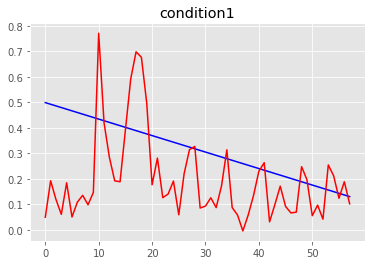

MSE condition1: 0.04398497485529925
R2 condition1: -2.751352231376939


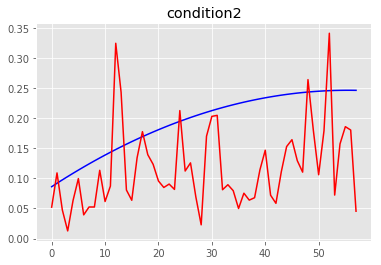

MSE condition2: 0.010942880597722346
R2 condition2: -3.5882116558622217


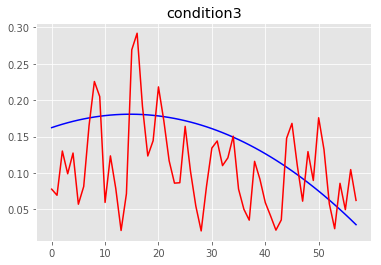

MSE condition3: 0.005038741608581209
R2 condition3: -1.5400937334499734


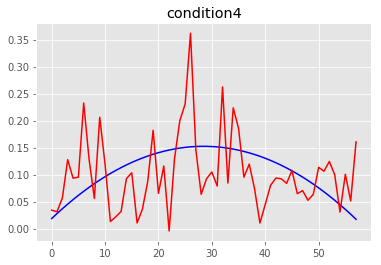

MSE condition4: 0.005208442508723303
R2 condition4: -2.025886274115893
==== the test person number # 1 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.33459042e-09 4.56397210e-09 3.99267593e-09 3.91642910e-09]
Global min values from training is:  [-4.32049330e-09 -4.57

n_neighbors: 30 weights_type:uniform All_MSE: 0.004836922991624589 All_R2: -2.905826945773054
n_neighbors: 30 weights_type:distance All_MSE: 0.004780818252733373 All_R2: -2.860522234218556
The best neighbors is: 30 The best weigths :distance The best mse: 0.004780818252733373
n_neighbors: 31 weights_type:uniform All_MSE: 0.004714549275627955 All_R2: -2.8070098758669033
The best neighbors is: 31 The best weigths :uniform The best mse: 0.004714549275627955
n_neighbors: 31 weights_type:distance All_MSE: 0.004679980001662428 All_R2: -2.779095104020388
The best neighbors is: 31 The best weigths :distance The best mse: 0.004679980001662428
n_neighbors: 32 weights_type:uniform All_MSE: 0.004649285584658131 All_R2: -2.754309288486883
The best neighbors is: 32 The best weigths :uniform The best mse: 0.004649285584658131
n_neighbors: 32 weights_type:distance All_MSE: 0.004622897911985651 All_R2: -2.733001179356579
The best neighbors is: 32 The best weigths :distance The best mse: 0.0046228979119

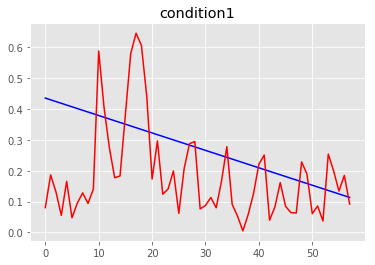

MSE condition1: 0.03126582221932066
R2 condition1: -2.4885573693023186


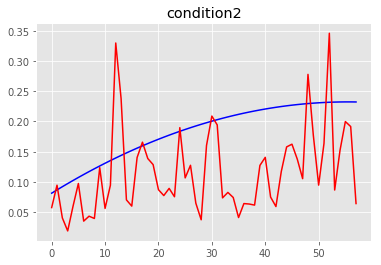

MSE condition2: 0.009378807410332335
R2 condition2: -3.4358449160860065


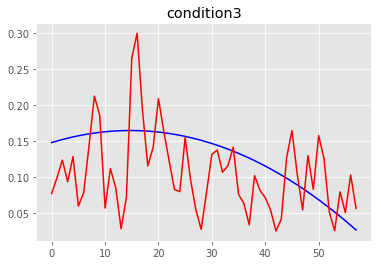

MSE condition3: 0.003882268792614064
R2 condition3: -1.3622750883333596


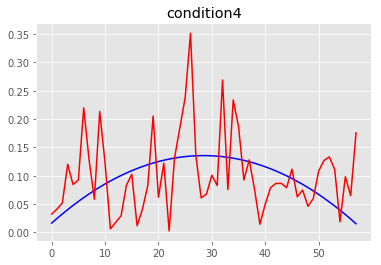

MSE condition4: 0.005225886939453715
R2 condition4: -2.83702731269444
==== the test person number # 1 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.16700742e-09 4.47302806e-09 3.90621965e-09 3.85782026e-09]
Global min values from training is:  [-4.15691746e-09 -4.482

n_neighbors: 30 weights_type:distance All_MSE: 0.07715353149024222 All_R2: -0.4310891218836821
n_neighbors: 31 weights_type:uniform All_MSE: 0.07880814038569195 All_R2: -0.46177978173441825
n_neighbors: 31 weights_type:distance All_MSE: 0.07745043278321016 All_R2: -0.4365962218495907
n_neighbors: 32 weights_type:uniform All_MSE: 0.07821187703069615 All_R2: -0.4507199380094391
n_neighbors: 32 weights_type:distance All_MSE: 0.07697697599760513 All_R2: -0.42781426666913225
n_neighbors: 33 weights_type:uniform All_MSE: 0.07921931338160891 All_R2: -0.46940646051766355
n_neighbors: 33 weights_type:distance All_MSE: 0.07776453672825066 All_R2: -0.44242240673323474
n_neighbors: 34 weights_type:uniform All_MSE: 0.07866001764682015 All_R2: -0.45903231397489175
n_neighbors: 34 weights_type:distance All_MSE: 0.07733619521145144 All_R2: -0.43447727611766385
n_neighbors: 35 weights_type:uniform All_MSE: 0.07853010244540852 All_R2: -0.45662257033884046
n_neighbors: 35 weights_type:distance All_MSE: 0

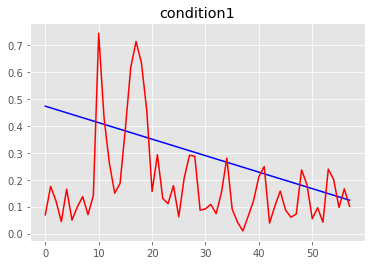

MSE condition1: 0.04101896646636962
R2 condition1: -2.8827225677258017


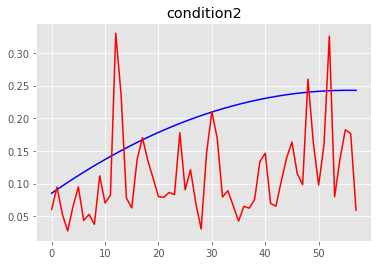

MSE condition2: 0.010896513809782005
R2 condition2: -3.7403176460300154


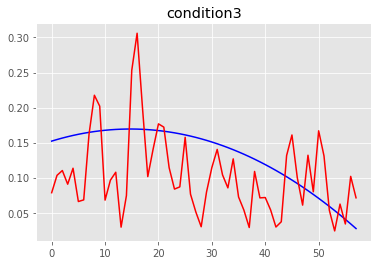

MSE condition3: 0.004305113002050044
R2 condition3: -1.4762971886534642


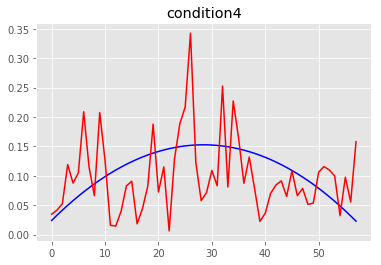

MSE condition4: 0.004732391671193665
R2 condition4: -1.9755913365169726
==== the test person number # 1 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.32292210e-09 4.52755976e-09 3.94341082e-09 3.95794671e-09]
Global min values from training is:  [-4.30775870e-09 -4.5

n_neighbors: 27 weights_type:uniform All_MSE: 0.01310008909426469 All_R2: 0.07595631419222626
n_neighbors: 27 weights_type:distance All_MSE: 0.012798884768969858 All_R2: 0.0972024257968056
n_neighbors: 28 weights_type:uniform All_MSE: 0.013156342719570314 All_R2: 0.0719883406239995
n_neighbors: 28 weights_type:distance All_MSE: 0.012842760512616593 All_R2: 0.0941075534195912
n_neighbors: 29 weights_type:uniform All_MSE: 0.013176776390855537 All_R2: 0.0705470065389322
n_neighbors: 29 weights_type:distance All_MSE: 0.012868425032438778 All_R2: 0.09229724989262045
n_neighbors: 30 weights_type:uniform All_MSE: 0.01315033120072169 All_R2: 0.0724123763686585
n_neighbors: 30 weights_type:distance All_MSE: 0.012856536165270622 All_R2: 0.09313585736766072
n_neighbors: 31 weights_type:uniform All_MSE: 0.013341334400967752 All_R2: 0.05893954424618675
n_neighbors: 31 weights_type:distance All_MSE: 0.01300134220795353 All_R2: 0.0829216436745237
n_neighbors: 32 weights_type:uniform All_MSE: 0.013365

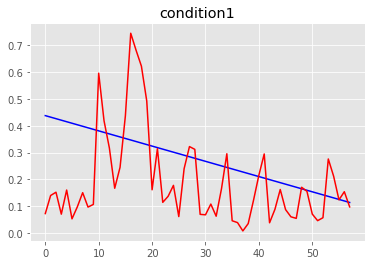

MSE condition1: 0.03521390790148402
R2 condition1: -2.897638069792463


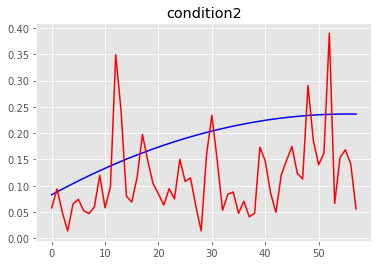

MSE condition2: 0.01066730200554652
R2 condition2: -3.8653710043189236


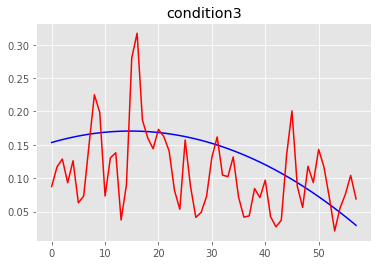

MSE condition3: 0.0041552046563935715
R2 condition3: -1.4181187205032346


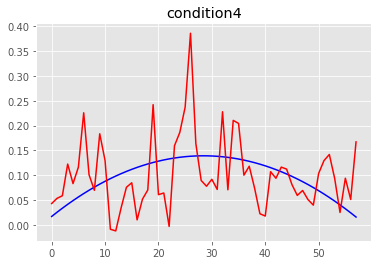

MSE condition4: 0.0055610184917693935
R2 condition4: -2.8982431315628023
==== the test person number # 1 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.90675336e-09 4.13818573e-09 3.68811169e-09 3.65871650e-09]
Global min values from training is:  [-3.90036553e-09 -4.

n_neighbors: 38 weights_type:uniform All_MSE: 8.23056620623296 All_R2: -5.151957231766406
n_neighbors: 38 weights_type:distance All_MSE: 8.026898730055462 All_R2: -4.999725468902156
n_neighbors: 39 weights_type:uniform All_MSE: 8.260067859447567 All_R2: -5.17400831601687
n_neighbors: 39 weights_type:distance All_MSE: 8.055639280924078 All_R2: -5.021207665306485
n_neighbors: 40 weights_type:uniform All_MSE: 8.279397724286527 All_R2: -5.188456471685074
n_neighbors: 40 weights_type:distance All_MSE: 8.075573564146517 All_R2: -5.036107595002391
n_neighbors: 41 weights_type:uniform All_MSE: 8.303649994281917 All_R2: -5.206583891360273
n_neighbors: 41 weights_type:distance All_MSE: 8.099614564930713 All_R2: -5.054077100978933
n_neighbors: 42 weights_type:uniform All_MSE: 8.32610693377215 All_R2: -5.223369386773172
n_neighbors: 42 weights_type:distance All_MSE: 8.12217874738622 All_R2: -5.070942755413611
n_neighbors: 43 weights_type:uniform All_MSE: 8.355295027393966 All_R2: -5.24518610012421

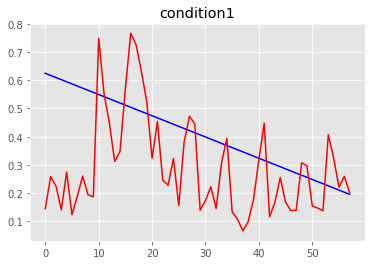

MSE condition1: 0.04704859983880926
R2 condition1: -1.9702492697587273


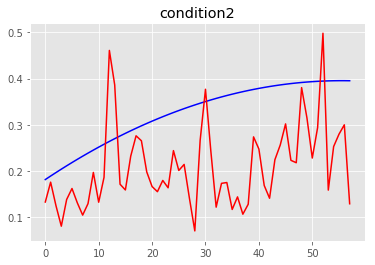

MSE condition2: 0.022087889719950852
R2 condition2: -4.179548279294687


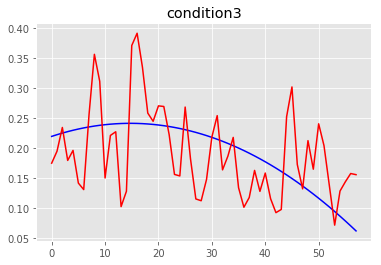

MSE condition3: 0.005397180911123058
R2 condition3: -0.944965991869424


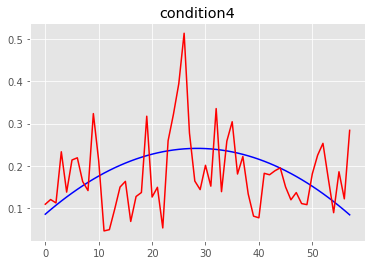

MSE condition4: 0.008398018718577302
R2 condition4: -2.6310946736706002
==== the test person number # 1 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.26394720e-09 4.44915774e-09 3.90288727e-09 3.94759614e-09]
Global min values from training is:  [-4.25083993e-09 -4.4

n_neighbors: 30 weights_type:uniform All_MSE: 0.018929177527513105 All_R2: -0.19036907042033957
n_neighbors: 30 weights_type:distance All_MSE: 0.018476654508143803 All_R2: -0.16191197527568812
n_neighbors: 31 weights_type:uniform All_MSE: 0.018738714047123423 All_R2: -0.178391696560807
n_neighbors: 31 weights_type:distance All_MSE: 0.01833329609476951 All_R2: -0.15289682282031825
n_neighbors: 32 weights_type:uniform All_MSE: 0.01868064215146781 All_R2: -0.17473982165242052
n_neighbors: 32 weights_type:distance All_MSE: 0.018293365634920847 All_R2: -0.15038577952208598
n_neighbors: 33 weights_type:uniform All_MSE: 0.01873457990438783 All_R2: -0.17813171930410898
n_neighbors: 33 weights_type:distance All_MSE: 0.01832885657938007 All_R2: -0.15261764207939255
n_neighbors: 34 weights_type:uniform All_MSE: 0.018705718774842138 All_R2: -0.1763167753690833
n_neighbors: 34 weights_type:distance All_MSE: 0.01830790487972434 All_R2: -0.15130008587777377
n_neighbors: 35 weights_type:uniform All_MS

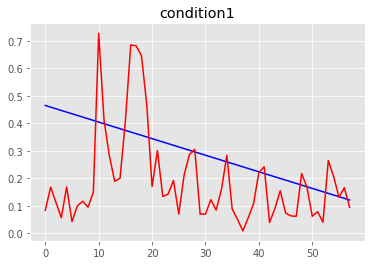

MSE condition1: 0.03886983357848134
R2 condition1: -2.8124985027879257


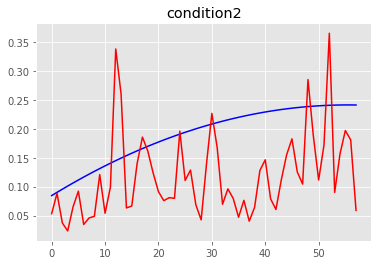

MSE condition2: 0.010488381999411123
R2 condition2: -3.605477185815393


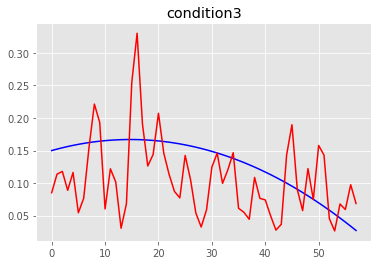

MSE condition3: 0.004250538317347435
R2 condition3: -1.5224838330056398


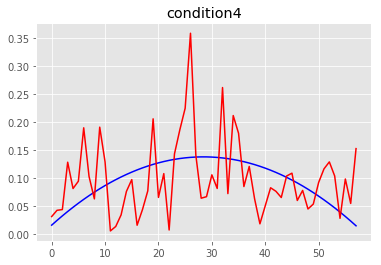

MSE condition4: 0.004717471786709091
R2 condition4: -2.3000925994377766
==== the test person number # 1 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.31829824e-09 4.53770383e-09 3.94960942e-09 4.01671816e-09]
Global min values from training is:  [-4.30679851e-09 -4.5

n_neighbors: 25 weights_type:distance All_MSE: 0.0038623834227736607 All_R2: -0.3852803300262586
n_neighbors: 26 weights_type:uniform All_MSE: 0.0038722088529217825 All_R2: -0.388804313439709
n_neighbors: 26 weights_type:distance All_MSE: 0.0038727619987588414 All_R2: -0.389002704423679
n_neighbors: 27 weights_type:uniform All_MSE: 0.003816073733603692 All_R2: -0.3686709221879454
The best neighbors is: 27 The best weigths :uniform The best mse: 0.003816073733603692
n_neighbors: 27 weights_type:distance All_MSE: 0.0038212349946647474 All_R2: -0.3705220572626906
n_neighbors: 28 weights_type:uniform All_MSE: 0.0038260216969952907 All_R2: -0.3722388533076133
n_neighbors: 28 weights_type:distance All_MSE: 0.0038289041937051276 All_R2: -0.3732726880040751
n_neighbors: 29 weights_type:uniform All_MSE: 0.0037818654761564755 All_R2: -0.35640180724542314
The best neighbors is: 29 The best weigths :uniform The best mse: 0.0037818654761564755
n_neighbors: 29 weights_type:distance All_MSE: 0.003785

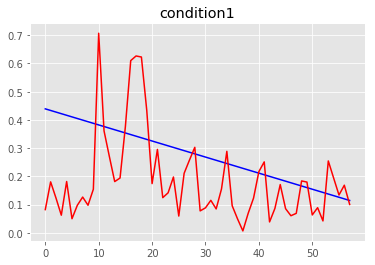

MSE condition1: 0.03239937445125182
R2 condition1: -2.5626960962684735


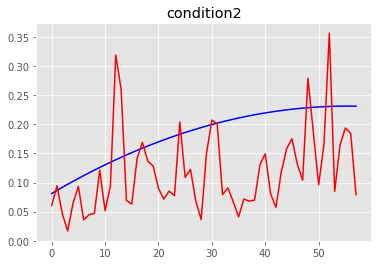

MSE condition2: 0.009053668254579577
R2 condition2: -3.3245945446348983


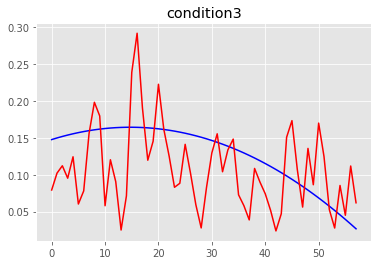

MSE condition3: 0.003802593099345307
R2 condition3: -1.3202550317795332


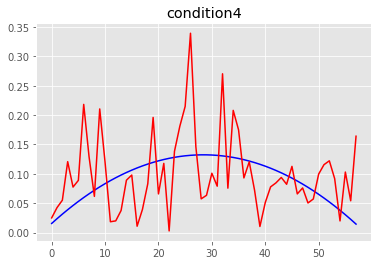

MSE condition4: 0.004729038468847296
R2 condition4: -2.601574799483742
==== the test person number # 1 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06281379e-09 4.29933914e-09 3.61899957e-09 3.80570244e-09]
Global min values from training is:  [-4.04474541e-09 -4.31

n_neighbors: 27 weights_type:uniform All_MSE: 0.28099419534428965 All_R2: 0.4889783185828568
n_neighbors: 27 weights_type:distance All_MSE: 0.2746094771077993 All_R2: 0.5005896952683726
n_neighbors: 28 weights_type:uniform All_MSE: 0.2818064888859019 All_R2: 0.4875010652505224
n_neighbors: 28 weights_type:distance All_MSE: 0.27530189541215966 All_R2: 0.49933044944763716
n_neighbors: 29 weights_type:uniform All_MSE: 0.28238748740869163 All_R2: 0.48644444968003664
n_neighbors: 29 weights_type:distance All_MSE: 0.2755305879371081 All_R2: 0.49891454463336327
n_neighbors: 30 weights_type:uniform All_MSE: 0.28283796343526296 All_R2: 0.4856252049399289
n_neighbors: 30 weights_type:distance All_MSE: 0.27538087363125113 All_R2: 0.4991868180738075
n_neighbors: 31 weights_type:uniform All_MSE: 0.28273299007985764 All_R2: 0.48581611159021576
n_neighbors: 31 weights_type:distance All_MSE: 0.2749716226692663 All_R2: 0.4999310900843337
n_neighbors: 32 weights_type:uniform All_MSE: 0.2855546096352565 

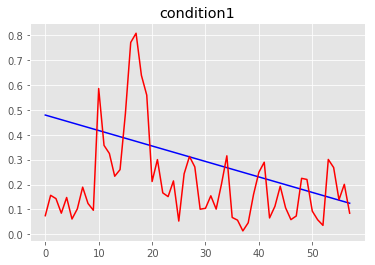

MSE condition1: 0.04007975202473867
R2 condition1: -2.6964444201868587


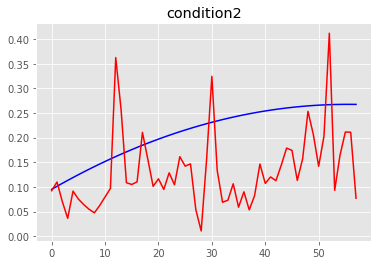

MSE condition2: 0.012485986782600414
R2 condition2: -3.5277977716578928


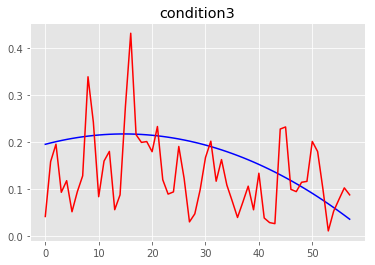

MSE condition3: 0.008291441116207207
R2 condition3: -1.9162304871307785


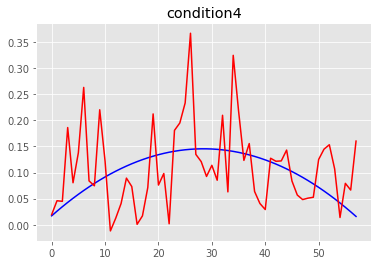

MSE condition4: 0.006383990611558057
R2 condition4: -3.0254492133943742
==== the test person number # 1 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.36537212e-09 4.59383674e-09 4.03474151e-09 4.07208662e-09]
Global min values from training is:  [-4.35296145e-09 -4.6

n_neighbors: 24 weights_type:distance All_MSE: 0.0023610747855754843 All_R2: 0.257049577992844
The best neighbors is: 24 The best weigths :distance The best mse: 0.0023610747855754843
n_neighbors: 25 weights_type:uniform All_MSE: 0.002415450767550866 All_R2: 0.23993929457341523
n_neighbors: 25 weights_type:distance All_MSE: 0.002347399343101136 All_R2: 0.2613527774592578
The best neighbors is: 25 The best weigths :distance The best mse: 0.002347399343101136
n_neighbors: 26 weights_type:uniform All_MSE: 0.00238743193653392 All_R2: 0.24875587355488682
n_neighbors: 26 weights_type:distance All_MSE: 0.002324157210128236 All_R2: 0.2686662910362342
The best neighbors is: 26 The best weigths :distance The best mse: 0.002324157210128236
n_neighbors: 27 weights_type:uniform All_MSE: 0.0023362141541514742 All_R2: 0.2648723783211828
n_neighbors: 27 weights_type:distance All_MSE: 0.0022807158361326757 All_R2: 0.28233582295438786
The best neighbors is: 27 The best weigths :distance The best mse: 0.

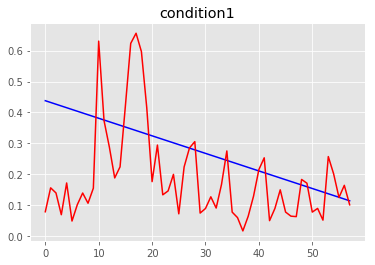

MSE condition1: 0.030794097819984757
R2 condition1: -2.403569379112233


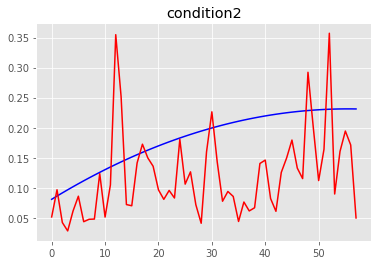

MSE condition2: 0.008987107142364135
R2 condition2: -3.2831115322560596


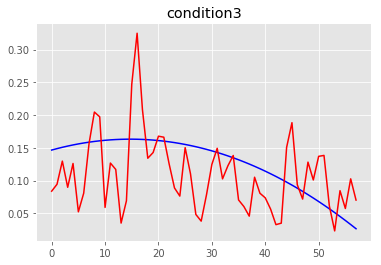

MSE condition3: 0.003765311880309822
R2 condition3: -1.3330631760176388


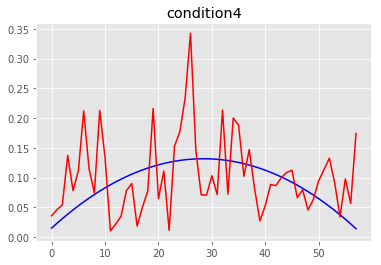

MSE condition4: 0.004625871498268156
R2 condition4: -2.5534804269402804
==== the test person number # 2 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.24860551e-09 4.04936959e-09 3.85586975e-09 3.75710059e-09]
Global min values from training is:  [-4.23942601e-09 -4.0

n_neighbors: 28 weights_type:uniform All_MSE: 0.08527748891373914 All_R2: -0.7198548345124021
The best neighbors is: 28 The best weigths :uniform The best mse: 0.08527748891373914
n_neighbors: 28 weights_type:distance All_MSE: 0.08644220938788787 All_R2: -0.7433446225424709
n_neighbors: 29 weights_type:uniform All_MSE: 0.08522384621805172 All_R2: -0.7187729821890112
The best neighbors is: 29 The best weigths :uniform The best mse: 0.08522384621805172
n_neighbors: 29 weights_type:distance All_MSE: 0.08631246126149898 All_R2: -0.7407278951354928
n_neighbors: 30 weights_type:uniform All_MSE: 0.08369376685276447 All_R2: -0.6879147284212577
The best neighbors is: 30 The best weigths :uniform The best mse: 0.08369376685276447
n_neighbors: 30 weights_type:distance All_MSE: 0.08502135384170655 All_R2: -0.7146891671418603
n_neighbors: 31 weights_type:uniform All_MSE: 0.08340260945723613 All_R2: -0.6820427396856374
The best neighbors is: 31 The best weigths :uniform The best mse: 0.0834026094572

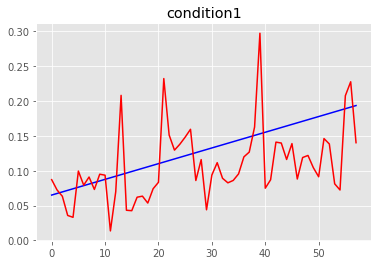

MSE condition1: 0.0029395977450098333
R2 condition1: -1.0719617617669384


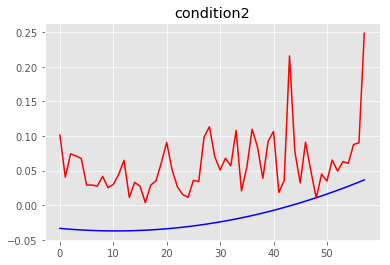

MSE condition2: 0.007453918832523422
R2 condition2: -14.077355301908039


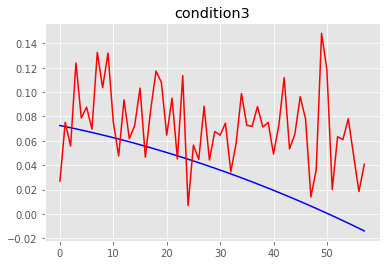

MSE condition3: 0.002610665147277529
R2 condition3: -2.997259544785801


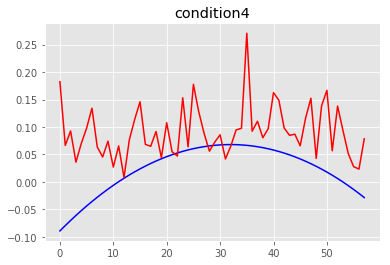

MSE condition4: 0.00798023326036098
R2 condition4: -3.425116181507157
==== the test person number # 2 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30403955e-09 4.52059424e-09 4.01752881e-09 3.97219028e-09]
Global min values from training is:  [-4.29175015e-09 -4.530

n_neighbors: 25 weights_type:distance All_MSE: 0.013051398159040554 All_R2: -0.5017932187058403
n_neighbors: 26 weights_type:uniform All_MSE: 0.012975629168582687 All_R2: -0.4930746619143602
The best neighbors is: 26 The best weigths :uniform The best mse: 0.012975629168582687
n_neighbors: 26 weights_type:distance All_MSE: 0.013014417602446858 All_R2: -0.4975379543702021
n_neighbors: 27 weights_type:uniform All_MSE: 0.012809443408406427 All_R2: -0.4739520633515921
The best neighbors is: 27 The best weigths :uniform The best mse: 0.012809443408406427
n_neighbors: 27 weights_type:distance All_MSE: 0.012872241689918094 All_R2: -0.48117811163939783
n_neighbors: 28 weights_type:uniform All_MSE: 0.012516490511683846 All_R2: -0.4402426731133171
The best neighbors is: 28 The best weigths :uniform The best mse: 0.012516490511683846
n_neighbors: 28 weights_type:distance All_MSE: 0.012628155592870083 All_R2: -0.45309170734307624
n_neighbors: 29 weights_type:uniform All_MSE: 0.012482848067434809 A

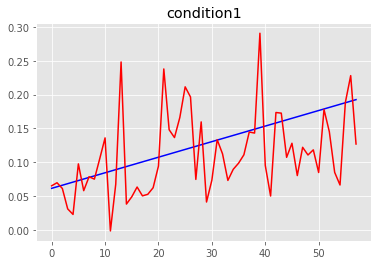

MSE condition1: 0.0035956952451422605
R2 condition1: -1.4240397611380753


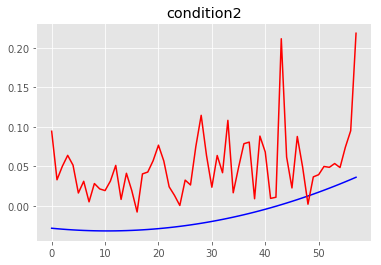

MSE condition2: 0.005556824692860802
R2 condition2: -12.209016620847525


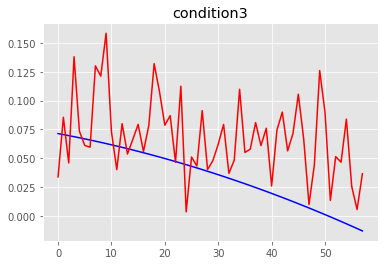

MSE condition3: 0.002323583525441668
R2 condition3: -2.7322589770517633


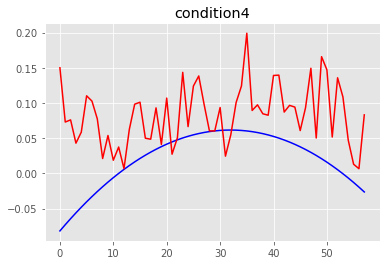

MSE condition4: 0.006551660437764598
R2 condition4: -3.371794463753748
==== the test person number # 2 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.34526988e-09 4.52527169e-09 4.07010357e-09 3.92967423e-09]
Global min values from training is:  [-4.33645601e-09 -4.53

n_neighbors: 25 weights_type:distance All_MSE: 0.007349412390917679 All_R2: 0.3206096236614864
The best neighbors is: 25 The best weigths :distance The best mse: 0.007349412390917679
n_neighbors: 26 weights_type:uniform All_MSE: 0.007350060989498484 All_R2: 0.32054966626483106
n_neighbors: 26 weights_type:distance All_MSE: 0.007311040713114181 All_R2: 0.3241567573964058
The best neighbors is: 26 The best weigths :distance The best mse: 0.007311040713114181
n_neighbors: 27 weights_type:uniform All_MSE: 0.0072963634869961476 All_R2: 0.3255135415371705
The best neighbors is: 27 The best weigths :uniform The best mse: 0.0072963634869961476
n_neighbors: 27 weights_type:distance All_MSE: 0.007266986345214954 All_R2: 0.3282292072732692
The best neighbors is: 27 The best weigths :distance The best mse: 0.007266986345214954
n_neighbors: 28 weights_type:uniform All_MSE: 0.0072747789684241785 All_R2: 0.3275088458439226
n_neighbors: 28 weights_type:distance All_MSE: 0.007241553220598211 All_R2: 0.

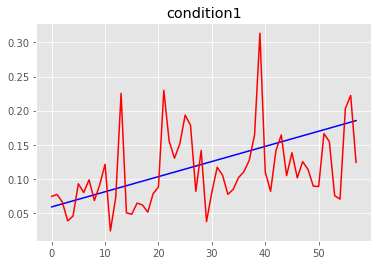

MSE condition1: 0.0029677079258742514
R2 condition1: -1.1498869945568746


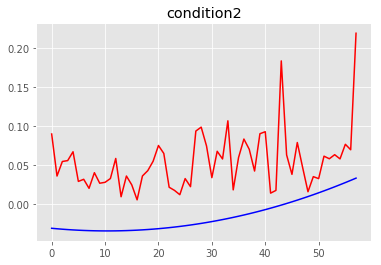

MSE condition2: 0.006110496220770534
R2 condition2: -13.67577336757322


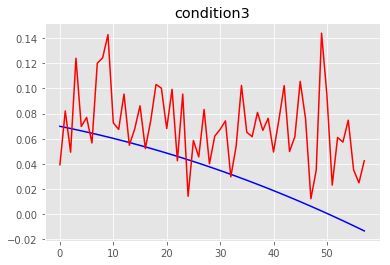

MSE condition3: 0.0023795430960097414
R2 condition3: -2.921524088237827


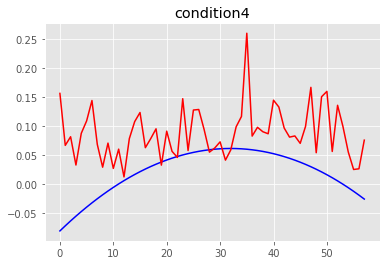

MSE condition4: 0.007434725840712754
R2 condition4: -4.049252851264956
==== the test person number # 2 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43148270e-09 4.64608756e-09 4.05597833e-09 4.01395501e-09]
Global min values from training is:  [-4.42027053e-09 -4.65

n_neighbors: 29 weights_type:uniform All_MSE: 0.0035577821305112743 All_R2: -4.543804417189609
n_neighbors: 29 weights_type:distance All_MSE: 0.0035125407731894836 All_R2: -4.473308465678335
n_neighbors: 30 weights_type:uniform All_MSE: 0.003534443054362244 All_R2: -4.507437020676342
n_neighbors: 30 weights_type:distance All_MSE: 0.003493692607035369 All_R2: -4.443938891334533
n_neighbors: 31 weights_type:uniform All_MSE: 0.0035623351658519518 All_R2: -4.550899044265505
n_neighbors: 31 weights_type:distance All_MSE: 0.0035163869410801585 All_R2: -4.479301638323371
n_neighbors: 32 weights_type:uniform All_MSE: 0.0036210222394542227 All_R2: -4.64234636901258
n_neighbors: 32 weights_type:distance All_MSE: 0.003560951955475547 All_R2: -4.548743699302459
n_neighbors: 33 weights_type:uniform All_MSE: 0.0036120503503121746 All_R2: -4.628366199111317
n_neighbors: 33 weights_type:distance All_MSE: 0.003554995526242907 All_R2: -4.5394622769220945
n_neighbors: 34 weights_type:uniform All_MSE: 0.0

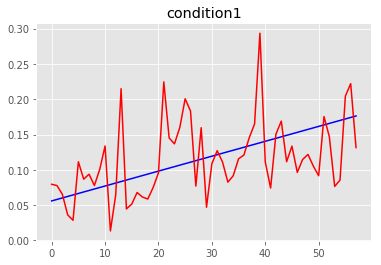

MSE condition1: 0.002630150327101001
R2 condition1: -1.106212873480553


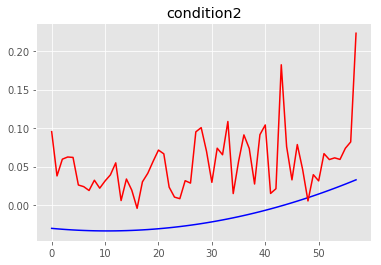

MSE condition2: 0.006161185360475923
R2 condition2: -14.347653898830702


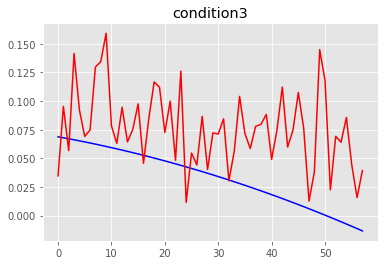

MSE condition3: 0.003055793778033808
R2 condition3: -4.182119014971123


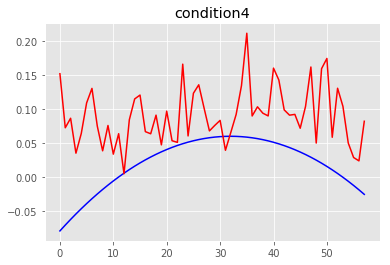

MSE condition4: 0.007529261687114773
R2 condition4: -4.301334051181738
==== the test person number # 2 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41198493e-09 4.36696487e-09 4.04903982e-09 3.96915186e-09]
Global min values from training is:  [-4.40172199e-09 -4.36

n_neighbors: 28 weights_type:distance All_MSE: 0.006268904613164491 All_R2: -5.187666131938264
n_neighbors: 29 weights_type:uniform All_MSE: 0.006268932829919377 All_R2: -5.187693983033365
n_neighbors: 29 weights_type:distance All_MSE: 0.006329196504074224 All_R2: -5.2471767026732605
n_neighbors: 30 weights_type:uniform All_MSE: 0.006163513186167765 All_R2: -5.083640468179585
The best neighbors is: 30 The best weigths :uniform The best mse: 0.006163513186167765
n_neighbors: 30 weights_type:distance All_MSE: 0.006226528574812134 All_R2: -5.145839242952274
n_neighbors: 31 weights_type:uniform All_MSE: 0.006269407697861984 All_R2: -5.188162697181518
n_neighbors: 31 weights_type:distance All_MSE: 0.00632609056852956 All_R2: -5.244111016821646
n_neighbors: 32 weights_type:uniform All_MSE: 0.006108176733353909 All_R2: -5.02902111821869
The best neighbors is: 32 The best weigths :uniform The best mse: 0.006108176733353909
n_neighbors: 32 weights_type:distance All_MSE: 0.00617818433096757 All_

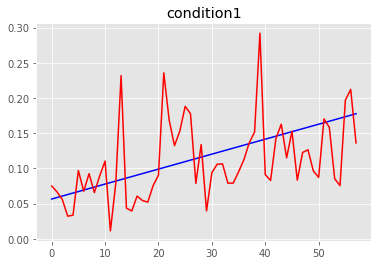

MSE condition1: 0.0027557156840771657
R2 condition1: -1.1762457349875515


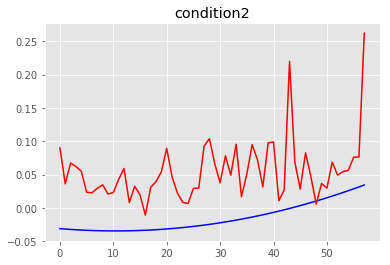

MSE condition2: 0.006621090838405369
R2 condition2: -14.306586375478284


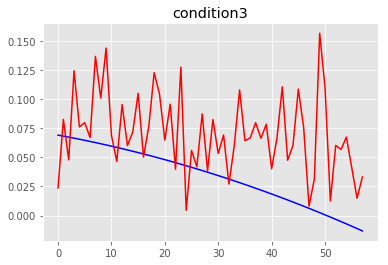

MSE condition3: 0.0026983469873483983
R2 condition3: -3.5383900700719497


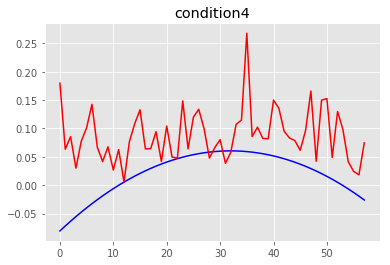

MSE condition4: 0.007617257889212488
R2 condition4: -4.234499036263648
==== the test person number # 2 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41260161e-09 4.63353955e-09 4.07070093e-09 3.98832699e-09]
Global min values from training is:  [-4.40206211e-09 -4.64

n_neighbors: 26 weights_type:distance All_MSE: 0.0034709543358728565 All_R2: -2.9130032509504153
n_neighbors: 27 weights_type:uniform All_MSE: 0.0035026830622741055 All_R2: -2.9487728398134685
n_neighbors: 27 weights_type:distance All_MSE: 0.0035069385409796307 All_R2: -2.9535702817841023
n_neighbors: 28 weights_type:uniform All_MSE: 0.003572755934803018 All_R2: -3.027769954576753
n_neighbors: 28 weights_type:distance All_MSE: 0.003560754326365897 All_R2: -3.0142398621910003
n_neighbors: 29 weights_type:uniform All_MSE: 0.0035631504250553574 All_R2: -3.0169411198435583
n_neighbors: 29 weights_type:distance All_MSE: 0.0035463716799305984 All_R2: -2.9980254909222865
n_neighbors: 30 weights_type:uniform All_MSE: 0.003528800377108257 All_R2: -2.978216366856134
n_neighbors: 30 weights_type:distance All_MSE: 0.0035152804315551514 All_R2: -2.962974567113853
n_neighbors: 31 weights_type:uniform All_MSE: 0.0035381409868205918 All_R2: -2.9887465647882925
n_neighbors: 31 weights_type:distance All

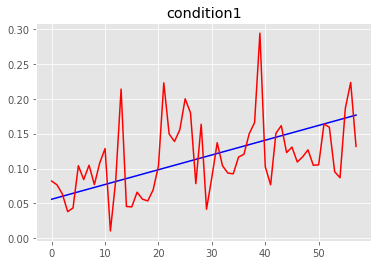

MSE condition1: 0.0025020143464647856
R2 condition1: -0.9955539687466937


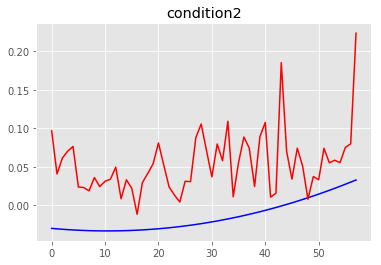

MSE condition2: 0.006181078445202792
R2 condition2: -14.479874515769003


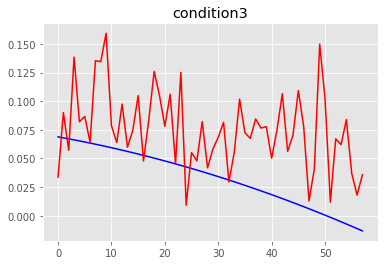

MSE condition3: 0.0029576049062692102
R2 condition3: -4.022601994344813


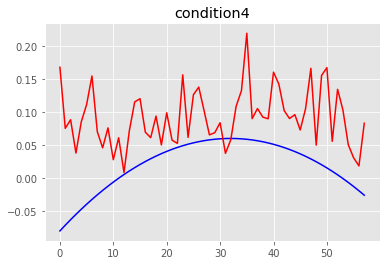

MSE condition4: 0.007928895993313118
R2 condition4: -4.55133398720552
==== the test person number # 2 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.00814426e-09 4.28300560e-09 3.71486941e-09 3.60225353e-09]
Global min values from training is:  [-4.00119784e-09 -4.293

n_neighbors: 28 weights_type:uniform All_MSE: 0.25518895505637457 All_R2: -4.660858668606899
The best neighbors is: 28 The best weigths :uniform The best mse: 0.25518895505637457
n_neighbors: 28 weights_type:distance All_MSE: 0.2596945104800568 All_R2: -4.7608054412695555
n_neighbors: 29 weights_type:uniform All_MSE: 0.24911973549922867 All_R2: -4.5262251217350995
The best neighbors is: 29 The best weigths :uniform The best mse: 0.24911973549922867
n_neighbors: 29 weights_type:distance All_MSE: 0.2544123281960721 All_R2: -4.643630748638949
n_neighbors: 30 weights_type:uniform All_MSE: 0.24525788127907483 All_R2: -4.440557578113455
The best neighbors is: 30 The best weigths :uniform The best mse: 0.24525788127907483
n_neighbors: 30 weights_type:distance All_MSE: 0.25094755336588537 All_R2: -4.566771620359275
n_neighbors: 31 weights_type:uniform All_MSE: 0.23544959288408898 All_R2: -4.222980236756003
The best neighbors is: 31 The best weigths :uniform The best mse: 0.23544959288408898
n_

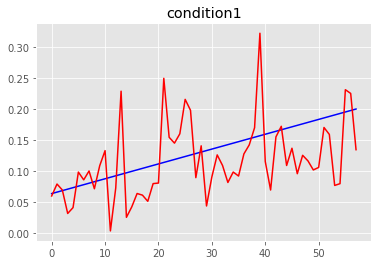

MSE condition1: 0.0035896725080540935
R2 condition1: -1.233074366169487


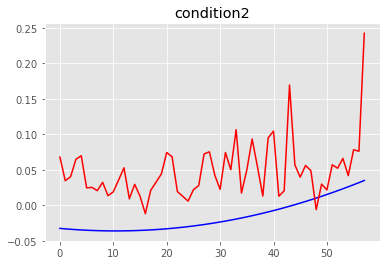

MSE condition2: 0.005598468481546533
R2 condition2: -11.161407823795642


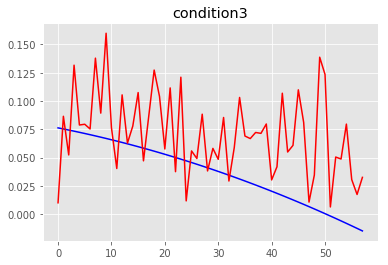

MSE condition3: 0.0025705677661739565
R2 condition3: -2.552831721571484


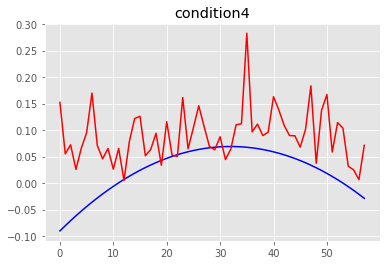

MSE condition4: 0.007638357470310013
R2 condition4: -3.1232759288075256
==== the test person number # 2 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.38785393e-09 4.60737639e-09 4.05236409e-09 3.87663191e-09]
Global min values from training is:  [-4.37596550e-09 -4.6

n_neighbors: 31 weights_type:uniform All_MSE: 0.004963970071933835 All_R2: -3.0906497591045534
The best neighbors is: 31 The best weigths :uniform The best mse: 0.004963970071933835
n_neighbors: 31 weights_type:distance All_MSE: 0.004940957691727647 All_R2: -3.071685988940204
The best neighbors is: 31 The best weigths :distance The best mse: 0.004940957691727647
n_neighbors: 32 weights_type:uniform All_MSE: 0.005050960709765695 All_R2: -3.162335975285269
n_neighbors: 32 weights_type:distance All_MSE: 0.005010584003396796 All_R2: -3.1290628165458116
n_neighbors: 33 weights_type:uniform All_MSE: 0.004958283907977797 All_R2: -3.0859639723492087
n_neighbors: 33 weights_type:distance All_MSE: 0.004929910843625724 All_R2: -3.0625826329827426
The best neighbors is: 33 The best weigths :distance The best mse: 0.004929910843625724
n_neighbors: 34 weights_type:uniform All_MSE: 0.004865079409317976 All_R2: -3.009157111214825
The best neighbors is: 34 The best weigths :uniform The best mse: 0.0048

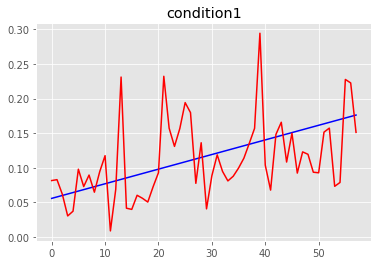

MSE condition1: 0.0028350390674704963
R2 condition1: -1.2677284877134918


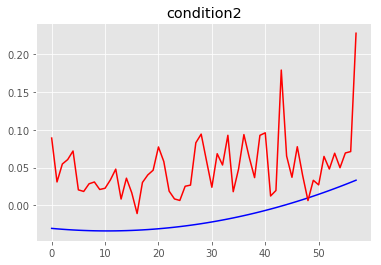

MSE condition2: 0.005651934347494362
R2 condition2: -12.806454967474332


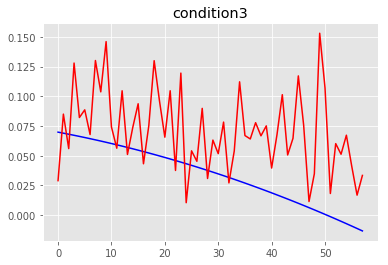

MSE condition3: 0.0026205567929168255
R2 condition3: -3.349534944999956


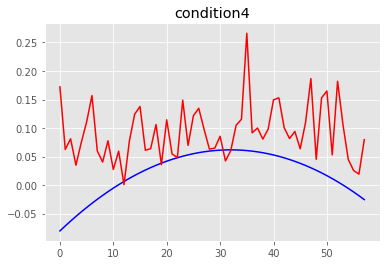

MSE condition4: 0.008298161328492608
R2 condition4: -4.630076416471901
==== the test person number # 2 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.22027093e-09 4.51643236e-09 3.96590781e-09 3.81802306e-09]
Global min values from training is:  [-4.21238966e-09 -4.52

n_neighbors: 30 weights_type:distance All_MSE: 0.06809571417188823 All_R2: -0.408803902644844
n_neighbors: 31 weights_type:uniform All_MSE: 0.06901735199239954 All_R2: -0.4278712841115244
n_neighbors: 31 weights_type:distance All_MSE: 0.06788131759943182 All_R2: -0.4043683411463943
n_neighbors: 32 weights_type:uniform All_MSE: 0.06879904544327589 All_R2: -0.42335483073235847
n_neighbors: 32 weights_type:distance All_MSE: 0.06767762129046033 All_R2: -0.40015415294786805
n_neighbors: 33 weights_type:uniform All_MSE: 0.0681740631999175 All_R2: -0.41042483309249955
n_neighbors: 33 weights_type:distance All_MSE: 0.06718886919304239 All_R2: -0.3900425641255496
n_neighbors: 34 weights_type:uniform All_MSE: 0.06833921914199186 All_R2: -0.41384167567310626
n_neighbors: 34 weights_type:distance All_MSE: 0.06733595993385624 All_R2: -0.39308566327241223
n_neighbors: 35 weights_type:uniform All_MSE: 0.06822555381327741 All_R2: -0.411490100972177
n_neighbors: 35 weights_type:distance All_MSE: 0.0672

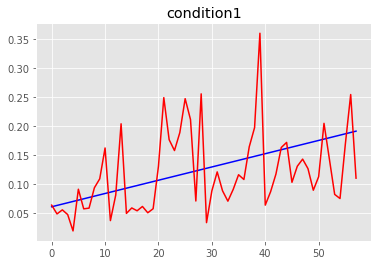

MSE condition1: 0.004295225972777656
R2 condition1: -1.9449445523291096


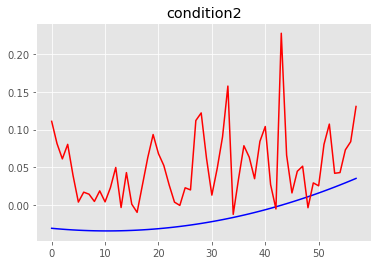

MSE condition2: 0.0063812975608993775
R2 condition2: -13.368494765329453


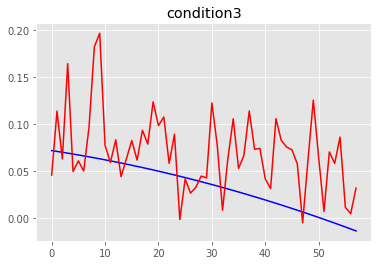

MSE condition3: 0.002835171702181922
R2 condition3: -3.454946776726173


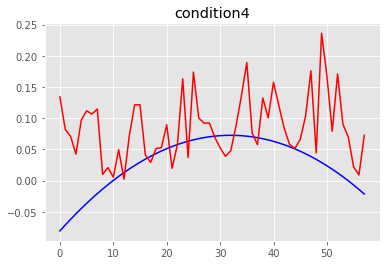

MSE condition4: 0.006969528800123211
R2 condition4: -3.0639855028764327
==== the test person number # 2 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37618561e-09 4.57096406e-09 4.00309898e-09 3.91814952e-09]
Global min values from training is:  [-4.36323090e-09 -4.5

n_neighbors: 29 weights_type:uniform All_MSE: 0.011824011500254831 All_R2: 0.12997505411269883
n_neighbors: 29 weights_type:distance All_MSE: 0.011529282883475205 All_R2: 0.15166153918247471
n_neighbors: 30 weights_type:uniform All_MSE: 0.01189658556381807 All_R2: 0.12463496748278746
n_neighbors: 30 weights_type:distance All_MSE: 0.011560349913317869 All_R2: 0.14937558987016553
n_neighbors: 31 weights_type:uniform All_MSE: 0.011869781876457574 All_R2: 0.12660721494253446
n_neighbors: 31 weights_type:distance All_MSE: 0.011552778191070553 All_R2: 0.14993272627335252
n_neighbors: 32 weights_type:uniform All_MSE: 0.012038100936047872 All_R2: 0.11422209668476757
n_neighbors: 32 weights_type:distance All_MSE: 0.011684627435897639 All_R2: 0.14023110072152567
n_neighbors: 33 weights_type:uniform All_MSE: 0.012035384241651887 All_R2: 0.11442199431636313
n_neighbors: 33 weights_type:distance All_MSE: 0.011688875139635905 All_R2: 0.1399185495864942
n_neighbors: 34 weights_type:uniform All_MSE: 0

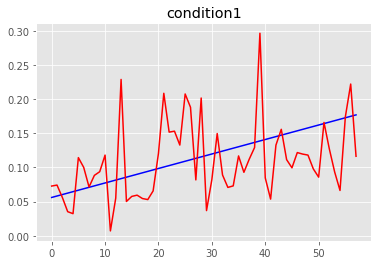

MSE condition1: 0.0030983266529161033
R2 condition1: -1.4596965730511058


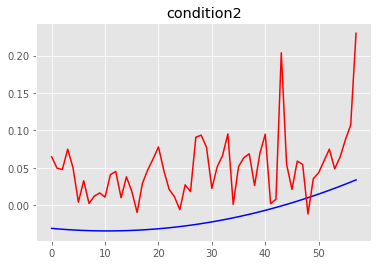

MSE condition2: 0.005703578477801232
R2 condition2: -12.448153326398403


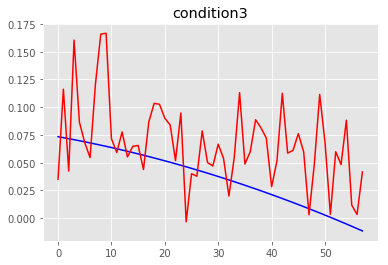

MSE condition3: 0.002197208232883285
R2 condition3: -2.4919421506319503


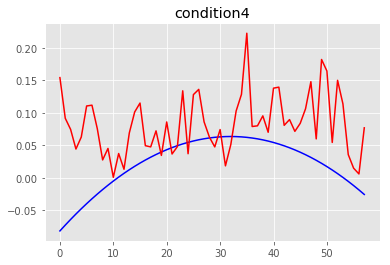

MSE condition4: 0.0068642178896339565
R2 condition4: -3.450989268924645
==== the test person number # 2 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.96001687e-09 4.18159003e-09 3.74779986e-09 3.61891930e-09]
Global min values from training is:  [-3.95583773e-09 -4.1

n_neighbors: 38 weights_type:uniform All_MSE: 7.603101175898393 All_R2: -4.984769856391936
n_neighbors: 38 weights_type:distance All_MSE: 7.41974826640539 All_R2: -4.840443884603744
n_neighbors: 39 weights_type:uniform All_MSE: 7.629240785778831 All_R2: -5.0053456116858674
n_neighbors: 39 weights_type:distance All_MSE: 7.44525991964391 All_R2: -4.860525344754849
n_neighbors: 40 weights_type:uniform All_MSE: 7.652489237210643 All_R2: -5.023645595878891
n_neighbors: 40 weights_type:distance All_MSE: 7.468434872653716 All_R2: -4.878767474773589
n_neighbors: 41 weights_type:uniform All_MSE: 7.677254545727394 All_R2: -5.043139571885042
n_neighbors: 41 weights_type:distance All_MSE: 7.492659792696451 All_R2: -4.897836084790888
n_neighbors: 42 weights_type:uniform All_MSE: 7.696562978244825 All_R2: -5.058338176011317
n_neighbors: 42 weights_type:distance All_MSE: 7.512453526857061 All_R2: -4.913416693388518
n_neighbors: 43 weights_type:uniform All_MSE: 7.723504640087182 All_R2: -5.07954526532

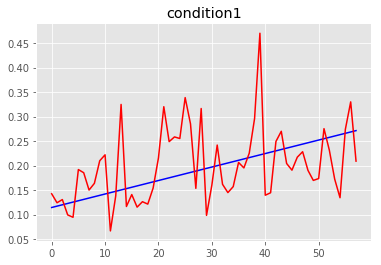

MSE condition1: 0.005424174060273308
R2 condition1: -1.5535472235403494


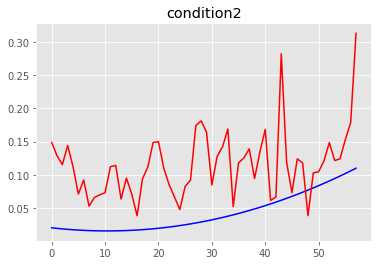

MSE condition2: 0.007609907968141026
R2 condition2: -8.411225820434472


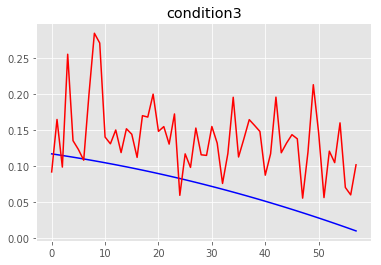

MSE condition3: 0.006784723747611018
R2 condition3: -5.773028295463752


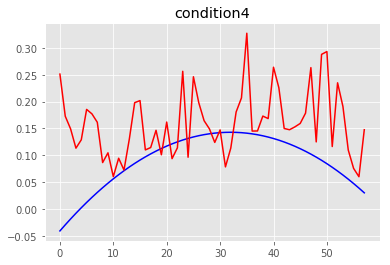

MSE condition4: 0.010146296628162195
R2 condition4: -3.108771175020152
==== the test person number # 2 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.31721071e-09 4.49256203e-09 3.96257543e-09 3.90779894e-09]
Global min values from training is:  [-4.30631213e-09 -4.50

n_neighbors: 29 weights_type:distance All_MSE: 0.016190896192020902 All_R2: -0.13806030525723223
n_neighbors: 30 weights_type:uniform All_MSE: 0.016498081063489312 All_R2: -0.15965237183882297
n_neighbors: 30 weights_type:distance All_MSE: 0.016096183791247613 All_R2: -0.13140295766773802
n_neighbors: 31 weights_type:uniform All_MSE: 0.016505016624469012 All_R2: -0.16013987336758828
n_neighbors: 31 weights_type:distance All_MSE: 0.01610702919463248 All_R2: -0.13216528255330573
n_neighbors: 32 weights_type:uniform All_MSE: 0.016268216333434452 All_R2: -0.14349514856028556
n_neighbors: 32 weights_type:distance All_MSE: 0.01592285922770622 All_R2: -0.11921995041766986
n_neighbors: 33 weights_type:uniform All_MSE: 0.016225569565070347 All_R2: -0.1404975013857821
n_neighbors: 33 weights_type:distance All_MSE: 0.01589446546655126 All_R2: -0.11722414906707268
n_neighbors: 34 weights_type:uniform All_MSE: 0.016192416828109974 All_R2: -0.13816719097567476
n_neighbors: 34 weights_type:distance A

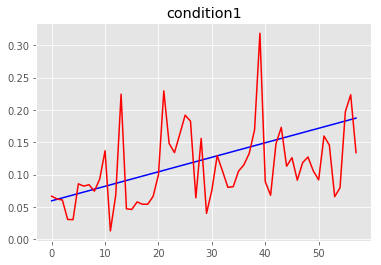

MSE condition1: 0.00318936761292428
R2 condition1: -1.2606952520134382


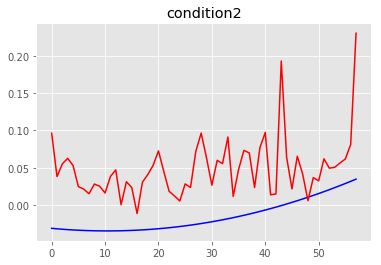

MSE condition2: 0.005552044230326882
R2 condition2: -11.615265180364968


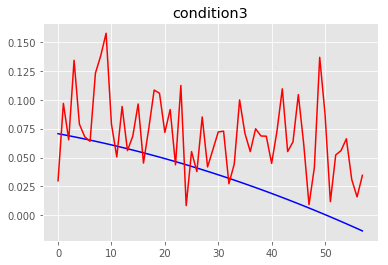

MSE condition3: 0.0023655015230261496
R2 condition3: -2.83172829776993


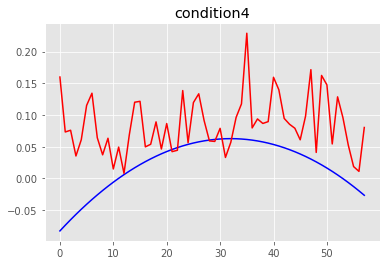

MSE condition4: 0.00702747546852457
R2 condition4: -3.5476551621843635
==== the test person number # 2 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37156176e-09 4.58110812e-09 4.00929758e-09 3.97692096e-09]
Global min values from training is:  [-4.36227072e-09 -4.59

n_neighbors: 23 weights_type:uniform All_MSE: 0.003971703761332387 All_R2: -0.5146512826940264
n_neighbors: 23 weights_type:distance All_MSE: 0.003972625566052396 All_R2: -0.5150028226842815
n_neighbors: 24 weights_type:uniform All_MSE: 0.0039930888105304254 All_R2: -0.5228066976355019
n_neighbors: 24 weights_type:distance All_MSE: 0.003989241751830378 All_R2: -0.521339581066699
n_neighbors: 25 weights_type:uniform All_MSE: 0.003996116773809409 All_R2: -0.5239614434927113
n_neighbors: 25 weights_type:distance All_MSE: 0.003986657427875875 All_R2: -0.520354021763235
n_neighbors: 26 weights_type:uniform All_MSE: 0.0039968618063271075 All_R2: -0.5242455695319108
n_neighbors: 26 weights_type:distance All_MSE: 0.003981121244065519 All_R2: -0.5182427394487723
n_neighbors: 27 weights_type:uniform All_MSE: 0.004015906589675235 All_R2: -0.5315084993122514
n_neighbors: 27 weights_type:distance All_MSE: 0.00399643765778779 All_R2: -0.52408381599546
n_neighbors: 28 weights_type:uniform All_MSE: 0.

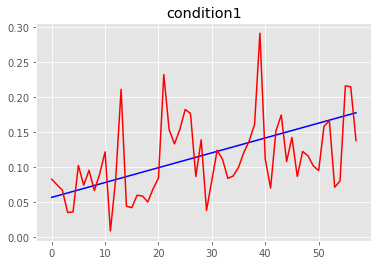

MSE condition1: 0.002666438736547096
R2 condition1: -1.1038439437107588


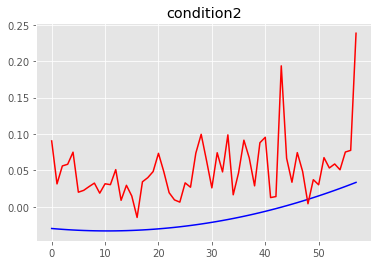

MSE condition2: 0.0057982524869106275
R2 condition2: -13.301028753994686


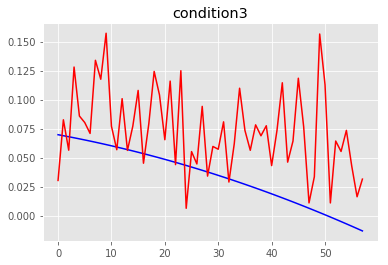

MSE condition3: 0.002896270448844502
R2 condition3: -3.8202332750775323


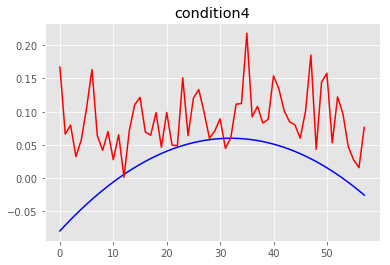

MSE condition4: 0.007370226259422948
R2 condition4: -4.182594161416008
==== the test person number # 2 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.11607731e-09 4.34274343e-09 3.67868774e-09 3.76590524e-09]
Global min values from training is:  [-4.10021761e-09 -4.35

n_neighbors: 25 weights_type:distance All_MSE: 0.26076183166109795 All_R2: 0.4933932877828239
n_neighbors: 26 weights_type:uniform All_MSE: 0.2644569607804743 All_R2: 0.48621441040471847
n_neighbors: 26 weights_type:distance All_MSE: 0.25990258111787967 All_R2: 0.4950626352095454
n_neighbors: 27 weights_type:uniform All_MSE: 0.269246006748289 All_R2: 0.47691027713890866
n_neighbors: 27 weights_type:distance All_MSE: 0.2635310810305958 All_R2: 0.48801320470297316
n_neighbors: 28 weights_type:uniform All_MSE: 0.26736539889537253 All_R2: 0.48056391216389205
n_neighbors: 28 weights_type:distance All_MSE: 0.26188477756006756 All_R2: 0.4912116344087438
n_neighbors: 29 weights_type:uniform All_MSE: 0.2723644751714033 All_R2: 0.4708517331222358
n_neighbors: 29 weights_type:distance All_MSE: 0.26574456393651713 All_R2: 0.4837128617794155
n_neighbors: 30 weights_type:uniform All_MSE: 0.27720412177122666 All_R2: 0.46144929321524786
n_neighbors: 30 weights_type:distance All_MSE: 0.2691920923499852

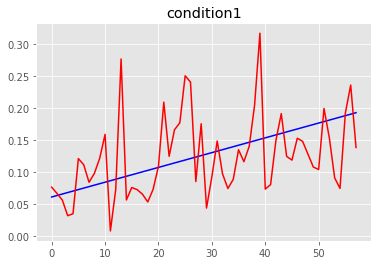

MSE condition1: 0.003763977537621902
R2 condition1: -1.5187590558297939


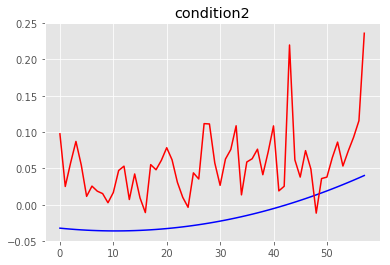

MSE condition2: 0.006724379024530564
R2 condition2: -11.683826967669784


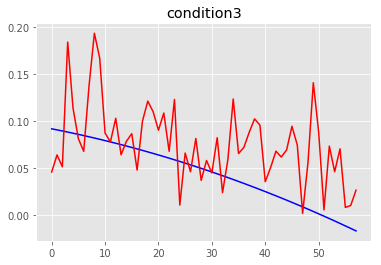

MSE condition3: 0.0024976401128842976
R2 condition3: -1.435462399178793


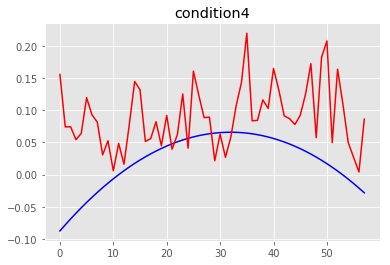

MSE condition4: 0.008014871868743894
R2 condition4: -3.6864641383674375
==== the test person number # 2 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41863563e-09 4.63724104e-09 4.09442967e-09 4.03228943e-09]
Global min values from training is:  [-4.40843365e-09 -4.6

n_neighbors: 23 weights_type:uniform All_MSE: 0.002665182401255324 All_R2: 0.08947047014485154
n_neighbors: 23 weights_type:distance All_MSE: 0.0025841652260875318 All_R2: 0.11714907494915194
n_neighbors: 24 weights_type:uniform All_MSE: 0.0026428658470137316 All_R2: 0.0970946693861543
n_neighbors: 24 weights_type:distance All_MSE: 0.0025670222568381696 All_R2: 0.1230057771859634
The best neighbors is: 24 The best weigths :distance The best mse: 0.0025670222568381696
n_neighbors: 25 weights_type:uniform All_MSE: 0.002639547035927439 All_R2: 0.09822850378962955
n_neighbors: 25 weights_type:distance All_MSE: 0.002564034119834037 All_R2: 0.12402664051608092
The best neighbors is: 25 The best weigths :distance The best mse: 0.002564034119834037
n_neighbors: 26 weights_type:uniform All_MSE: 0.00264374581655628 All_R2: 0.09679403770950579
n_neighbors: 26 weights_type:distance All_MSE: 0.0025645720107635764 All_R2: 0.12384287614222178
n_neighbors: 27 weights_type:uniform All_MSE: 0.0026132321

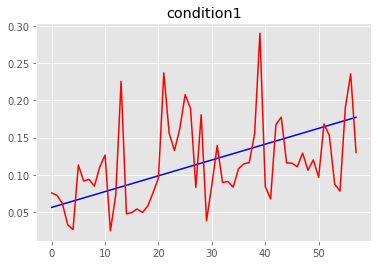

MSE condition1: 0.0029081185586031706
R2 condition1: -1.3055995583818318


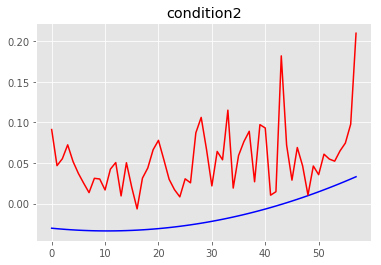

MSE condition2: 0.006071393137851531
R2 condition2: -13.941753811298097


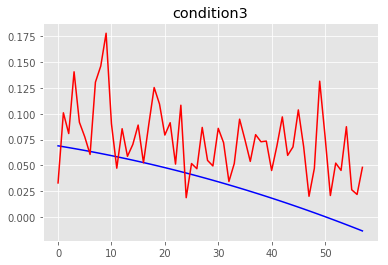

MSE condition3: 0.0026645100059417867
R2 condition3: -3.501366049155683


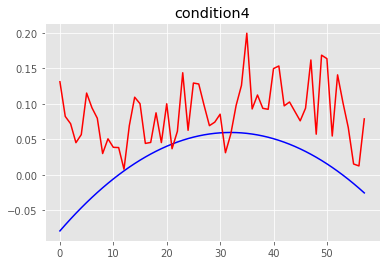

MSE condition4: 0.006850806262754294
R2 condition4: -3.858107805680275
==== the test person number # 3 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.23657233e-09 4.01064275e-09 3.84875635e-09 3.75438175e-09]
Global min values from training is:  [-4.22865966e-09 -4.02

n_neighbors: 28 weights_type:uniform All_MSE: 0.09258386229050206 All_R2: -0.7930990931122843
n_neighbors: 28 weights_type:distance All_MSE: 0.09329185792327453 All_R2: -0.8068110543077291
n_neighbors: 29 weights_type:uniform All_MSE: 0.0905920879832899 All_R2: -0.7545238099518101
The best neighbors is: 29 The best weigths :uniform The best mse: 0.0905920879832899
n_neighbors: 29 weights_type:distance All_MSE: 0.09158813357022795 All_R2: -0.7738145199573305
n_neighbors: 30 weights_type:uniform All_MSE: 0.08989174517608535 All_R2: -0.7409600632966331
The best neighbors is: 30 The best weigths :uniform The best mse: 0.08989174517608535
n_neighbors: 30 weights_type:distance All_MSE: 0.09092953426059094 All_R2: -0.7610592319879321
n_neighbors: 31 weights_type:uniform All_MSE: 0.08971604767610715 All_R2: -0.7375572777562707
The best neighbors is: 31 The best weigths :uniform The best mse: 0.08971604767610715
n_neighbors: 31 weights_type:distance All_MSE: 0.09074124662428952 All_R2: -0.75741

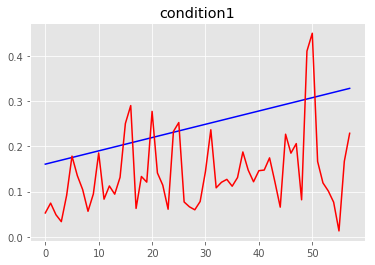

MSE condition1: 0.01757715692258539
R2 condition1: -6.272134577127151


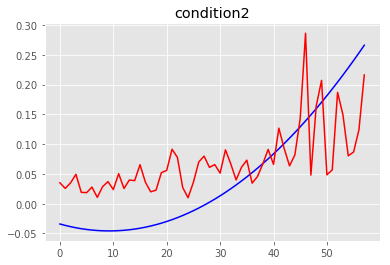

MSE condition2: 0.005595965910921409
R2 condition2: 0.37406465189633153


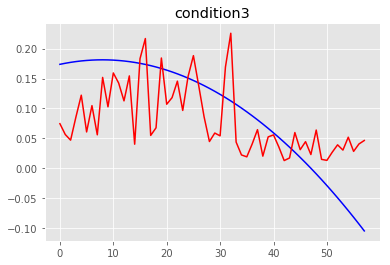

MSE condition3: 0.005465206399421382
R2 condition3: 0.2812678900400908


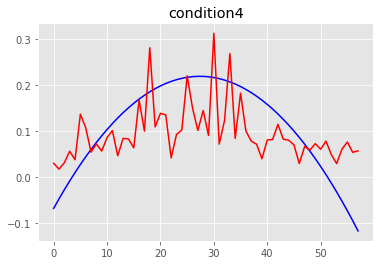

MSE condition4: 0.007109628769238329
R2 condition4: 0.24644068451165457
==== the test person number # 3 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.29200637e-09 4.48186740e-09 4.01041541e-09 3.96947143e-09]
Global min values from training is:  [-4.28098381e-09 -4.4

n_neighbors: 25 weights_type:distance All_MSE: 0.0142468217291891 All_R2: -0.5362663730642063
n_neighbors: 26 weights_type:uniform All_MSE: 0.013832090286601132 All_R2: -0.49154496212699184
The best neighbors is: 26 The best weigths :uniform The best mse: 0.013832090286601132
n_neighbors: 26 weights_type:distance All_MSE: 0.013988333038722413 All_R2: -0.5083929644872061
n_neighbors: 27 weights_type:uniform All_MSE: 0.013748043701477588 All_R2: -0.48248203251710975
The best neighbors is: 27 The best weigths :uniform The best mse: 0.013748043701477588
n_neighbors: 27 weights_type:distance All_MSE: 0.013907061585046402 All_R2: -0.4996292834539342
n_neighbors: 28 weights_type:uniform All_MSE: 0.013515160570089235 All_R2: -0.45736972814449195
The best neighbors is: 28 The best weigths :uniform The best mse: 0.013515160570089235
n_neighbors: 28 weights_type:distance All_MSE: 0.01370075652565262 All_R2: -0.4773829515095729
n_neighbors: 29 weights_type:uniform All_MSE: 0.013455626626383754 All

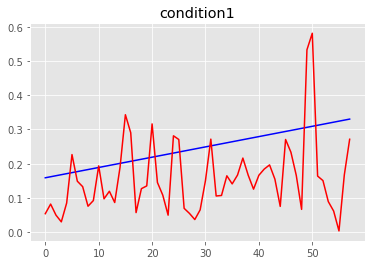

MSE condition1: 0.018970394604771543
R2 condition1: -6.496845889825344


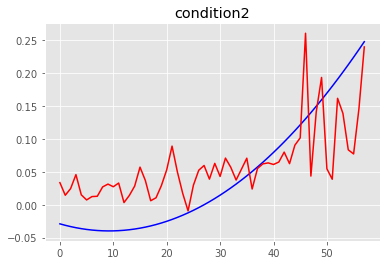

MSE condition2: 0.003990323511415902
R2 condition2: 0.473656459054802


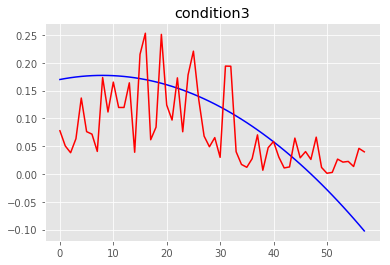

MSE condition3: 0.005519922380859967
R2 condition3: 0.2379538895601767


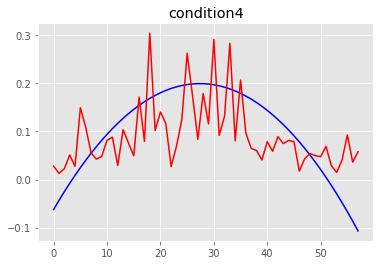

MSE condition4: 0.006117051682504087
R2 condition4: 0.21769634335373944
==== the test person number # 3 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.34526988e-09 4.52527169e-09 4.07010357e-09 3.92967423e-09]
Global min values from training is:  [-4.33645601e-09 -4.5

n_neighbors: 26 weights_type:uniform All_MSE: 0.0047977727471082325 All_R2: -0.3640737253873789
The best neighbors is: 26 The best weigths :uniform The best mse: 0.0047977727471082325
n_neighbors: 26 weights_type:distance All_MSE: 0.004793827374574648 All_R2: -0.36295200093447066
The best neighbors is: 26 The best weigths :distance The best mse: 0.004793827374574648
n_neighbors: 27 weights_type:uniform All_MSE: 0.004803729891776381 All_R2: -0.3657674247242326
n_neighbors: 27 weights_type:distance All_MSE: 0.004795383840492532 All_R2: -0.36339452590906984
n_neighbors: 28 weights_type:uniform All_MSE: 0.004801153763325692 All_R2: -0.3650349954663181
n_neighbors: 28 weights_type:distance All_MSE: 0.004793628069494713 All_R2: -0.3628953357197544
The best neighbors is: 28 The best weigths :distance The best mse: 0.004793628069494713
n_neighbors: 29 weights_type:uniform All_MSE: 0.004699200041578765 All_R2: -0.33604813002458545
The best neighbors is: 29 The best weigths :uniform The best mse

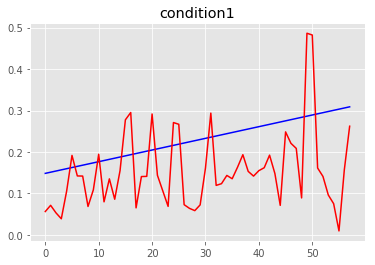

MSE condition1: 0.014076991838213931
R2 condition1: -5.342344152693711


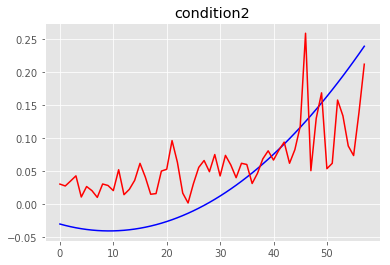

MSE condition2: 0.004195587628540359
R2 condition2: 0.4175955241698679


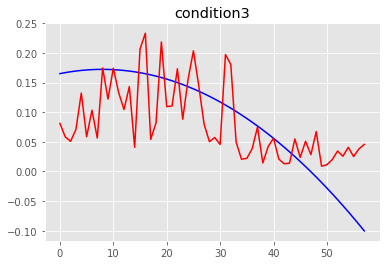

MSE condition3: 0.004815570038888595
R2 condition3: 0.2992852703983093


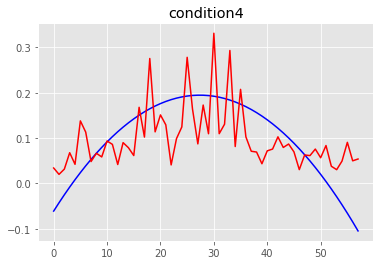

MSE condition4: 0.005665705123457904
R2 condition4: 0.24203828599674992
==== the test person number # 3 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41944952e-09 4.60736072e-09 4.04886493e-09 4.01123617e-09]
Global min values from training is:  [-4.40950419e-09 -4.6

n_neighbors: 31 weights_type:uniform All_MSE: 0.003292546181521977 All_R2: -3.9850695716463704
n_neighbors: 31 weights_type:distance All_MSE: 0.0032551722132205855 All_R2: -3.9284836281608877
n_neighbors: 32 weights_type:uniform All_MSE: 0.003286394588055263 All_R2: -3.9757557701938175
n_neighbors: 32 weights_type:distance All_MSE: 0.003250937554061056 All_R2: -3.92207215528894
n_neighbors: 33 weights_type:uniform All_MSE: 0.0032768870193701093 All_R2: -3.9613608646284266
n_neighbors: 33 weights_type:distance All_MSE: 0.0032428190003782405 All_R2: -3.909780283679936
n_neighbors: 34 weights_type:uniform All_MSE: 0.003265616270483664 All_R2: -3.944296421420674
n_neighbors: 34 weights_type:distance All_MSE: 0.003231039499504386 All_R2: -3.891945566066867
n_neighbors: 35 weights_type:uniform All_MSE: 0.003237493510204937 All_R2: -3.901717241416163
n_neighbors: 35 weights_type:distance All_MSE: 0.0032086608336342514 All_R2: -3.8580632148004437
The best neighbors is: 35 The best weigths :dis

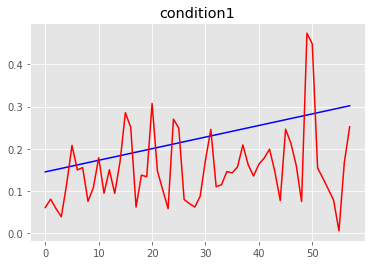

MSE condition1: 0.012810419976025812
R2 condition1: -5.04336825297122


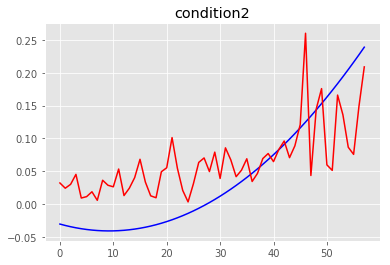

MSE condition2: 0.004278625213971272
R2 condition2: 0.408012161817775


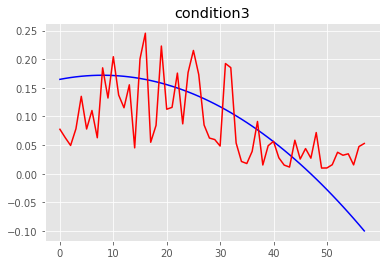

MSE condition3: 0.004694562996374138
R2 condition3: 0.31525554946470336


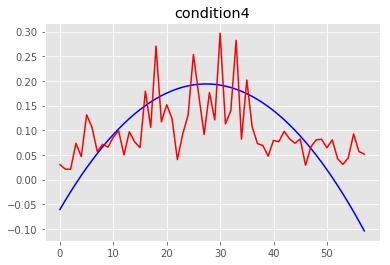

MSE condition4: 0.005208894130741308
R2 condition4: 0.2965702257785713
==== the test person number # 3 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.39995175e-09 4.32823803e-09 4.04192642e-09 3.96643301e-09]
Global min values from training is:  [-4.39095564e-09 -4.32

n_neighbors: 27 weights_type:distance All_MSE: 0.0062995677676150955 All_R2: -4.974014477106193
n_neighbors: 28 weights_type:uniform All_MSE: 0.006067398925643209 All_R2: -4.753843812349916
The best neighbors is: 28 The best weigths :uniform The best mse: 0.006067398925643209
n_neighbors: 28 weights_type:distance All_MSE: 0.006143211865938613 All_R2: -4.825738840641389
n_neighbors: 29 weights_type:uniform All_MSE: 0.006027924464419236 All_R2: -4.716409338822973
The best neighbors is: 29 The best weigths :uniform The best mse: 0.006027924464419236
n_neighbors: 29 weights_type:distance All_MSE: 0.006103104565655566 All_R2: -4.78770423233694
n_neighbors: 30 weights_type:uniform All_MSE: 0.006107802975501535 All_R2: -4.792159834605955
n_neighbors: 30 weights_type:distance All_MSE: 0.006173981719252599 All_R2: -4.854918548827269
n_neighbors: 31 weights_type:uniform All_MSE: 0.006153442774476832 All_R2: -4.835441029422573
n_neighbors: 31 weights_type:distance All_MSE: 0.0062147580561381695 A

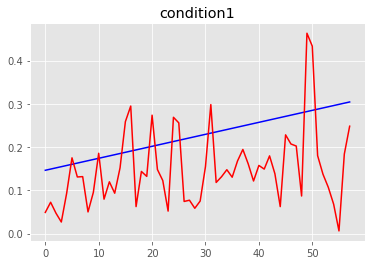

MSE condition1: 0.01336067568017263
R2 condition1: -5.213397136550783


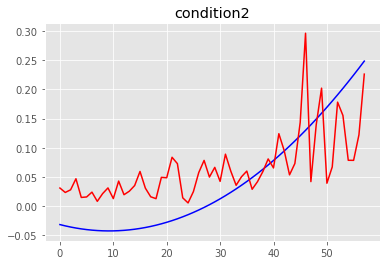

MSE condition2: 0.0047325335411812835
R2 condition2: 0.39325072284383533


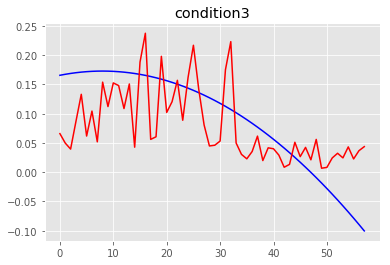

MSE condition3: 0.004975352820914247
R2 condition3: 0.2803346291997493


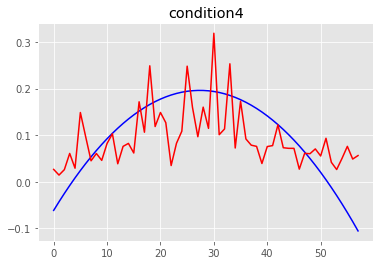

MSE condition4: 0.005487684292466393
R2 condition4: 0.27695494988432623
==== the test person number # 3 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40056843e-09 4.59481271e-09 4.06358753e-09 3.98560814e-09]
Global min values from training is:  [-4.39129577e-09 -4.6

n_neighbors: 27 weights_type:distance All_MSE: 0.0033347755294124387 All_R2: -2.598608642846975
n_neighbors: 28 weights_type:uniform All_MSE: 0.0033576060528022066 All_R2: -2.6232454191656536
n_neighbors: 28 weights_type:distance All_MSE: 0.003349000550792818 All_R2: -2.613959086807182
n_neighbors: 29 weights_type:uniform All_MSE: 0.003371504861191114 All_R2: -2.6382438415639395
n_neighbors: 29 weights_type:distance All_MSE: 0.0033578298636732775 All_R2: -2.623486936991335
n_neighbors: 30 weights_type:uniform All_MSE: 0.0033728490047073164 All_R2: -2.6396943279406004
n_neighbors: 30 weights_type:distance All_MSE: 0.0033565705430230945 All_R2: -2.6221279843014482
n_neighbors: 31 weights_type:uniform All_MSE: 0.0033516817848593594 All_R2: -2.61685244859428
n_neighbors: 31 weights_type:distance All_MSE: 0.003338992031121348 All_R2: -2.6031587360566766
n_neighbors: 32 weights_type:uniform All_MSE: 0.003319732686750767 All_R2: -2.5823756750991222
n_neighbors: 32 weights_type:distance All_MS

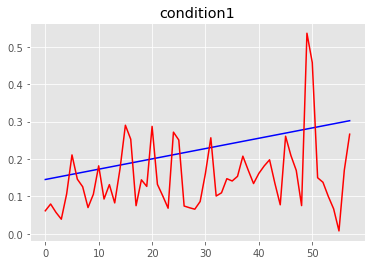

MSE condition1: 0.013512963869014233
R2 condition1: -5.348486526681453


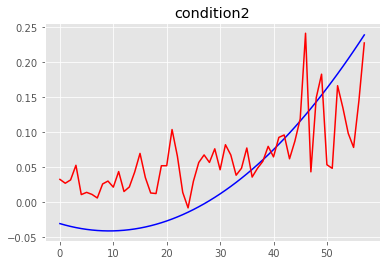

MSE condition2: 0.004176061171147618
R2 condition2: 0.4190383003900737


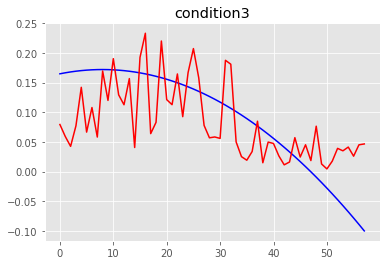

MSE condition3: 0.004699651779340395
R2 condition3: 0.3135446769099691


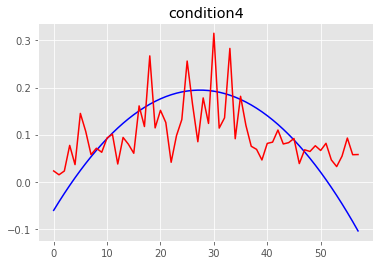

MSE condition4: 0.005287885366530621
R2 condition4: 0.2899708559184243
==== the test person number # 3 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.99611108e-09 4.24427876e-09 3.70775600e-09 3.59953469e-09]
Global min values from training is:  [-3.99043149e-09 -4.25

n_neighbors: 28 weights_type:uniform All_MSE: 0.2675508648397685 All_R2: -4.6534029767231
The best neighbors is: 28 The best weigths :uniform The best mse: 0.2675508648397685
n_neighbors: 28 weights_type:distance All_MSE: 0.27222546545515247 All_R2: -4.752178217273455
n_neighbors: 29 weights_type:uniform All_MSE: 0.2606604662400993 All_R2: -4.507807484151969
The best neighbors is: 29 The best weigths :uniform The best mse: 0.2606604662400993
n_neighbors: 29 weights_type:distance All_MSE: 0.2661475581419701 All_R2: -4.623750827150196
n_neighbors: 30 weights_type:uniform All_MSE: 0.25801459176538943 All_R2: -4.451899630367535
The best neighbors is: 30 The best weigths :uniform The best mse: 0.25801459176538943
n_neighbors: 30 weights_type:distance All_MSE: 0.26384508737217294 All_R2: -4.5750991619366115
n_neighbors: 31 weights_type:uniform All_MSE: 0.246545098919954 All_R2: -4.209546965827574
The best neighbors is: 31 The best weigths :uniform The best mse: 0.246545098919954
n_neighbors:

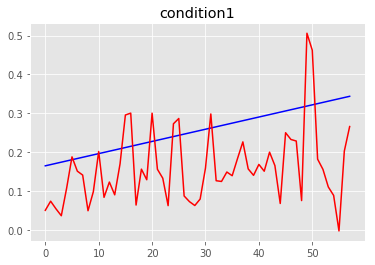

MSE condition1: 0.017794233330703547
R2 condition1: -5.472956160111533


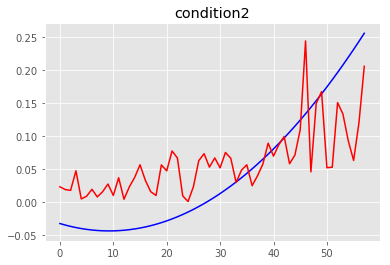

MSE condition2: 0.0045801762052436875
R2 condition2: 0.44895088212571976


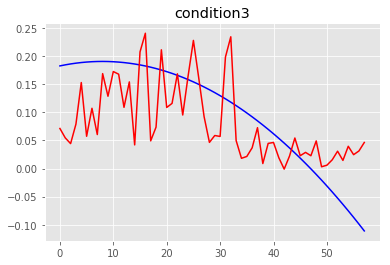

MSE condition3: 0.006032892434012578
R2 condition3: 0.2848675950872279


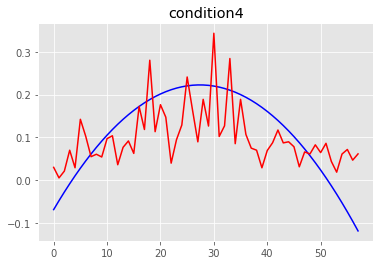

MSE condition4: 0.00695036701837004
R2 condition4: 0.28314140540887867
==== the test person number # 3 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37582075e-09 4.56864955e-09 4.04525069e-09 3.87391306e-09]
Global min values from training is:  [-4.36519916e-09 -4.57

n_neighbors: 29 weights_type:distance All_MSE: 0.004581499342881444 All_R2: -2.686777612053784
The best neighbors is: 29 The best weigths :distance The best mse: 0.004581499342881444
n_neighbors: 30 weights_type:uniform All_MSE: 0.004606971010345439 All_R2: -2.707274913552658
n_neighbors: 30 weights_type:distance All_MSE: 0.004584263806969752 All_R2: -2.689002203513332
n_neighbors: 31 weights_type:uniform All_MSE: 0.004564330970509557 All_R2: -2.672962053836053
The best neighbors is: 31 The best weigths :uniform The best mse: 0.004564330970509557
n_neighbors: 31 weights_type:distance All_MSE: 0.004548305922200923 All_R2: -2.6600665397445473
The best neighbors is: 31 The best weigths :distance The best mse: 0.004548305922200923
n_neighbors: 32 weights_type:uniform All_MSE: 0.004501618281335894 All_R2: -2.622496535643544
The best neighbors is: 32 The best weigths :uniform The best mse: 0.004501618281335894
n_neighbors: 32 weights_type:distance All_MSE: 0.00449300263729832 All_R2: -2.6155

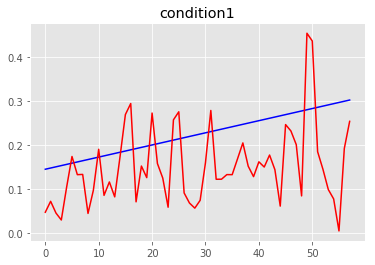

MSE condition1: 0.012744012448863683
R2 condition1: -5.005079084054903


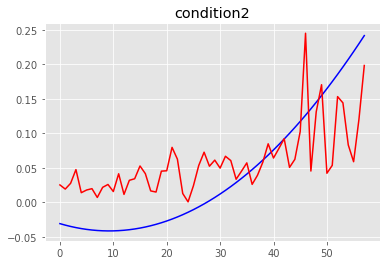

MSE condition2: 0.004267329078288265
R2 condition2: 0.4212372698043786


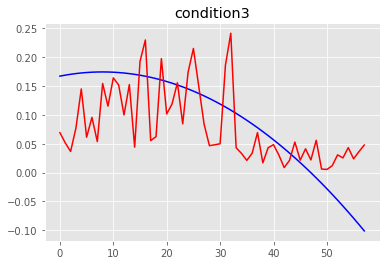

MSE condition3: 0.005170959145194347
R2 condition3: 0.26201663934927155


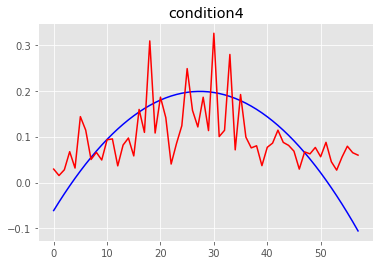

MSE condition4: 0.005813010834020553
R2 condition4: 0.2439375130819339
==== the test person number # 3 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.20823775e-09 4.47770552e-09 3.95879440e-09 3.81530421e-09]
Global min values from training is:  [-4.20162331e-09 -4.48

n_neighbors: 31 weights_type:uniform All_MSE: 0.07393211196202601 All_R2: -0.45385926036060287
n_neighbors: 31 weights_type:distance All_MSE: 0.07269070042648923 All_R2: -0.42944716649554926
n_neighbors: 32 weights_type:uniform All_MSE: 0.07340518906431018 All_R2: -0.4434974336251014
n_neighbors: 32 weights_type:distance All_MSE: 0.07226300906645708 All_R2: -0.4210367068474017
n_neighbors: 33 weights_type:uniform All_MSE: 0.07336632916407985 All_R2: -0.4427332619504769
n_neighbors: 33 weights_type:distance All_MSE: 0.07229741323981166 All_R2: -0.4217132576005074
n_neighbors: 34 weights_type:uniform All_MSE: 0.07389121426521064 All_R2: -0.45305501584946306
n_neighbors: 34 weights_type:distance All_MSE: 0.07270255901643478 All_R2: -0.42968036314514624
n_neighbors: 35 weights_type:uniform All_MSE: 0.07374102770437023 All_R2: -0.45010162906711715
n_neighbors: 35 weights_type:distance All_MSE: 0.07258253496983826 All_R2: -0.4273201157914668
n_neighbors: 36 weights_type:uniform All_MSE: 0.07

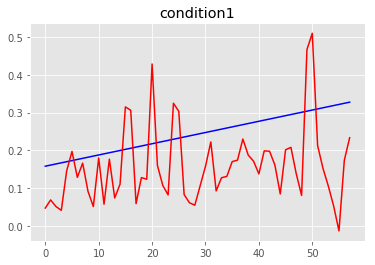

MSE condition1: 0.017835990001039068
R2 condition1: -6.172209651476518


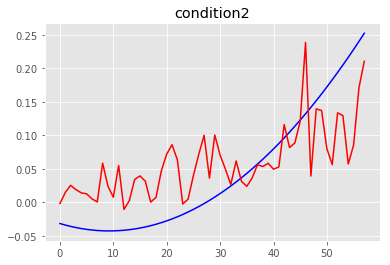

MSE condition2: 0.004342320978818842
R2 condition2: 0.4580609228007635


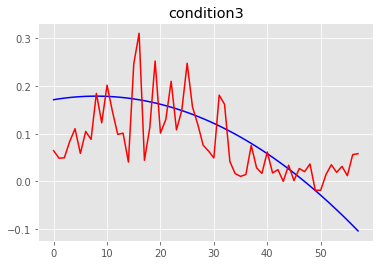

MSE condition3: 0.005609142178739371
R2 condition3: 0.2427065684540718


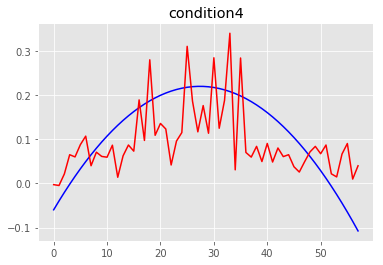

MSE condition4: 0.0071092112797521536
R2 condition4: 0.2070268200885399
==== the test person number # 3 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.36415243e-09 4.53223722e-09 3.99598558e-09 3.91543067e-09]
Global min values from training is:  [-4.35246455e-09 -4.5

n_neighbors: 28 weights_type:distance All_MSE: 0.012392319875350251 All_R2: 0.1137775559110209
n_neighbors: 29 weights_type:uniform All_MSE: 0.01286861138315502 All_R2: 0.07971611879583029
n_neighbors: 29 weights_type:distance All_MSE: 0.012522455762661923 All_R2: 0.10447103822288062
n_neighbors: 30 weights_type:uniform All_MSE: 0.012958235736609298 All_R2: 0.07330673666503695
n_neighbors: 30 weights_type:distance All_MSE: 0.012592244055559988 All_R2: 0.09948020905424837
n_neighbors: 31 weights_type:uniform All_MSE: 0.013075880535380377 All_R2: 0.06489350474801348
n_neighbors: 31 weights_type:distance All_MSE: 0.012696553736558357 All_R2: 0.09202062268411315
n_neighbors: 32 weights_type:uniform All_MSE: 0.013169044501313176 All_R2: 0.05823099131869047
n_neighbors: 32 weights_type:distance All_MSE: 0.012777408218031253 All_R2: 0.0862384078198094
n_neighbors: 33 weights_type:uniform All_MSE: 0.013103866641566639 All_R2: 0.06289211068504574
n_neighbors: 33 weights_type:distance All_MSE: 0

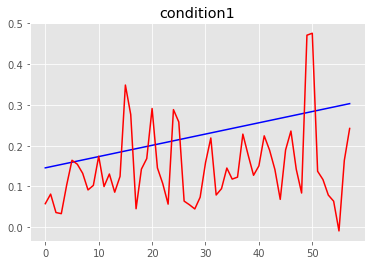

MSE condition1: 0.015144671592177144
R2 condition1: -6.081160101113872


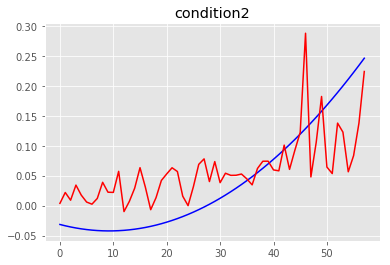

MSE condition2: 0.004295329045512965
R2 condition2: 0.43810351194695074


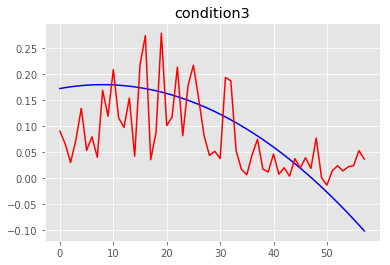

MSE condition3: 0.005952326893811159
R2 condition3: 0.1870672546578387


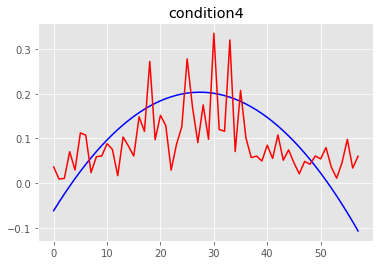

MSE condition4: 0.006393150775007128
R2 condition4: 0.20579558164576917
==== the test person number # 3 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.94798369e-09 4.14286319e-09 3.74068645e-09 3.61620046e-09]
Global min values from training is:  [-3.94507138e-09 -4.1

n_neighbors: 38 weights_type:uniform All_MSE: 7.972048369942507 All_R2: -4.94554786227894
n_neighbors: 38 weights_type:distance All_MSE: 7.781179686217476 All_R2: -4.803198137109681
n_neighbors: 39 weights_type:uniform All_MSE: 7.991670824273367 All_R2: -4.960182274413139
n_neighbors: 39 weights_type:distance All_MSE: 7.8015342127303 All_R2: -4.818378528143472
n_neighbors: 40 weights_type:uniform All_MSE: 8.017031114470168 All_R2: -4.9790959603529865
n_neighbors: 40 weights_type:distance All_MSE: 7.826648619708918 All_R2: -4.837108834558459
n_neighbors: 41 weights_type:uniform All_MSE: 8.051257943218879 All_R2: -5.004622304280696
n_neighbors: 41 weights_type:distance All_MSE: 7.858839097234287 All_R2: -4.861116469228403
n_neighbors: 42 weights_type:uniform All_MSE: 8.067295093189099 All_R2: -5.0165827990365965
n_neighbors: 42 weights_type:distance All_MSE: 7.875529780679246 All_R2: -4.873564368773305
n_neighbors: 43 weights_type:uniform All_MSE: 8.095081647931979 All_R2: -5.03730599130

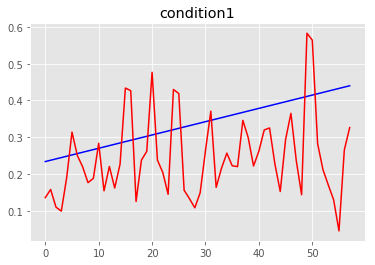

MSE condition1: 0.021635845466602837
R2 condition1: -4.900440194436954


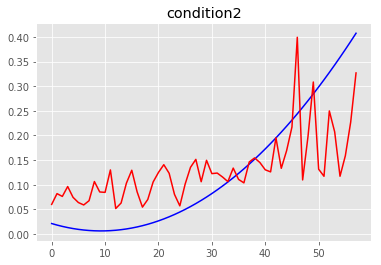

MSE condition2: 0.008000858597040169
R2 condition2: 0.459634395738044


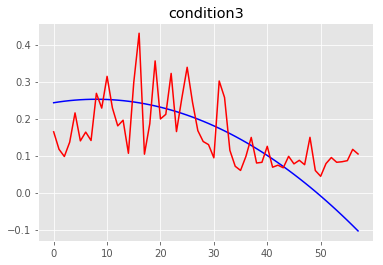

MSE condition3: 0.008625945801248399
R2 condition3: 0.2652750593181288


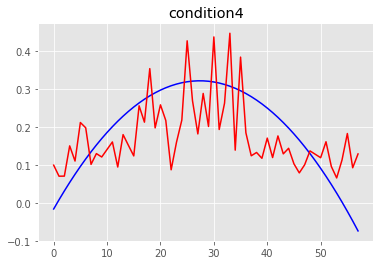

MSE condition4: 0.010179900981856262
R2 condition4: 0.2160913179711521
==== the test person number # 3 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30517753e-09 4.45383519e-09 3.95546202e-09 3.90508009e-09]
Global min values from training is:  [-4.29554578e-09 -4.46

n_neighbors: 28 weights_type:uniform All_MSE: 0.017929012818974625 All_R2: -0.19711285971729176
n_neighbors: 28 weights_type:distance All_MSE: 0.017478015985651237 All_R2: -0.1669999854439339
n_neighbors: 29 weights_type:uniform All_MSE: 0.018091145336568668 All_R2: -0.20793838166598255
n_neighbors: 29 weights_type:distance All_MSE: 0.017616680056357113 All_R2: -0.17625852878364712
n_neighbors: 30 weights_type:uniform All_MSE: 0.01789826024058326 All_R2: -0.1950595226243088
n_neighbors: 30 weights_type:distance All_MSE: 0.01746229016349616 All_R2: -0.16594997872457062
n_neighbors: 31 weights_type:uniform All_MSE: 0.01765693942945309 All_R2: -0.178946630674363
n_neighbors: 31 weights_type:distance All_MSE: 0.017272281024438917 All_R2: -0.15326314615180858
n_neighbors: 32 weights_type:uniform All_MSE: 0.0175409320934713 All_R2: -0.1712008682541155
n_neighbors: 32 weights_type:distance All_MSE: 0.017187126896779217 All_R2: -0.14757743984389915
n_neighbors: 33 weights_type:uniform All_MSE:

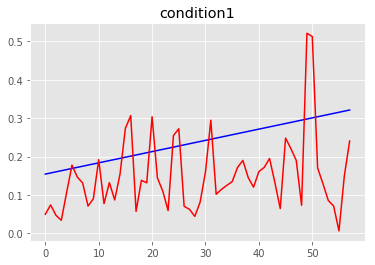

MSE condition1: 0.017241197828694724
R2 condition1: -6.174571038065966


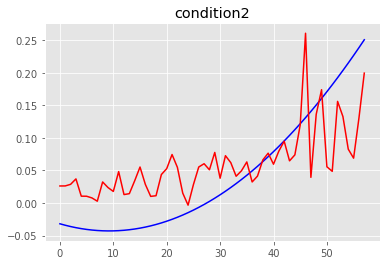

MSE condition2: 0.004383731153571091
R2 condition2: 0.4477994710850366


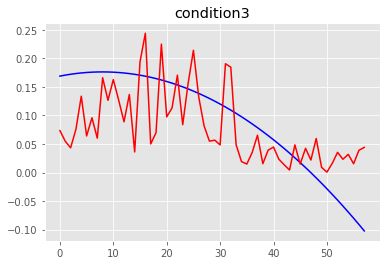

MSE condition3: 0.005164426907812631
R2 condition3: 0.2809188620972811


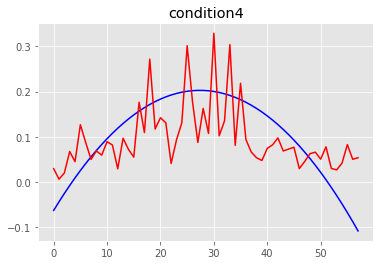

MSE condition4: 0.0060398720152786915
R2 condition4: 0.2512178253812868
==== the test person number # 3 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.35952858e-09 4.54238128e-09 4.00218418e-09 3.97420212e-09]
Global min values from training is:  [-4.35150437e-09 -4.5

n_neighbors: 24 weights_type:uniform All_MSE: 0.0038433628518291284 All_R2: -0.42659452553758004
n_neighbors: 24 weights_type:distance All_MSE: 0.0038278502266121768 All_R2: -0.42083648835389664
n_neighbors: 25 weights_type:uniform All_MSE: 0.0038210353095169966 All_R2: -0.4183069006478206
n_neighbors: 25 weights_type:distance All_MSE: 0.003808663987395918 All_R2: -0.41371486469076957
n_neighbors: 26 weights_type:uniform All_MSE: 0.003792487136498254 All_R2: -0.40771027760889633
The best neighbors is: 26 The best weigths :uniform The best mse: 0.003792487136498254
n_neighbors: 26 weights_type:distance All_MSE: 0.00378442233044076 All_R2: -0.4047167512064471
The best neighbors is: 26 The best weigths :distance The best mse: 0.00378442233044076
n_neighbors: 27 weights_type:uniform All_MSE: 0.003738666134566925 All_R2: -0.3877327866265814
The best neighbors is: 27 The best weigths :uniform The best mse: 0.003738666134566925
n_neighbors: 27 weights_type:distance All_MSE: 0.0037391930192522

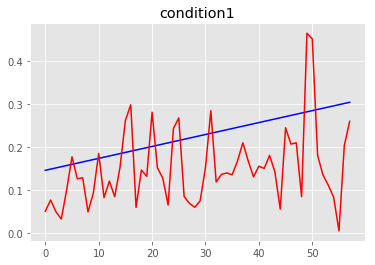

MSE condition1: 0.012959458578574718
R2 condition1: -5.021228278802714


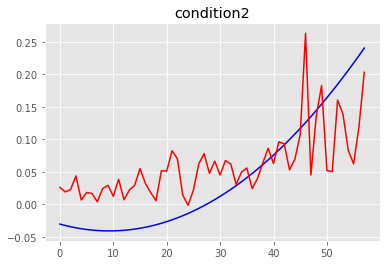

MSE condition2: 0.004241054093886024
R2 condition2: 0.419117853025874


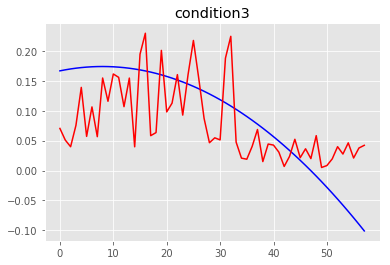

MSE condition3: 0.005070409592506388
R2 condition3: 0.2743721843468595


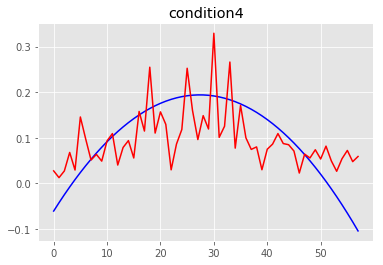

MSE condition4: 0.005381308337319858
R2 condition4: 0.2742465907563163
==== the test person number # 3 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.10404413e-09 4.30401659e-09 3.67157433e-09 3.76318639e-09]
Global min values from training is:  [-4.08945127e-09 -4.31

n_neighbors: 24 weights_type:distance All_MSE: 0.27068006759141666 All_R2: 0.49123763228841355
n_neighbors: 25 weights_type:uniform All_MSE: 0.275924039712082 All_R2: 0.4813812150942578
n_neighbors: 25 weights_type:distance All_MSE: 0.27170468625664024 All_R2: 0.48931178890157234
n_neighbors: 26 weights_type:uniform All_MSE: 0.2792231969772132 All_R2: 0.47518021523269927
n_neighbors: 26 weights_type:distance All_MSE: 0.2742419338773299 All_R2: 0.4845428522064582
n_neighbors: 27 weights_type:uniform All_MSE: 0.2829545826265258 All_R2: 0.4681668114949151
n_neighbors: 27 weights_type:distance All_MSE: 0.2770541606327706 All_R2: 0.4792570727422698
n_neighbors: 28 weights_type:uniform All_MSE: 0.2842918023773702 All_R2: 0.4656534122164089
n_neighbors: 28 weights_type:distance All_MSE: 0.2777157507795115 All_R2: 0.4780135671804985
n_neighbors: 29 weights_type:uniform All_MSE: 0.2832830630135501 All_R2: 0.46754940933103817
n_neighbors: 29 weights_type:distance All_MSE: 0.2768256823449042 All_

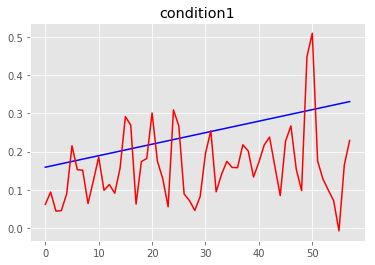

MSE condition1: 0.016062295398421158
R2 condition1: -5.29935038253667


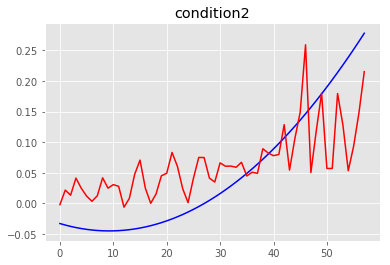

MSE condition2: 0.005104254291317193
R2 condition2: 0.46843774923958403


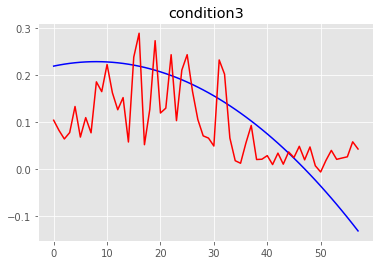

MSE condition3: 0.008431656493049151
R2 condition3: 0.29877933629665276


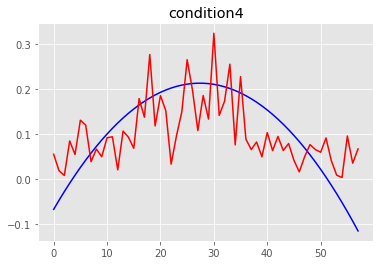

MSE condition4: 0.006084890949349387
R2 condition4: 0.31937549686294786
==== the test person number # 3 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40660245e-09 4.59851420e-09 4.08731627e-09 4.02957058e-09]
Global min values from training is:  [-4.39766730e-09 -4.6

n_neighbors: 24 weights_type:uniform All_MSE: 0.0025751895159743885 All_R2: 0.1548262614301884
n_neighbors: 24 weights_type:distance All_MSE: 0.0024997129468278985 All_R2: 0.1795975699976765
n_neighbors: 25 weights_type:uniform All_MSE: 0.0025460799979301297 All_R2: 0.16437996613456718
n_neighbors: 25 weights_type:distance All_MSE: 0.002477630768036922 All_R2: 0.18684491140255732
The best neighbors is: 25 The best weigths :distance The best mse: 0.002477630768036922
n_neighbors: 26 weights_type:uniform All_MSE: 0.002567020080612539 All_R2: 0.15750745913775444
n_neighbors: 26 weights_type:distance All_MSE: 0.002494394290311845 All_R2: 0.18134314591896583
n_neighbors: 27 weights_type:uniform All_MSE: 0.0025242987204142416 All_R2: 0.17152855214531915
n_neighbors: 27 weights_type:distance All_MSE: 0.0024600338377412157 All_R2: 0.1926202002786256
The best neighbors is: 27 The best weigths :distance The best mse: 0.0024600338377412157
n_neighbors: 28 weights_type:uniform All_MSE: 0.002545386

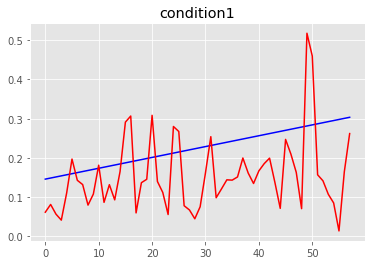

MSE condition1: 0.013738825344074489
R2 condition1: -5.414982946727087


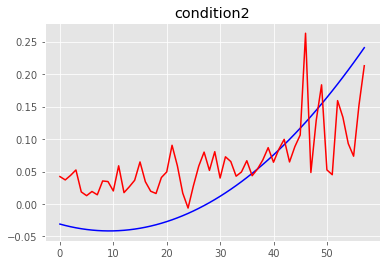

MSE condition2: 0.004459989257604735
R2 condition2: 0.39050273506709277


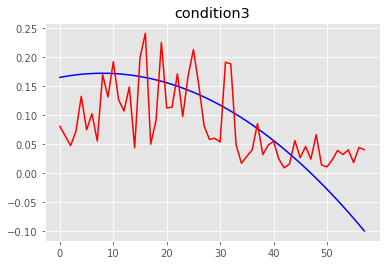

MSE condition3: 0.004696179791135892
R2 condition3: 0.3176615717508595


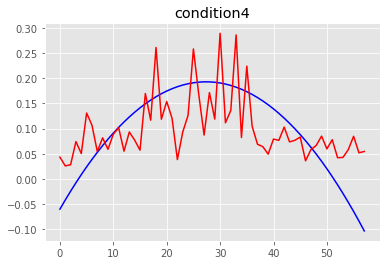

MSE condition4: 0.005321618970240042
R2 condition4: 0.2761423999438901
==== the test person number # 4 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.32278515e-09 4.13145862e-09 3.83463111e-09 3.83866253e-09]
Global min values from training is:  [-4.31247419e-09 -4.14

n_neighbors: 28 weights_type:uniform All_MSE: 0.0837691045939415 All_R2: -0.7221994233659772
The best neighbors is: 28 The best weigths :uniform The best mse: 0.0837691045939415
n_neighbors: 28 weights_type:distance All_MSE: 0.0851646775043216 All_R2: -0.7508908469304547
n_neighbors: 29 weights_type:uniform All_MSE: 0.08322842170620967 All_R2: -0.7110835858267162
The best neighbors is: 29 The best weigths :uniform The best mse: 0.08322842170620967
n_neighbors: 29 weights_type:distance All_MSE: 0.08469504770896265 All_R2: -0.7412357817762645
n_neighbors: 30 weights_type:uniform All_MSE: 0.08193003657895641 All_R2: -0.6843902347600959
The best neighbors is: 30 The best weigths :uniform The best mse: 0.08193003657895641
n_neighbors: 30 weights_type:distance All_MSE: 0.08361783752460215 All_R2: -0.7190895410190992
n_neighbors: 31 weights_type:uniform All_MSE: 0.08202273379505376 All_R2: -0.6862959862049076
n_neighbors: 31 weights_type:distance All_MSE: 0.08366765765326092 All_R2: -0.720113

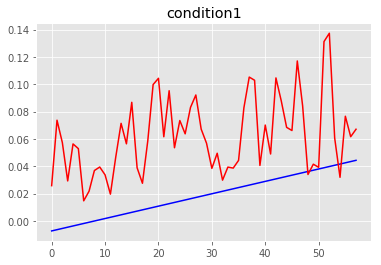

MSE condition1: 0.002610445137995695
R2 condition1: -10.34439534493063


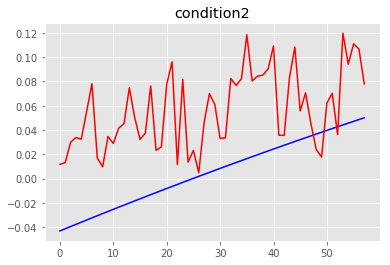

MSE condition2: 0.0035053543867202643
R2 condition2: -3.6725737484101817


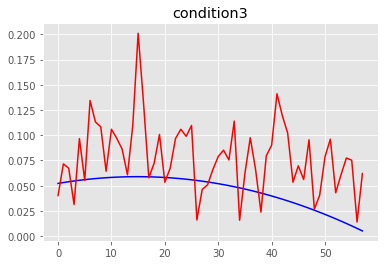

MSE condition3: 0.0022240848570946863
R2 condition3: -7.9304793823625985


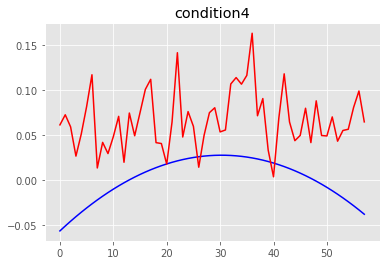

MSE condition4: 0.005540180618975614
R2 condition4: -8.878833241082985
==== the test person number # 4 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37821919e-09 4.60268327e-09 3.99629017e-09 4.05375221e-09]
Global min values from training is:  [-4.36479833e-09 -4.61

n_neighbors: 26 weights_type:distance All_MSE: 0.01188061695836765 All_R2: -0.4417688895982874
n_neighbors: 27 weights_type:uniform All_MSE: 0.011725524126274818 All_R2: -0.4229476431011816
The best neighbors is: 27 The best weigths :uniform The best mse: 0.011725524126274818
n_neighbors: 27 weights_type:distance All_MSE: 0.011775406177746894 All_R2: -0.4290010652604681
n_neighbors: 28 weights_type:uniform All_MSE: 0.01156132663917498 All_R2: -0.4030215037870084
The best neighbors is: 28 The best weigths :uniform The best mse: 0.01156132663917498
n_neighbors: 28 weights_type:distance All_MSE: 0.0116398300346636 All_R2: -0.4125482610034008
n_neighbors: 29 weights_type:uniform All_MSE: 0.011681681234779438 All_R2: -0.4176271014820401
n_neighbors: 29 weights_type:distance All_MSE: 0.011726084244977671 All_R2: -0.42301561614694894
n_neighbors: 30 weights_type:uniform All_MSE: 0.011637533542300935 All_R2: -0.4122695708263422
n_neighbors: 30 weights_type:distance All_MSE: 0.01167862395348089

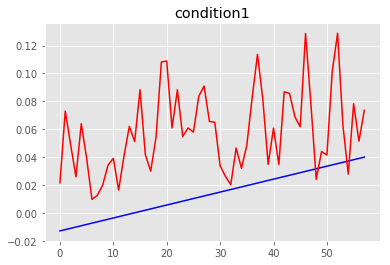

MSE condition1: 0.002752182325878788
R2 condition1: -10.451370270114804


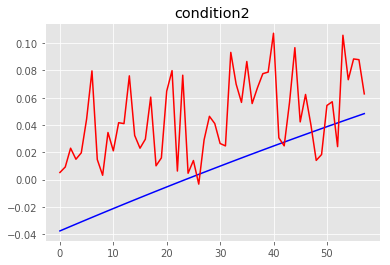

MSE condition2: 0.002314450794521047
R2 condition2: -2.626568088487205


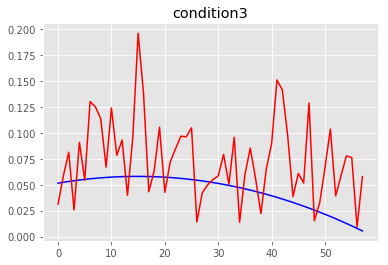

MSE condition3: 0.002309293198872026
R2 condition3: -8.727008341285865


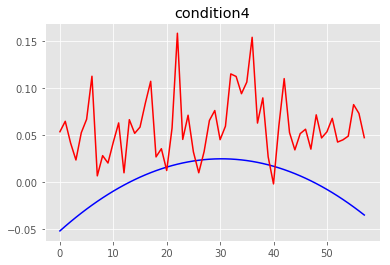

MSE condition4: 0.004656408292394095
R2 condition4: -8.982371209590598
==== the test person number # 4 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43148270e-09 4.64608756e-09 4.05597833e-09 4.01395501e-09]
Global min values from training is:  [-4.42027053e-09 -4.65

n_neighbors: 27 weights_type:uniform All_MSE: 0.0048696615205581365 All_R2: -0.5096092217679877
n_neighbors: 27 weights_type:distance All_MSE: 0.0048413673651069525 All_R2: -0.5008379513601939
The best neighbors is: 27 The best weigths :distance The best mse: 0.0048413673651069525
n_neighbors: 28 weights_type:uniform All_MSE: 0.004911151552094899 All_R2: -0.522471252107247
n_neighbors: 28 weights_type:distance All_MSE: 0.004871745438191671 All_R2: -0.5102552422898881
n_neighbors: 29 weights_type:uniform All_MSE: 0.0048997604295463884 All_R2: -0.5189399710165745
n_neighbors: 29 weights_type:distance All_MSE: 0.004861346322457699 All_R2: -0.5070314861943235
n_neighbors: 30 weights_type:uniform All_MSE: 0.004860766698782667 All_R2: -0.506851801170777
n_neighbors: 30 weights_type:distance All_MSE: 0.004827142838311107 All_R2: -0.4964283067194648
The best neighbors is: 30 The best weigths :distance The best mse: 0.004827142838311107
n_neighbors: 31 weights_type:uniform All_MSE: 0.0048897837

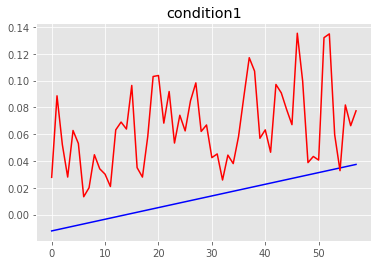

MSE condition1: 0.003513704907469983
R2 condition1: -15.558149403447938


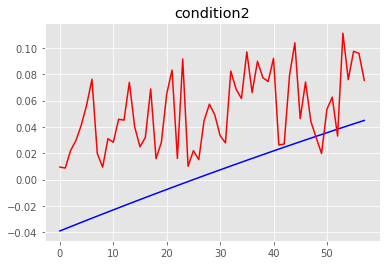

MSE condition2: 0.0029423429454213724
R2 condition2: -3.8473663370675073


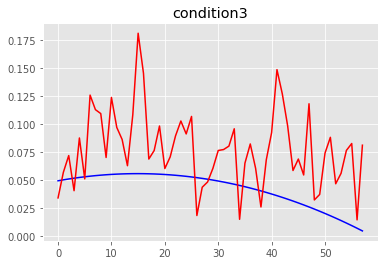

MSE condition3: 0.002346341973197347
R2 condition3: -9.408979407659379


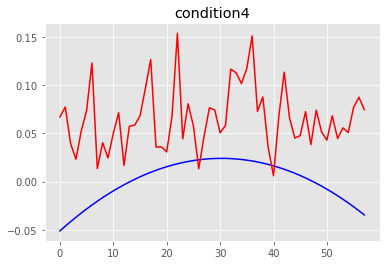

MSE condition4: 0.005382739134502845
R2 condition4: -11.061253959469193
==== the test person number # 4 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41944952e-09 4.60736072e-09 4.04886493e-09 4.01123617e-09]
Global min values from training is:  [-4.40950419e-09 -4.6

n_neighbors: 22 weights_type:uniform All_MSE: 0.006919566669975171 All_R2: 0.3402120875654655
n_neighbors: 22 weights_type:distance All_MSE: 0.006888413419045303 All_R2: 0.34318258259454804
n_neighbors: 23 weights_type:uniform All_MSE: 0.006815081383613087 All_R2: 0.35017486879974347
The best neighbors is: 23 The best weigths :uniform The best mse: 0.006815081383613087
n_neighbors: 23 weights_type:distance All_MSE: 0.006799969771079912 All_R2: 0.3516157768453363
The best neighbors is: 23 The best weigths :distance The best mse: 0.006799969771079912
n_neighbors: 24 weights_type:uniform All_MSE: 0.006820514707979202 All_R2: 0.349656795643999
n_neighbors: 24 weights_type:distance All_MSE: 0.006798412333518908 All_R2: 0.3517642801441889
The best neighbors is: 24 The best weigths :distance The best mse: 0.006798412333518908
n_neighbors: 25 weights_type:uniform All_MSE: 0.006901757503516922 All_R2: 0.3419102101965651
n_neighbors: 25 weights_type:distance All_MSE: 0.006857355222629001 All_R2:

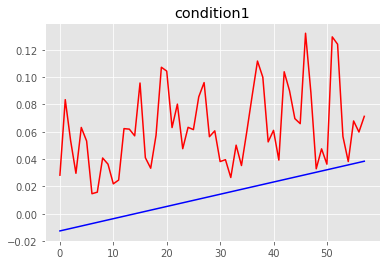

MSE condition1: 0.003181962562498489
R2 condition1: -13.203327699772672


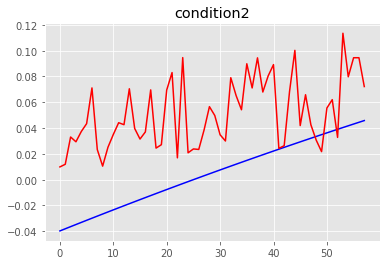

MSE condition2: 0.0028794765570607133
R2 condition2: -3.5587893422123464


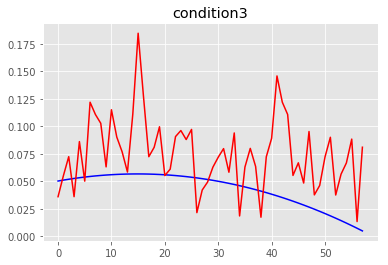

MSE condition3: 0.0020768248782678613
R2 condition3: -7.975000796093928


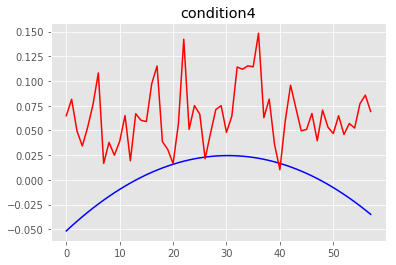

MSE condition4: 0.005129775977492451
R2 condition4: -10.191771243059872
==== the test person number # 4 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.48616457e-09 4.44905391e-09 4.02780118e-09 4.05071379e-09]
Global min values from training is:  [-4.47477016e-09 -4.4

n_neighbors: 30 weights_type:distance All_MSE: 0.006205662115352397 All_R2: -5.2855819082336435
n_neighbors: 31 weights_type:uniform All_MSE: 0.006259424939748199 All_R2: -5.3400371186650615
n_neighbors: 31 weights_type:distance All_MSE: 0.006314140257797828 All_R2: -5.395457089466433
n_neighbors: 32 weights_type:uniform All_MSE: 0.006162214044535736 All_R2: -5.241574290223435
n_neighbors: 32 weights_type:distance All_MSE: 0.0062202799740499895 All_R2: -5.3003880234327605
n_neighbors: 33 weights_type:uniform All_MSE: 0.005998913108320257 All_R2: -5.07617027833979
The best neighbors is: 33 The best weigths :uniform The best mse: 0.005998913108320257
n_neighbors: 33 weights_type:distance All_MSE: 0.006074177500187495 All_R2: -5.152403964779879
n_neighbors: 34 weights_type:uniform All_MSE: 0.0059282836119793 All_R2: -5.004631178057472
The best neighbors is: 34 The best weigths :uniform The best mse: 0.0059282836119793
n_neighbors: 34 weights_type:distance All_MSE: 0.006007359051142267 All

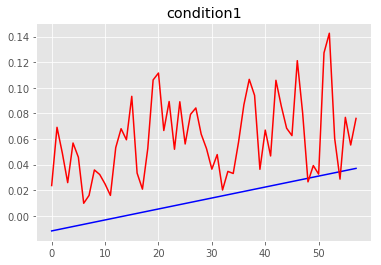

MSE condition1: 0.0030905385263392446
R2 condition1: -14.009764198287916


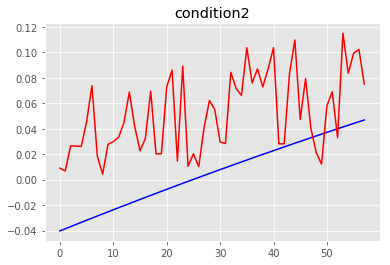

MSE condition2: 0.003011111005973361
R2 condition2: -3.5883821384555388


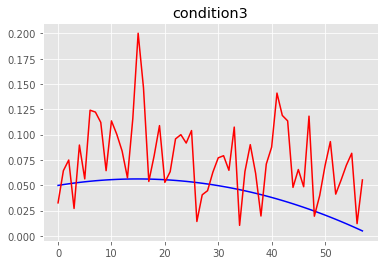

MSE condition3: 0.0023740273329590344
R2 condition3: -9.470140732893842


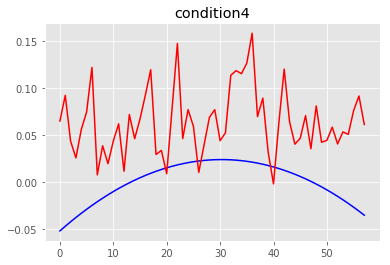

MSE condition4: 0.00541248276682724
R2 condition4: -10.9477835900123
==== the test person number # 4 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.48678125e-09 4.71562859e-09 4.04946229e-09 4.06988892e-09]
Global min values from training is:  [-4.47511029e-09 -4.7281

n_neighbors: 28 weights_type:distance All_MSE: 0.0038767157175464474 All_R2: -3.4958967217046473
n_neighbors: 29 weights_type:uniform All_MSE: 0.00383434531418157 All_R2: -3.4467590052805974
The best neighbors is: 29 The best weigths :uniform The best mse: 0.00383434531418157
n_neighbors: 29 weights_type:distance All_MSE: 0.0038319168282379087 All_R2: -3.443942646592393
The best neighbors is: 29 The best weigths :distance The best mse: 0.0038319168282379087
n_neighbors: 30 weights_type:uniform All_MSE: 0.0038072335984522475 All_R2: -3.4153170624743305
The best neighbors is: 30 The best weigths :uniform The best mse: 0.0038072335984522475
n_neighbors: 30 weights_type:distance All_MSE: 0.003805107823212241 All_R2: -3.4128517628163317
The best neighbors is: 30 The best weigths :distance The best mse: 0.003805107823212241
n_neighbors: 31 weights_type:uniform All_MSE: 0.003729881239989686 All_R2: -3.3256101455461913
The best neighbors is: 31 The best weigths :uniform The best mse: 0.0037298

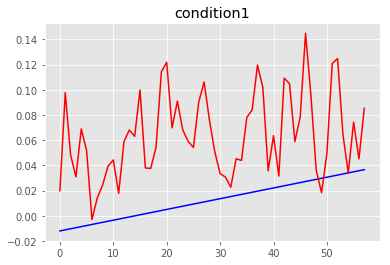

MSE condition1: 0.003692493725700686
R2 condition1: -17.10781838406422


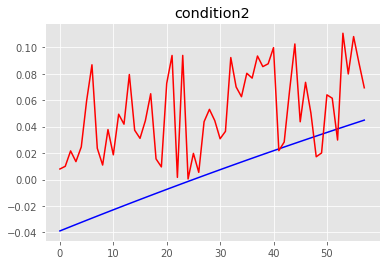

MSE condition2: 0.0030602621149735817
R2 condition2: -4.052458682259558


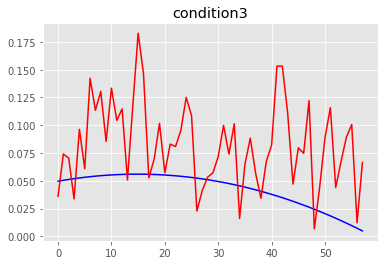

MSE condition3: 0.003003488033252108
R2 condition3: -12.374339669585396


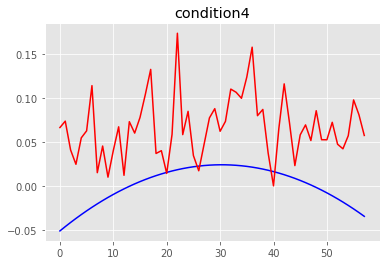

MSE condition4: 0.005607841411833079
R2 condition4: -11.61121987550015
==== the test person number # 4 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.08232390e-09 4.36509463e-09 3.69363077e-09 3.68381547e-09]
Global min values from training is:  [-4.07424601e-09 -4.37

n_neighbors: 28 weights_type:uniform All_MSE: 0.24795895987418745 All_R2: -4.708066750839707
The best neighbors is: 28 The best weigths :uniform The best mse: 0.24795895987418745
n_neighbors: 28 weights_type:distance All_MSE: 0.2526795462390737 All_R2: -4.816735629300669
n_neighbors: 29 weights_type:uniform All_MSE: 0.2407384195702687 All_R2: -4.541848413527722
The best neighbors is: 29 The best weigths :uniform The best mse: 0.2407384195702687
n_neighbors: 29 weights_type:distance All_MSE: 0.2462014914501213 All_R2: -4.667609462737866
n_neighbors: 30 weights_type:uniform All_MSE: 0.23784148726490315 All_R2: -4.475160430241775
The best neighbors is: 30 The best weigths :uniform The best mse: 0.23784148726490315
n_neighbors: 30 weights_type:distance All_MSE: 0.24357739128148104 All_R2: -4.607202131899375
n_neighbors: 31 weights_type:uniform All_MSE: 0.23308844087379427 All_R2: -4.365744315236078
The best neighbors is: 31 The best weigths :uniform The best mse: 0.23308844087379427
n_neig

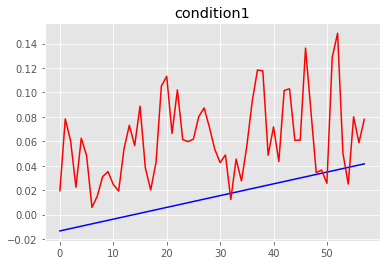

MSE condition1: 0.0032827933964775587
R2 condition1: -11.628555540160022


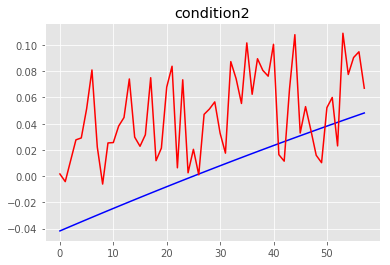

MSE condition2: 0.0027712439511454103
R2 condition2: -2.967596347793694


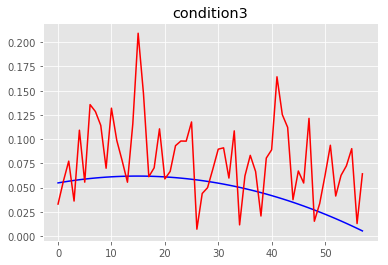

MSE condition3: 0.0025024519823505665
R2 condition3: -8.07152288168731


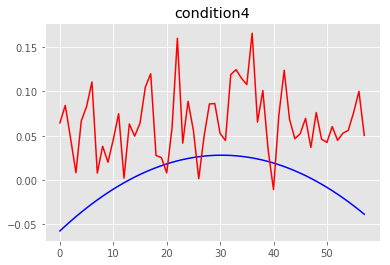

MSE condition4: 0.005590171860145169
R2 condition4: -8.705124890185783
==== the test person number # 4 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.46203357e-09 4.68946543e-09 4.03112545e-09 3.95819384e-09]
Global min values from training is:  [-4.44901368e-09 -4.70

n_neighbors: 28 weights_type:distance All_MSE: 0.004772990336970328 All_R2: -2.941042173248937
The best neighbors is: 28 The best weigths :distance The best mse: 0.004772990336970328
n_neighbors: 29 weights_type:uniform All_MSE: 0.0048352439571883055 All_R2: -2.9924447794549662
n_neighbors: 29 weights_type:distance All_MSE: 0.004777621848816764 All_R2: -2.9448663971052733
n_neighbors: 30 weights_type:uniform All_MSE: 0.0048079631051364076 All_R2: -2.969919071069196
n_neighbors: 30 weights_type:distance All_MSE: 0.004752180428389938 All_R2: -2.9238595012662336
The best neighbors is: 30 The best weigths :distance The best mse: 0.004752180428389938
n_neighbors: 31 weights_type:uniform All_MSE: 0.0047838239018278775 All_R2: -2.949987411553637
n_neighbors: 31 weights_type:distance All_MSE: 0.004728542707496156 All_R2: -2.904341914104929
The best neighbors is: 31 The best weigths :distance The best mse: 0.004728542707496156
n_neighbors: 32 weights_type:uniform All_MSE: 0.004732073243924572 A

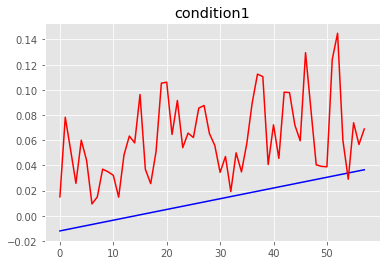

MSE condition1: 0.003250711490954662
R2 condition1: -14.986590161568326


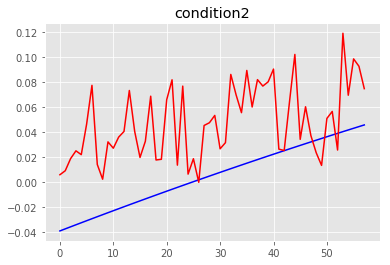

MSE condition2: 0.0026213818026672472
R2 condition2: -3.221228227981946


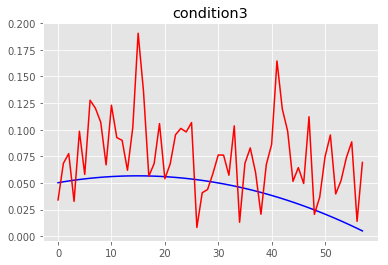

MSE condition3: 0.0023524399434473155
R2 condition3: -9.238525379325331


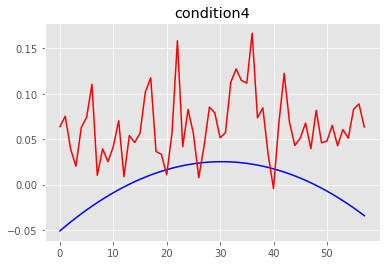

MSE condition4: 0.005329901695207998
R2 condition4: -10.616943954478783
==== the test person number # 4 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.29445057e-09 4.59852139e-09 3.94466917e-09 3.89958499e-09]
Global min values from training is:  [-4.28543784e-09 -4.6

n_neighbors: 33 weights_type:distance All_MSE: 0.06649920159751142 All_R2: -0.4305102716434688
n_neighbors: 34 weights_type:uniform All_MSE: 0.0676567449320325 All_R2: -0.4554109860900435
n_neighbors: 34 weights_type:distance All_MSE: 0.06635778626623415 All_R2: -0.4274681887447236
n_neighbors: 35 weights_type:uniform All_MSE: 0.06733848318809105 All_R2: -0.4485646378205561
n_neighbors: 35 weights_type:distance All_MSE: 0.06611888563782999 All_R2: -0.4223290322642792
n_neighbors: 36 weights_type:uniform All_MSE: 0.06736970080908807 All_R2: -0.4492361816349135
n_neighbors: 36 weights_type:distance All_MSE: 0.06619180258624172 All_R2: -0.42389759912183655
n_neighbors: 37 weights_type:uniform All_MSE: 0.06687876423393517 All_R2: -0.43867530576557123
n_neighbors: 37 weights_type:distance All_MSE: 0.0658170061840627 All_R2: -0.41583509475769165
n_neighbors: 38 weights_type:uniform All_MSE: 0.06612109925076332 All_R2: -0.42237665082153253
n_neighbors: 38 weights_type:distance All_MSE: 0.0652

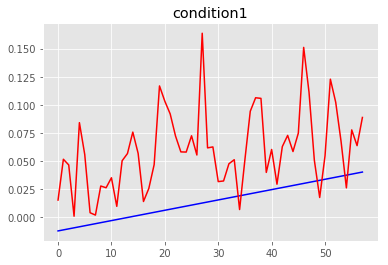

MSE condition1: 0.0031604104625553202
R2 condition1: -12.368601840019421


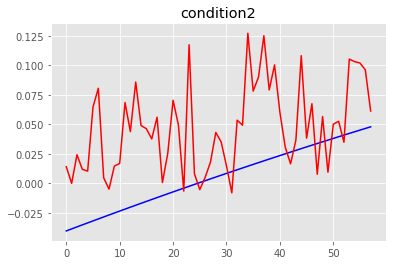

MSE condition2: 0.003032286951105661
R2 condition2: -3.500257108509195


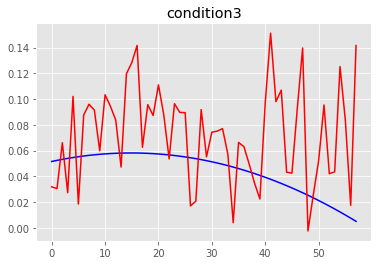

MSE condition3: 0.0023529143710808898
R2 condition3: -8.69544267718566


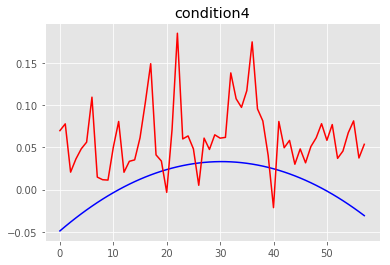

MSE condition4: 0.004569238981906865
R2 condition4: -7.565513188187831
==== the test person number # 4 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.45036525e-09 4.65305309e-09 3.98186034e-09 3.99971145e-09]
Global min values from training is:  [-4.43627908e-09 -4.66

n_neighbors: 28 weights_type:uniform All_MSE: 0.011412515329526382 All_R2: 0.1588283592021147
n_neighbors: 28 weights_type:distance All_MSE: 0.01117476151860869 All_R2: 0.17635225796246656
n_neighbors: 29 weights_type:uniform All_MSE: 0.011436959398800845 All_R2: 0.15702668294883682
n_neighbors: 29 weights_type:distance All_MSE: 0.011203364240339407 All_R2: 0.17424406378486357
n_neighbors: 30 weights_type:uniform All_MSE: 0.01153431298467846 All_R2: 0.1498511328439126
n_neighbors: 30 weights_type:distance All_MSE: 0.011285983935031595 All_R2: 0.16815449087829792
n_neighbors: 31 weights_type:uniform All_MSE: 0.011573347786932149 All_R2: 0.14697403102088102
n_neighbors: 31 weights_type:distance All_MSE: 0.011321336590667069 All_R2: 0.16554878560747865
n_neighbors: 32 weights_type:uniform All_MSE: 0.01178386279050079 All_R2: 0.13145779767079135
n_neighbors: 32 weights_type:distance All_MSE: 0.011475769601628825 All_R2: 0.15416613546654345
n_neighbors: 33 weights_type:uniform All_MSE: 0.01

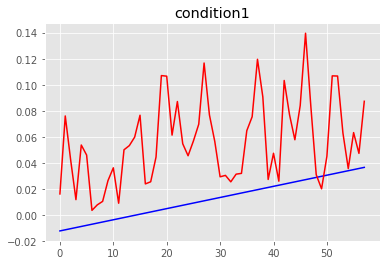

MSE condition1: 0.0028244097857230365
R2 condition1: -12.787914258985486


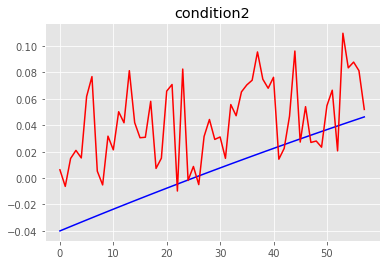

MSE condition2: 0.0023591081405521254
R2 condition2: -2.6665815065036527


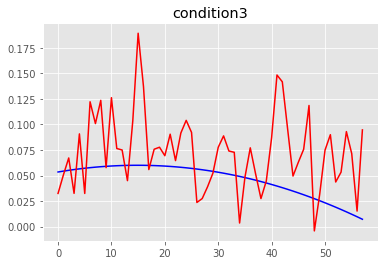

MSE condition3: 0.002143856803712384
R2 condition3: -7.934781501070992


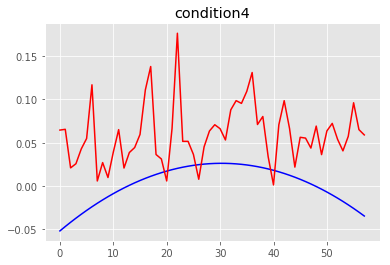

MSE condition4: 0.004640281056385752
R2 condition4: -8.668149386238204
==== the test person number # 4 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.03419651e-09 4.26367906e-09 3.72656121e-09 3.70048123e-09]
Global min values from training is:  [-4.02888591e-09 -4.27

n_neighbors: 38 weights_type:uniform All_MSE: 7.565160951814056 All_R2: -4.861716332773594
n_neighbors: 38 weights_type:distance All_MSE: 7.378347416662918 All_R2: -4.716967535338424
n_neighbors: 39 weights_type:uniform All_MSE: 7.593235361453332 All_R2: -4.883469237512001
n_neighbors: 39 weights_type:distance All_MSE: 7.405630719543233 All_R2: -4.738107466547317
n_neighbors: 40 weights_type:uniform All_MSE: 7.614198726877415 All_R2: -4.899712289349091
n_neighbors: 40 weights_type:distance All_MSE: 7.4269487180880756 All_R2: -4.754625298890644
n_neighbors: 41 weights_type:uniform All_MSE: 7.632784272525731 All_R2: -4.914112934249332
n_neighbors: 41 weights_type:distance All_MSE: 7.445850765915886 All_R2: -4.76927117928643
n_neighbors: 42 weights_type:uniform All_MSE: 7.654642753407622 All_R2: -4.931049548712806
n_neighbors: 42 weights_type:distance All_MSE: 7.467677635855491 All_R2: -4.786183300632325
n_neighbors: 43 weights_type:uniform All_MSE: 7.677566109457253 All_R2: -4.9488112607

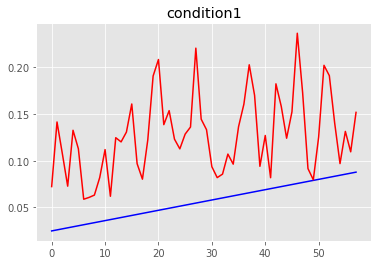

MSE condition1: 0.006621039531255969
R2 condition1: -18.416599316492032


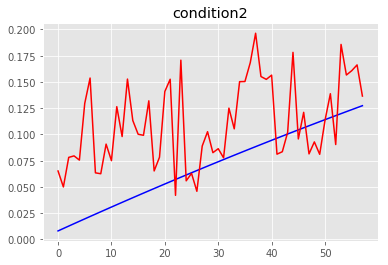

MSE condition2: 0.0033362109051799055
R2 condition2: -1.7162573333898692


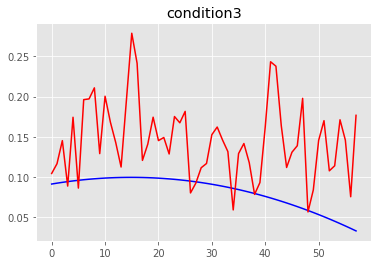

MSE condition3: 0.006260643668248478
R2 condition3: -15.399816280298229


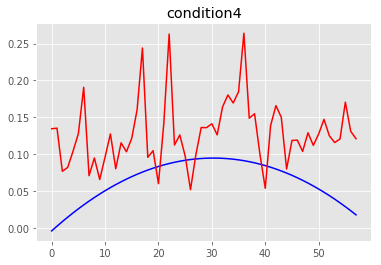

MSE condition4: 0.006225959375892107
R2 condition4: -7.12174907219282
==== the test person number # 4 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.39139035e-09 4.57465106e-09 3.94133679e-09 3.98936087e-09]
Global min values from training is:  [-4.37936031e-09 -4.586

n_neighbors: 25 weights_type:distance All_MSE: 0.01498211242217164 All_R2: -0.09307103539537409
n_neighbors: 26 weights_type:uniform All_MSE: 0.01565562029676489 All_R2: -0.14220909610963695
n_neighbors: 26 weights_type:distance All_MSE: 0.015230993809088798 All_R2: -0.111229024577566
n_neighbors: 27 weights_type:uniform All_MSE: 0.015959179807441017 All_R2: -0.16435631402450368
n_neighbors: 27 weights_type:distance All_MSE: 0.015502331619353419 All_R2: -0.13102539860349727
n_neighbors: 28 weights_type:uniform All_MSE: 0.01574086920880703 All_R2: -0.1484287208145172
n_neighbors: 28 weights_type:distance All_MSE: 0.01532938534105054 All_R2: -0.11840751387767301
n_neighbors: 29 weights_type:uniform All_MSE: 0.015726697328301665 All_R2: -0.14739476300796817
n_neighbors: 29 weights_type:distance All_MSE: 0.015311561666452799 All_R2: -0.11710712699642967
n_neighbors: 30 weights_type:uniform All_MSE: 0.015480851313930828 All_R2: -0.12945822976727017
n_neighbors: 30 weights_type:distance All_

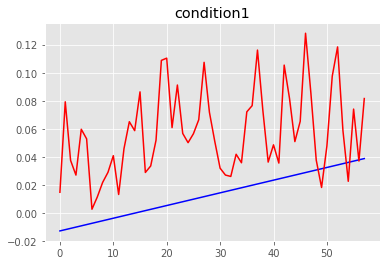

MSE condition1: 0.00280442718493257
R2 condition1: -11.25457726943642


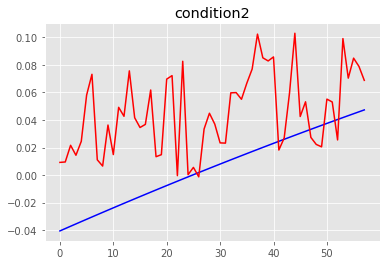

MSE condition2: 0.0024978719960752765
R2 condition2: -2.7409771766514335


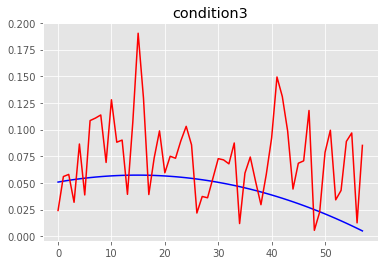

MSE condition3: 0.002261520975514437
R2 condition3: -8.60626139402815


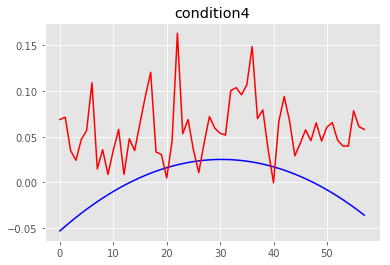

MSE condition4: 0.004504677311021436
R2 condition4: -8.366765861835397
==== the test person number # 4 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44574140e-09 4.66319716e-09 3.98805894e-09 4.05848289e-09]
Global min values from training is:  [-4.43531889e-09 -4.67

n_neighbors: 24 weights_type:uniform All_MSE: 0.004058795203076552 All_R2: -0.5605084625493406
n_neighbors: 24 weights_type:distance All_MSE: 0.004035880451885835 All_R2: -0.5516982956497587
n_neighbors: 25 weights_type:uniform All_MSE: 0.004077703438150146 All_R2: -0.5677782210288644
n_neighbors: 25 weights_type:distance All_MSE: 0.0040476141320249055 All_R2: -0.556209611505259
n_neighbors: 26 weights_type:uniform All_MSE: 0.004077508718264891 All_R2: -0.5677033559485722
n_neighbors: 26 weights_type:distance All_MSE: 0.004046756475499645 All_R2: -0.5558798633414159
n_neighbors: 27 weights_type:uniform All_MSE: 0.004059715609566973 All_R2: -0.5608623365551537
n_neighbors: 27 weights_type:distance All_MSE: 0.004027274030193693 All_R2: -0.548389334933368
n_neighbors: 28 weights_type:uniform All_MSE: 0.003983035140055272 All_R2: -0.53138055302132
The best neighbors is: 28 The best weigths :uniform The best mse: 0.003983035140055272
n_neighbors: 28 weights_type:distance All_MSE: 0.00396570

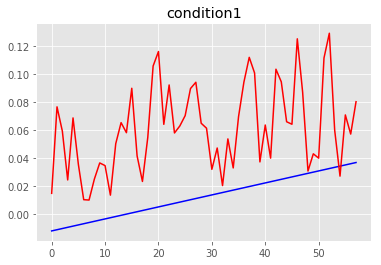

MSE condition1: 0.0032318254558914923
R2 condition1: -14.68211123305989


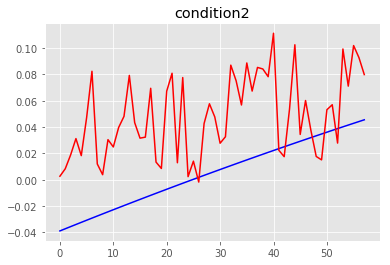

MSE condition2: 0.0027536993958483334
R2 condition2: -3.4773078518600737


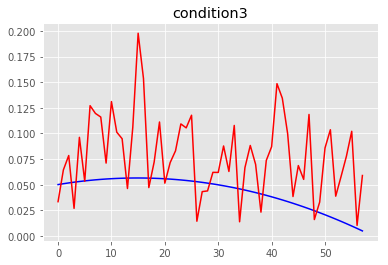

MSE condition3: 0.002672632352001764
R2 condition3: -10.66370097781863


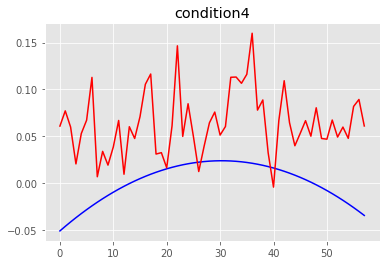

MSE condition4: 0.005259704872122151
R2 condition4: -10.87943580794177
==== the test person number # 4 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.19025695e-09 4.42483247e-09 3.65744909e-09 3.84746717e-09]
Global min values from training is:  [-4.17326579e-09 -4.43

n_neighbors: 24 weights_type:uniform All_MSE: 0.24970157837052825 All_R2: 0.5146986333647485
n_neighbors: 24 weights_type:distance All_MSE: 0.24628367531003215 All_R2: 0.5213414148686133
n_neighbors: 25 weights_type:uniform All_MSE: 0.25538616676105813 All_R2: 0.5036504912877715
n_neighbors: 25 weights_type:distance All_MSE: 0.2505729926933851 All_R2: 0.513005017471138
n_neighbors: 26 weights_type:uniform All_MSE: 0.2581816591097984 All_R2: 0.49821738082801725
n_neighbors: 26 weights_type:distance All_MSE: 0.2522110892802666 All_R2: 0.5098213351032418
n_neighbors: 27 weights_type:uniform All_MSE: 0.2580217384844795 All_R2: 0.49852819062956866
n_neighbors: 27 weights_type:distance All_MSE: 0.25209990432179363 All_R2: 0.5100374258970939
n_neighbors: 28 weights_type:uniform All_MSE: 0.2584977655895695 All_R2: 0.49760301984705657
n_neighbors: 28 weights_type:distance All_MSE: 0.25209861092045 All_R2: 0.510039939655492
n_neighbors: 29 weights_type:uniform All_MSE: 0.2607037727893103 All_R2:

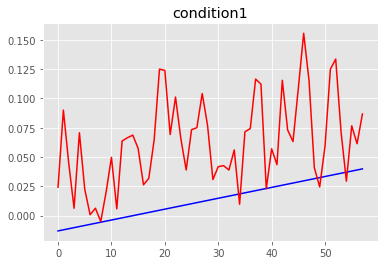

MSE condition1: 0.003584288319559245
R2 condition1: -13.806139262636398


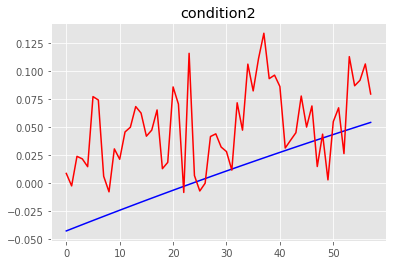

MSE condition2: 0.0030931887906198684
R2 condition2: -2.8444399534673046


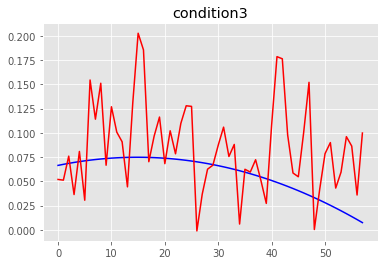

MSE condition3: 0.0028768239945054373
R2 condition3: -6.361221770120403


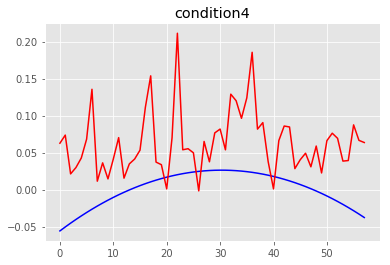

MSE condition4: 0.005803861439591764
R2 condition4: -9.909892377389546
==== the test person number # 4 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.49281527e-09 4.71933007e-09 4.07319103e-09 4.11385136e-09]
Global min values from training is:  [-4.48148183e-09 -4.73

n_neighbors: 23 weights_type:distance All_MSE: 0.0026825073939292063 All_R2: 0.06931653332531273
n_neighbors: 24 weights_type:uniform All_MSE: 0.0027755942942566916 All_R2: 0.03702046611041976
n_neighbors: 24 weights_type:distance All_MSE: 0.0026961310707362025 All_R2: 0.0645898620071702
n_neighbors: 25 weights_type:uniform All_MSE: 0.002752586432358029 All_R2: 0.045002936809691585
n_neighbors: 25 weights_type:distance All_MSE: 0.002682012833048738 All_R2: 0.06948811892308504
n_neighbors: 26 weights_type:uniform All_MSE: 0.002729005803671002 All_R2: 0.053184126282822874
n_neighbors: 26 weights_type:distance All_MSE: 0.002663128008874361 All_R2: 0.0760401208560254
n_neighbors: 27 weights_type:uniform All_MSE: 0.0027659253059998342 All_R2: 0.040375076625378314
n_neighbors: 27 weights_type:distance All_MSE: 0.002691370645277491 All_R2: 0.06624146948411014
n_neighbors: 28 weights_type:uniform All_MSE: 0.0027361392844329853 All_R2: 0.050709198303110936
n_neighbors: 28 weights_type:distance 

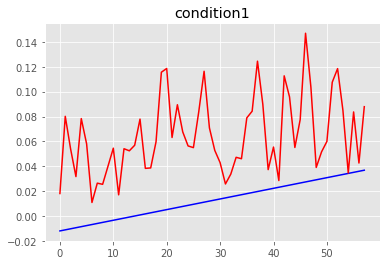

MSE condition1: 0.0035722665847834675
R2 condition1: -16.415856444147167


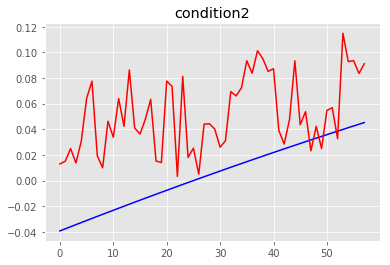

MSE condition2: 0.003054011806574883
R2 condition2: -3.954646265521399


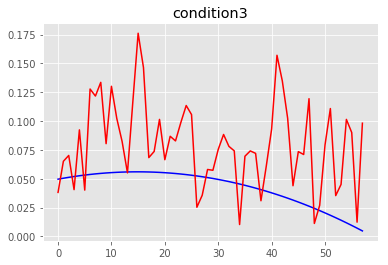

MSE condition3: 0.002730009219587109
R2 condition3: -11.093488458123844


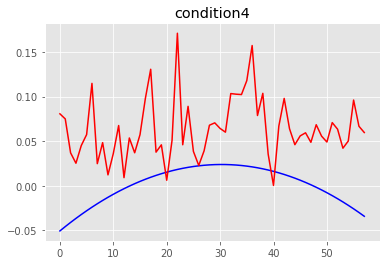

MSE condition4: 0.005261217727290554
R2 condition4: -10.982928528737574
==== the test person number # 5 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30328738e-09 3.85233593e-09 3.82769260e-09 3.79385937e-09]
Global min values from training is:  [-4.29392564e-09 -3.8

n_neighbors: 25 weights_type:distance All_MSE: 0.08687117111738675 All_R2: -0.7331741443541899
n_neighbors: 26 weights_type:uniform All_MSE: 0.0835423338214354 All_R2: -0.6667602275404212
The best neighbors is: 26 The best weigths :uniform The best mse: 0.0835423338214354
n_neighbors: 26 weights_type:distance All_MSE: 0.0847747911012612 All_R2: -0.6913490878486213
n_neighbors: 27 weights_type:uniform All_MSE: 0.08261005749615766 All_R2: -0.6481603030593579
The best neighbors is: 27 The best weigths :uniform The best mse: 0.08261005749615766
n_neighbors: 27 weights_type:distance All_MSE: 0.08395722169494031 All_R2: -0.6750376908912161
n_neighbors: 28 weights_type:uniform All_MSE: 0.08530386335265128 All_R2: -0.7019046534615845
n_neighbors: 28 weights_type:distance All_MSE: 0.08607485859140866 All_R2: -0.7172868452295398
n_neighbors: 29 weights_type:uniform All_MSE: 0.08391217126261076 All_R2: -0.6741388858733803
n_neighbors: 29 weights_type:distance All_MSE: 0.0848609464108542 All_R2: -

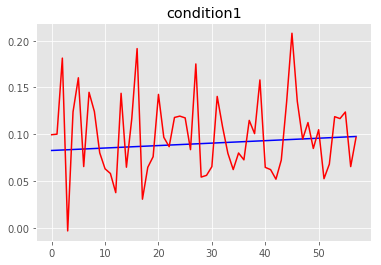

MSE condition1: 0.0018116792650199475
R2 condition1: -92.88743810280958


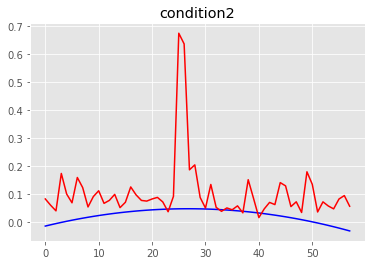

MSE condition2: 0.01875745964729226
R2 condition2: -36.63567523144472


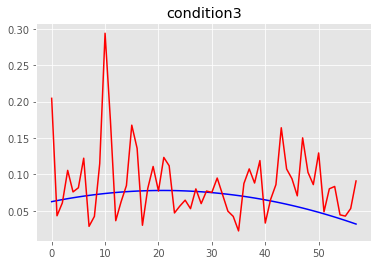

MSE condition3: 0.0028022808873850624
R2 condition3: -16.52432565479744


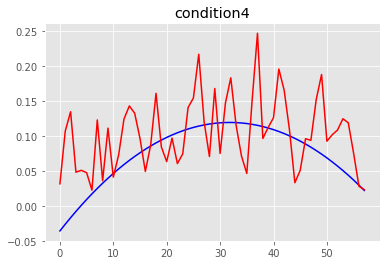

MSE condition4: 0.0034073767313994112
R2 condition4: -0.9269337562142246
==== the test person number # 5 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.35872142e-09 4.32356058e-09 3.98935166e-09 4.00894906e-09]
Global min values from training is:  [-4.34624978e-09 -4.

n_neighbors: 28 weights_type:distance All_MSE: 0.012600501540009962 All_R2: -0.4928608469296898
n_neighbors: 29 weights_type:uniform All_MSE: 0.012418624024616045 All_R2: -0.47131267118396347
The best neighbors is: 29 The best weigths :uniform The best mse: 0.012418624024616045
n_neighbors: 29 weights_type:distance All_MSE: 0.012457589047712622 All_R2: -0.475929103093113
n_neighbors: 30 weights_type:uniform All_MSE: 0.012345195974081387 All_R2: -0.4626131871704502
The best neighbors is: 30 The best weigths :uniform The best mse: 0.012345195974081387
n_neighbors: 30 weights_type:distance All_MSE: 0.012397500900522971 All_R2: -0.46881008151931725
n_neighbors: 31 weights_type:uniform All_MSE: 0.012189796958735708 All_R2: -0.4442020862373355
The best neighbors is: 31 The best weigths :uniform The best mse: 0.012189796958735708
n_neighbors: 31 weights_type:distance All_MSE: 0.012261532503519574 All_R2: -0.4527010484255438
n_neighbors: 32 weights_type:uniform All_MSE: 0.01219814287961057 All

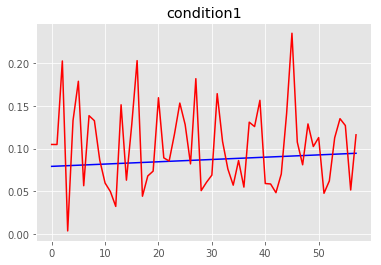

MSE condition1: 0.002530993799485899
R2 condition1: -124.54278208759055


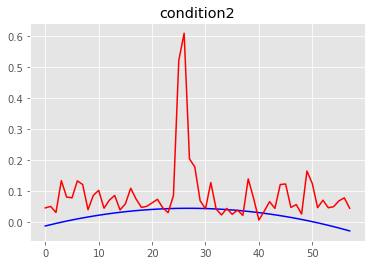

MSE condition2: 0.01396936576993419
R2 condition2: -32.16548999133659


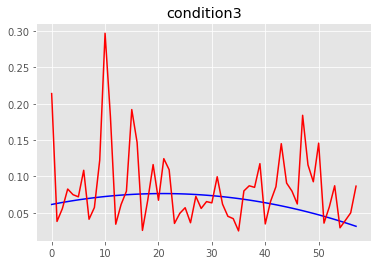

MSE condition3: 0.0031415695509898634
R2 condition3: -19.613049467036326


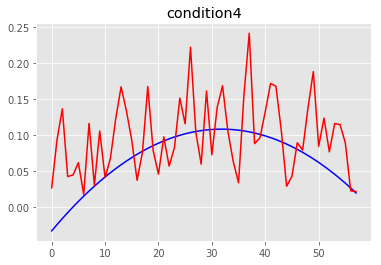

MSE condition4: 0.003610735718893783
R2 condition4: -1.4608875822367304
==== the test person number # 5 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41198493e-09 4.36696487e-09 4.04903982e-09 3.96915186e-09]
Global min values from training is:  [-4.40172199e-09 -4.3

n_neighbors: 30 weights_type:uniform All_MSE: 0.0049460385878118554 All_R2: -0.5014388704363173
n_neighbors: 30 weights_type:distance All_MSE: 0.004922202932769423 All_R2: -0.4942032255161162
n_neighbors: 31 weights_type:uniform All_MSE: 0.0050101515210240295 All_R2: -0.5209012438718292
n_neighbors: 31 weights_type:distance All_MSE: 0.004975032621865033 All_R2: -0.5102404131184692
n_neighbors: 32 weights_type:uniform All_MSE: 0.004969764009856158 All_R2: -0.5086410525953089
n_neighbors: 32 weights_type:distance All_MSE: 0.004939473019417584 All_R2: -0.4994458007465741
n_neighbors: 33 weights_type:uniform All_MSE: 0.004986733538712557 All_R2: -0.5137923893238121
n_neighbors: 33 weights_type:distance All_MSE: 0.0049488773385817746 All_R2: -0.5023006127526715
n_neighbors: 34 weights_type:uniform All_MSE: 0.0050448960686480075 All_R2: -0.5314484350051367
n_neighbors: 34 weights_type:distance All_MSE: 0.004995922096179251 All_R2: -0.5165817038628713
n_neighbors: 35 weights_type:uniform All_

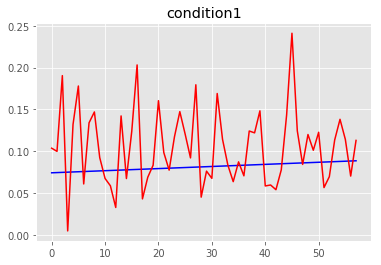

MSE condition1: 0.002593753425716532
R2 condition1: -144.84296751876218


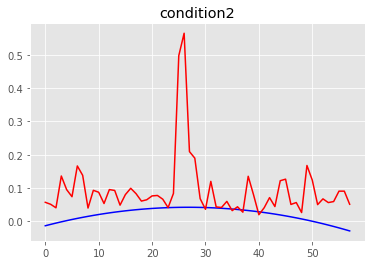

MSE condition2: 0.01372541747250777
R2 condition2: -33.32723101235052


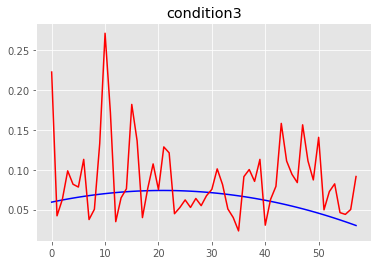

MSE condition3: 0.0029625099046116576
R2 condition3: -19.47699409388646


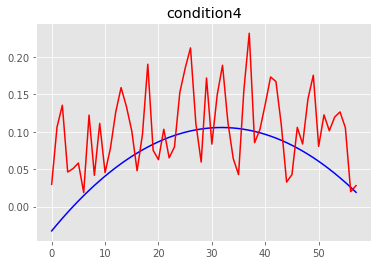

MSE condition4: 0.004028245269501269
R2 condition4: -1.8711503949287849
==== the test person number # 5 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.39995175e-09 4.32823803e-09 4.04192642e-09 3.96643301e-09]
Global min values from training is:  [-4.39095564e-09 -4.3

n_neighbors: 25 weights_type:uniform All_MSE: 0.007277068508159114 All_R2: 0.3211933001544732
n_neighbors: 25 weights_type:distance All_MSE: 0.007228678003123109 All_R2: 0.32570717809729044
n_neighbors: 26 weights_type:uniform All_MSE: 0.007347160580198745 All_R2: 0.3146550948245095
n_neighbors: 26 weights_type:distance All_MSE: 0.007278866990273028 All_R2: 0.32102553731053296
n_neighbors: 27 weights_type:uniform All_MSE: 0.007303812424722954 All_R2: 0.31869862118817116
n_neighbors: 27 weights_type:distance All_MSE: 0.007237613731083335 All_R2: 0.3248736512450151
n_neighbors: 28 weights_type:uniform All_MSE: 0.007276104965184333 All_R2: 0.32128317967479625
n_neighbors: 28 weights_type:distance All_MSE: 0.007214439845314297 All_R2: 0.327035316880544
n_neighbors: 29 weights_type:uniform All_MSE: 0.007224951744905255 All_R2: 0.32605476435964287
n_neighbors: 29 weights_type:distance All_MSE: 0.007172443707963572 All_R2: 0.33095272666847475
n_neighbors: 30 weights_type:uniform All_MSE: 0.00

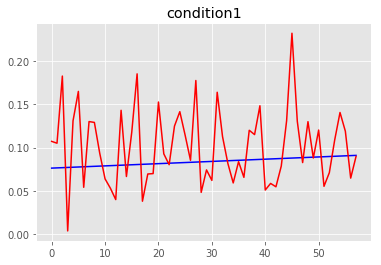

MSE condition1: 0.0022297957431266216
R2 condition1: -117.71444958345465


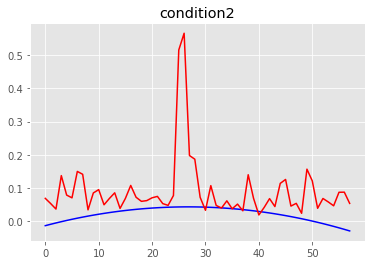

MSE condition2: 0.013483272120637692
R2 condition2: -31.356972885887295


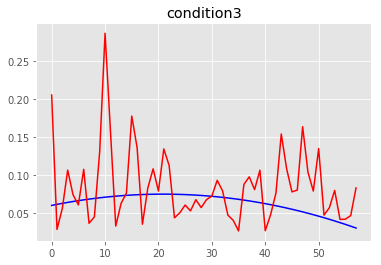

MSE condition3: 0.0027932871182212732
R2 condition3: -17.805827121432397


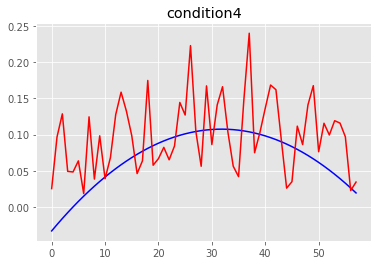

MSE condition4: 0.003565455767277872
R2 condition4: -1.4735672530297697
==== the test person number # 5 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.48616457e-09 4.44905391e-09 4.02780118e-09 4.05071379e-09]
Global min values from training is:  [-4.47477016e-09 -4.4

n_neighbors: 27 weights_type:uniform All_MSE: 0.003453826308573919 All_R2: -4.261179061364602
n_neighbors: 27 weights_type:distance All_MSE: 0.0034154136397429344 All_R2: -4.202665427241478
n_neighbors: 28 weights_type:uniform All_MSE: 0.0034477774925204263 All_R2: -4.251964960386888
n_neighbors: 28 weights_type:distance All_MSE: 0.0034072325651674316 All_R2: -4.190203278189788
The best neighbors is: 28 The best weigths :distance The best mse: 0.0034072325651674316
n_neighbors: 29 weights_type:uniform All_MSE: 0.0033976443863706304 All_R2: -4.1755977013554455
The best neighbors is: 29 The best weigths :uniform The best mse: 0.0033976443863706304
n_neighbors: 29 weights_type:distance All_MSE: 0.0033650667807676496 All_R2: -4.125972560669502
The best neighbors is: 29 The best weigths :distance The best mse: 0.0033650667807676496
n_neighbors: 30 weights_type:uniform All_MSE: 0.0034201775128088275 All_R2: -4.209922187421647
n_neighbors: 30 weights_type:distance All_MSE: 0.00338348732844326

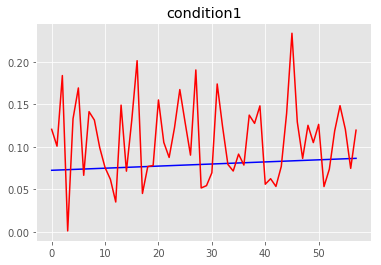

MSE condition1: 0.002839367509836267
R2 condition1: -165.8475277347649


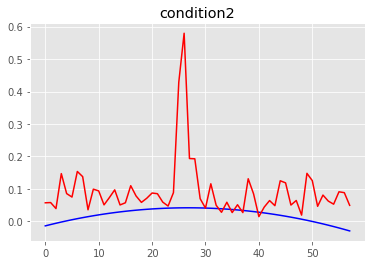

MSE condition2: 0.012840294508114242
R2 condition2: -31.00644056361638


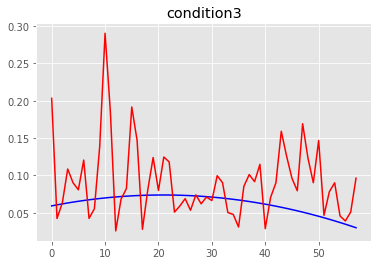

MSE condition3: 0.0033656148484698624
R2 condition3: -22.318472069617755


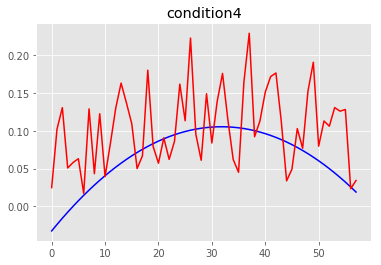

MSE condition4: 0.004118827248206402
R2 condition4: -1.963272700049537
==== the test person number # 5 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.46728348e-09 4.43650590e-09 4.04252378e-09 4.02508576e-09]
Global min values from training is:  [-4.45656174e-09 -4.43

n_neighbors: 27 weights_type:distance All_MSE: 0.003399738222973996 All_R2: -2.840681643546295
n_neighbors: 28 weights_type:uniform All_MSE: 0.0033226493560566625 All_R2: -2.7535944101556638
The best neighbors is: 28 The best weigths :uniform The best mse: 0.0033226493560566625
n_neighbors: 28 weights_type:distance All_MSE: 0.0033479647067862638 All_R2: -2.7821931423139485
n_neighbors: 29 weights_type:uniform All_MSE: 0.0033261306576532366 All_R2: -2.7575272338793426
n_neighbors: 29 weights_type:distance All_MSE: 0.003347520783968355 All_R2: -2.7816916430495726
n_neighbors: 30 weights_type:uniform All_MSE: 0.0033015510701986644 All_R2: -2.7297596929243406
The best neighbors is: 30 The best weigths :uniform The best mse: 0.0033015510701986644
n_neighbors: 30 weights_type:distance All_MSE: 0.0033249152201639807 All_R2: -2.756154155086888
n_neighbors: 31 weights_type:uniform All_MSE: 0.003288884500170125 All_R2: -2.715450278550446
The best neighbors is: 31 The best weigths :uniform The be

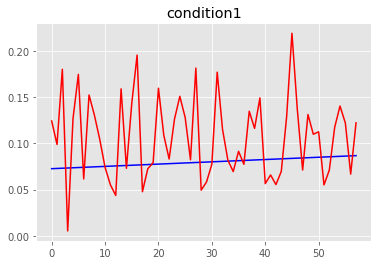

MSE condition1: 0.002680462536408325
R2 condition1: -155.88668175901864


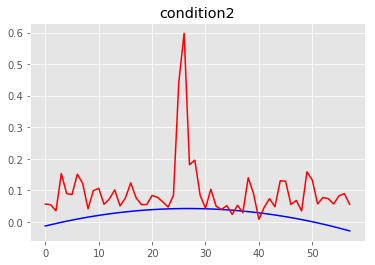

MSE condition2: 0.013582382294165496
R2 condition2: -33.04522210040028


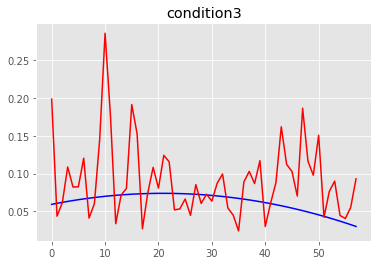

MSE condition3: 0.0033465133961567617
R2 condition3: -22.218560339006817


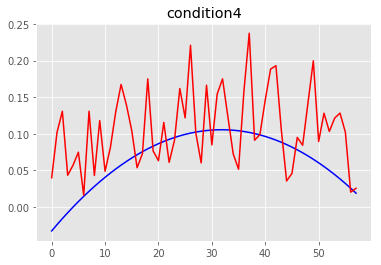

MSE condition4: 0.004240084180124954
R2 condition4: -2.033234364007817
==== the test person number # 5 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06282612e-09 4.08597195e-09 3.68669226e-09 3.63901231e-09]
Global min values from training is:  [-4.05569747e-09 -4.07

n_neighbors: 29 weights_type:uniform All_MSE: 0.24603749098135735 All_R2: -4.584087742221755
The best neighbors is: 29 The best weigths :uniform The best mse: 0.24603749098135735
n_neighbors: 29 weights_type:distance All_MSE: 0.2519148550667674 All_R2: -4.7174808954969185
n_neighbors: 30 weights_type:uniform All_MSE: 0.2428350015207132 All_R2: -4.511403770074062
The best neighbors is: 30 The best weigths :uniform The best mse: 0.2428350015207132
n_neighbors: 30 weights_type:distance All_MSE: 0.24902922495516427 All_R2: -4.6519883899827486
n_neighbors: 31 weights_type:uniform All_MSE: 0.2391853013970256 All_R2: -4.428569866825498
The best neighbors is: 31 The best weigths :uniform The best mse: 0.2391853013970256
n_neighbors: 31 weights_type:distance All_MSE: 0.24575106326397855 All_R2: -4.577586954478928
n_neighbors: 32 weights_type:uniform All_MSE: 0.23369076263964098 All_R2: -4.303865349632227
The best neighbors is: 32 The best weigths :uniform The best mse: 0.23369076263964098
n_nei

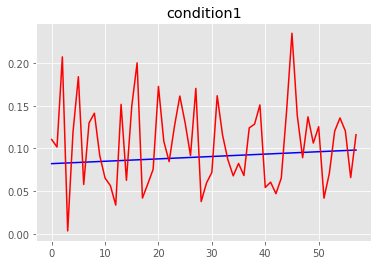

MSE condition1: 0.002540497197256791
R2 condition1: -115.43692169251614


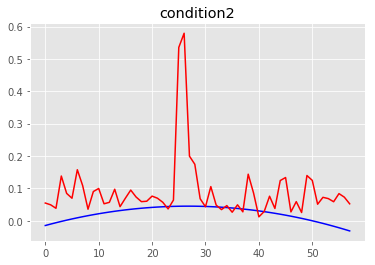

MSE condition2: 0.013809513263465413
R2 condition2: -28.84874980968664


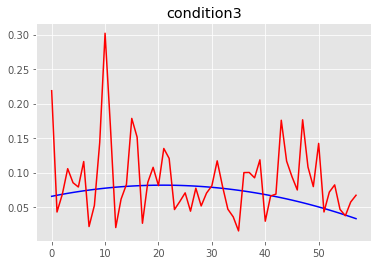

MSE condition3: 0.0031859203860938766
R2 condition3: -16.978678617041147


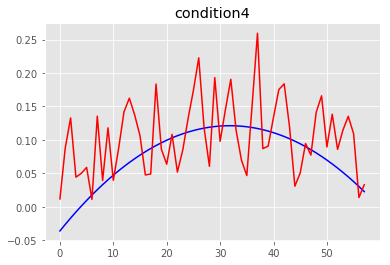

MSE condition4: 0.0037491487980728854
R2 condition4: -1.0635412107537334
==== the test person number # 5 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44253580e-09 4.41034274e-09 4.02418694e-09 3.91339069e-09]
Global min values from training is:  [-4.43046513e-09 -4.

n_neighbors: 29 weights_type:uniform All_MSE: 0.005420816160923507 All_R2: -3.4507001866851947
n_neighbors: 29 weights_type:distance All_MSE: 0.005292542209784255 All_R2: -3.345382300718544
n_neighbors: 30 weights_type:uniform All_MSE: 0.005323862827535723 All_R2: -3.3710977419243218
n_neighbors: 30 weights_type:distance All_MSE: 0.005208724812998722 All_R2: -3.2765649690757597
n_neighbors: 31 weights_type:uniform All_MSE: 0.005283222736581204 All_R2: -3.3377306519827643
n_neighbors: 31 weights_type:distance All_MSE: 0.005177738085966949 All_R2: -3.2511236650929334
n_neighbors: 32 weights_type:uniform All_MSE: 0.0052393408923374785 All_R2: -3.301701956935787
n_neighbors: 32 weights_type:distance All_MSE: 0.005139309228216216 All_R2: -3.2195720833222374
n_neighbors: 33 weights_type:uniform All_MSE: 0.00513041154299389 All_R2: -3.2122667388677364
n_neighbors: 33 weights_type:distance All_MSE: 0.005051422070110315 All_R2: -3.1474133198856764
n_neighbors: 34 weights_type:uniform All_MSE: 0

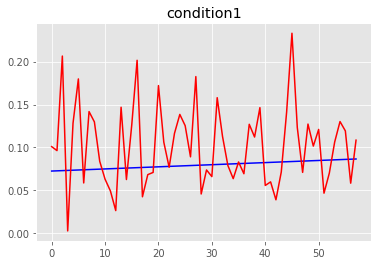

MSE condition1: 0.002736834853442291
R2 condition1: -159.64396096343313


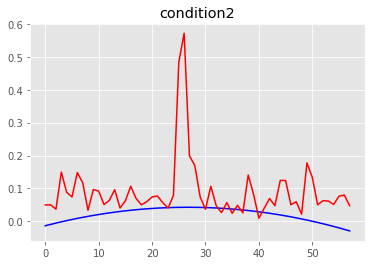

MSE condition2: 0.013185036403897838
R2 condition2: -31.204128349061577


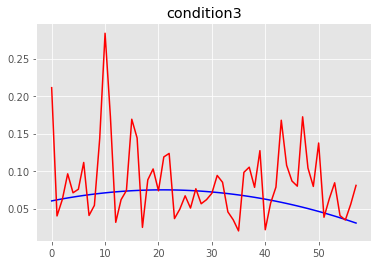

MSE condition3: 0.0030524361515824688
R2 condition3: -19.69762809156478


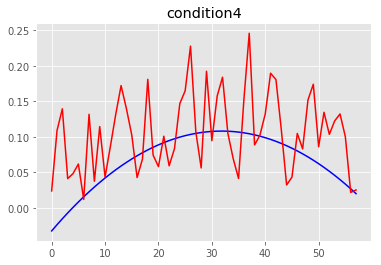

MSE condition4: 0.004265570275897624
R2 condition4: -1.9563288293983505
==== the test person number # 5 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.27495280e-09 4.31939870e-09 3.93773066e-09 3.85478184e-09]
Global min values from training is:  [-4.26688929e-09 -4.3

n_neighbors: 31 weights_type:uniform All_MSE: 0.06824142105985384 All_R2: -0.4449421462191743
n_neighbors: 31 weights_type:distance All_MSE: 0.06677605162743429 All_R2: -0.4139144504326644
n_neighbors: 32 weights_type:uniform All_MSE: 0.06837875101604504 All_R2: -0.4478499672838183
n_neighbors: 32 weights_type:distance All_MSE: 0.06692685514448067 All_R2: -0.4171075603385568
n_neighbors: 33 weights_type:uniform All_MSE: 0.06893993775714516 All_R2: -0.4597325213326817
n_neighbors: 33 weights_type:distance All_MSE: 0.0673990038005547 All_R2: -0.4271048241974633
n_neighbors: 34 weights_type:uniform All_MSE: 0.06854005007259988 All_R2: -0.45126530948129484
n_neighbors: 34 weights_type:distance All_MSE: 0.06708562125640856 All_R2: -0.42046927002972434
n_neighbors: 35 weights_type:uniform All_MSE: 0.06814382108304537 All_R2: -0.442875566746322
n_neighbors: 35 weights_type:distance All_MSE: 0.0667899387033061 All_R2: -0.41420849503055357
n_neighbors: 36 weights_type:uniform All_MSE: 0.0677049

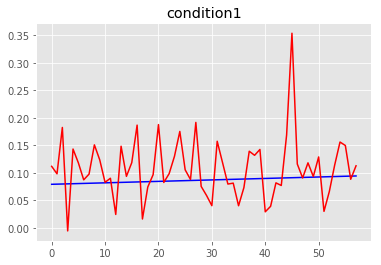

MSE condition1: 0.0035264111891740225
R2 condition1: -176.8479746998344


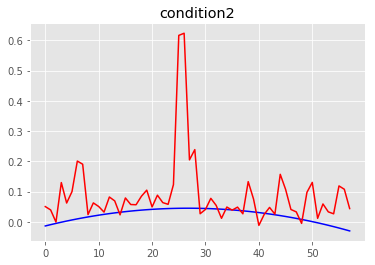

MSE condition2: 0.016829266732429262
R2 condition2: -36.76245916462822


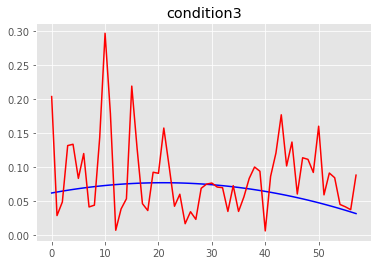

MSE condition3: 0.0037111794191682004
R2 condition3: -22.819255086214792


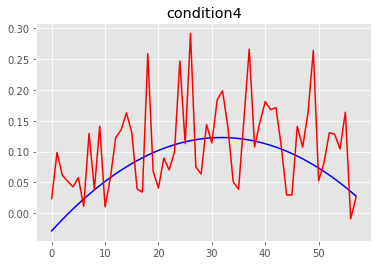

MSE condition4: 0.00517093564817579
R2 condition4: -2.0763664313187635
==== the test person number # 5 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43086748e-09 4.37393040e-09 3.97492183e-09 3.95490830e-09]
Global min values from training is:  [-4.41773053e-09 -4.36

n_neighbors: 31 weights_type:uniform All_MSE: 0.012064276294712276 All_R2: 0.13867745471145
n_neighbors: 31 weights_type:distance All_MSE: 0.011761637329266914 All_R2: 0.16028420157741352
n_neighbors: 32 weights_type:uniform All_MSE: 0.012261296149991037 All_R2: 0.12461132765371163
n_neighbors: 32 weights_type:distance All_MSE: 0.011910547015689974 All_R2: 0.14965287426072693
n_neighbors: 33 weights_type:uniform All_MSE: 0.012322644989245589 All_R2: 0.12023136012922875
n_neighbors: 33 weights_type:distance All_MSE: 0.011964725741761743 All_R2: 0.14578481312712366
n_neighbors: 34 weights_type:uniform All_MSE: 0.012243399290119514 All_R2: 0.12588906437994762
n_neighbors: 34 weights_type:distance All_MSE: 0.011903956336089136 All_R2: 0.1501234123013272
n_neighbors: 35 weights_type:uniform All_MSE: 0.012234110564269048 All_R2: 0.12655222798765753
n_neighbors: 35 weights_type:distance All_MSE: 0.011903137609616225 All_R2: 0.15018186483940876
n_neighbors: 36 weights_type:uniform All_MSE: 0.0

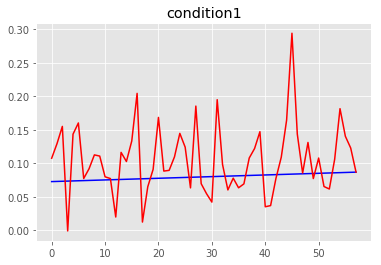

MSE condition1: 0.0032549407512539627
R2 condition1: -188.64018959150204


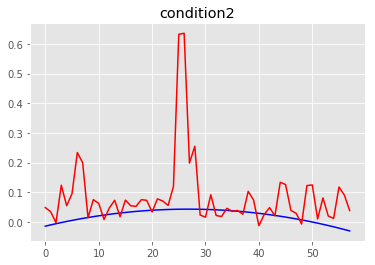

MSE condition2: 0.01766034967981728
R2 condition2: -40.5753917439179


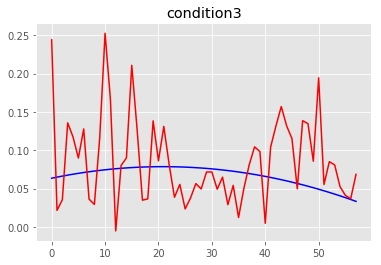

MSE condition3: 0.0036790518581494695
R2 condition3: -22.883602115461244


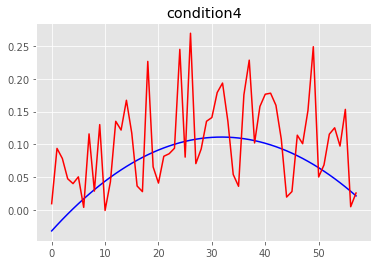

MSE condition4: 0.004941077525707247
R2 condition4: -2.271735398788609
==== the test person number # 5 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.01469873e-09 3.98455637e-09 3.71962270e-09 3.65567808e-09]
Global min values from training is:  [-4.01033736e-09 -3.98

n_neighbors: 37 weights_type:distance All_MSE: 7.84100604501416 All_R2: -4.31342499043338
n_neighbors: 38 weights_type:uniform All_MSE: 8.062314276978837 All_R2: -4.463393589304371
n_neighbors: 38 weights_type:distance All_MSE: 7.867049564909447 All_R2: -4.33107327289306
n_neighbors: 39 weights_type:uniform All_MSE: 8.085521928589095 All_R2: -4.479120157467602
n_neighbors: 39 weights_type:distance All_MSE: 7.890565108818818 All_R2: -4.347008482986558
n_neighbors: 40 weights_type:uniform All_MSE: 8.101450276180008 All_R2: -4.489913935671572
n_neighbors: 40 weights_type:distance All_MSE: 7.907494522391513 All_R2: -4.358480629371107
n_neighbors: 41 weights_type:uniform All_MSE: 8.121878673640428 All_R2: -4.503757153870557
n_neighbors: 41 weights_type:distance All_MSE: 7.92826810154689 All_R2: -4.372557758503677
n_neighbors: 42 weights_type:uniform All_MSE: 8.140822444389729 All_R2: -4.516594320980813
n_neighbors: 42 weights_type:distance All_MSE: 7.947660995651709 All_R2: -4.3856992721795

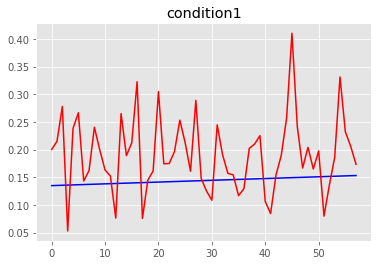

MSE condition1: 0.006811673020393134
R2 condition1: -236.45706980523633


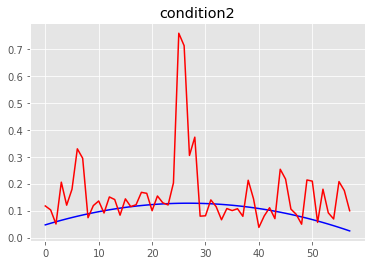

MSE condition2: 0.020376895272105608
R2 condition2: -23.38276759680385


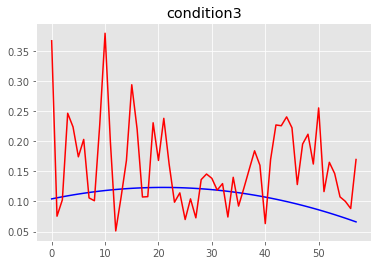

MSE condition3: 0.007799207909161627
R2 condition3: -30.752540384329134


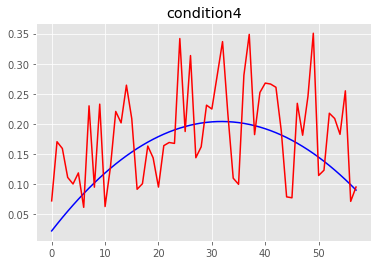

MSE condition4: 0.006444504856879528
R2 condition4: -1.6538635045013415
==== the test person number # 5 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37189258e-09 4.29552838e-09 3.93439827e-09 3.94455772e-09]
Global min values from training is:  [-4.36081176e-09 -4.2

n_neighbors: 32 weights_type:uniform All_MSE: 0.01628938742920494 All_R2: -0.1637943186421955
n_neighbors: 32 weights_type:distance All_MSE: 0.01599479902741137 All_R2: -0.14274746775014968
The best neighbors is: 32 The best weigths :distance The best mse: 0.01599479902741137
n_neighbors: 33 weights_type:uniform All_MSE: 0.016182766937348703 All_R2: -0.15617682392593268
n_neighbors: 33 weights_type:distance All_MSE: 0.01590426283371765 All_R2: -0.1362791147620357
The best neighbors is: 33 The best weigths :distance The best mse: 0.01590426283371765
n_neighbors: 34 weights_type:uniform All_MSE: 0.016156651658630297 All_R2: -0.15431101938697567
n_neighbors: 34 weights_type:distance All_MSE: 0.015882113841030877 All_R2: -0.13469668129334056
The best neighbors is: 34 The best weigths :distance The best mse: 0.015882113841030877
n_neighbors: 35 weights_type:uniform All_MSE: 0.016208147695454603 All_R2: -0.15799015068329858
n_neighbors: 35 weights_type:distance All_MSE: 0.01592417350098458 A

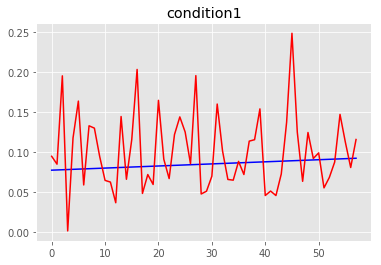

MSE condition1: 0.002478827937954966
R2 condition1: -128.17464989078323


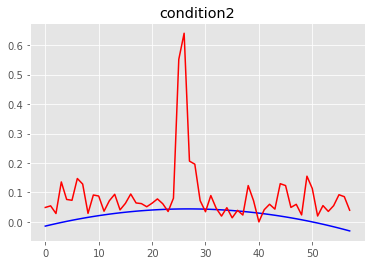

MSE condition2: 0.015213828109677396
R2 condition2: -33.461930903389664


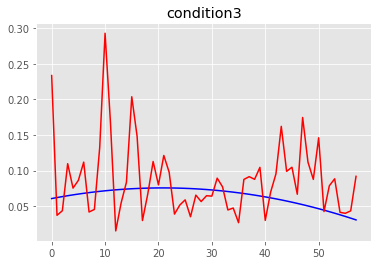

MSE condition3: 0.003375021485856735
R2 condition3: -21.332694680187974


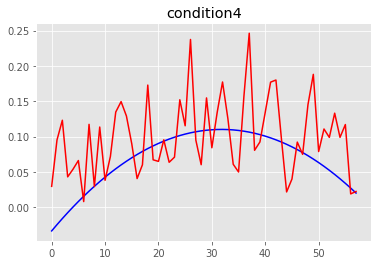

MSE condition4: 0.003739990216322181
R2 condition4: -1.4713986285415745
==== the test person number # 5 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.42624362e-09 4.38407447e-09 3.98112043e-09 4.01367974e-09]
Global min values from training is:  [-4.41677034e-09 -4.3

n_neighbors: 27 weights_type:distance All_MSE: 0.0042473699253664675 All_R2: -0.6166615227486778
The best neighbors is: 27 The best weigths :distance The best mse: 0.0042473699253664675
n_neighbors: 28 weights_type:uniform All_MSE: 0.004234357995294709 All_R2: -0.6117088374273272
The best neighbors is: 28 The best weigths :uniform The best mse: 0.004234357995294709
n_neighbors: 28 weights_type:distance All_MSE: 0.004225797012845776 All_R2: -0.6084503006939339
The best neighbors is: 28 The best weigths :distance The best mse: 0.004225797012845776
n_neighbors: 29 weights_type:uniform All_MSE: 0.004210534659031961 All_R2: -0.6026410444739818
The best neighbors is: 29 The best weigths :uniform The best mse: 0.004210534659031961
n_neighbors: 29 weights_type:distance All_MSE: 0.004200451022058107 All_R2: -0.598802945087433
The best neighbors is: 29 The best weigths :distance The best mse: 0.004200451022058107
n_neighbors: 30 weights_type:uniform All_MSE: 0.004138748569780285 All_R2: -0.57531

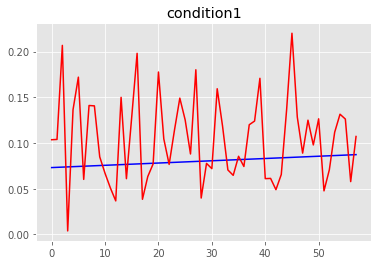

MSE condition1: 0.00275459412525409
R2 condition1: -158.5191047397142


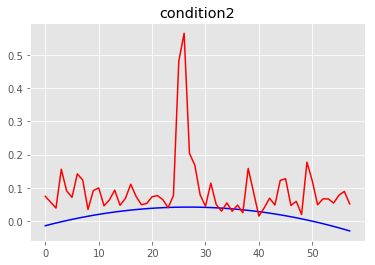

MSE condition2: 0.013316235471734867
R2 condition2: -31.85220422167741


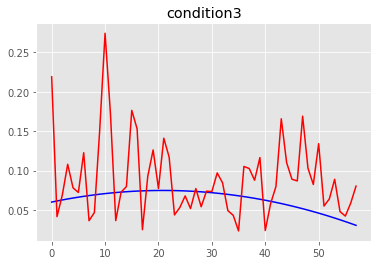

MSE condition3: 0.0031592331135858634
R2 condition3: -20.480226778193853


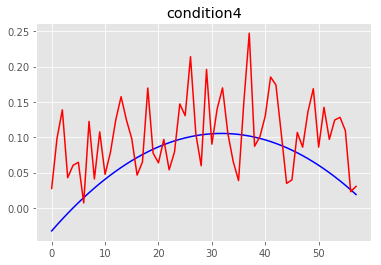

MSE condition4: 0.003954397150028941
R2 condition4: -1.8412383894892508
==== the test person number # 5 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.17075917e-09 4.14570978e-09 3.65051058e-09 3.80266402e-09]
Global min values from training is:  [-4.15471724e-09 -4.1

n_neighbors: 25 weights_type:distance All_MSE: 0.2708107705083631 All_R2: 0.47824017419985154
n_neighbors: 26 weights_type:uniform All_MSE: 0.2780264154268263 All_R2: 0.4643380918394425
n_neighbors: 26 weights_type:distance All_MSE: 0.27266186498229183 All_R2: 0.47467374761924097
n_neighbors: 27 weights_type:uniform All_MSE: 0.27802356345569523 All_R2: 0.46434358661336805
n_neighbors: 27 weights_type:distance All_MSE: 0.2726278672355124 All_R2: 0.47473924966114245
n_neighbors: 28 weights_type:uniform All_MSE: 0.2815771728910362 All_R2: 0.45749699540702615
n_neighbors: 28 weights_type:distance All_MSE: 0.27534579908094725 All_R2: 0.4695027236413365
n_neighbors: 29 weights_type:uniform All_MSE: 0.2805207400020045 All_R2: 0.4595323806286552
n_neighbors: 29 weights_type:distance All_MSE: 0.2741189736752865 All_R2: 0.4718663970238358
n_neighbors: 30 weights_type:uniform All_MSE: 0.27903144915350364 All_R2: 0.4624017352419185
n_neighbors: 30 weights_type:distance All_MSE: 0.27244328880375823

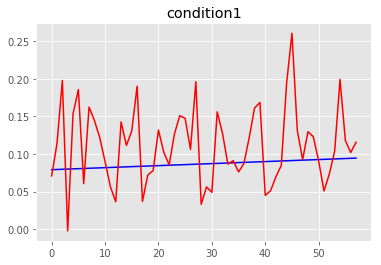

MSE condition1: 0.0031822126022631103
R2 condition1: -155.69858782529943


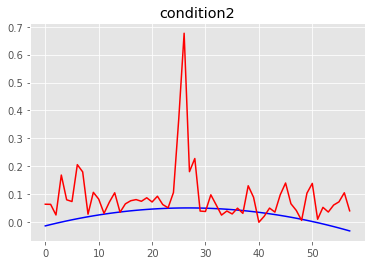

MSE condition2: 0.013750483963135161
R2 condition2: -24.64668416525377


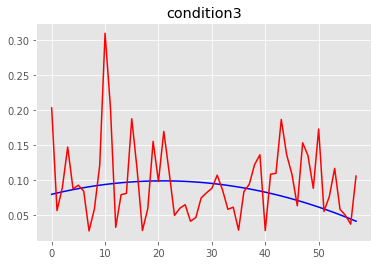

MSE condition3: 0.0032822180805833776
R2 condition3: -12.05139428288577


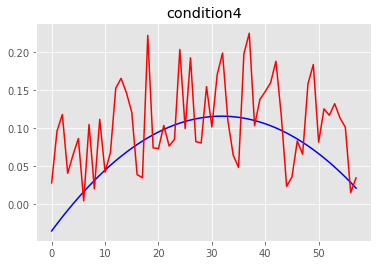

MSE condition4: 0.004098409337237117
R2 condition4: -1.4450860444029154
==== the test person number # 5 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.47331750e-09 4.44020738e-09 4.06625252e-09 4.06904821e-09]
Global min values from training is:  [-4.46293328e-09 -4.4

n_neighbors: 24 weights_type:uniform All_MSE: 0.0024384012413957473 All_R2: 0.18985474924940127
n_neighbors: 24 weights_type:distance All_MSE: 0.0023651071857622346 All_R2: 0.21420629159267524
n_neighbors: 25 weights_type:uniform All_MSE: 0.0024022267180845965 All_R2: 0.2018735334269881
n_neighbors: 25 weights_type:distance All_MSE: 0.0023366634128390074 All_R2: 0.22365657695013785
The best neighbors is: 25 The best weigths :distance The best mse: 0.0023366634128390074
n_neighbors: 26 weights_type:uniform All_MSE: 0.0024018331248134104 All_R2: 0.20200430260228452
n_neighbors: 26 weights_type:distance All_MSE: 0.0023348682232267955 All_R2: 0.2242530187144547
The best neighbors is: 26 The best weigths :distance The best mse: 0.0023348682232267955
n_neighbors: 27 weights_type:uniform All_MSE: 0.002401562290764526 All_R2: 0.20209428570872334
n_neighbors: 27 weights_type:distance All_MSE: 0.0023358016787841623 All_R2: 0.2239428832971373
n_neighbors: 28 weights_type:uniform All_MSE: 0.002427

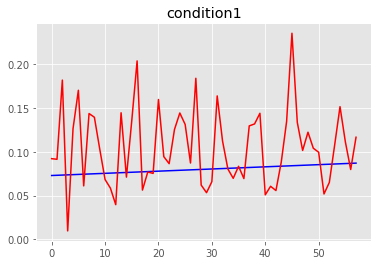

MSE condition1: 0.0025847392405284344
R2 condition1: -149.39390104521092


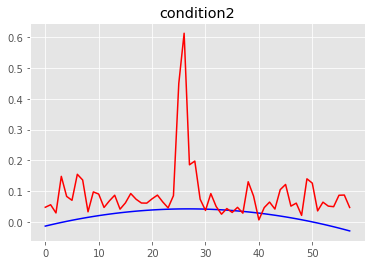

MSE condition2: 0.013260280014121658
R2 condition2: -31.63927661131592


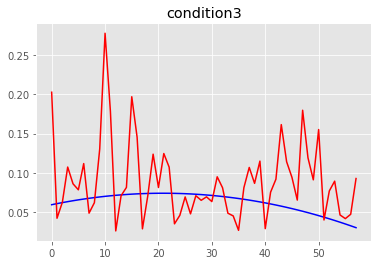

MSE condition3: 0.0032569731539077353
R2 condition3: -21.47960181014934


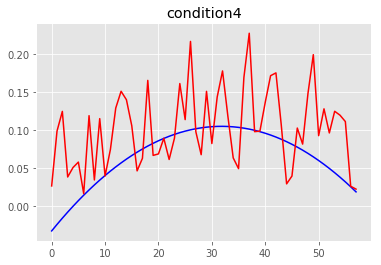

MSE condition4: 0.003804046977292256
R2 condition4: -1.7565113164894952
==== the test person number # 6 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30390406e-09 4.11891061e-09 3.84935371e-09 3.81303450e-09]
Global min values from training is:  [-4.29426577e-09 -4.1

n_neighbors: 26 weights_type:distance All_MSE: 0.08783723364774522 All_R2: -0.7989899766139474
n_neighbors: 27 weights_type:uniform All_MSE: 0.08681850953147009 All_R2: -0.7781255390855133
The best neighbors is: 27 The best weigths :uniform The best mse: 0.08681850953147009
n_neighbors: 27 weights_type:distance All_MSE: 0.08769776727378238 All_R2: -0.7961335728041461
n_neighbors: 28 weights_type:uniform All_MSE: 0.08432724514357524 All_R2: -0.7271020781134685
The best neighbors is: 28 The best weigths :uniform The best mse: 0.08432724514357524
n_neighbors: 28 weights_type:distance All_MSE: 0.08558737053194237 All_R2: -0.7529106429874537
n_neighbors: 29 weights_type:uniform All_MSE: 0.08379712371330417 All_R2: -0.7162446876898301
The best neighbors is: 29 The best weigths :uniform The best mse: 0.08379712371330417
n_neighbors: 29 weights_type:distance All_MSE: 0.08510629264898652 All_R2: -0.7430577109964602
n_neighbors: 30 weights_type:uniform All_MSE: 0.08214520268421038 All_R2: -0.682

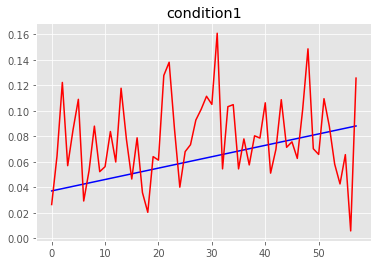

MSE condition1: 0.0013560298543575707
R2 condition1: -5.064871540136172


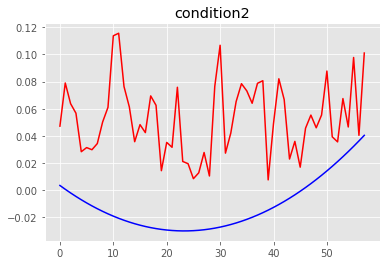

MSE condition2: 0.004942938089227895
R2 condition2: -12.834064493951551


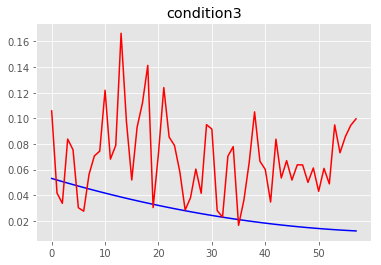

MSE condition3: 0.0027019584706783808
R2 condition3: -17.038531668737434


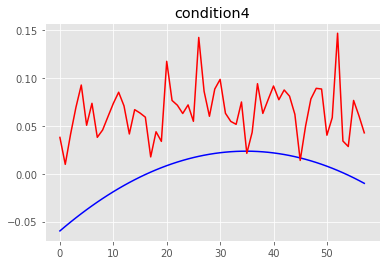

MSE condition4: 0.004903900090957861
R2 condition4: -8.651284322335702
==== the test person number # 6 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.35933810e-09 4.59013526e-09 4.01101277e-09 4.02812418e-09]
Global min values from training is:  [-4.34658991e-09 -4.60

n_neighbors: 26 weights_type:uniform All_MSE: 0.011931337228880328 All_R2: -0.4440885696930448
The best neighbors is: 26 The best weigths :uniform The best mse: 0.011931337228880328
n_neighbors: 26 weights_type:distance All_MSE: 0.011952061798198153 All_R2: -0.4465969317558687
n_neighbors: 27 weights_type:uniform All_MSE: 0.011750691891868998 All_R2: -0.42222447672993835
The best neighbors is: 27 The best weigths :uniform The best mse: 0.011750691891868998
n_neighbors: 27 weights_type:distance All_MSE: 0.01180176667626552 All_R2: -0.4284062240841262
n_neighbors: 28 weights_type:uniform All_MSE: 0.011801083282669616 All_R2: -0.42832351073343333
n_neighbors: 28 weights_type:distance All_MSE: 0.01183298319187098 All_R2: -0.4321844605472087
n_neighbors: 29 weights_type:uniform All_MSE: 0.011790758085939372 All_R2: -0.4270738185747134
n_neighbors: 29 weights_type:distance All_MSE: 0.011826306286841344 All_R2: -0.4313763330046494
n_neighbors: 30 weights_type:uniform All_MSE: 0.01170176519752

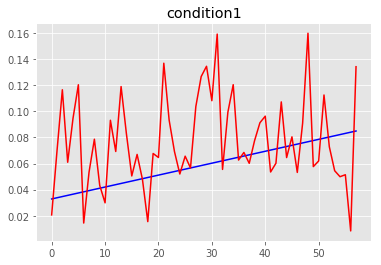

MSE condition1: 0.0016377950884121414
R2 condition1: -6.01270121277579


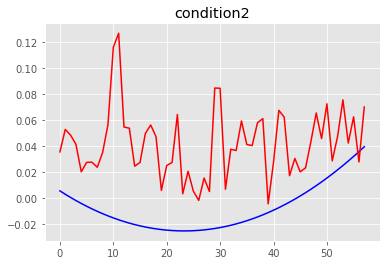

MSE condition2: 0.003309233830313023
R2 condition2: -9.88216357208136


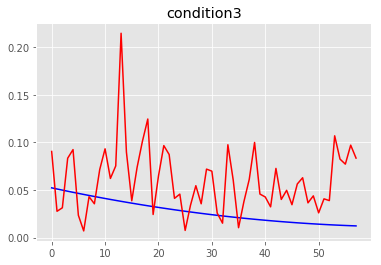

MSE condition3: 0.0023367890641499077
R2 condition3: -15.364539403264779


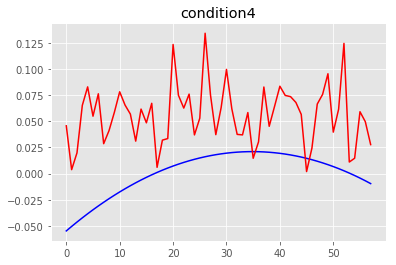

MSE condition4: 0.004034508756928559
R2 condition4: -8.551618229398912
==== the test person number # 6 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41260161e-09 4.63353955e-09 4.07070093e-09 3.98832699e-09]
Global min values from training is:  [-4.40206211e-09 -4.64

n_neighbors: 28 weights_type:distance All_MSE: 0.004869524016486529 All_R2: -0.5069404906395261
The best neighbors is: 28 The best weigths :distance The best mse: 0.004869524016486529
n_neighbors: 29 weights_type:uniform All_MSE: 0.0048776174185003645 All_R2: -0.5094451040597248
n_neighbors: 29 weights_type:distance All_MSE: 0.004855448151527543 All_R2: -0.5025845226279391
The best neighbors is: 29 The best weigths :distance The best mse: 0.004855448151527543
n_neighbors: 30 weights_type:uniform All_MSE: 0.004877953643379473 All_R2: -0.5095491534252425
n_neighbors: 30 weights_type:distance All_MSE: 0.004853605382557515 All_R2: -0.5020142526864768
The best neighbors is: 30 The best weigths :distance The best mse: 0.004853605382557515
n_neighbors: 31 weights_type:uniform All_MSE: 0.004873163359929754 All_R2: -0.5080667350066082
n_neighbors: 31 weights_type:distance All_MSE: 0.004846103714194618 All_R2: -0.49969275929921264
The best neighbors is: 31 The best weigths :distance The best mse

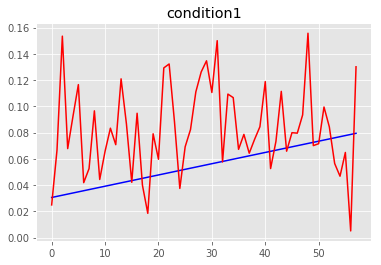

MSE condition1: 0.0020414908117475333
R2 condition1: -8.902659388795174


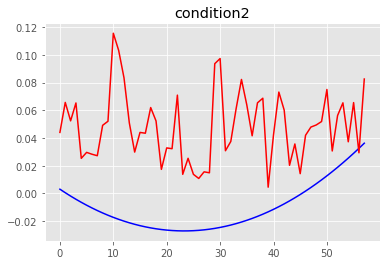

MSE condition2: 0.0041968912027193815
R2 condition2: -13.508457702542781


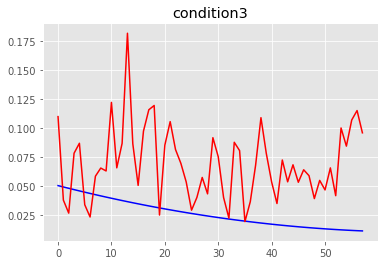

MSE condition3: 0.002905852456123501
R2 condition3: -20.431796256155824


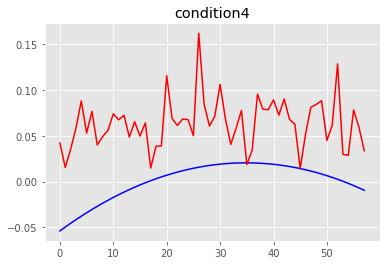

MSE condition4: 0.004760045624726364
R2 condition4: -10.780363511456782
==== the test person number # 6 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40056843e-09 4.59481271e-09 4.06358753e-09 3.98560814e-09]
Global min values from training is:  [-4.39129577e-09 -4.6

n_neighbors: 25 weights_type:uniform All_MSE: 0.006889235053605788 All_R2: 0.34446373763604365
The best neighbors is: 25 The best weigths :uniform The best mse: 0.006889235053605788
n_neighbors: 25 weights_type:distance All_MSE: 0.006871783459145627 All_R2: 0.3461243215638221
The best neighbors is: 25 The best weigths :distance The best mse: 0.006871783459145627
n_neighbors: 26 weights_type:uniform All_MSE: 0.006914552647577494 All_R2: 0.34205467468564044
n_neighbors: 26 weights_type:distance All_MSE: 0.006885294276763047 All_R2: 0.34483871716602044
n_neighbors: 27 weights_type:uniform All_MSE: 0.006920222195735449 All_R2: 0.34151519615430304
n_neighbors: 27 weights_type:distance All_MSE: 0.006887029562256914 All_R2: 0.34467359831640476
n_neighbors: 28 weights_type:uniform All_MSE: 0.006872691640125902 All_R2: 0.3460379047757858
n_neighbors: 28 weights_type:distance All_MSE: 0.006848542437582699 All_R2: 0.3483357909490781
The best neighbors is: 28 The best weigths :distance The best ms

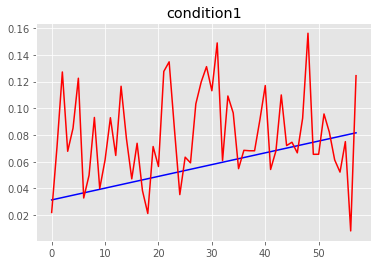

MSE condition1: 0.0017139878014285623
R2 condition1: -6.874311182963277


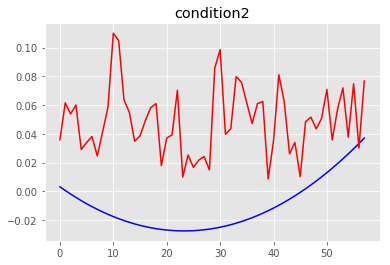

MSE condition2: 0.004277455359828794
R2 condition2: -13.211800476694526


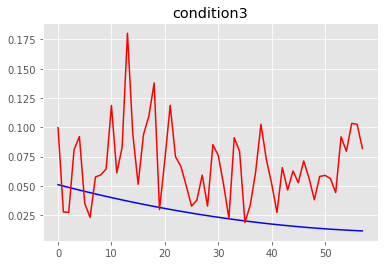

MSE condition3: 0.0027151393619919517
R2 condition3: -18.507557600401974


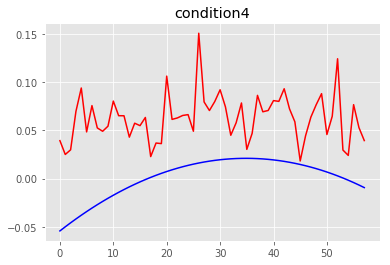

MSE condition4: 0.0045547211115471
R2 condition4: -9.974575578455653
==== the test person number # 6 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.48678125e-09 4.71562859e-09 4.04946229e-09 4.06988892e-09]
Global min values from training is:  [-4.47511029e-09 -4.7281

n_neighbors: 29 weights_type:distance All_MSE: 0.003838120170514654 All_R2: -5.007305159215651
n_neighbors: 30 weights_type:uniform All_MSE: 0.0038718708498306333 All_R2: -5.0601306625804225
n_neighbors: 30 weights_type:distance All_MSE: 0.0038276669377851564 All_R2: -4.990944087618987
n_neighbors: 31 weights_type:uniform All_MSE: 0.003841021321439864 All_R2: -5.011845949536538
n_neighbors: 31 weights_type:distance All_MSE: 0.0038039895725024532 All_R2: -4.953885019038458
n_neighbors: 32 weights_type:uniform All_MSE: 0.0038476559297156787 All_R2: -5.022230230057732
n_neighbors: 32 weights_type:distance All_MSE: 0.00380915494003527 All_R2: -4.961969690088497
n_neighbors: 33 weights_type:uniform All_MSE: 0.003834457460237413 All_R2: -5.001572400112845
n_neighbors: 33 weights_type:distance All_MSE: 0.0037975905059562175 All_R2: -4.943869401035488
n_neighbors: 34 weights_type:uniform All_MSE: 0.0038371438610317336 All_R2: -5.005777070272842
n_neighbors: 34 weights_type:distance All_MSE: 0.

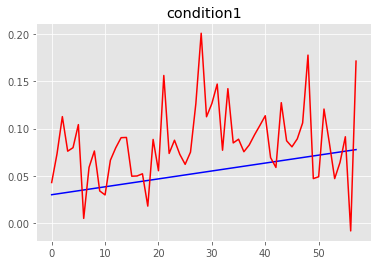

MSE condition1: 0.002474602737286852
R2 condition1: -11.541739111824386


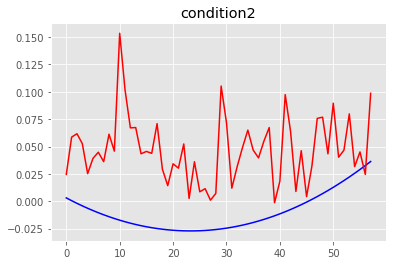

MSE condition2: 0.004275885631402843
R2 condition2: -13.73417256239599


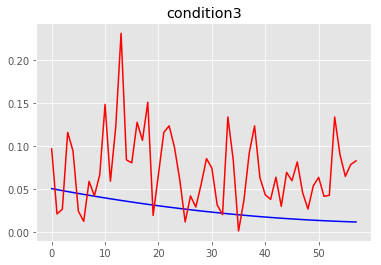

MSE condition3: 0.0038706020772013975
R2 condition3: -27.61461289838408


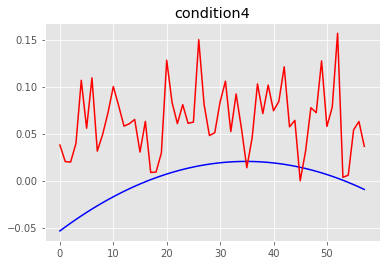

MSE condition4: 0.005387548148171195
R2 condition4: -12.45733704991809
==== the test person number # 6 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 7, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.46728348e-09 4.43650590e-09 4.04252378e-09 4.02508576e-09]
Global min values from training is:  [-4.45656174e-09 -4.43

n_neighbors: 30 weights_type:distance All_MSE: 0.006190721445135418 All_R2: -5.248298034691672
n_neighbors: 31 weights_type:uniform All_MSE: 0.006244096030021828 All_R2: -5.302169028049045
n_neighbors: 31 weights_type:distance All_MSE: 0.0062922581086202346 All_R2: -5.350779036384917
n_neighbors: 32 weights_type:uniform All_MSE: 0.006143314682145489 All_R2: -5.200450366750833
n_neighbors: 32 weights_type:distance All_MSE: 0.006195647409864199 All_R2: -5.2532698131841435
n_neighbors: 33 weights_type:uniform All_MSE: 0.005985210804865081 All_R2: -5.040876049856868
The best neighbors is: 33 The best weigths :uniform The best mse: 0.005985210804865081
n_neighbors: 33 weights_type:distance All_MSE: 0.0060548048234045655 All_R2: -5.1111173251460755
n_neighbors: 34 weights_type:uniform All_MSE: 0.005922855399660724 All_R2: -4.977940710374433
The best neighbors is: 34 The best weigths :uniform The best mse: 0.005922855399660724
n_neighbors: 34 weights_type:distance All_MSE: 0.00599627004163661

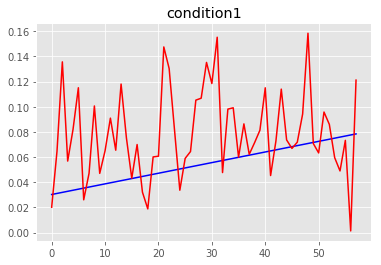

MSE condition1: 0.0018921285415810145
R2 condition1: -8.459635939795783


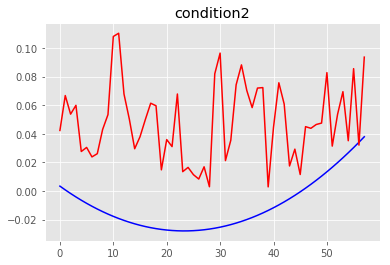

MSE condition2: 0.004271027314607121
R2 condition2: -12.659616842301302


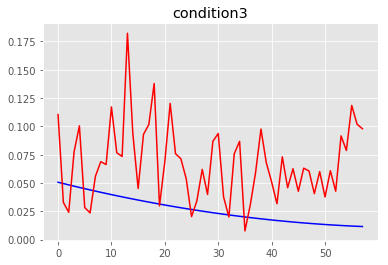

MSE condition3: 0.002820650211964367
R2 condition3: -19.68168832773598


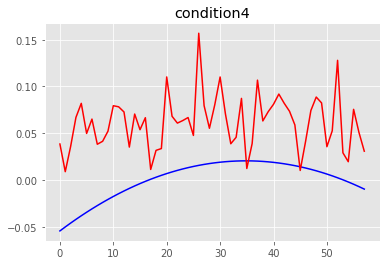

MSE condition4: 0.004586242345306031
R2 condition4: -10.18118563512782
==== the test person number # 6 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06344281e-09 4.35254662e-09 3.70835337e-09 3.65818744e-09]
Global min values from training is:  [-4.05603759e-09 -4.36

n_neighbors: 28 weights_type:distance All_MSE: 0.25520785352113223 All_R2: -4.8303115963292145
n_neighbors: 29 weights_type:uniform All_MSE: 0.24645385671476996 All_R2: -4.630323514496393
The best neighbors is: 29 The best weigths :uniform The best mse: 0.24645385671476996
n_neighbors: 29 weights_type:distance All_MSE: 0.25138310553723087 All_R2: -4.742933907061785
n_neighbors: 30 weights_type:uniform All_MSE: 0.23952392698036806 All_R2: -4.472006875197185
The best neighbors is: 30 The best weigths :uniform The best mse: 0.23952392698036806
n_neighbors: 30 weights_type:distance All_MSE: 0.24522531940198333 All_R2: -4.602257155086063
n_neighbors: 31 weights_type:uniform All_MSE: 0.23217205767892396 All_R2: -4.304050880695014
The best neighbors is: 31 The best weigths :uniform The best mse: 0.23217205767892396
n_neighbors: 31 weights_type:distance All_MSE: 0.23871518235076442 All_R2: -4.453530824686237
n_neighbors: 32 weights_type:uniform All_MSE: 0.2277696213529353 All_R2: -4.2034757016

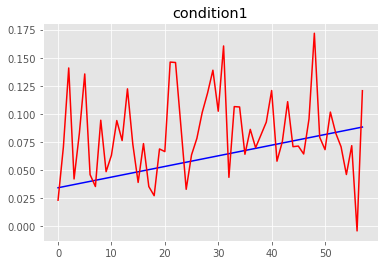

MSE condition1: 0.001882169315314169
R2 condition1: -6.449717859601253


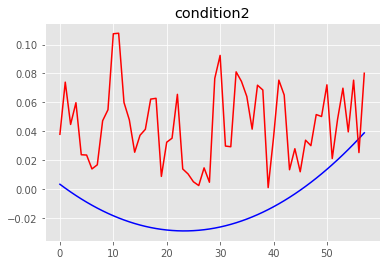

MSE condition2: 0.003994926994680202
R2 condition2: -11.00636061918375


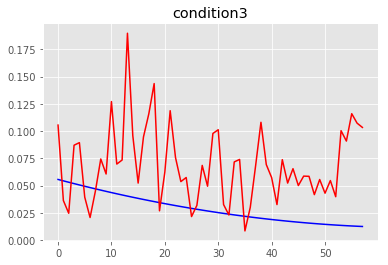

MSE condition3: 0.002869325435921166
R2 condition3: -16.295244669187426


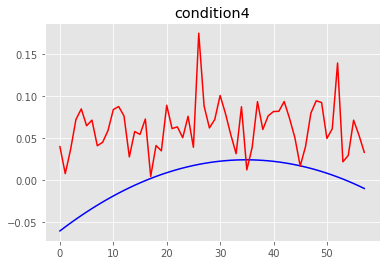

MSE condition4: 0.004803499250584684
R2 condition4: -8.203615800647114
==== the test person number # 6 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44315248e-09 4.67691742e-09 4.04584805e-09 3.93256581e-09]
Global min values from training is:  [-4.43080526e-09 -4.68

n_neighbors: 29 weights_type:distance All_MSE: 0.004931015442271464 All_R2: -3.0518855222507693
n_neighbors: 30 weights_type:uniform All_MSE: 0.004947866223194383 All_R2: -3.065732048602092
n_neighbors: 30 weights_type:distance All_MSE: 0.0048780636607038096 All_R2: -3.008374290208768
The best neighbors is: 30 The best weigths :distance The best mse: 0.0048780636607038096
n_neighbors: 31 weights_type:uniform All_MSE: 0.004891190948015764 All_R2: -3.0191611689010873
n_neighbors: 31 weights_type:distance All_MSE: 0.004827031683526419 All_R2: -2.9664405887394314
The best neighbors is: 31 The best weigths :distance The best mse: 0.004827031683526419
n_neighbors: 32 weights_type:uniform All_MSE: 0.004779791614924368 All_R2: -2.9276227524783853
The best neighbors is: 32 The best weigths :uniform The best mse: 0.004779791614924368
n_neighbors: 32 weights_type:distance All_MSE: 0.004734839219758556 All_R2: -2.890684730017246
The best neighbors is: 32 The best weigths :distance The best mse: 0.

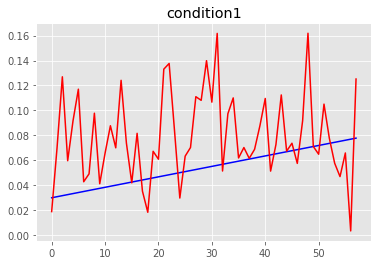

MSE condition1: 0.00197152937438365
R2 condition1: -8.981033226845744


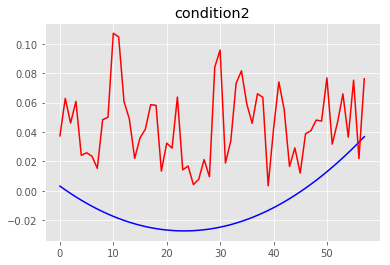

MSE condition2: 0.0038314913285123525
R2 condition2: -11.947443272362186


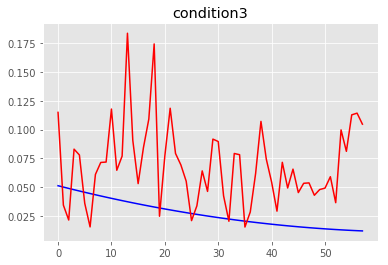

MSE condition3: 0.0030479341318795246
R2 condition3: -21.054561356309996


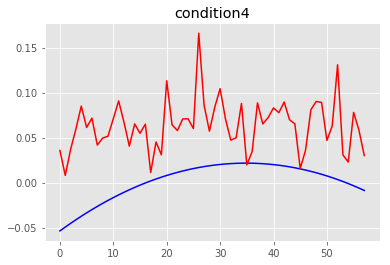

MSE condition4: 0.004687552484690078
R2 condition4: -10.283481810915761
==== the test person number # 6 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.27556948e-09 4.58597338e-09 3.95939177e-09 3.87395696e-09]
Global min values from training is:  [-4.26722942e-09 -4.5

n_neighbors: 28 weights_type:distance All_MSE: 0.06689518830913435 All_R2: -0.43042654809215697
n_neighbors: 29 weights_type:uniform All_MSE: 0.06745645518600198 All_R2: -0.4424281742409031
n_neighbors: 29 weights_type:distance All_MSE: 0.06630890046870351 All_R2: -0.41788989615987737
n_neighbors: 30 weights_type:uniform All_MSE: 0.06717255572744357 All_R2: -0.4363575235293111
n_neighbors: 30 weights_type:distance All_MSE: 0.06608018162083701 All_R2: -0.4129991780035074
n_neighbors: 31 weights_type:uniform All_MSE: 0.06651340524583424 All_R2: -0.4222628424032999
n_neighbors: 31 weights_type:distance All_MSE: 0.06554842276961048 All_R2: -0.40162852493856094
n_neighbors: 32 weights_type:uniform All_MSE: 0.06700012816648854 All_R2: -0.432670487629613
n_neighbors: 32 weights_type:distance All_MSE: 0.06593707774015717 All_R2: -0.40993917331208607
n_neighbors: 33 weights_type:uniform All_MSE: 0.06741436068602077 All_R2: -0.4415280633088057
n_neighbors: 33 weights_type:distance All_MSE: 0.066

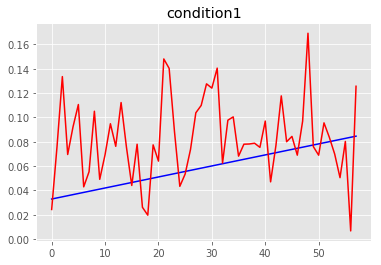

MSE condition1: 0.001757607653439867
R2 condition1: -6.651124023647695


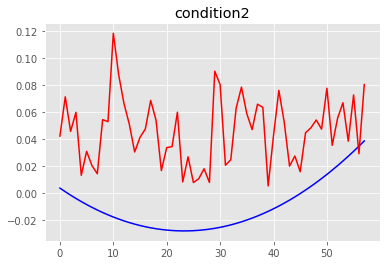

MSE condition2: 0.003938158219157238
R2 condition2: -11.267770052635944


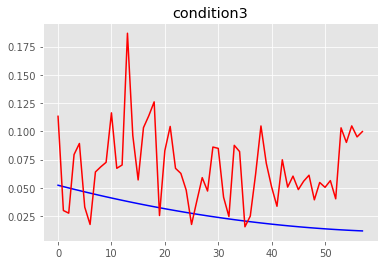

MSE condition3: 0.002768453420497169
R2 condition3: -17.96660767648869


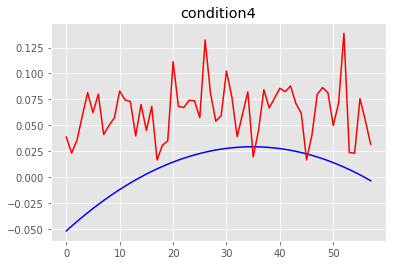

MSE condition4: 0.003929274276097806
R2 condition4: -7.131141902562254
==== the test person number # 6 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43148416e-09 4.64050508e-09 3.99658294e-09 3.97408342e-09]
Global min values from training is:  [-4.41807066e-09 -4.65

n_neighbors: 30 weights_type:uniform All_MSE: 0.011539281476299469 All_R2: 0.15137486847586978
n_neighbors: 30 weights_type:distance All_MSE: 0.011294042147614352 All_R2: 0.16941032917485233
n_neighbors: 31 weights_type:uniform All_MSE: 0.011649188744609856 All_R2: 0.14329203678336555
n_neighbors: 31 weights_type:distance All_MSE: 0.011386701269139696 All_R2: 0.16259596561566025
n_neighbors: 32 weights_type:uniform All_MSE: 0.011768915290367544 All_R2: 0.13448707298650953
n_neighbors: 32 weights_type:distance All_MSE: 0.011466114461570103 All_R2: 0.15675573795422215
n_neighbors: 33 weights_type:uniform All_MSE: 0.011775489187213046 All_R2: 0.13400361358857416
n_neighbors: 33 weights_type:distance All_MSE: 0.011474806132455287 All_R2: 0.15611653261346903
n_neighbors: 34 weights_type:uniform All_MSE: 0.011741112368971574 All_R2: 0.13653176336648432
n_neighbors: 34 weights_type:distance All_MSE: 0.011450946220279366 All_R2: 0.157871245084088
n_neighbors: 35 weights_type:uniform All_MSE: 0

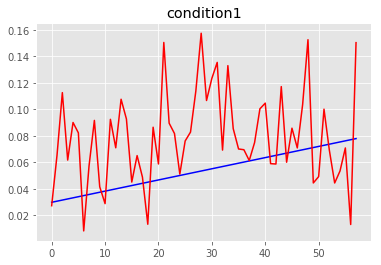

MSE condition1: 0.0018875390554706402
R2 condition1: -8.485392635352556


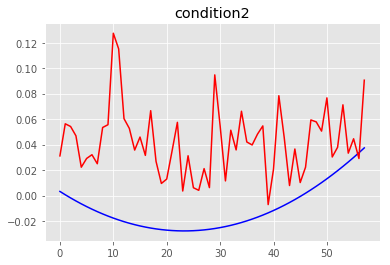

MSE condition2: 0.00360758543789173
R2 condition2: -10.767378932222606


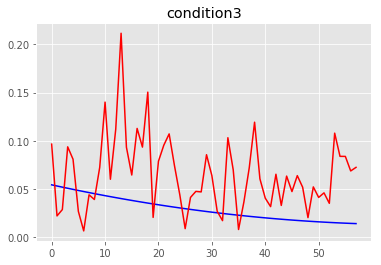

MSE condition3: 0.002739051155255144
R2 condition3: -17.979102640733753


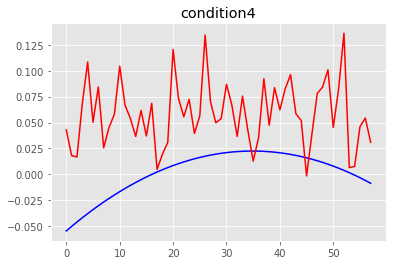

MSE condition4: 0.004339486661046137
R2 condition4: -8.984011262202667
==== the test person number # 6 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.01531542e-09 4.25113105e-09 3.74128381e-09 3.67485321e-09]
Global min values from training is:  [-4.01067749e-09 -4.26

n_neighbors: 38 weights_type:uniform All_MSE: 7.547897871449881 All_R2: -4.893169159944535
n_neighbors: 38 weights_type:distance All_MSE: 7.362952135765481 All_R2: -4.748769152901355
n_neighbors: 39 weights_type:uniform All_MSE: 7.574529889014012 All_R2: -4.913962629497123
n_neighbors: 39 weights_type:distance All_MSE: 7.3888409826661166 All_R2: -4.7689823773964095
n_neighbors: 40 weights_type:uniform All_MSE: 7.596948258791533 All_R2: -4.931466210976259
n_neighbors: 40 weights_type:distance All_MSE: 7.411444740303292 All_R2: -4.78663070407954
n_neighbors: 41 weights_type:uniform All_MSE: 7.614146859058905 All_R2: -4.9448943551319005
n_neighbors: 41 weights_type:distance All_MSE: 7.429266857754706 All_R2: -4.800545671494091
n_neighbors: 42 weights_type:uniform All_MSE: 7.6369900021909425 All_R2: -4.96272958673077
n_neighbors: 42 weights_type:distance All_MSE: 7.451791856749496 All_R2: -4.81813250582395
n_neighbors: 43 weights_type:uniform All_MSE: 7.660204300608504 All_R2: -4.980854605

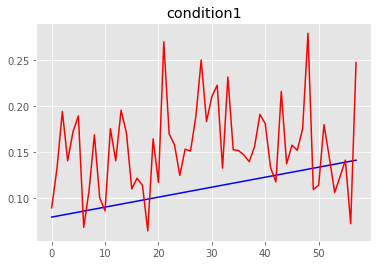

MSE condition1: 0.0043573264494885045
R2 condition1: -12.138825112705472


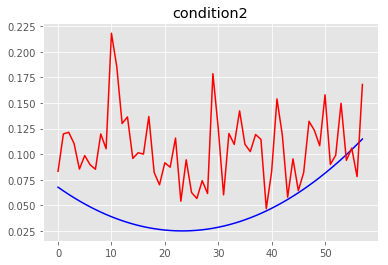

MSE condition2: 0.0047931790321832715
R2 condition2: -7.207344301634821


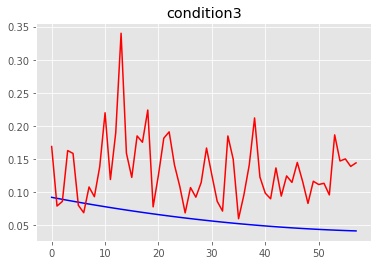

MSE condition3: 0.007620005069806125
R2 condition3: -32.199057308468745


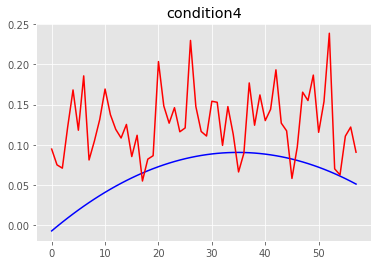

MSE condition4: 0.0056957407640340265
R2 condition4: -7.192003448871654
==== the test person number # 6 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37250926e-09 4.56210305e-09 3.95605939e-09 3.96373285e-09]
Global min values from training is:  [-4.36115189e-09 -4.5

n_neighbors: 27 weights_type:uniform All_MSE: 0.015518523758928059 All_R2: -0.12733056815550525
n_neighbors: 27 weights_type:distance All_MSE: 0.015150822557532757 All_R2: -0.10061921269929153
n_neighbors: 28 weights_type:uniform All_MSE: 0.015492427865978696 All_R2: -0.12543485318402126
n_neighbors: 28 weights_type:distance All_MSE: 0.015126452331818842 All_R2: -0.09884885742407779
n_neighbors: 29 weights_type:uniform All_MSE: 0.015623965625480053 All_R2: -0.13499030700528136
n_neighbors: 29 weights_type:distance All_MSE: 0.015236221548764948 All_R2: -0.10682295313241763
n_neighbors: 30 weights_type:uniform All_MSE: 0.015576149764906226 All_R2: -0.13151676260731482
n_neighbors: 30 weights_type:distance All_MSE: 0.015201524877001974 All_R2: -0.10430244156190471
n_neighbors: 31 weights_type:uniform All_MSE: 0.01544860411648363 All_R2: -0.12225131245653698
n_neighbors: 31 weights_type:distance All_MSE: 0.015112557746449125 All_R2: -0.0978394965426912
n_neighbors: 32 weights_type:uniform 

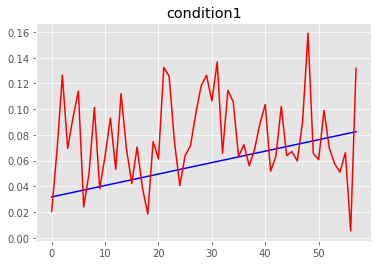

MSE condition1: 0.0016240953488831343
R2 condition1: -6.3039242992298155


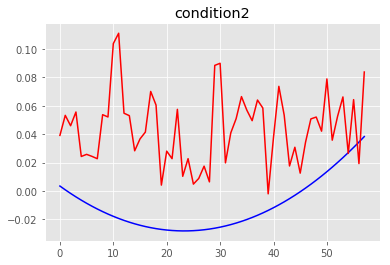

MSE condition2: 0.0037634193499218238
R2 condition2: -10.83019316227952


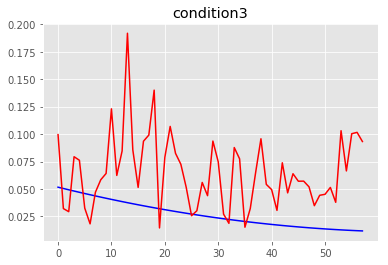

MSE condition3: 0.002612598825271328
R2 condition3: -17.450492508793726


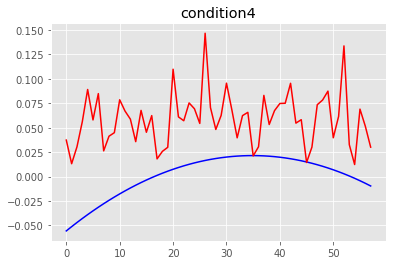

MSE condition4: 0.0042045814515787195
R2 condition4: -8.654145271875205
==== the test person number # 6 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.42686031e-09 4.65064915e-09 4.00278154e-09 4.03285487e-09]
Global min values from training is:  [-4.41711047e-09 -4.6

n_neighbors: 23 weights_type:uniform All_MSE: 0.0040584735066697955 All_R2: -0.5602083174350876
The best neighbors is: 23 The best weigths :uniform The best mse: 0.0040584735066697955
n_neighbors: 23 weights_type:distance All_MSE: 0.004052755659049035 All_R2: -0.5580101921051879
The best neighbors is: 23 The best weigths :distance The best mse: 0.004052755659049035
n_neighbors: 24 weights_type:uniform All_MSE: 0.004033667466639007 All_R2: -0.550672074334065
The best neighbors is: 24 The best weigths :uniform The best mse: 0.004033667466639007
n_neighbors: 24 weights_type:distance All_MSE: 0.004027099124463211 All_R2: -0.5481469914235575
The best neighbors is: 24 The best weigths :distance The best mse: 0.004027099124463211
n_neighbors: 25 weights_type:uniform All_MSE: 0.004116202325232077 All_R2: -0.5824011401130109
n_neighbors: 25 weights_type:distance All_MSE: 0.0040953116518506315 All_R2: -0.5743700904306648
n_neighbors: 26 weights_type:uniform All_MSE: 0.004105380717349876 All_R2: 

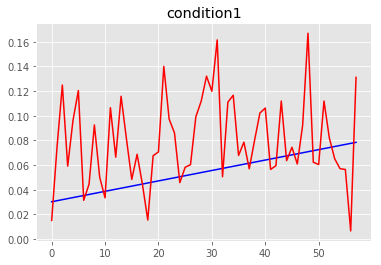

MSE condition1: 0.0019388435451206973
R2 condition1: -8.684622913897597


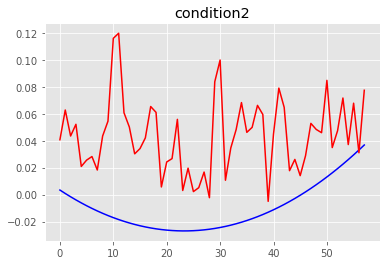

MSE condition2: 0.003774783106261406
R2 condition2: -11.879195567762382


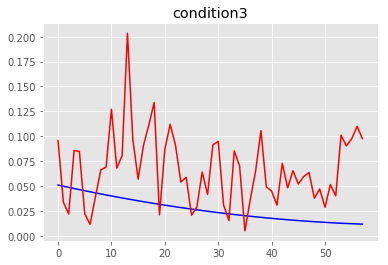

MSE condition3: 0.0029483374317779316
R2 condition3: -20.391808148202298


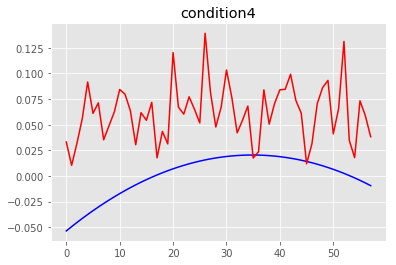

MSE condition4: 0.004579813950757949
R2 condition4: -10.424847906361524
==== the test person number # 6 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.17137586e-09 4.41228446e-09 3.67217169e-09 3.82183914e-09]
Global min values from training is:  [-4.15505737e-09 -4.4

n_neighbors: 23 weights_type:distance All_MSE: 0.24811701427095845 All_R2: 0.5166651414022841
The best neighbors is: 23 The best weigths :distance The best mse: 0.24811701427095845
n_neighbors: 24 weights_type:uniform All_MSE: 0.25035011634930526 All_R2: 0.5123150323199085
n_neighbors: 24 weights_type:distance All_MSE: 0.24734948116628613 All_R2: 0.5181603049069148
The best neighbors is: 24 The best weigths :distance The best mse: 0.24734948116628613
n_neighbors: 25 weights_type:uniform All_MSE: 0.25613169262613167 All_R2: 0.5010524538125753
n_neighbors: 25 weights_type:distance All_MSE: 0.2518016806815596 All_R2: 0.509487367948172
n_neighbors: 26 weights_type:uniform All_MSE: 0.25841939682258175 All_R2: 0.4965959791626866
n_neighbors: 26 weights_type:distance All_MSE: 0.25310102155964403 All_R2: 0.50695623665343
n_neighbors: 27 weights_type:uniform All_MSE: 0.2609816624464867 All_R2: 0.49160465562665756
n_neighbors: 27 weights_type:distance All_MSE: 0.2549229469231707 All_R2: 0.503407

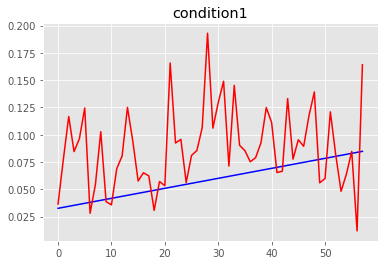

MSE condition1: 0.00226651535024762
R2 condition1: -8.634658486697441


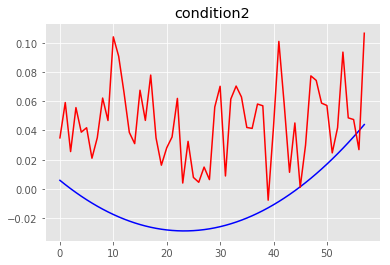

MSE condition2: 0.0038756175896690693
R2 condition2: -9.115791869984248


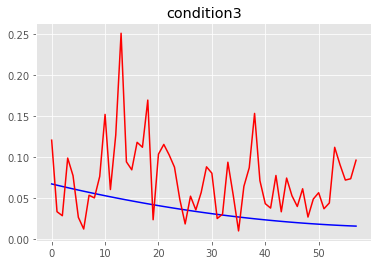

MSE condition3: 0.00325880215935832
R2 condition3: -12.869294935804778


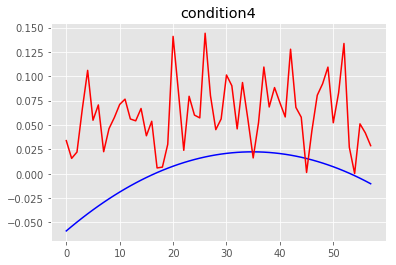

MSE condition4: 0.004910904069638768
R2 condition4: -9.190564557367608
==== the test person number # 6 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.47393418e-09 4.70678206e-09 4.08791363e-09 4.08822333e-09]
Global min values from training is:  [-4.46327341e-09 -4.71

n_neighbors: 24 weights_type:uniform All_MSE: 0.002724472992677759 All_R2: 0.05399015764033466
n_neighbors: 24 weights_type:distance All_MSE: 0.0026577331630601784 All_R2: 0.07716401029562703
n_neighbors: 25 weights_type:uniform All_MSE: 0.002723933107603843 All_R2: 0.0541776201679649
n_neighbors: 25 weights_type:distance All_MSE: 0.002653172735472829 All_R2: 0.07874751264437352
n_neighbors: 26 weights_type:uniform All_MSE: 0.0026878044857582737 All_R2: 0.06672244331308508
n_neighbors: 26 weights_type:distance All_MSE: 0.0026245355167940003 All_R2: 0.08869112038091087
The best neighbors is: 26 The best weigths :distance The best mse: 0.0026245355167940003
n_neighbors: 27 weights_type:uniform All_MSE: 0.00265120029598157 All_R2: 0.07943239635480293
n_neighbors: 27 weights_type:distance All_MSE: 0.002592773002481837 All_R2: 0.09971991429377103
The best neighbors is: 27 The best weigths :distance The best mse: 0.002592773002481837
n_neighbors: 28 weights_type:uniform All_MSE: 0.0026348416

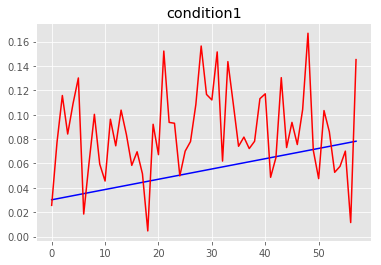

MSE condition1: 0.002345815550106595
R2 condition1: -10.772866172654036


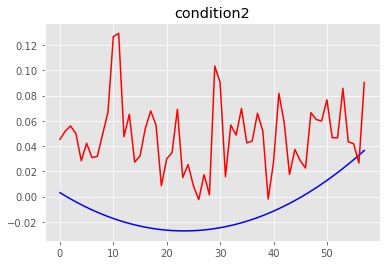

MSE condition2: 0.004277647544001144
R2 condition2: -13.562831645058969


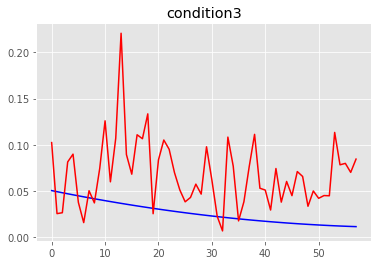

MSE condition3: 0.003045129211543034
R2 condition3: -21.426516376275337


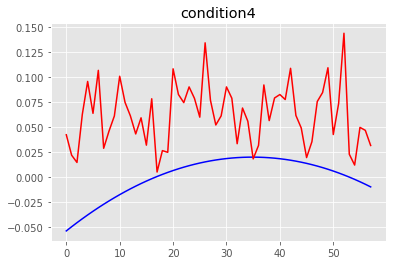

MSE condition4: 0.004885840803395569
R2 condition4: -11.29120258619731
==== the test person number # 7 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.89944670e-09 3.76837666e-09 3.49352219e-09 3.42696105e-09]
Global min values from training is:  [-3.89340149e-09 -3.78

n_neighbors: 24 weights_type:distance All_MSE: 0.12434006764701387 All_R2: -0.9455239683627688
n_neighbors: 25 weights_type:uniform All_MSE: 0.12181054650752263 All_R2: -0.9059450611087425
The best neighbors is: 25 The best weigths :uniform The best mse: 0.12181054650752263
n_neighbors: 25 weights_type:distance All_MSE: 0.12360115074708726 All_R2: -0.9339622846139979
n_neighbors: 26 weights_type:uniform All_MSE: 0.12365477032977977 All_R2: -0.9348012594133204
n_neighbors: 26 weights_type:distance All_MSE: 0.12510433520059153 All_R2: -0.957482308677883
n_neighbors: 27 weights_type:uniform All_MSE: 0.12045414997051197 All_R2: -0.8847217979780677
The best neighbors is: 27 The best weigths :uniform The best mse: 0.12045414997051197
n_neighbors: 27 weights_type:distance All_MSE: 0.12239397689555773 All_R2: -0.9150738787559696
n_neighbors: 28 weights_type:uniform All_MSE: 0.12100066386116295 All_R2: -0.8932729906340273
n_neighbors: 28 weights_type:distance All_MSE: 0.12278105834500609 All_R2

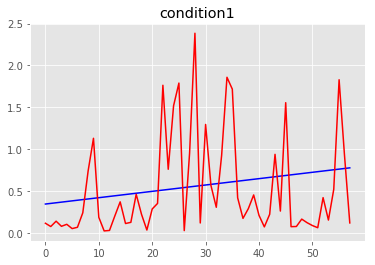

MSE condition1: 0.3520211455421006
R2 condition1: -20.829228063053943


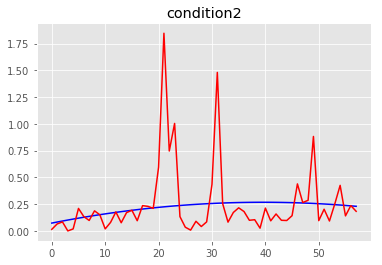

MSE condition2: 0.10780278087866832
R2 condition2: -33.87235840734804


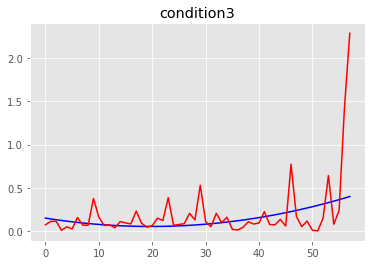

MSE condition3: 0.10336095696130153
R2 condition3: -10.200427322773345


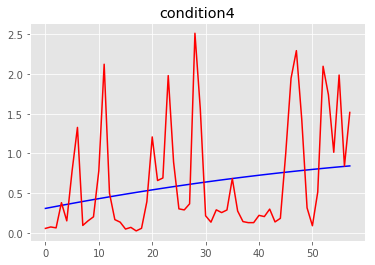

MSE condition4: 0.4407604906771344
R2 condition4: -16.659446214706755
==== the test person number # 7 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.95488074e-09 4.23960131e-09 3.65518125e-09 3.64205073e-09]
Global min values from training is:  [-3.94572564e-09 -4.249

n_neighbors: 28 weights_type:uniform All_MSE: 0.01636588785268854 All_R2: -0.5302733416484631
The best neighbors is: 28 The best weigths :uniform The best mse: 0.01636588785268854
n_neighbors: 28 weights_type:distance All_MSE: 0.016380688861463717 All_R2: -0.5316572927889105
n_neighbors: 29 weights_type:uniform All_MSE: 0.016176350133667087 All_R2: -0.512550837298799
The best neighbors is: 29 The best weigths :uniform The best mse: 0.016176350133667087
n_neighbors: 29 weights_type:distance All_MSE: 0.0162186976660714 All_R2: -0.5165104941476188
n_neighbors: 30 weights_type:uniform All_MSE: 0.01601207524415841 All_R2: -0.4971905044906968
The best neighbors is: 30 The best weigths :uniform The best mse: 0.01601207524415841
n_neighbors: 30 weights_type:distance All_MSE: 0.01607347082947276 All_R2: -0.5029312274106588
n_neighbors: 31 weights_type:uniform All_MSE: 0.016178025370357164 All_R2: -0.51270747836043
n_neighbors: 31 weights_type:distance All_MSE: 0.01618319568479484 All_R2: -0.513

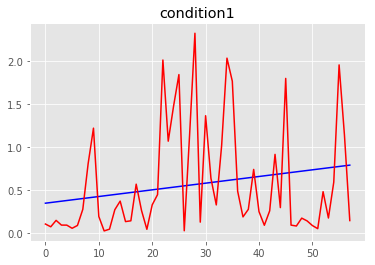

MSE condition1: 0.3920240494154004
R2 condition1: -22.13133990718461


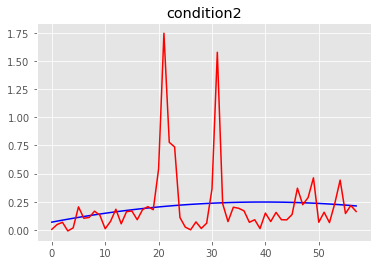

MSE condition2: 0.09653959507865298
R2 condition2: -36.16382947398481


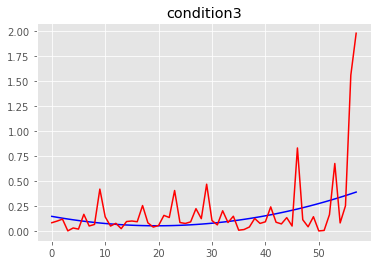

MSE condition3: 0.09268130211797485
R2 condition3: -9.592065202436686


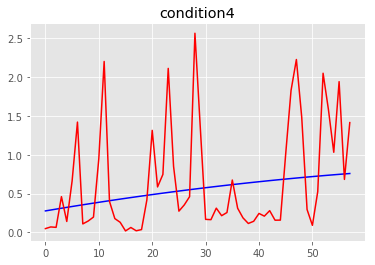

MSE condition4: 0.44983606321539443
R2 condition4: -21.290889740908067
==== the test person number # 7 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.00814426e-09 4.28300560e-09 3.71486941e-09 3.60225353e-09]
Global min values from training is:  [-4.00119784e-09 -4.29

n_neighbors: 27 weights_type:distance All_MSE: 0.004659037900095623 All_R2: -0.13415358812913736
The best neighbors is: 27 The best weigths :distance The best mse: 0.004659037900095623
n_neighbors: 28 weights_type:uniform All_MSE: 0.004628506286306991 All_R2: -0.12672125122347722
The best neighbors is: 28 The best weigths :uniform The best mse: 0.004628506286306991
n_neighbors: 28 weights_type:distance All_MSE: 0.004611956930304314 All_R2: -0.12269262731138642
The best neighbors is: 28 The best weigths :distance The best mse: 0.004611956930304314
n_neighbors: 29 weights_type:uniform All_MSE: 0.004590887864779055 All_R2: -0.11756376663748869
The best neighbors is: 29 The best weigths :uniform The best mse: 0.004590887864779055
n_neighbors: 29 weights_type:distance All_MSE: 0.004578613628080308 All_R2: -0.11457583868070054
The best neighbors is: 29 The best weigths :distance The best mse: 0.004578613628080308
n_neighbors: 30 weights_type:uniform All_MSE: 0.004594321084884962 All_R2: -0.1

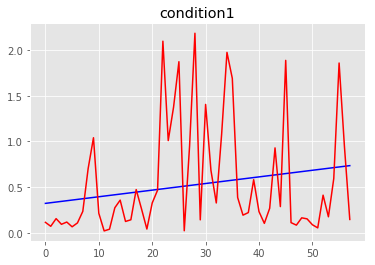

MSE condition1: 0.3704990543577933
R2 condition1: -24.193109102413374


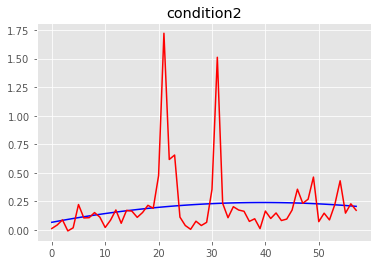

MSE condition2: 0.08698483397164541
R2 condition2: -34.33346797940307


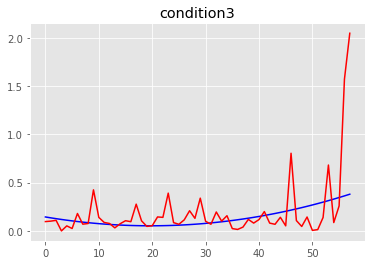

MSE condition3: 0.09579708126863523
R2 condition3: -10.596247084312957


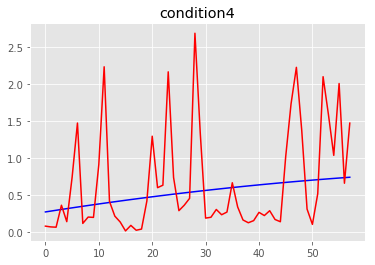

MSE condition4: 0.4643683431862147
R2 condition4: -23.205038552909283
==== the test person number # 7 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.99611108e-09 4.24427876e-09 3.70775600e-09 3.59953469e-09]
Global min values from training is:  [-3.99043149e-09 -4.254

n_neighbors: 25 weights_type:uniform All_MSE: 0.0091877791324373 All_R2: 0.31383507942002686
n_neighbors: 25 weights_type:distance All_MSE: 0.00912478167926707 All_R2: 0.3185398771549529
n_neighbors: 26 weights_type:uniform All_MSE: 0.009071744520179049 All_R2: 0.32250081673881126
The best neighbors is: 26 The best weigths :uniform The best mse: 0.009071744520179049
n_neighbors: 26 weights_type:distance All_MSE: 0.009027603704126955 All_R2: 0.32579735653413455
The best neighbors is: 26 The best weigths :distance The best mse: 0.009027603704126955
n_neighbors: 27 weights_type:uniform All_MSE: 0.009239344365160591 All_R2: 0.3099840667535002
n_neighbors: 27 weights_type:distance All_MSE: 0.009157170518944826 All_R2: 0.31612100255154596
n_neighbors: 28 weights_type:uniform All_MSE: 0.009217167886321882 All_R2: 0.3116402582685295
n_neighbors: 28 weights_type:distance All_MSE: 0.009137608322030612 All_R2: 0.31758195335353256
n_neighbors: 29 weights_type:uniform All_MSE: 0.009209362395184436 

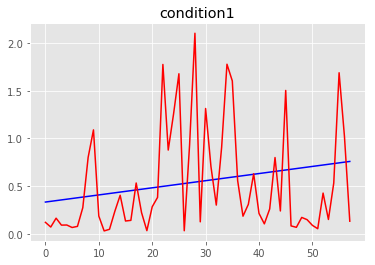

MSE condition1: 0.30414566057130693
R2 condition1: -18.444905901434076


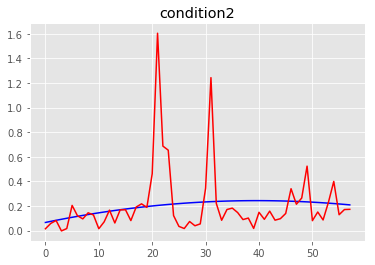

MSE condition2: 0.07152107871932928
R2 condition2: -26.839594295967625


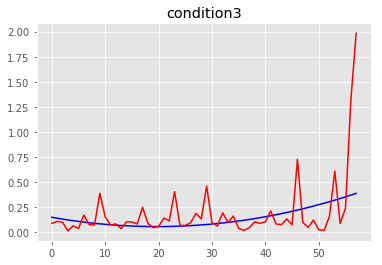

MSE condition3: 0.08035128824416575
R2 condition3: -8.448026262096887


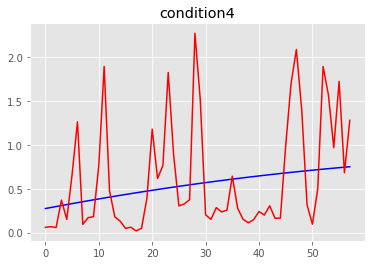

MSE condition4: 0.36138921171536603
R2 condition4: -17.271346556567053
==== the test person number # 7 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.08232390e-09 4.36509463e-09 3.69363077e-09 3.68381547e-09]
Global min values from training is:  [-4.07424601e-09 -4.37

n_neighbors: 29 weights_type:uniform All_MSE: 0.003553422968680538 All_R2: -3.5808742306418253
n_neighbors: 29 weights_type:distance All_MSE: 0.003508860702218749 All_R2: -3.5234270480539323
n_neighbors: 30 weights_type:uniform All_MSE: 0.003565437583077096 All_R2: -3.596362799822974
n_neighbors: 30 weights_type:distance All_MSE: 0.003517163932062849 All_R2: -3.5341311077617634
n_neighbors: 31 weights_type:uniform All_MSE: 0.0036129686276734846 All_R2: -3.6576371652070456
n_neighbors: 31 weights_type:distance All_MSE: 0.0035572271569328335 All_R2: -3.5857783774566148
n_neighbors: 32 weights_type:uniform All_MSE: 0.00361752136054026 All_R2: -3.663506293890072
n_neighbors: 32 weights_type:distance All_MSE: 0.0035614190141631005 All_R2: -3.5911822854444635
n_neighbors: 33 weights_type:uniform All_MSE: 0.0036135449978762883 All_R2: -3.658380189449475
n_neighbors: 33 weights_type:distance All_MSE: 0.0035587411044800867 All_R2: -3.587730073994539
n_neighbors: 34 weights_type:uniform All_MSE:

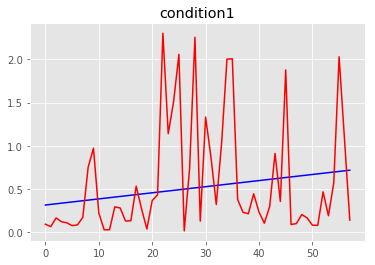

MSE condition1: 0.42155895321232617
R2 condition1: -29.122424947609357


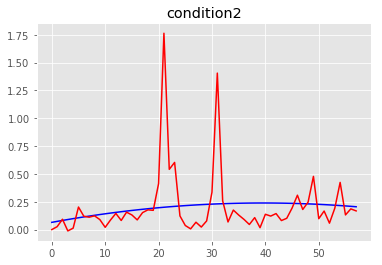

MSE condition2: 0.08295229569240097
R2 condition2: -32.579514690302155


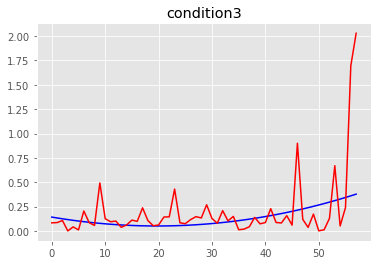

MSE condition3: 0.10337566153525705
R2 condition3: -11.54639201265781


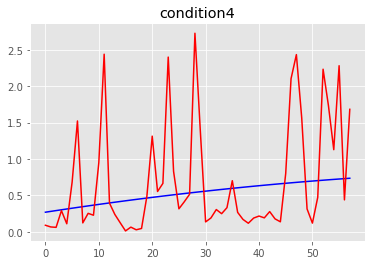

MSE condition4: 0.567075920551686
R2 condition4: -28.871812827420175
==== the test person number # 7 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06282612e-09 4.08597195e-09 3.68669226e-09 3.63901231e-09]
Global min values from training is:  [-4.05569747e-09 -4.0794

n_neighbors: 29 weights_type:distance All_MSE: 0.006563905347570107 All_R2: -4.088494903007783
n_neighbors: 30 weights_type:uniform All_MSE: 0.00661454050216787 All_R2: -4.127748474234112
n_neighbors: 30 weights_type:distance All_MSE: 0.006703085024104608 All_R2: -4.196390284971244
n_neighbors: 31 weights_type:uniform All_MSE: 0.0065255945053386355 All_R2: -4.058795430650683
n_neighbors: 31 weights_type:distance All_MSE: 0.006626588772633556 All_R2: -4.137088578883458
n_neighbors: 32 weights_type:uniform All_MSE: 0.006382686044277599 All_R2: -3.948009406599473
The best neighbors is: 32 The best weigths :uniform The best mse: 0.006382686044277599
n_neighbors: 32 weights_type:distance All_MSE: 0.006492813656924292 All_R2: -4.033382940488191
n_neighbors: 33 weights_type:uniform All_MSE: 0.006266042137562203 All_R2: -3.8575842871988817
The best neighbors is: 33 The best weigths :uniform The best mse: 0.006266042137562203
n_neighbors: 33 weights_type:distance All_MSE: 0.006380450723770024 A

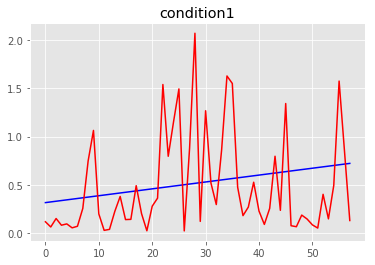

MSE condition1: 0.2620197896577593
R2 condition1: -17.436102551818806


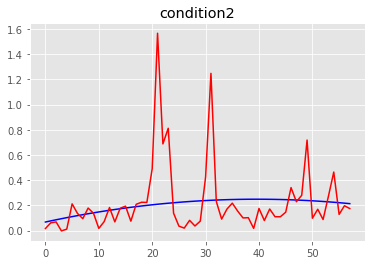

MSE condition2: 0.07566910582243226
R2 condition2: -27.270277949125095


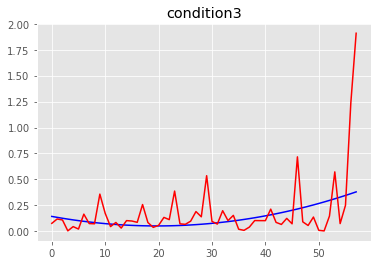

MSE condition3: 0.07491976302839448
R2 condition3: -8.010242472664888


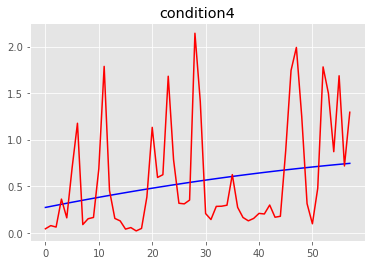

MSE condition4: 0.31778979185932205
R2 condition4: -15.283868787660666
==== the test person number # 7 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 8, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06344281e-09 4.35254662e-09 3.70835337e-09 3.65818744e-09]
Global min values from training is:  [-4.05603759e-09 -4.36

n_neighbors: 27 weights_type:distance All_MSE: 0.003480643805417781 All_R2: -2.2275367161417785
n_neighbors: 28 weights_type:uniform All_MSE: 0.003460944864448426 All_R2: -2.2092702520040985
The best neighbors is: 28 The best weigths :uniform The best mse: 0.003460944864448426
n_neighbors: 28 weights_type:distance All_MSE: 0.003473505951315206 All_R2: -2.2209179158627426
n_neighbors: 29 weights_type:uniform All_MSE: 0.00349236195467713 All_R2: -2.2384027395254154
n_neighbors: 29 weights_type:distance All_MSE: 0.00349470554353544 All_R2: -2.2405759061895716
n_neighbors: 30 weights_type:uniform All_MSE: 0.0034604328770024037 All_R2: -2.2087954955013878
The best neighbors is: 30 The best weigths :uniform The best mse: 0.0034604328770024037
n_neighbors: 30 weights_type:distance All_MSE: 0.0034643047619312617 All_R2: -2.2123858228853948
n_neighbors: 31 weights_type:uniform All_MSE: 0.0034405956867138167 All_R2: -2.1904008353233353
The best neighbors is: 31 The best weigths :uniform The best

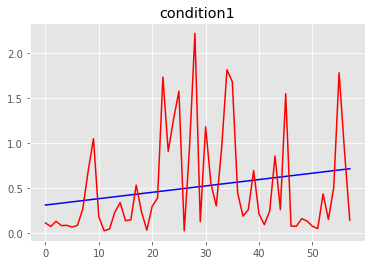

MSE condition1: 0.31005754741316705
R2 condition1: -21.05662300398024


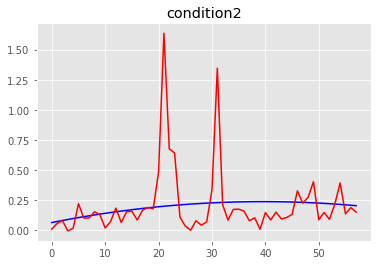

MSE condition2: 0.07569712113163587
R2 condition2: -29.81907889794847


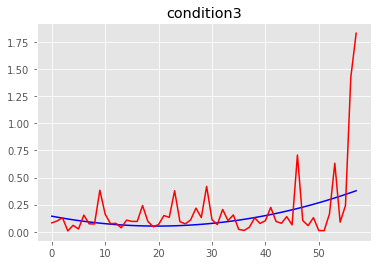

MSE condition3: 0.0762982439772871
R2 condition3: -8.2743747713714


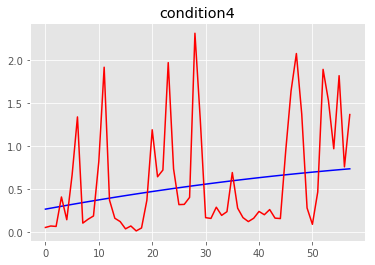

MSE condition4: 0.37113272995944924
R2 condition4: -18.42530395015945
==== the test person number # 7 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.03869512e-09 4.32638346e-09 3.69001653e-09 3.54649236e-09]
Global min values from training is:  [-4.02994098e-09 -4.335

n_neighbors: 31 weights_type:uniform All_MSE: 0.005042284548639688 All_R2: -2.186654962180142
n_neighbors: 31 weights_type:distance All_MSE: 0.005016848437938328 All_R2: -2.1705796876486962
n_neighbors: 32 weights_type:uniform All_MSE: 0.004949319189005079 All_R2: -2.1279021247048333
The best neighbors is: 32 The best weigths :uniform The best mse: 0.004949319189005079
n_neighbors: 32 weights_type:distance All_MSE: 0.004939358247868472 All_R2: -2.121606945962984
The best neighbors is: 32 The best weigths :distance The best mse: 0.004939358247868472
n_neighbors: 33 weights_type:uniform All_MSE: 0.0051552366122981155 All_R2: -2.2580391236001316
n_neighbors: 33 weights_type:distance All_MSE: 0.005115208216110409 All_R2: -2.232741723957329
n_neighbors: 34 weights_type:uniform All_MSE: 0.0052857319019963215 All_R2: -2.340510364254353
n_neighbors: 34 weights_type:distance All_MSE: 0.005217394129231277 All_R2: -2.2973218252924217
n_neighbors: 35 weights_type:uniform All_MSE: 0.005201851015140

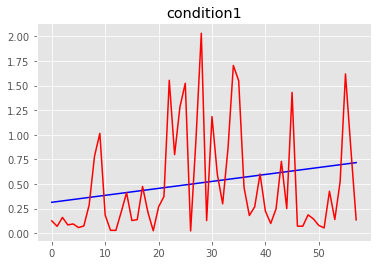

MSE condition1: 0.26909593722408076
R2 condition1: -18.204223757088627


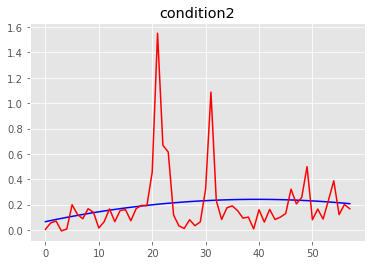

MSE condition2: 0.0628421508832088
R2 condition2: -23.91057181505425


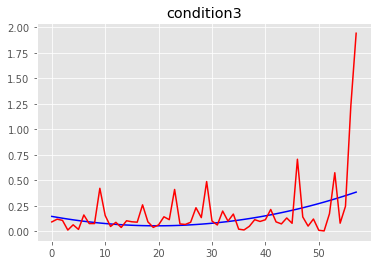

MSE condition3: 0.0760084442699314
R2 condition3: -8.008047844935325


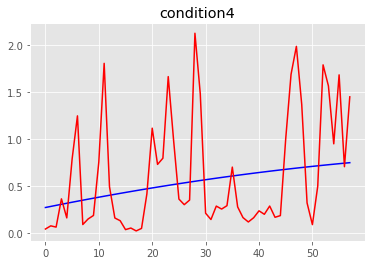

MSE condition4: 0.3341971460362575
R2 condition4: -15.877520969523157
==== the test person number # 7 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.87111213e-09 4.23543943e-09 3.60356024e-09 3.48788351e-09]
Global min values from training is:  [-3.86636514e-09 -4.244

n_neighbors: 29 weights_type:uniform All_MSE: 0.09522886871870474 All_R2: -0.5255059013655501
n_neighbors: 29 weights_type:distance All_MSE: 0.09405322316272753 All_R2: -0.5066728073921765
n_neighbors: 30 weights_type:uniform All_MSE: 0.09410055263885295 All_R2: -0.5074309954932148
n_neighbors: 30 weights_type:distance All_MSE: 0.09311796457062198 All_R2: -0.49169055966880726
n_neighbors: 31 weights_type:uniform All_MSE: 0.09488828822107505 All_R2: -0.5200500184382957
n_neighbors: 31 weights_type:distance All_MSE: 0.09377398994714643 All_R2: -0.502199668900061
n_neighbors: 32 weights_type:uniform All_MSE: 0.09615912506150465 All_R2: -0.540408016236996
n_neighbors: 32 weights_type:distance All_MSE: 0.09476153591780045 All_R2: -0.5180195271675423
n_neighbors: 33 weights_type:uniform All_MSE: 0.09536829746199557 All_R2: -0.5277394611418236
n_neighbors: 33 weights_type:distance All_MSE: 0.09416530656822748 All_R2: -0.5084683122515314
n_neighbors: 34 weights_type:uniform All_MSE: 0.09549230

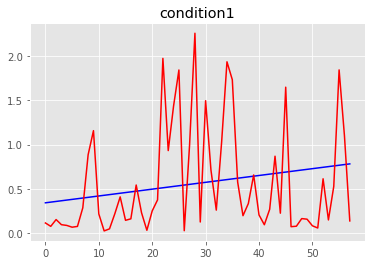

MSE condition1: 0.36725772433485915
R2 condition1: -21.082649040610253


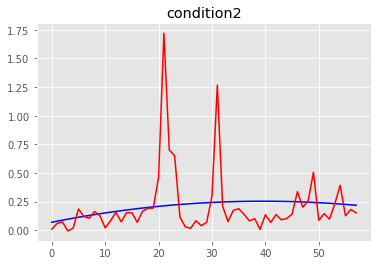

MSE condition2: 0.07822602154113584
R2 condition2: -27.408203079426904


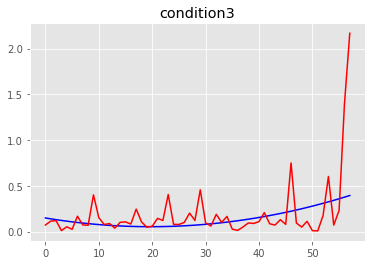

MSE condition3: 0.09400301224002675
R2 condition3: -9.484021814118655


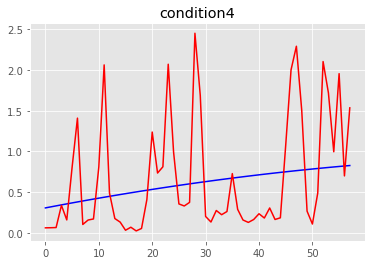

MSE condition4: 0.4528296525998142
R2 condition4: -18.226821553178926
==== the test person number # 7 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.02702681e-09 4.28997113e-09 3.64075142e-09 3.58800997e-09]
Global min values from training is:  [-4.01720638e-09 -4.298

n_neighbors: 30 weights_type:distance All_MSE: 0.015228756684013764 All_R2: 0.11480983275743883
n_neighbors: 31 weights_type:uniform All_MSE: 0.015675355085988482 All_R2: 0.08885075268695286
n_neighbors: 31 weights_type:distance All_MSE: 0.0152723513118824 All_R2: 0.11227584152397041
n_neighbors: 32 weights_type:uniform All_MSE: 0.015671731640427698 All_R2: 0.08906136990597457
n_neighbors: 32 weights_type:distance All_MSE: 0.015274219065765005 All_R2: 0.11216727603789578
n_neighbors: 33 weights_type:uniform All_MSE: 0.01576218417162415 All_R2: 0.08380370554908378
n_neighbors: 33 weights_type:distance All_MSE: 0.015343083478674868 All_R2: 0.10816444754404175
n_neighbors: 34 weights_type:uniform All_MSE: 0.015607506799093755 All_R2: 0.09279451760943735
n_neighbors: 34 weights_type:distance All_MSE: 0.015222202402257677 All_R2: 0.11519080842631368
n_neighbors: 35 weights_type:uniform All_MSE: 0.015644127387271792 All_R2: 0.09066590098981109
n_neighbors: 35 weights_type:distance All_MSE: 0

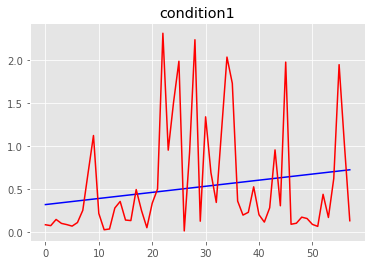

MSE condition1: 0.4109868353072413
R2 condition1: -28.086325092992798


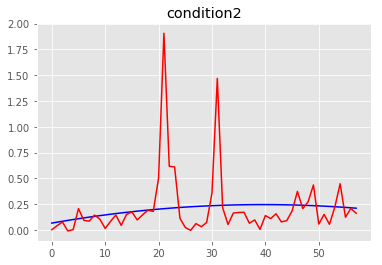

MSE condition2: 0.09580211827344168
R2 condition2: -35.55930170536606


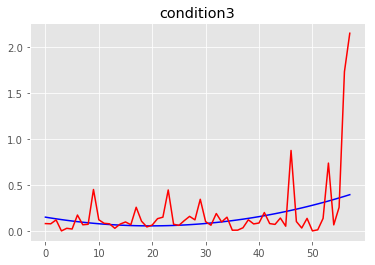

MSE condition3: 0.11093765305504501
R2 condition3: -11.52976033174355


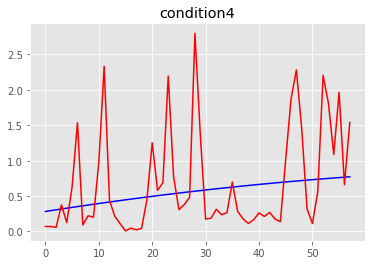

MSE condition4: 0.500793324464629
R2 condition4: -23.01755274371647
==== the test person number # 7 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.61085806e-09 3.90059710e-09 3.38545229e-09 3.28877976e-09]
Global min values from training is:  [-3.60981321e-09 -3.91431

n_neighbors: 38 weights_type:uniform All_MSE: 9.85120331133838 All_R2: -5.215037997216379
n_neighbors: 38 weights_type:distance All_MSE: 9.581658843944693 All_R2: -5.044984750537052
n_neighbors: 39 weights_type:uniform All_MSE: 9.894690633514589 All_R2: -5.242473768378593
n_neighbors: 39 weights_type:distance All_MSE: 9.623369959395832 All_R2: -5.071299928413519
n_neighbors: 40 weights_type:uniform All_MSE: 9.92446368796253 All_R2: -5.261257327994521
n_neighbors: 40 weights_type:distance All_MSE: 9.65373696409185 All_R2: -5.090458206045469
n_neighbors: 41 weights_type:uniform All_MSE: 9.95946509450033 All_R2: -5.283339409209722
n_neighbors: 41 weights_type:distance All_MSE: 9.688161570069393 All_R2: -5.1121763888326806
n_neighbors: 42 weights_type:uniform All_MSE: 9.995264902990684 All_R2: -5.305925195232891
n_neighbors: 42 weights_type:distance All_MSE: 9.723299666958363 All_R2: -5.134344706794758
n_neighbors: 43 weights_type:uniform All_MSE: 10.029169928063899 All_R2: -5.327315578972

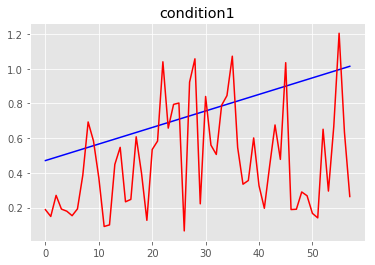

MSE condition1: 0.1623062118328219
R2 condition1: -5.382119183706893


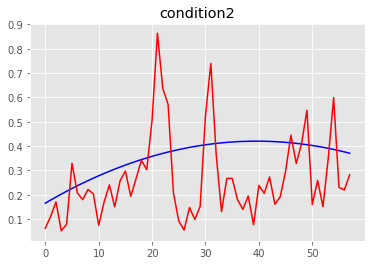

MSE condition2: 0.03561026977661805
R2 condition2: -5.727033158765904


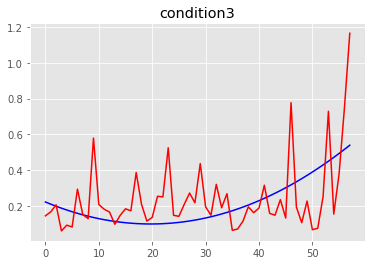

MSE condition3: 0.03577382233202194
R2 condition3: -1.3937384197990577


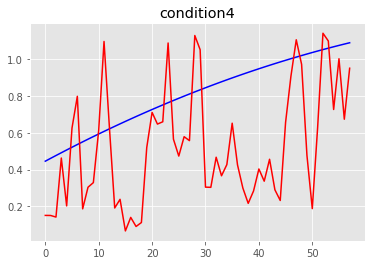

MSE condition4: 0.1672842419293018
R2 condition4: -3.6382046358542484
==== the test person number # 7 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.96805190e-09 4.21156910e-09 3.60022786e-09 3.57765940e-09]
Global min values from training is:  [-3.96028761e-09 -4.222

n_neighbors: 27 weights_type:uniform All_MSE: 0.020547984144450186 All_R2: -0.1474193578369889
n_neighbors: 27 weights_type:distance All_MSE: 0.0201192732761865 All_R2: -0.12347972727747636
n_neighbors: 28 weights_type:uniform All_MSE: 0.02092141528576037 All_R2: -0.16827211484450233
n_neighbors: 28 weights_type:distance All_MSE: 0.02043052576515363 All_R2: -0.1408603680500793
n_neighbors: 29 weights_type:uniform All_MSE: 0.021354771825523526 All_R2: -0.19247116420496257
n_neighbors: 29 weights_type:distance All_MSE: 0.020747620417928 All_R2: -0.15856724091420782
n_neighbors: 30 weights_type:uniform All_MSE: 0.021076947846059933 All_R2: -0.1769572038151337
n_neighbors: 30 weights_type:distance All_MSE: 0.02053457823863821 All_R2: -0.14667075905815663
n_neighbors: 31 weights_type:uniform All_MSE: 0.021273194170594728 All_R2: -0.18791578885649884
n_neighbors: 31 weights_type:distance All_MSE: 0.020695337053771426 All_R2: -0.15564768716604638
n_neighbors: 32 weights_type:uniform All_MSE: 

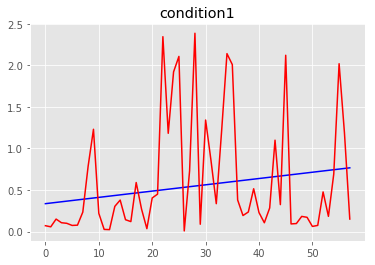

MSE condition1: 0.48247902288628747
R2 condition1: -29.10726983439543


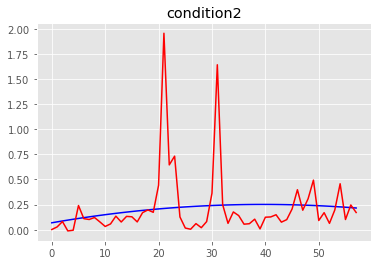

MSE condition2: 0.1096173372843464
R2 condition2: -39.1989534080869


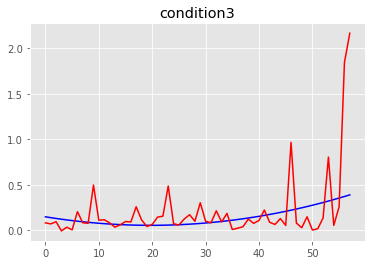

MSE condition3: 0.12308164148546806
R2 condition3: -13.19839843140257


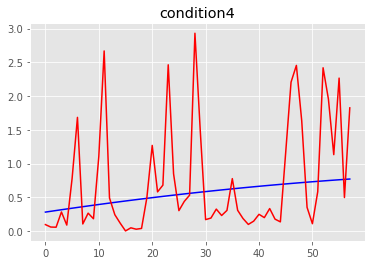

MSE condition4: 0.6407894008408079
R2 condition4: -29.660770105242513
==== the test person number # 7 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.02240295e-09 4.30011519e-09 3.64695002e-09 3.64678142e-09]
Global min values from training is:  [-4.01624620e-09 -4.312

n_neighbors: 28 weights_type:distance All_MSE: 0.004231786488382527 All_R2: -0.31943050725759914
n_neighbors: 29 weights_type:uniform All_MSE: 0.004229427563994985 All_R2: -0.3186950172205234
n_neighbors: 29 weights_type:distance All_MSE: 0.004229624500101177 All_R2: -0.3187564200127493
n_neighbors: 30 weights_type:uniform All_MSE: 0.004180420805715731 All_R2: -0.3034151792341411
The best neighbors is: 30 The best weigths :uniform The best mse: 0.004180420805715731
n_neighbors: 30 weights_type:distance All_MSE: 0.004187868709955657 All_R2: -0.30573736446164945
n_neighbors: 31 weights_type:uniform All_MSE: 0.004137586874208983 All_R2: -0.2900599695299326
The best neighbors is: 31 The best weigths :uniform The best mse: 0.004137586874208983
n_neighbors: 31 weights_type:distance All_MSE: 0.004148199999900471 All_R2: -0.29336904049869506
n_neighbors: 32 weights_type:uniform All_MSE: 0.004101251204804517 All_R2: -0.27873085572764245
The best neighbors is: 32 The best weigths :uniform The be

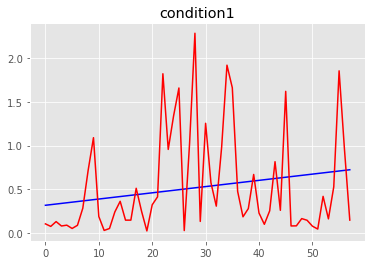

MSE condition1: 0.33530345798320754
R2 condition1: -22.568898367091332


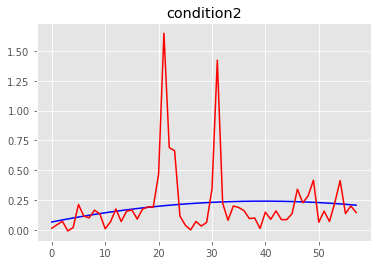

MSE condition2: 0.08032575548618053
R2 condition2: -31.17208795321578


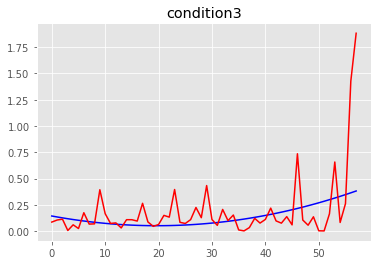

MSE condition3: 0.080150010992081
R2 condition3: -8.527497923265562


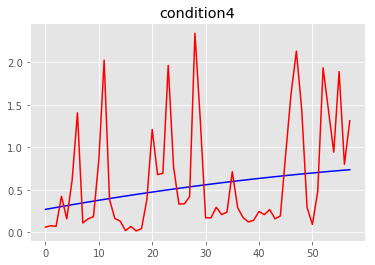

MSE condition4: 0.38622784431717416
R2 condition4: -19.315169677066216
==== the test person number # 7 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.76691850e-09 4.06175050e-09 3.31634017e-09 3.43576569e-09]
Global min values from training is:  [-3.75419309e-09 -4.07

n_neighbors: 26 weights_type:uniform All_MSE: 0.34706219932439514 All_R2: 0.48811704647643994
n_neighbors: 26 weights_type:distance All_MSE: 0.3398492722016518 All_R2: 0.4987554117214231
n_neighbors: 27 weights_type:uniform All_MSE: 0.34738178791741 All_R2: 0.4876456844173528
n_neighbors: 27 weights_type:distance All_MSE: 0.3399230381928922 All_R2: 0.4986466140663076
n_neighbors: 28 weights_type:uniform All_MSE: 0.345578351870836 All_R2: 0.49030557700089594
n_neighbors: 28 weights_type:distance All_MSE: 0.3388614972891845 All_R2: 0.5002122835461118
n_neighbors: 29 weights_type:uniform All_MSE: 0.3445604478040195 All_R2: 0.4918068863948316
n_neighbors: 29 weights_type:distance All_MSE: 0.3378767340045132 All_R2: 0.5016647135130181
n_neighbors: 30 weights_type:uniform All_MSE: 0.3446431852713253 All_R2: 0.4916848566859955
n_neighbors: 30 weights_type:distance All_MSE: 0.3377624279835088 All_R2: 0.5018333037649993
n_neighbors: 31 weights_type:uniform All_MSE: 0.34289133922310266 All_R2: 0

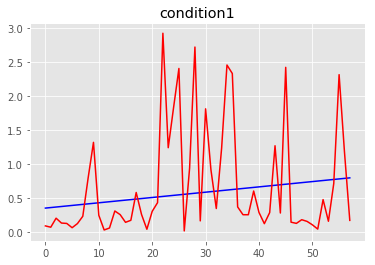

MSE condition1: 0.6456188179633272
R2 condition1: -36.78053504016655


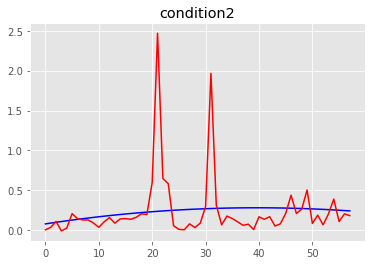

MSE condition2: 0.1598013325848346
R2 condition2: -46.92634876501399


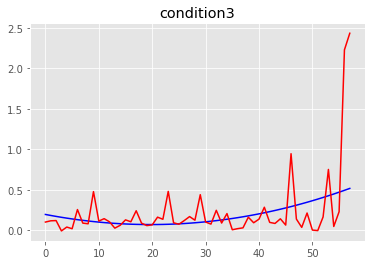

MSE condition3: 0.14919772439733503
R2 condition3: -8.718632859640449


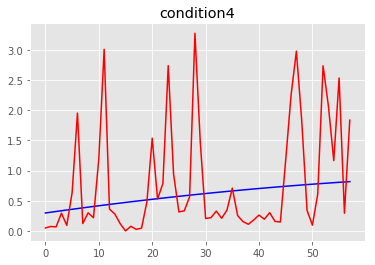

MSE condition4: 0.8146186854812808
R2 condition4: -33.698341492163564
==== the test person number # 7 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06947682e-09 4.35624811e-09 3.73208211e-09 3.70214988e-09]
Global min values from training is:  [-4.06240913e-09 -4.367

n_neighbors: 26 weights_type:uniform All_MSE: 0.0026444997062491215 All_R2: 0.2434997235093338
n_neighbors: 26 weights_type:distance All_MSE: 0.0025790055780164577 All_R2: 0.26223533765950524
The best neighbors is: 26 The best weigths :distance The best mse: 0.0025790055780164577
n_neighbors: 27 weights_type:uniform All_MSE: 0.002674174167665107 All_R2: 0.23501088223139488
n_neighbors: 27 weights_type:distance All_MSE: 0.002599209949979898 All_R2: 0.25645556277787274
n_neighbors: 28 weights_type:uniform All_MSE: 0.0026545036916155564 All_R2: 0.24063792788204252
n_neighbors: 28 weights_type:distance All_MSE: 0.002584628232479665 All_R2: 0.2606268898892232
n_neighbors: 29 weights_type:uniform All_MSE: 0.0026557852135282766 All_R2: 0.24027132860467804
n_neighbors: 29 weights_type:distance All_MSE: 0.0025844900241486974 All_R2: 0.260666426532144
n_neighbors: 30 weights_type:uniform All_MSE: 0.0026647484732336703 All_R2: 0.2377072487413432
n_neighbors: 30 weights_type:distance All_MSE: 0.00

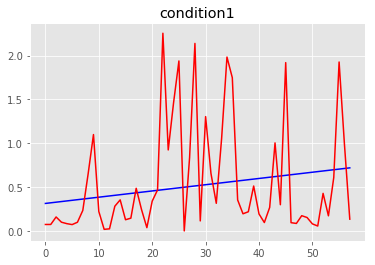

MSE condition1: 0.38807588837136753
R2 condition1: -26.424107580246087


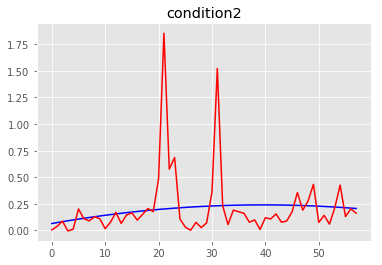

MSE condition2: 0.09500529486042335
R2 condition2: -36.96167065726525


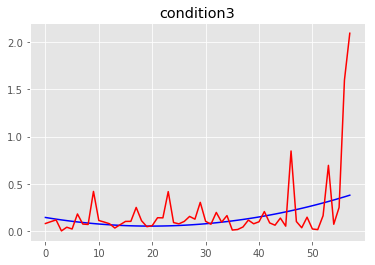

MSE condition3: 0.10049900726971081
R2 condition3: -11.145902543914707


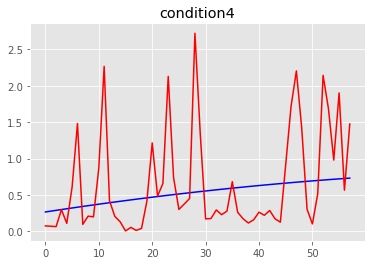

MSE condition4: 0.4650065973517074
R2 condition4: -23.69404035004763
==== the test person number # 8 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.27915638e-09 4.09274745e-09 3.83101687e-09 3.70133942e-09]
Global min values from training is:  [-4.26816916e-09 -4.1045

n_neighbors: 27 weights_type:distance All_MSE: 0.08919207907190373 All_R2: -0.7832402398649756
n_neighbors: 28 weights_type:uniform All_MSE: 0.0890263874868054 All_R2: -0.7799275252716074
n_neighbors: 28 weights_type:distance All_MSE: 0.08975258967503646 All_R2: -0.7944466729112498
n_neighbors: 29 weights_type:uniform All_MSE: 0.08689023773363885 All_R2: -0.7372189323353073
The best neighbors is: 29 The best weigths :uniform The best mse: 0.08689023773363885
n_neighbors: 29 weights_type:distance All_MSE: 0.08791035878766809 All_R2: -0.7576144756616592
n_neighbors: 30 weights_type:uniform All_MSE: 0.08612280222955401 All_R2: -0.7218753963775695
The best neighbors is: 30 The best weigths :uniform The best mse: 0.08612280222955401
n_neighbors: 30 weights_type:distance All_MSE: 0.08726508679642395 All_R2: -0.7447133863225854
n_neighbors: 31 weights_type:uniform All_MSE: 0.08725827603292431 All_R2: -0.7445772169714151
n_neighbors: 31 weights_type:distance All_MSE: 0.08807504357005237 All_R2

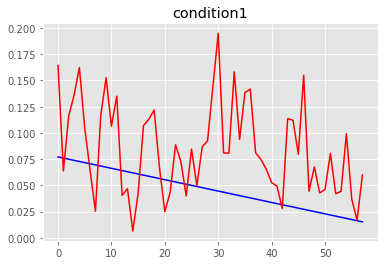

MSE condition1: 0.0032484948965526943
R2 condition1: -8.839157610505824


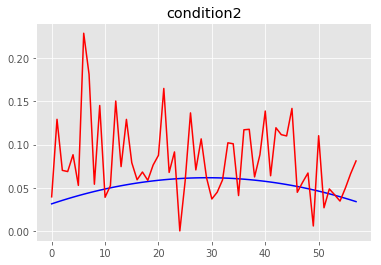

MSE condition2: 0.0028546317880922636
R2 condition2: -34.74235979153473


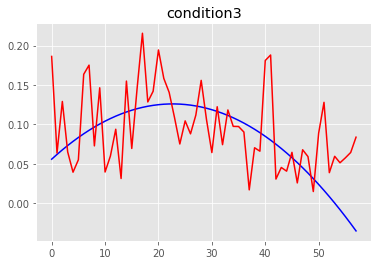

MSE condition3: 0.0029154915037945687
R2 condition3: -0.5431290528217505


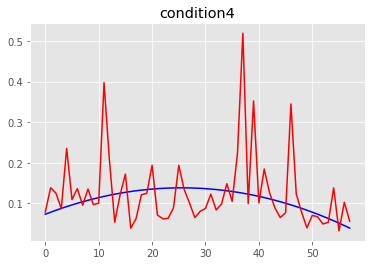

MSE condition4: 0.008271333379891261
R2 condition4: -10.347257090510878
==== the test person number # 8 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.33459042e-09 4.56397210e-09 3.99267593e-09 3.91642910e-09]
Global min values from training is:  [-4.32049330e-09 -4.5

n_neighbors: 25 weights_type:distance All_MSE: 0.012963075292644491 All_R2: -0.5885747643389543
The best neighbors is: 25 The best weigths :distance The best mse: 0.012963075292644491
n_neighbors: 26 weights_type:uniform All_MSE: 0.012826740811622122 All_R2: -0.5718675007327423
The best neighbors is: 26 The best weigths :uniform The best mse: 0.012826740811622122
n_neighbors: 26 weights_type:distance All_MSE: 0.012850944424904235 All_R2: -0.5748335599739165
n_neighbors: 27 weights_type:uniform All_MSE: 0.01275675741027133 All_R2: -0.5632913054396738
The best neighbors is: 27 The best weigths :uniform The best mse: 0.01275675741027133
n_neighbors: 27 weights_type:distance All_MSE: 0.012793978122395638 All_R2: -0.5678525598223396
n_neighbors: 28 weights_type:uniform All_MSE: 0.012804908539660948 All_R2: -0.5691920402032966
n_neighbors: 28 weights_type:distance All_MSE: 0.012814614370001405 All_R2: -0.5703814521906321
n_neighbors: 29 weights_type:uniform All_MSE: 0.01262096070794002 All_R

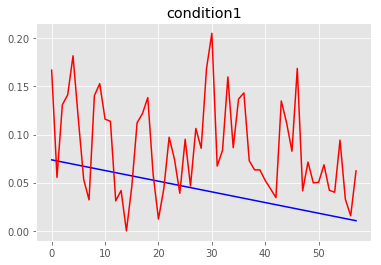

MSE condition1: 0.004118306821647032
R2 condition1: -10.94253955760976


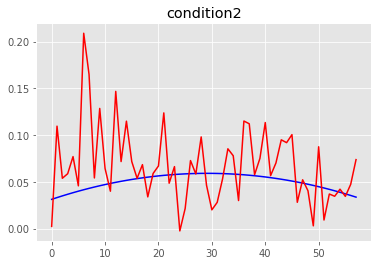

MSE condition2: 0.001958395924046729
R2 condition2: -27.873181624683156


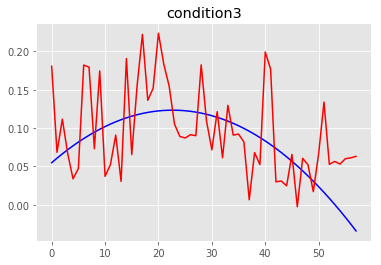

MSE condition3: 0.003404330495632358
R2 condition3: -0.8911771977025471


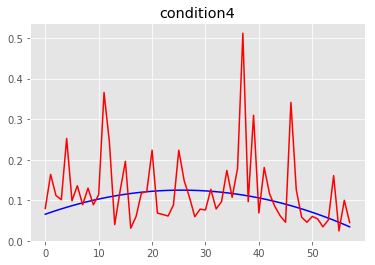

MSE condition4: 0.008572842945987726
R2 condition4: -13.19208533985507
==== the test person number # 8 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.38785393e-09 4.60737639e-09 4.05236409e-09 3.87663191e-09]
Global min values from training is:  [-4.37596550e-09 -4.61

n_neighbors: 26 weights_type:distance All_MSE: 0.00484080411452088 All_R2: -0.49785119931634725
The best neighbors is: 26 The best weigths :distance The best mse: 0.00484080411452088
n_neighbors: 27 weights_type:uniform All_MSE: 0.004883064632471893 All_R2: -0.5109275325037972
n_neighbors: 27 weights_type:distance All_MSE: 0.004861789025069017 All_R2: -0.5043443919117232
n_neighbors: 28 weights_type:uniform All_MSE: 0.004834761156480903 All_R2: -0.4959813752678077
The best neighbors is: 28 The best weigths :uniform The best mse: 0.004834761156480903
n_neighbors: 28 weights_type:distance All_MSE: 0.0048211738731669725 All_R2: -0.49177717114680797
The best neighbors is: 28 The best weigths :distance The best mse: 0.0048211738731669725
n_neighbors: 29 weights_type:uniform All_MSE: 0.00479840245634065 All_R2: -0.48473119423955735
The best neighbors is: 29 The best weigths :uniform The best mse: 0.00479840245634065
n_neighbors: 29 weights_type:distance All_MSE: 0.004787452045190118 All_R2: 

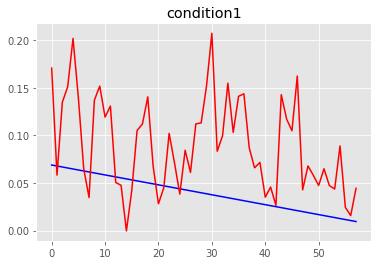

MSE condition1: 0.004687572062939688
R2 condition1: -14.396558671467217


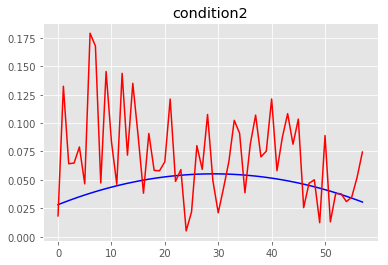

MSE condition2: 0.002182549158779051
R2 condition2: -32.8484998629842


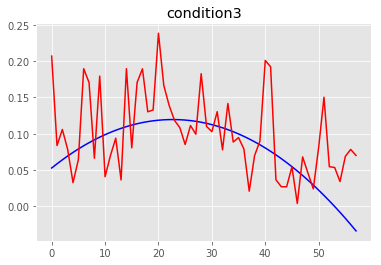

MSE condition3: 0.0035143518383899588
R2 condition3: -1.0573532378572366


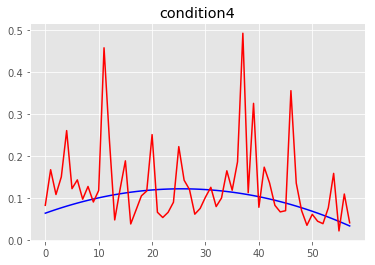

MSE condition4: 0.009819369778954085
R2 condition4: -16.004929769225416
==== the test person number # 8 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37582075e-09 4.56864955e-09 4.04525069e-09 3.87391306e-09]
Global min values from training is:  [-4.36519916e-09 -4.5

n_neighbors: 24 weights_type:distance All_MSE: 0.007210986438165584 All_R2: 0.31869273073683235
n_neighbors: 25 weights_type:uniform All_MSE: 0.007218555581314993 All_R2: 0.31797758416236477
n_neighbors: 25 weights_type:distance All_MSE: 0.007198743776994221 All_R2: 0.3198494398948233
n_neighbors: 26 weights_type:uniform All_MSE: 0.007180513614375341 All_R2: 0.3215718592085466
n_neighbors: 26 weights_type:distance All_MSE: 0.007164097386916115 All_R2: 0.32312289459014887
n_neighbors: 27 weights_type:uniform All_MSE: 0.007089114630665935 All_R2: 0.330207403393584
The best neighbors is: 27 The best weigths :uniform The best mse: 0.007089114630665935
n_neighbors: 27 weights_type:distance All_MSE: 0.007084564489762106 All_R2: 0.3306373090799327
The best neighbors is: 27 The best weigths :distance The best mse: 0.007084564489762106
n_neighbors: 28 weights_type:uniform All_MSE: 0.007170200337471243 All_R2: 0.32254627659026525
n_neighbors: 28 weights_type:distance All_MSE: 0.00714916570851958

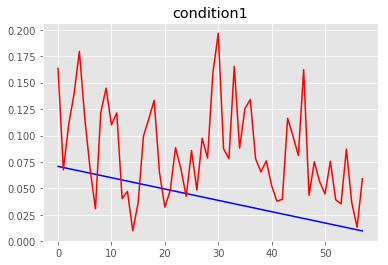

MSE condition1: 0.0037693196829803725
R2 condition1: -10.726644058433115


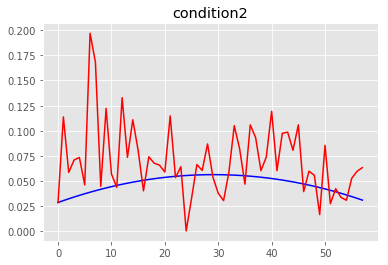

MSE condition2: 0.001858210314039218
R2 condition2: -26.683577726793423


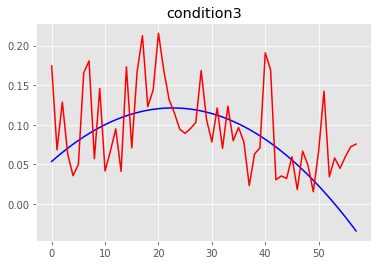

MSE condition3: 0.0029789543581228363
R2 condition3: -0.6983275684935608


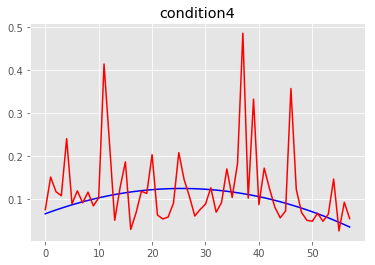

MSE condition4: 0.008574621276478477
R2 condition4: -13.451042447372753
==== the test person number # 8 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.46203357e-09 4.68946543e-09 4.03112545e-09 3.95819384e-09]
Global min values from training is:  [-4.44901368e-09 -4.7

n_neighbors: 30 weights_type:uniform All_MSE: 0.0033827686444989676 All_R2: -4.210739475814789
n_neighbors: 30 weights_type:distance All_MSE: 0.0033543874798152547 All_R2: -4.1670217786475545
n_neighbors: 31 weights_type:uniform All_MSE: 0.00341513989108229 All_R2: -4.260603403910302
n_neighbors: 31 weights_type:distance All_MSE: 0.0033790503820301213 All_R2: -4.205011949322735
n_neighbors: 32 weights_type:uniform All_MSE: 0.00341686408054755 All_R2: -4.263259305940441
n_neighbors: 32 weights_type:distance All_MSE: 0.0033773570058374344 All_R2: -4.202403511353148
n_neighbors: 33 weights_type:uniform All_MSE: 0.0034179317076773854 All_R2: -4.264903854360839
n_neighbors: 33 weights_type:distance All_MSE: 0.0033788453076964388 All_R2: -4.2046960575079835
n_neighbors: 34 weights_type:uniform All_MSE: 0.003398622247805628 All_R2: -4.23516000386901
n_neighbors: 34 weights_type:distance All_MSE: 0.0033627156762447786 All_R2: -4.179850342010357
n_neighbors: 35 weights_type:uniform All_MSE: 0.0

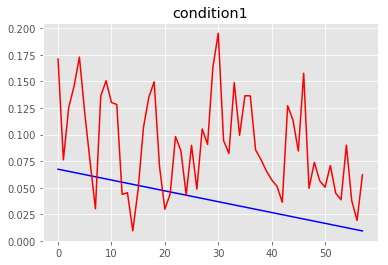

MSE condition1: 0.004445502223314828
R2 condition1: -14.255172492380591


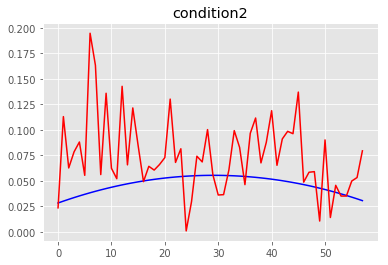

MSE condition2: 0.002232558394868497
R2 condition2: -33.51174112234662


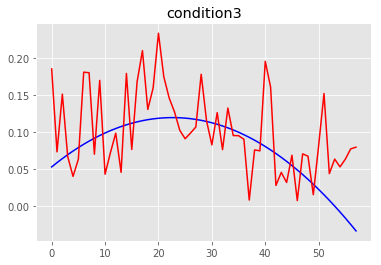

MSE condition3: 0.0034473157180257195
R2 condition3: -1.022929764102099


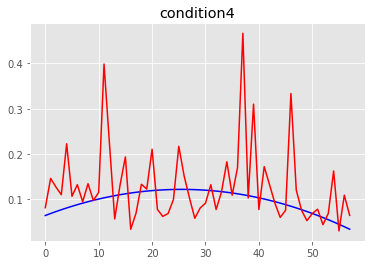

MSE condition4: 0.007903764198520367
R2 condition4: -12.816852853971586
==== the test person number # 8 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44253580e-09 4.41034274e-09 4.02418694e-09 3.91339069e-09]
Global min values from training is:  [-4.43046513e-09 -4.4

n_neighbors: 29 weights_type:distance All_MSE: 0.006362417350825547 All_R2: -5.309702741805729
n_neighbors: 30 weights_type:uniform All_MSE: 0.006457498497521834 All_R2: -5.403996111593197
n_neighbors: 30 weights_type:distance All_MSE: 0.006514824979784516 All_R2: -5.460847626098763
n_neighbors: 31 weights_type:uniform All_MSE: 0.006356714141056257 All_R2: -5.304046784905369
n_neighbors: 31 weights_type:distance All_MSE: 0.006414741458042586 All_R2: -5.361593327500654
n_neighbors: 32 weights_type:uniform All_MSE: 0.006182022186638991 All_R2: -5.130802207729839
The best neighbors is: 32 The best weigths :uniform The best mse: 0.006182022186638991
n_neighbors: 32 weights_type:distance All_MSE: 0.00625750471454325 All_R2: -5.205659339385015
n_neighbors: 33 weights_type:uniform All_MSE: 0.006086622840320601 All_R2: -5.0361932747032245
The best neighbors is: 33 The best weigths :uniform The best mse: 0.006086622840320601
n_neighbors: 33 weights_type:distance All_MSE: 0.006176417887728273 Al

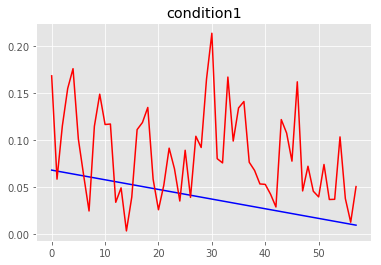

MSE condition1: 0.004227372429228487
R2 condition1: -13.310234116651012


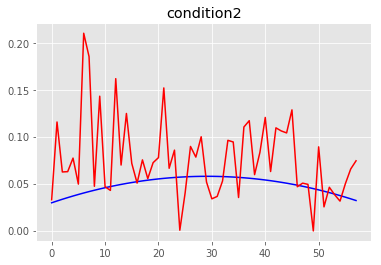

MSE condition2: 0.002532962289511658
R2 condition2: -35.30653888865518


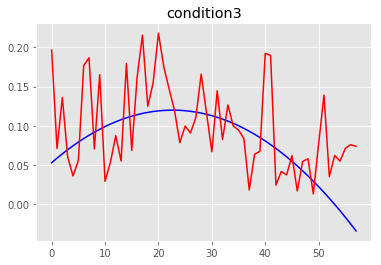

MSE condition3: 0.0034387567829590594
R2 condition3: -1.001186011703437


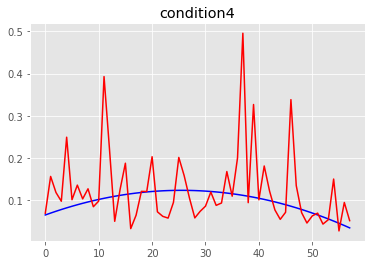

MSE condition4: 0.008439525937862638
R2 condition4: -13.39424631073203
==== the test person number # 8 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44315248e-09 4.67691742e-09 4.04584805e-09 3.93256581e-09]
Global min values from training is:  [-4.43080526e-09 -4.68

n_neighbors: 27 weights_type:uniform All_MSE: 0.003356856479329449 All_R2: -2.895060974260368
n_neighbors: 27 weights_type:distance All_MSE: 0.0033592455598971146 All_R2: -2.897833095898805
n_neighbors: 28 weights_type:uniform All_MSE: 0.0033428996859944677 All_R2: -2.878866489515592
The best neighbors is: 28 The best weigths :uniform The best mse: 0.0033428996859944677
n_neighbors: 28 weights_type:distance All_MSE: 0.0033461539159803455 All_R2: -2.8826424699000115
n_neighbors: 29 weights_type:uniform All_MSE: 0.003337656547220001 All_R2: -2.8727827187768633
The best neighbors is: 29 The best weigths :uniform The best mse: 0.003337656547220001
n_neighbors: 29 weights_type:distance All_MSE: 0.003339451823147351 All_R2: -2.8748658311308493
n_neighbors: 30 weights_type:uniform All_MSE: 0.003313303470808865 All_R2: -2.8445251158330684
The best neighbors is: 30 The best weigths :uniform The best mse: 0.003313303470808865
n_neighbors: 30 weights_type:distance All_MSE: 0.0033113305264421238 A

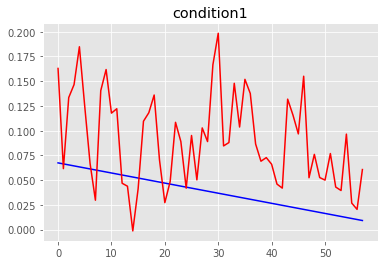

MSE condition1: 0.004621220925078921
R2 condition1: -14.79581165849129


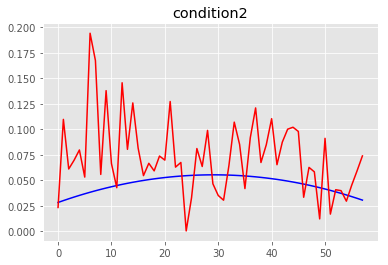

MSE condition2: 0.0021532619930989846
R2 condition2: -32.46670901033507


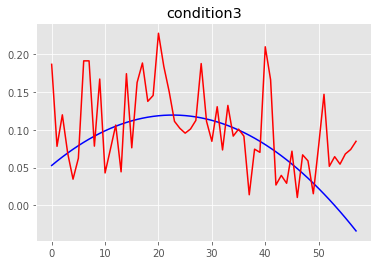

MSE condition3: 0.0034317913730552213
R2 condition3: -1.0166554160633288


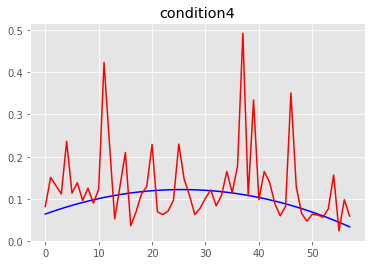

MSE condition4: 0.008997582300173572
R2 condition4: -14.639349630840663
==== the test person number # 8 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 9, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.03869512e-09 4.32638346e-09 3.69001653e-09 3.54649236e-09]
Global min values from training is:  [-4.02994098e-09 -4.3

n_neighbors: 28 weights_type:distance All_MSE: 0.26423554832410034 All_R2: -4.932836804293646
n_neighbors: 29 weights_type:uniform All_MSE: 0.2548074860605841 All_R2: -4.721150090886133
The best neighbors is: 29 The best weigths :uniform The best mse: 0.2548074860605841
n_neighbors: 29 weights_type:distance All_MSE: 0.2603652321966652 All_R2: -4.845937240208747
n_neighbors: 30 weights_type:uniform All_MSE: 0.24848017109695858 All_R2: -4.579083940715786
The best neighbors is: 30 The best weigths :uniform The best mse: 0.24848017109695858
n_neighbors: 30 weights_type:distance All_MSE: 0.25460962280569666 All_R2: -4.716707500143671
n_neighbors: 31 weights_type:uniform All_MSE: 0.24442127100625968 All_R2: -4.48795013227941
The best neighbors is: 31 The best weigths :uniform The best mse: 0.24442127100625968
n_neighbors: 31 weights_type:distance All_MSE: 0.2509586770692057 All_R2: -4.634733422948863
n_neighbors: 32 weights_type:uniform All_MSE: 0.23860231497233403 All_R2: -4.357298080579325

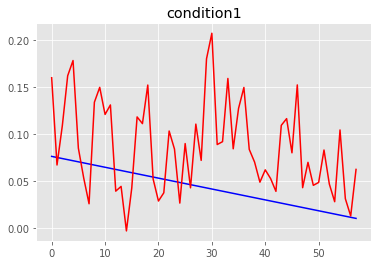

MSE condition1: 0.004016288924106818
R2 condition1: -9.767427445303092


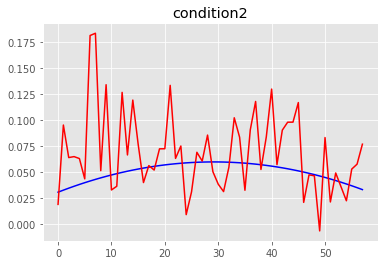

MSE condition2: 0.001891862108922504
R2 condition2: -24.46152091904992


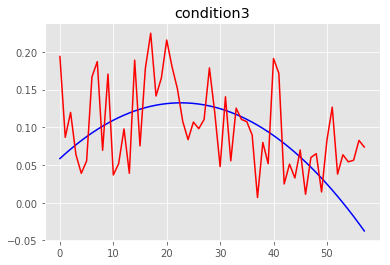

MSE condition3: 0.0034267236664182544
R2 condition3: -0.6354704422246142


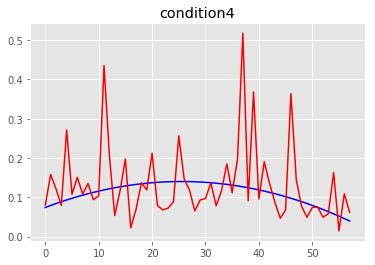

MSE condition4: 0.00952058270074429
R2 condition4: -11.709471965338503
==== the test person number # 8 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.25082180e-09 4.55981022e-09 3.94105493e-09 3.76226188e-09]
Global min values from training is:  [-4.24113281e-09 -4.56

n_neighbors: 27 weights_type:uniform All_MSE: 0.07083920131440491 All_R2: -0.49971833937315413
n_neighbors: 27 weights_type:distance All_MSE: 0.0694444706542073 All_R2: -0.470190858673579
n_neighbors: 28 weights_type:uniform All_MSE: 0.06961841089195794 All_R2: -0.47387330228769886
n_neighbors: 28 weights_type:distance All_MSE: 0.0684685869520001 All_R2: -0.4495306781783215
n_neighbors: 29 weights_type:uniform All_MSE: 0.06891798359669711 All_R2: -0.4590447378684299
n_neighbors: 29 weights_type:distance All_MSE: 0.06792997478568824 All_R2: -0.43812785984271807
n_neighbors: 30 weights_type:uniform All_MSE: 0.06879951190065187 All_R2: -0.4565366043497143
n_neighbors: 30 weights_type:distance All_MSE: 0.06782987471641086 All_R2: -0.43600866726456444
n_neighbors: 31 weights_type:uniform All_MSE: 0.06879534957737664 All_R2: -0.45644848488429934
n_neighbors: 31 weights_type:distance All_MSE: 0.06777044601663651 All_R2: -0.43475051769083994
n_neighbors: 32 weights_type:uniform All_MSE: 0.0683

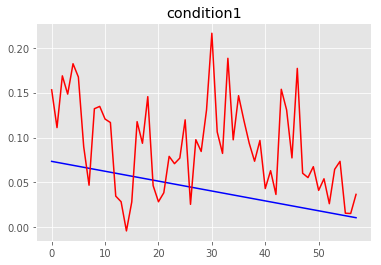

MSE condition1: 0.004603844534759612
R2 condition1: -12.57266599581988


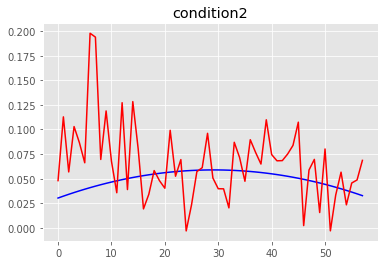

MSE condition2: 0.001982610532577258
R2 condition2: -26.670039632059122


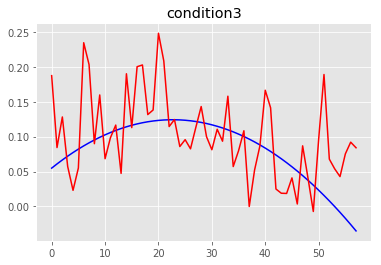

MSE condition3: 0.004115049952726394
R2 condition3: -1.2357876036082112


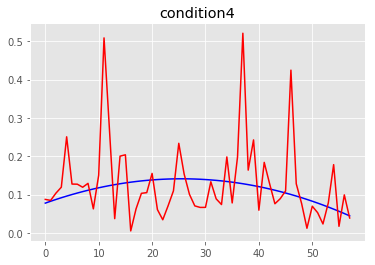

MSE condition4: 0.010786247461732703
R2 condition4: -14.572720071069277
==== the test person number # 8 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40673648e-09 4.61434192e-09 3.97824610e-09 3.86238834e-09]
Global min values from training is:  [-4.39197405e-09 -4.6

n_neighbors: 28 weights_type:distance All_MSE: 0.011851516465620989 All_R2: 0.15802237876655878
n_neighbors: 29 weights_type:uniform All_MSE: 0.01213324014123991 All_R2: 0.13800763795842275
n_neighbors: 29 weights_type:distance All_MSE: 0.011886364876702703 All_R2: 0.1555466127030798
n_neighbors: 30 weights_type:uniform All_MSE: 0.012203412654452033 All_R2: 0.1330223108973917
n_neighbors: 30 weights_type:distance All_MSE: 0.01194732984060927 All_R2: 0.1512154255982452
n_neighbors: 31 weights_type:uniform All_MSE: 0.012478222050550712 All_R2: 0.11349878727988982
n_neighbors: 31 weights_type:distance All_MSE: 0.012148992796544727 All_R2: 0.13688850832803878
n_neighbors: 32 weights_type:uniform All_MSE: 0.012427649736127738 All_R2: 0.11709164032292807
n_neighbors: 32 weights_type:distance All_MSE: 0.012108304134094503 All_R2: 0.13977918846339432
n_neighbors: 33 weights_type:uniform All_MSE: 0.012378219632884286 All_R2: 0.12060334626089597
n_neighbors: 33 weights_type:distance All_MSE: 0.0

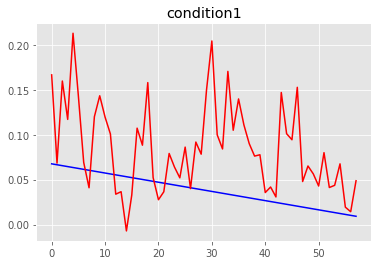

MSE condition1: 0.004395554347433667
R2 condition1: -13.956234951406511


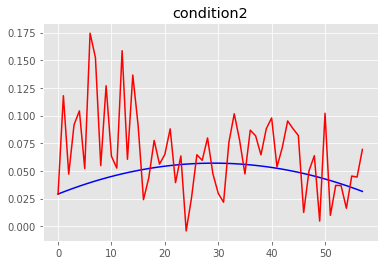

MSE condition2: 0.0018724972583192086
R2 condition2: -26.380744770510645


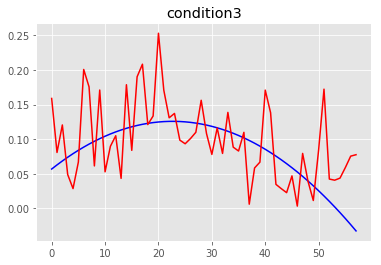

MSE condition3: 0.0031874797665684316
R2 condition3: -0.751800333845358


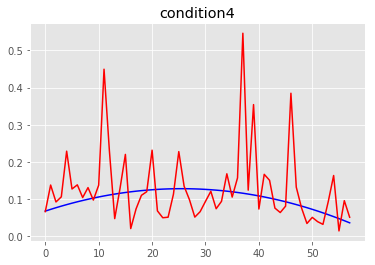

MSE condition4: 0.010468445511643328
R2 condition4: -15.833764707912891
==== the test person number # 8 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.99056774e-09 4.22496789e-09 3.72294697e-09 3.56315813e-09]
Global min values from training is:  [-3.98458088e-09 -4.2

n_neighbors: 38 weights_type:uniform All_MSE: 7.758530910593901 All_R2: -4.769124317196512
n_neighbors: 38 weights_type:distance All_MSE: 7.571070481317665 All_R2: -4.62973162371985
n_neighbors: 39 weights_type:uniform All_MSE: 7.788026219212505 All_R2: -4.791056575269037
n_neighbors: 39 weights_type:distance All_MSE: 7.599355200277201 All_R2: -4.650763705931666
n_neighbors: 40 weights_type:uniform All_MSE: 7.802702834014311 All_R2: -4.80196988041958
n_neighbors: 40 weights_type:distance All_MSE: 7.615358916028624 All_R2: -4.662663822947501
n_neighbors: 41 weights_type:uniform All_MSE: 7.82673848038552 All_R2: -4.819842417573531
n_neighbors: 41 weights_type:distance All_MSE: 7.639107306514779 All_R2: -4.680322761041164
n_neighbors: 42 weights_type:uniform All_MSE: 7.852780370572445 All_R2: -4.839206766787892
n_neighbors: 42 weights_type:distance All_MSE: 7.664299862518232 All_R2: -4.6990555584130735
n_neighbors: 43 weights_type:uniform All_MSE: 7.876953701679734 All_R2: -4.857181684195

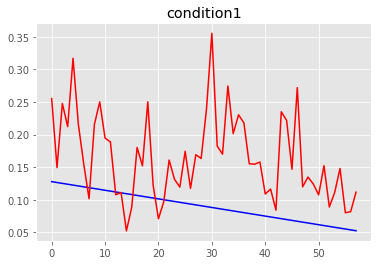

MSE condition1: 0.009416994387836953
R2 condition1: -18.242317681369485


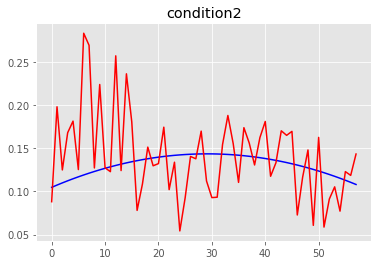

MSE condition2: 0.0026949768220187616
R2 condition2: -19.484349256726933


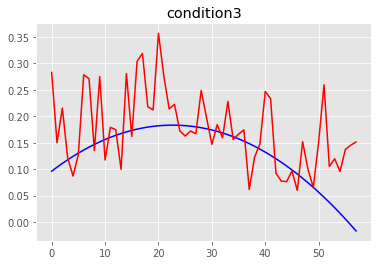

MSE condition3: 0.006855681078394246
R2 condition3: -1.35442389718186


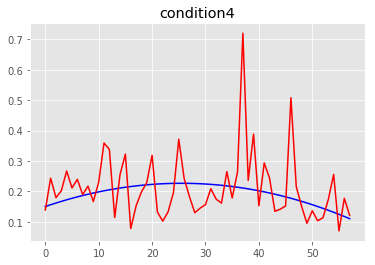

MSE condition4: 0.011536080265039113
R2 condition4: -10.495857867748875
==== the test person number # 8 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.34776158e-09 4.53593989e-09 3.93772255e-09 3.85203777e-09]
Global min values from training is:  [-4.33505528e-09 -4.5

n_neighbors: 28 weights_type:uniform All_MSE: 0.01629273559494594 All_R2: -0.17529103731934415
n_neighbors: 28 weights_type:distance All_MSE: 0.01592769739265109 All_R2: -0.14895868048852523
n_neighbors: 29 weights_type:uniform All_MSE: 0.016185650977046946 All_R2: -0.16756639274274554
n_neighbors: 29 weights_type:distance All_MSE: 0.015843824528120547 All_R2: -0.14290843647746865
n_neighbors: 30 weights_type:uniform All_MSE: 0.016057900433999423 All_R2: -0.15835099319357426
n_neighbors: 30 weights_type:distance All_MSE: 0.01573692054886181 All_R2: -0.13519682243055953
The best neighbors is: 30 The best weigths :distance The best mse: 0.01573692054886181
n_neighbors: 31 weights_type:uniform All_MSE: 0.016289748510249384 All_R2: -0.1750755612962347
n_neighbors: 31 weights_type:distance All_MSE: 0.015929717143757238 All_R2: -0.14910437703891954
n_neighbors: 32 weights_type:uniform All_MSE: 0.0162499429838838 All_R2: -0.17220415409143341
n_neighbors: 32 weights_type:distance All_MSE: 0.01

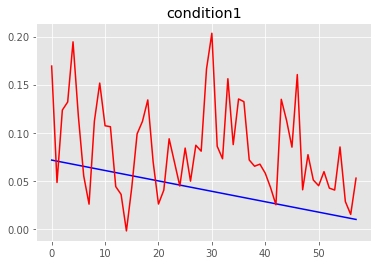

MSE condition1: 0.0038952585174342087
R2 condition1: -10.863171209010115


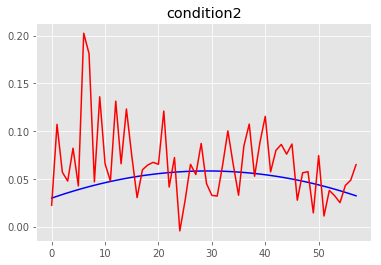

MSE condition2: 0.0018643243635789294
R2 condition2: -25.259260610241736


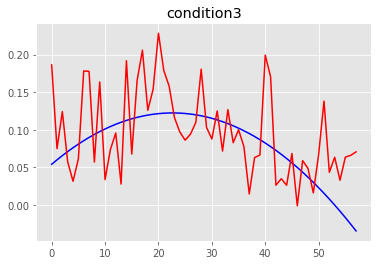

MSE condition3: 0.0033018121485605865
R2 condition3: -0.8498941239563531


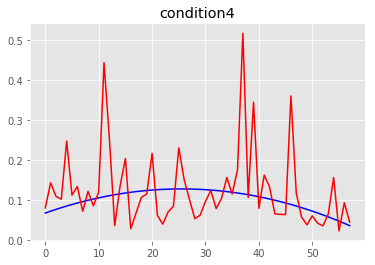

MSE condition4: 0.00975495533243109
R2 condition4: -14.654323085153358
==== the test person number # 8 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40211262e-09 4.62448599e-09 3.98444470e-09 3.92115979e-09]
Global min values from training is:  [-4.39101386e-09 -4.63

n_neighbors: 25 weights_type:distance All_MSE: 0.0041681898921945605 All_R2: -0.5825804578369889
n_neighbors: 26 weights_type:uniform All_MSE: 0.0041730301473693965 All_R2: -0.5844182083830913
n_neighbors: 26 weights_type:distance All_MSE: 0.00416231986582998 All_R2: -0.5803517232419146
n_neighbors: 27 weights_type:uniform All_MSE: 0.004095524379084988 All_R2: -0.5549907788683659
The best neighbors is: 27 The best weigths :uniform The best mse: 0.004095524379084988
n_neighbors: 27 weights_type:distance All_MSE: 0.004098540800753197 All_R2: -0.5561360553812336
n_neighbors: 28 weights_type:uniform All_MSE: 0.004105529526568659 All_R2: -0.5587895383526891
n_neighbors: 28 weights_type:distance All_MSE: 0.004101271553137712 All_R2: -0.5571728688352029
n_neighbors: 29 weights_type:uniform All_MSE: 0.004066424618595596 All_R2: -0.5439421670082178
The best neighbors is: 29 The best weigths :uniform The best mse: 0.004066424618595596
n_neighbors: 29 weights_type:distance All_MSE: 0.004067167293

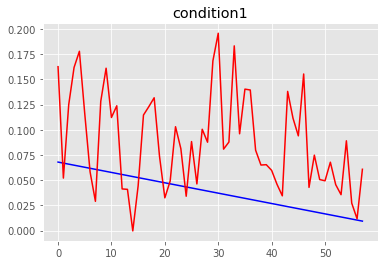

MSE condition1: 0.004499883818619348
R2 condition1: -14.219284700009373


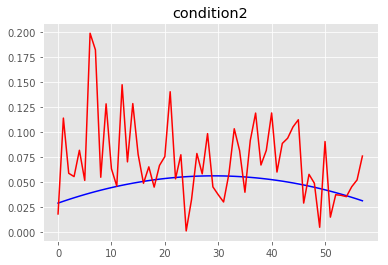

MSE condition2: 0.0022399148057552594
R2 condition2: -33.27981396559009


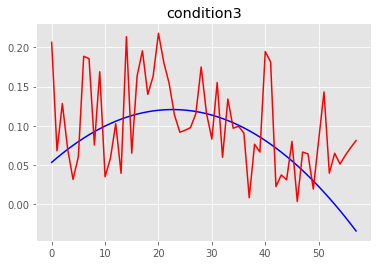

MSE condition3: 0.0036828323281706174
R2 condition3: -1.1205506325604238


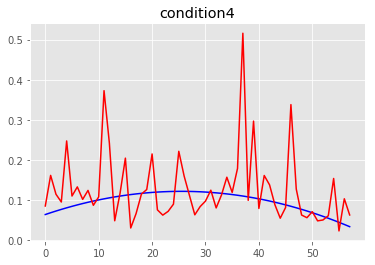

MSE condition4: 0.008437866180742661
R2 condition4: -13.731043081105899
==== the test person number # 8 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.14662817e-09 4.38612130e-09 3.65383485e-09 3.71014406e-09]
Global min values from training is:  [-4.12896076e-09 -4.3

n_neighbors: 25 weights_type:uniform All_MSE: 0.26732950645502623 All_R2: 0.4955145399623534
n_neighbors: 25 weights_type:distance All_MSE: 0.26263938902316647 All_R2: 0.5043654000174908
n_neighbors: 26 weights_type:uniform All_MSE: 0.2699061413597662 All_R2: 0.49065209562351464
n_neighbors: 26 weights_type:distance All_MSE: 0.2643639552917345 All_R2: 0.501110919736204
n_neighbors: 27 weights_type:uniform All_MSE: 0.2693548455139694 All_R2: 0.49169246240558717
n_neighbors: 27 weights_type:distance All_MSE: 0.26378854664155515 All_R2: 0.5021967905083637
n_neighbors: 28 weights_type:uniform All_MSE: 0.27184788469559446 All_R2: 0.4869877740413583
n_neighbors: 28 weights_type:distance All_MSE: 0.26579201326858204 All_R2: 0.4984159890681914
n_neighbors: 29 weights_type:uniform All_MSE: 0.27233417762961265 All_R2: 0.4860700761868101
n_neighbors: 29 weights_type:distance All_MSE: 0.26604651727507805 All_R2: 0.4979357069904621
n_neighbors: 30 weights_type:uniform All_MSE: 0.2748136495874592 Al

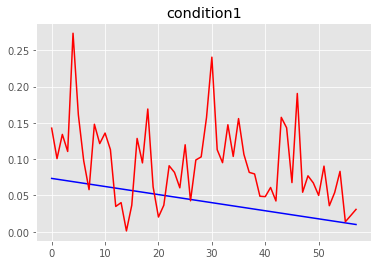

MSE condition1: 0.005363494878170034
R2 condition1: -14.441255452354026


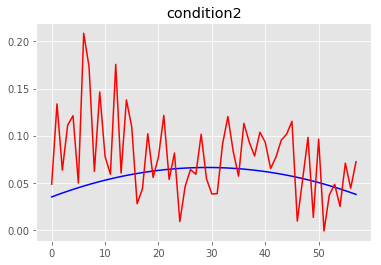

MSE condition2: 0.002409630628481106
R2 condition2: -27.109147029236897


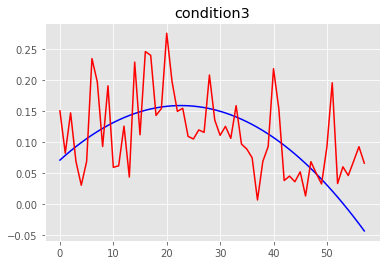

MSE condition3: 0.004237439052088846
R2 condition3: -0.4210508627393783


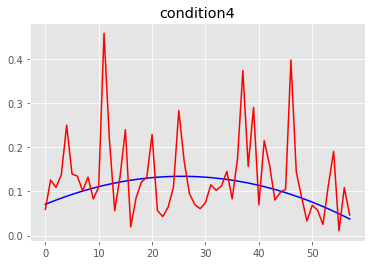

MSE condition4: 0.008735980533751526
R2 condition4: -11.648065835123251
==== the test person number # 8 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44918650e-09 4.68061890e-09 4.06957679e-09 3.97652825e-09]
Global min values from training is:  [-4.43717680e-09 -4.6

n_neighbors: 25 weights_type:distance All_MSE: 0.0024073686036621632 All_R2: 0.17172574285176412
n_neighbors: 26 weights_type:uniform All_MSE: 0.0024470873511380554 All_R2: 0.15806019283569772
n_neighbors: 26 weights_type:distance All_MSE: 0.002375255298252388 All_R2: 0.1827745802181705
n_neighbors: 27 weights_type:uniform All_MSE: 0.002451551259077007 All_R2: 0.15652434991306063
n_neighbors: 27 weights_type:distance All_MSE: 0.002377648303153586 All_R2: 0.181951247906751
n_neighbors: 28 weights_type:uniform All_MSE: 0.0023943421342757284 All_R2: 0.1762076029366303
n_neighbors: 28 weights_type:distance All_MSE: 0.0023340195473763813 All_R2: 0.1969620672830168
The best neighbors is: 28 The best weigths :distance The best mse: 0.0023340195473763813
n_neighbors: 29 weights_type:uniform All_MSE: 0.0024187234683127343 All_R2: 0.16781901163114277
n_neighbors: 29 weights_type:distance All_MSE: 0.0023548925148459353 All_R2: 0.18978055731440446
n_neighbors: 30 weights_type:uniform All_MSE: 0.00

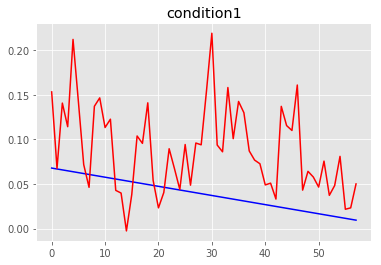

MSE condition1: 0.0045431163130981505
R2 condition1: -14.438043961878307


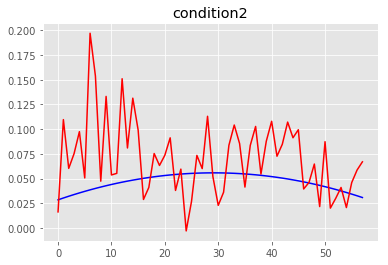

MSE condition2: 0.002083736191593763
R2 condition2: -30.818647823747227


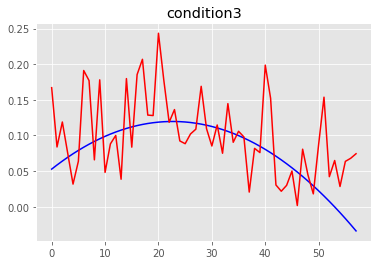

MSE condition3: 0.003290339567469366
R2 condition3: -0.9233936799797808


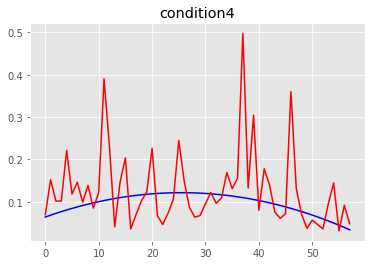

MSE condition4: 0.008697105946710793
R2 condition4: -14.313892909744036
==== the test person number # 9 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.11157338e-09 4.00180341e-09 3.74456059e-09 3.64273057e-09]
Global min values from training is:  [-4.10459332e-09 -4.0

n_neighbors: 28 weights_type:distance All_MSE: 0.11423360804224823 All_R2: -0.9371208281314469
n_neighbors: 29 weights_type:uniform All_MSE: 0.11057285988225232 All_R2: -0.8750435495721522
The best neighbors is: 29 The best weigths :uniform The best mse: 0.11057285988225232
n_neighbors: 29 weights_type:distance All_MSE: 0.1127718891456714 All_R2: -0.9123336733881156
n_neighbors: 30 weights_type:uniform All_MSE: 0.11009268305900413 All_R2: -0.8669009325136412
The best neighbors is: 30 The best weigths :uniform The best mse: 0.11009268305900413
n_neighbors: 30 weights_type:distance All_MSE: 0.11228137871857871 All_R2: -0.904015823842599
n_neighbors: 31 weights_type:uniform All_MSE: 0.10780967741418745 All_R2: -0.8281867759610402
The best neighbors is: 31 The best weigths :uniform The best mse: 0.10780967741418745
n_neighbors: 31 weights_type:distance All_MSE: 0.11030492821006503 All_R2: -0.8705000878746267
n_neighbors: 32 weights_type:uniform All_MSE: 0.10602375795937641 All_R2: -0.79790

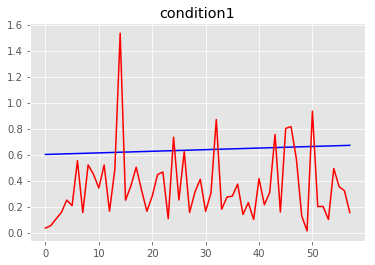

MSE condition1: 0.14938147009348984
R2 condition1: -348.9729118915574


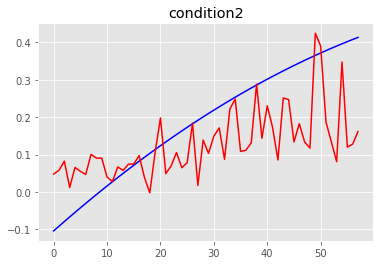

MSE condition2: 0.018108983491942232
R2 condition2: 0.22559825308818326


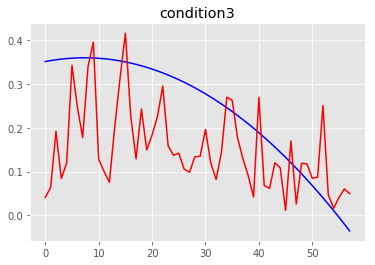

MSE condition3: 0.020832285208702388
R2 condition3: -0.438556693027067


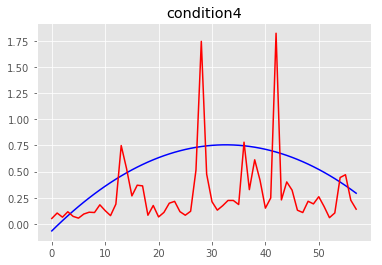

MSE condition4: 0.1696477556263683
R2 condition4: -2.4728590635329355
==== the test person number # 9 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.16700742e-09 4.47302806e-09 3.90621965e-09 3.85782026e-09]
Global min values from training is:  [-4.15691746e-09 -4.482

n_neighbors: 28 weights_type:uniform All_MSE: 0.015846545701638737 All_R2: -0.6709230783015179
n_neighbors: 28 weights_type:distance All_MSE: 0.01580920758526577 All_R2: -0.6669859981628827
n_neighbors: 29 weights_type:uniform All_MSE: 0.01574555491742542 All_R2: -0.6602742066032303
n_neighbors: 29 weights_type:distance All_MSE: 0.01572369918166214 All_R2: -0.6579696505209327
n_neighbors: 30 weights_type:uniform All_MSE: 0.015823273872444598 All_R2: -0.6684692036712407
n_neighbors: 30 weights_type:distance All_MSE: 0.01577856861696261 All_R2: -0.6637553029566836
n_neighbors: 31 weights_type:uniform All_MSE: 0.015539431436537654 All_R2: -0.6385397234117554
The best neighbors is: 31 The best weigths :uniform The best mse: 0.015539431436537654
n_neighbors: 31 weights_type:distance All_MSE: 0.01556015840761456 All_R2: -0.6407252580366363
n_neighbors: 32 weights_type:uniform All_MSE: 0.015870815436472358 All_R2: -0.6734821760885872
n_neighbors: 32 weights_type:distance All_MSE: 0.0157895211

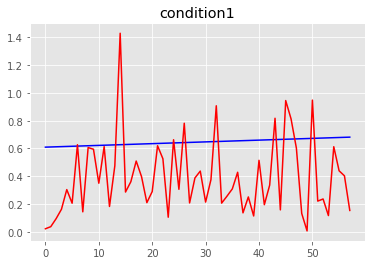

MSE condition1: 0.139876868531703
R2 condition1: -311.5972724892255


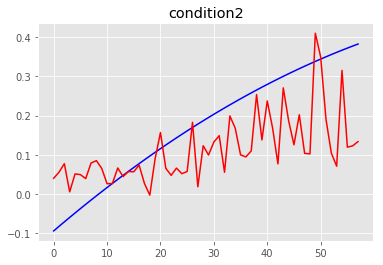

MSE condition2: 0.01588101667777013
R2 condition2: 0.19448488365267413


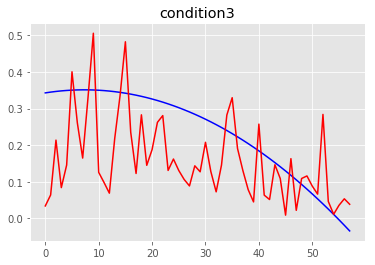

MSE condition3: 0.020223808849603196
R2 condition3: -0.4678099069127528


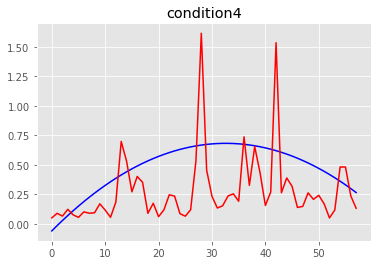

MSE condition4: 0.12557147425322823
R2 condition4: -2.151818442644504
==== the test person number # 9 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.22027093e-09 4.51643236e-09 3.96590781e-09 3.81802306e-09]
Global min values from training is:  [-4.21238966e-09 -4.525

n_neighbors: 26 weights_type:distance All_MSE: 0.00472175759258886 All_R2: -0.27426523064102737
The best neighbors is: 26 The best weigths :distance The best mse: 0.00472175759258886
n_neighbors: 27 weights_type:uniform All_MSE: 0.004699054109301057 All_R2: -0.26813821992503994
The best neighbors is: 27 The best weigths :uniform The best mse: 0.004699054109301057
n_neighbors: 27 weights_type:distance All_MSE: 0.004683803517764798 All_R2: -0.2640225282233175
The best neighbors is: 27 The best weigths :distance The best mse: 0.004683803517764798
n_neighbors: 28 weights_type:uniform All_MSE: 0.004694214927435766 All_R2: -0.26683226529378823
n_neighbors: 28 weights_type:distance All_MSE: 0.004677185083418156 All_R2: -0.26223640502579415
The best neighbors is: 28 The best weigths :distance The best mse: 0.004677185083418156
n_neighbors: 29 weights_type:uniform All_MSE: 0.004679162828300117 All_R2: -0.26277014092577233
n_neighbors: 29 weights_type:distance All_MSE: 0.004661480148673813 All_R

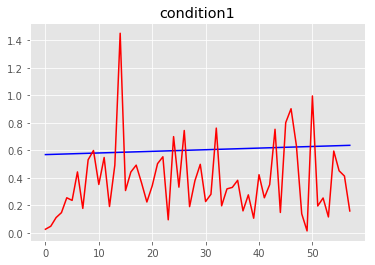

MSE condition1: 0.11629241495729732
R2 condition1: -296.4211533152206


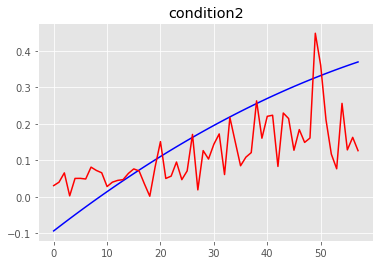

MSE condition2: 0.012824614651620877
R2 condition2: 0.3142796569278695


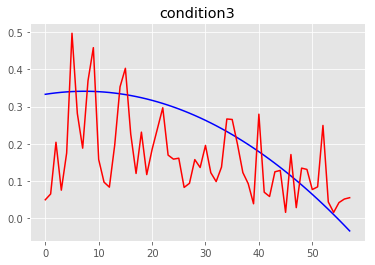

MSE condition3: 0.01759719418352306
R2 condition3: -0.34788851746003147


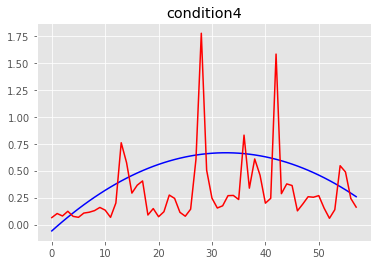

MSE condition4: 0.12204125297972827
R2 condition4: -2.215920709594363
==== the test person number # 9 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.20823775e-09 4.47770552e-09 3.95879440e-09 3.81530421e-09]
Global min values from training is:  [-4.20162331e-09 -4.486

n_neighbors: 25 weights_type:distance All_MSE: 0.008690261423424857 All_R2: 0.28550911600508766
n_neighbors: 26 weights_type:uniform All_MSE: 0.008944999459707103 All_R2: 0.2645652115743391
n_neighbors: 26 weights_type:distance All_MSE: 0.008800293420754056 All_R2: 0.2764625689325737
n_neighbors: 27 weights_type:uniform All_MSE: 0.008916947099885513 All_R2: 0.2668716042581133
n_neighbors: 27 weights_type:distance All_MSE: 0.00878360561343406 All_R2: 0.2778345974163038
n_neighbors: 28 weights_type:uniform All_MSE: 0.008858468629170283 All_R2: 0.27167955331743265
n_neighbors: 28 weights_type:distance All_MSE: 0.008733292047263117 All_R2: 0.28197124907945326
n_neighbors: 29 weights_type:uniform All_MSE: 0.008929725979133416 All_R2: 0.26582095776021997
n_neighbors: 29 weights_type:distance All_MSE: 0.008780779073065492 All_R2: 0.27806698827639253
n_neighbors: 30 weights_type:uniform All_MSE: 0.008846111316113275 All_R2: 0.2726955397302354
n_neighbors: 30 weights_type:distance All_MSE: 0.00

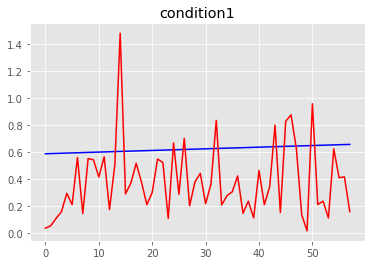

MSE condition1: 0.12830654108198541
R2 condition1: -308.44854314977067


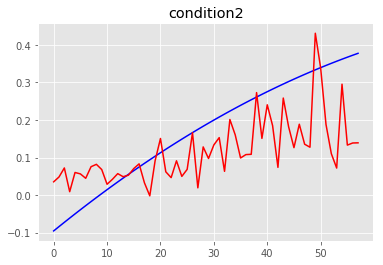

MSE condition2: 0.014480984847646611
R2 condition2: 0.25746028984132463


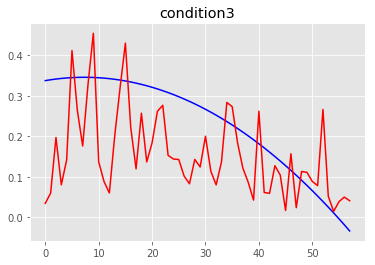

MSE condition3: 0.01932440354511631
R2 condition3: -0.44041953152734914


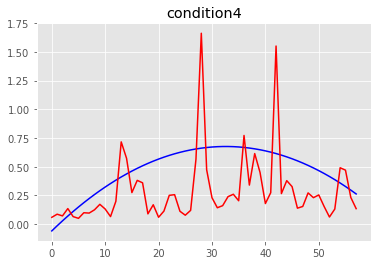

MSE condition4: 0.12264356493963526
R2 condition4: -2.138344712875162
==== the test person number # 9 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.29445057e-09 4.59852139e-09 3.94466917e-09 3.89958499e-09]
Global min values from training is:  [-4.28543784e-09 -4.609

n_neighbors: 30 weights_type:distance All_MSE: 0.0032315211157342705 All_R2: -3.869713366758927
n_neighbors: 31 weights_type:uniform All_MSE: 0.0032575165461619093 All_R2: -3.908886960399321
n_neighbors: 31 weights_type:distance All_MSE: 0.0032263463288434214 All_R2: -3.861915265496399
n_neighbors: 32 weights_type:uniform All_MSE: 0.0032841862762718554 All_R2: -3.9490766842330594
n_neighbors: 32 weights_type:distance All_MSE: 0.0032473979356426133 All_R2: -3.893638806005736
n_neighbors: 33 weights_type:uniform All_MSE: 0.003276608986104226 All_R2: -3.9376581510124495
n_neighbors: 33 weights_type:distance All_MSE: 0.003241506357839439 All_R2: -3.8847605427507865
n_neighbors: 34 weights_type:uniform All_MSE: 0.0032469045490803984 All_R2: -3.8928953013059537
n_neighbors: 34 weights_type:distance All_MSE: 0.0032182087810377928 All_R2: -3.8496524567749066
n_neighbors: 35 weights_type:uniform All_MSE: 0.003233107807300839 All_R2: -3.8721044181721513
n_neighbors: 35 weights_type:distance All_

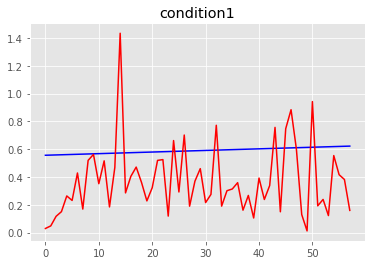

MSE condition1: 0.11215119001887094
R2 condition1: -299.71211335444025


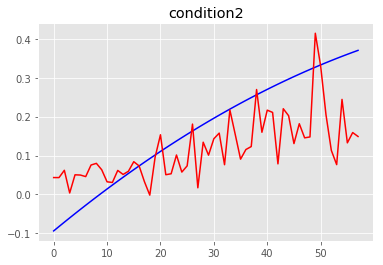

MSE condition2: 0.01279804134250796
R2 condition2: 0.31801293120286844


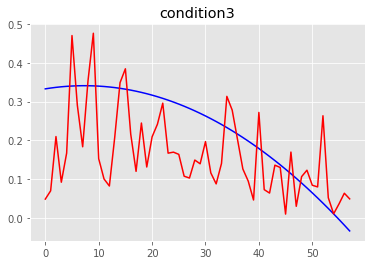

MSE condition3: 0.017016839074416788
R2 condition3: -0.30663505759227894


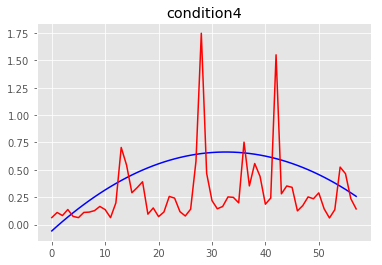

MSE condition4: 0.12130195430045515
R2 condition4: -2.2290212616869765
==== the test person number # 9 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.27495280e-09 4.31939870e-09 3.93773066e-09 3.85478184e-09]
Global min values from training is:  [-4.26688929e-09 -4.31

n_neighbors: 29 weights_type:uniform All_MSE: 0.005982806484638003 All_R2: -3.9373065813267605
n_neighbors: 29 weights_type:distance All_MSE: 0.006053641807203707 All_R2: -3.9957633783487045
n_neighbors: 30 weights_type:uniform All_MSE: 0.0058264341439039375 All_R2: -3.8082604239713165
n_neighbors: 30 weights_type:distance All_MSE: 0.005906387705348104 All_R2: -3.8742420408149165
n_neighbors: 31 weights_type:uniform All_MSE: 0.005729891489287712 All_R2: -3.7285886703821998
The best neighbors is: 31 The best weigths :uniform The best mse: 0.005729891489287712
n_neighbors: 31 weights_type:distance All_MSE: 0.005820006327706893 All_R2: -3.8029558734573197
n_neighbors: 32 weights_type:uniform All_MSE: 0.005679495862416932 All_R2: -3.6869997169607442
The best neighbors is: 32 The best weigths :uniform The best mse: 0.005679495862416932
n_neighbors: 32 weights_type:distance All_MSE: 0.005768847527283128 All_R2: -3.760737111631478
n_neighbors: 33 weights_type:uniform All_MSE: 0.00583726280546

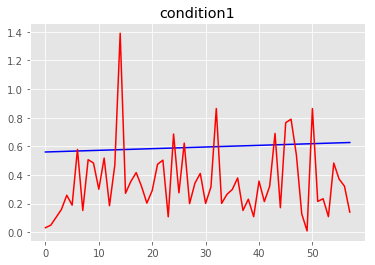

MSE condition1: 0.11805348111911648
R2 condition1: -310.9182962824261


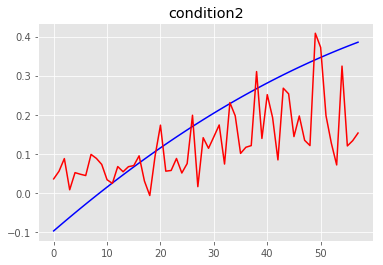

MSE condition2: 0.014621140612185179
R2 condition2: 0.2798676007332127


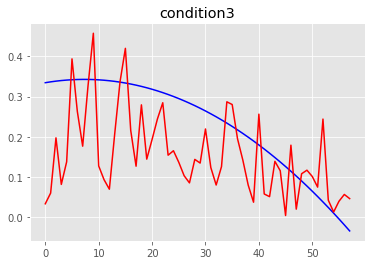

MSE condition3: 0.018240751359922244
R2 condition3: -0.388685724314235


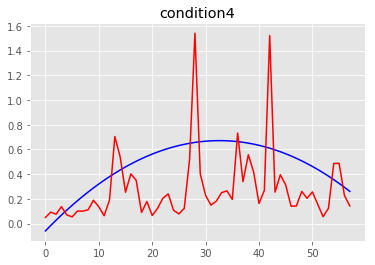

MSE condition4: 0.11797349821624921
R2 condition4: -2.0580160359904984
==== the test person number # 9 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.27556948e-09 4.58597338e-09 3.95939177e-09 3.87395696e-09]
Global min values from training is:  [-4.26722942e-09 -4.59

n_neighbors: 27 weights_type:distance All_MSE: 0.0031300049774629396 All_R2: -2.3152695775653447
n_neighbors: 28 weights_type:uniform All_MSE: 0.0031438837769162528 All_R2: -2.3299698614089808
n_neighbors: 28 weights_type:distance All_MSE: 0.0031504254180050864 All_R2: -2.336898701409338
n_neighbors: 29 weights_type:uniform All_MSE: 0.0031197651389790735 All_R2: -2.304423644332273
n_neighbors: 29 weights_type:distance All_MSE: 0.0031271315049745054 All_R2: -2.3122260246024995
n_neighbors: 30 weights_type:uniform All_MSE: 0.0030503935893869223 All_R2: -2.2309460014635256
The best neighbors is: 30 The best weigths :uniform The best mse: 0.0030503935893869223
n_neighbors: 30 weights_type:distance All_MSE: 0.003068633525718149 All_R2: -2.2502655573271904
n_neighbors: 31 weights_type:uniform All_MSE: 0.003048631101319068 All_R2: -2.2290791919490833
The best neighbors is: 31 The best weigths :uniform The best mse: 0.003048631101319068
n_neighbors: 31 weights_type:distance All_MSE: 0.00306668

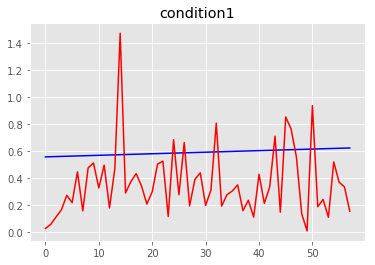

MSE condition1: 0.11667822476471428
R2 condition1: -310.5241708469481


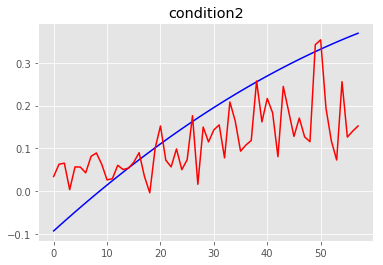

MSE condition2: 0.013285247561607634
R2 condition2: 0.2880455755598439


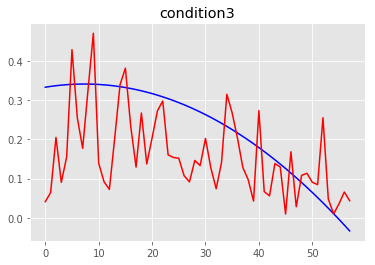

MSE condition3: 0.017443564268324312
R2 condition3: -0.3413393231313884


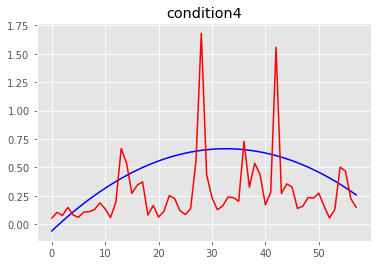

MSE condition4: 0.12074651243430347
R2 condition4: -2.194484548827847
==== the test person number # 9 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.87111213e-09 4.23543943e-09 3.60356024e-09 3.48788351e-09]
Global min values from training is:  [-3.86636514e-09 -4.244

n_neighbors: 25 weights_type:distance All_MSE: 0.34606522217629637 All_R2: -5.279412921077195
n_neighbors: 26 weights_type:uniform All_MSE: 0.3342023137607841 All_R2: -5.064158409463848
The best neighbors is: 26 The best weigths :uniform The best mse: 0.3342023137607841
n_neighbors: 26 weights_type:distance All_MSE: 0.34056540702511207 All_R2: -5.1796178301209315
n_neighbors: 27 weights_type:uniform All_MSE: 0.3239884687890263 All_R2: -4.878826437397432
The best neighbors is: 27 The best weigths :uniform The best mse: 0.3239884687890263
n_neighbors: 27 weights_type:distance All_MSE: 0.3316673217231068 All_R2: -5.018160543350305
n_neighbors: 28 weights_type:uniform All_MSE: 0.31971164251799195 All_R2: -4.801222689818734
The best neighbors is: 28 The best weigths :uniform The best mse: 0.31971164251799195
n_neighbors: 28 weights_type:distance All_MSE: 0.32746848878723334 All_R2: -4.941971998239764
n_neighbors: 29 weights_type:uniform All_MSE: 0.31600524779353606 All_R2: -4.73396952067045

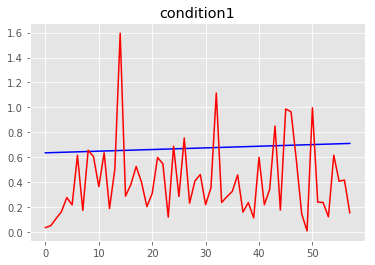

MSE condition1: 0.1576852849619499
R2 condition1: -322.5597202920246


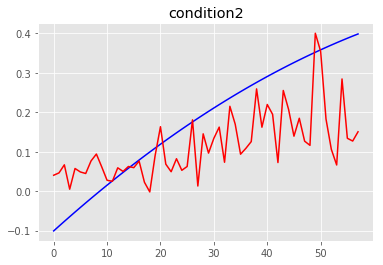

MSE condition2: 0.016860688082164413
R2 condition2: 0.22242885745067853


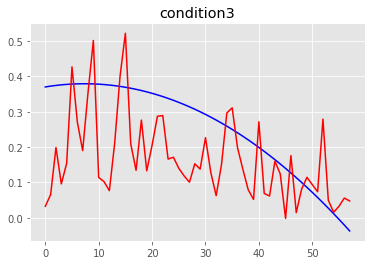

MSE condition3: 0.024050171277005514
R2 condition3: -0.4929047822245298


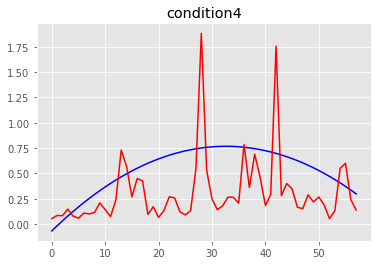

MSE condition4: 0.16365409618935553
R2 condition4: -2.2519862853949393
==== the test person number # 9 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.25082180e-09 4.55981022e-09 3.94105493e-09 3.76226188e-09]
Global min values from training is:  [-4.24113281e-09 -4.56

n_neighbors: 28 weights_type:distance All_MSE: 0.004678018446580278 All_R2: -2.064904652201705
n_neighbors: 29 weights_type:uniform All_MSE: 0.0046401325137614205 All_R2: -2.04008286642307
The best neighbors is: 29 The best weigths :uniform The best mse: 0.0046401325137614205
n_neighbors: 29 weights_type:distance All_MSE: 0.0046478447821099635 All_R2: -2.045135725322709
n_neighbors: 30 weights_type:uniform All_MSE: 0.004520800518993533 All_R2: -1.9618999370274044
The best neighbors is: 30 The best weigths :uniform The best mse: 0.004520800518993533
n_neighbors: 30 weights_type:distance All_MSE: 0.004543542682677863 All_R2: -1.976799955929252
n_neighbors: 31 weights_type:uniform All_MSE: 0.004401066744452841 All_R2: -1.8834537729504537
The best neighbors is: 31 The best weigths :uniform The best mse: 0.004401066744452841
n_neighbors: 31 weights_type:distance All_MSE: 0.004439584351501444 All_R2: -1.9086894137207975
n_neighbors: 32 weights_type:uniform All_MSE: 0.004516632881701152 All_R

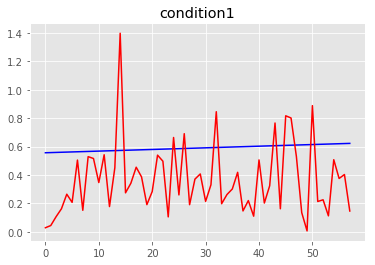

MSE condition1: 0.11409196054235293
R2 condition1: -304.5520613569506


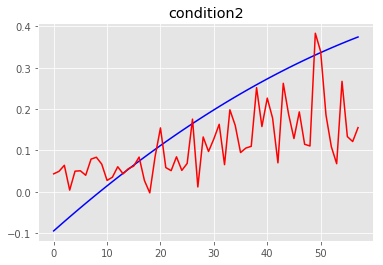

MSE condition2: 0.014378149863048594
R2 condition2: 0.2494398709629626


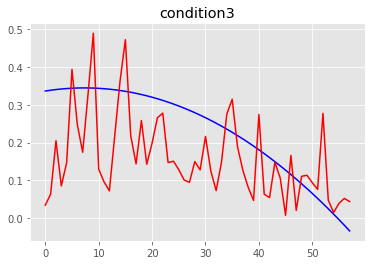

MSE condition3: 0.018974608955855815
R2 condition3: -0.4248241971003264


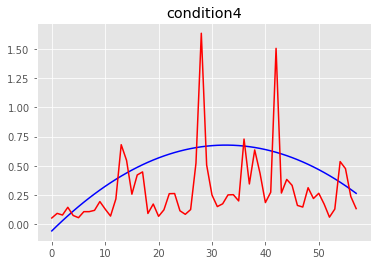

MSE condition4: 0.11773182594943714
R2 condition4: -2.0093943864755253
==== the test person number # 9 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.23915348e-09 4.52339788e-09 3.89178982e-09 3.80377949e-09]
Global min values from training is:  [-4.22839821e-09 -4.53

n_neighbors: 31 weights_type:uniform All_MSE: 0.015427626418619242 All_R2: 0.03993643375117928
n_neighbors: 31 weights_type:distance All_MSE: 0.014981947562253744 All_R2: 0.06767109757007739
n_neighbors: 32 weights_type:uniform All_MSE: 0.01546654417836117 All_R2: 0.0375145755732319
n_neighbors: 32 weights_type:distance All_MSE: 0.015021644126053712 All_R2: 0.065200774295745
n_neighbors: 33 weights_type:uniform All_MSE: 0.01553210936707258 All_R2: 0.03343444378963589
n_neighbors: 33 weights_type:distance All_MSE: 0.01509253834759227 All_R2: 0.060789015979209826
n_neighbors: 34 weights_type:uniform All_MSE: 0.015535000890826729 All_R2: 0.03325450382142725
n_neighbors: 34 weights_type:distance All_MSE: 0.015098980088959596 All_R2: 0.06038814542257609
n_neighbors: 35 weights_type:uniform All_MSE: 0.015548559993439997 All_R2: 0.032410718779139924
n_neighbors: 35 weights_type:distance All_MSE: 0.01511444756880926 All_R2: 0.05942560177118017
n_neighbors: 36 weights_type:uniform All_MSE: 0.01

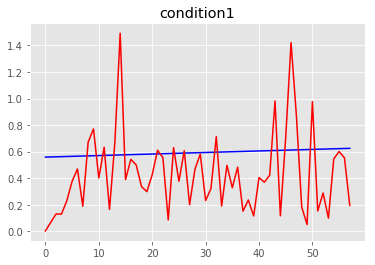

MSE condition1: 0.11601491139716745
R2 condition1: -307.23644014926236


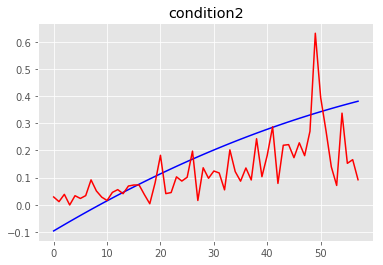

MSE condition2: 0.0140982615119334
R2 condition2: 0.2910132018872962


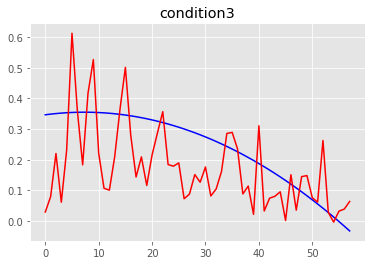

MSE condition3: 0.020594403933494206
R2 condition3: -0.4782891080470528


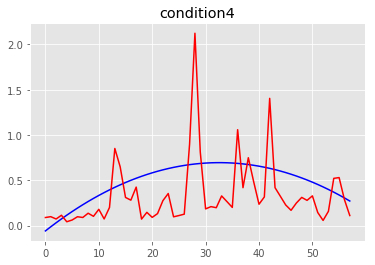

MSE condition4: 0.13958317636006848
R2 condition4: -2.395122121247072
==== the test person number # 9 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.82298474e-09 4.13402385e-09 3.63649069e-09 3.50454928e-09]
Global min values from training is:  [-3.82100504e-09 -4.146

n_neighbors: 38 weights_type:uniform All_MSE: 9.199068784065137 All_R2: -4.920433785587729
n_neighbors: 38 weights_type:distance All_MSE: 8.958355566890678 All_R2: -4.765513032514785
n_neighbors: 39 weights_type:uniform All_MSE: 9.234373149416083 All_R2: -4.943155341683119
n_neighbors: 39 weights_type:distance All_MSE: 8.992655282088968 All_R2: -4.787588005260696
n_neighbors: 40 weights_type:uniform All_MSE: 9.26328529203845 All_R2: -4.961762923603987
n_neighbors: 40 weights_type:distance All_MSE: 9.021627610114667 All_R2: -4.806234321938707
n_neighbors: 41 weights_type:uniform All_MSE: 9.294506317038131 All_R2: -4.981856480415843
n_neighbors: 41 weights_type:distance All_MSE: 9.052180451900155 All_R2: -4.825897842344799
n_neighbors: 42 weights_type:uniform All_MSE: 9.33305918510206 All_R2: -5.006668742175683
n_neighbors: 42 weights_type:distance All_MSE: 9.088707495817035 All_R2: -4.849406302817205
n_neighbors: 43 weights_type:uniform All_MSE: 9.362111502786862 All_R2: -5.025366539442

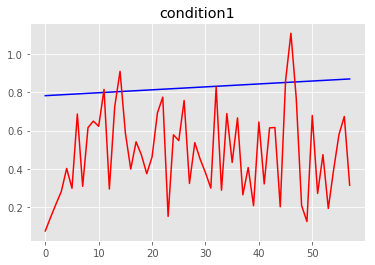

MSE condition1: 0.1665819428503469
R2 condition1: -252.79101533694427


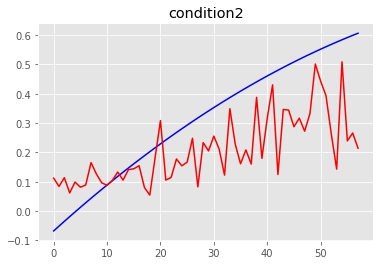

MSE condition2: 0.031232511536240196
R2 condition2: 0.21043035320734382


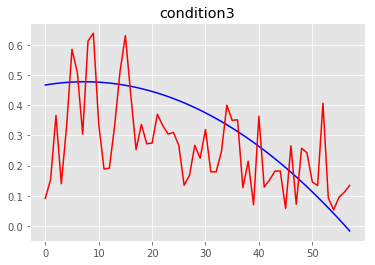

MSE condition3: 0.025141244156795566
R2 condition3: -0.11062253687524337


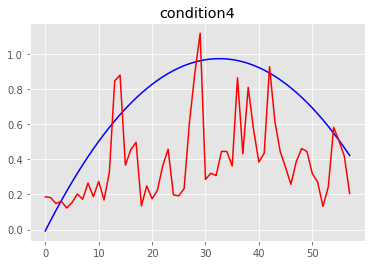

MSE condition4: 0.16255490889843316
R2 condition4: -1.3429528384903957
==== the test person number # 9 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.18017858e-09 4.44499586e-09 3.85126626e-09 3.79342892e-09]
Global min values from training is:  [-4.17147944e-09 -4.45

n_neighbors: 26 weights_type:distance All_MSE: 0.019163164218508996 All_R2: -0.16709142017263834
n_neighbors: 27 weights_type:uniform All_MSE: 0.019647749982670715 All_R2: -0.1966040769156565
n_neighbors: 27 weights_type:distance All_MSE: 0.019136104381934325 All_R2: -0.16544339885750148
n_neighbors: 28 weights_type:uniform All_MSE: 0.019360227569705124 All_R2: -0.17909314096305606
n_neighbors: 28 weights_type:distance All_MSE: 0.018895509513312092 All_R2: -0.15079048435419828
n_neighbors: 29 weights_type:uniform All_MSE: 0.01929027735393313 All_R2: -0.17483297308389822
n_neighbors: 29 weights_type:distance All_MSE: 0.018852210986734043 All_R2: -0.1481534804492508
n_neighbors: 30 weights_type:uniform All_MSE: 0.019295995300143202 All_R2: -0.17518121233534378
n_neighbors: 30 weights_type:distance All_MSE: 0.018864547048829637 All_R2: -0.1489047818557574
n_neighbors: 31 weights_type:uniform All_MSE: 0.01939164014510676 All_R2: -0.18100625650173985
n_neighbors: 31 weights_type:distance Al

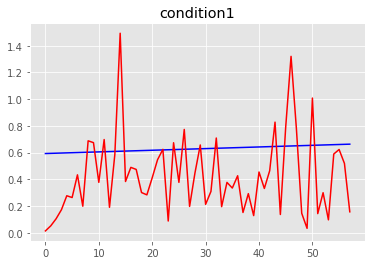

MSE condition1: 0.12784988328714558
R2 condition1: -300.31897506180354


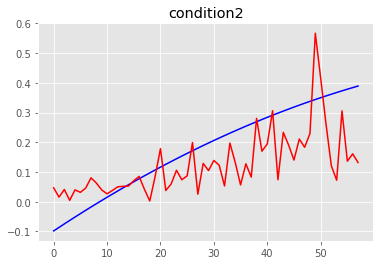

MSE condition2: 0.014757317054047144
R2 condition2: 0.2863046431016848


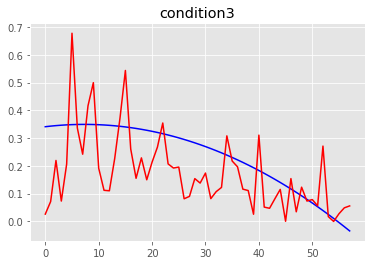

MSE condition3: 0.019761104121495433
R2 condition3: -0.4468289878897307


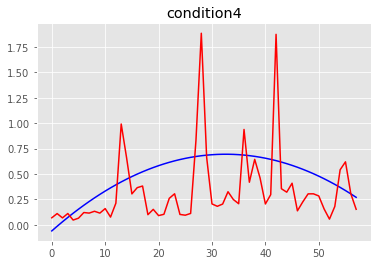

MSE condition4: 0.14674984264737506
R2 condition4: -2.561533153072676
==== the test person number # 9 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.23452963e-09 4.53354195e-09 3.89798842e-09 3.86255094e-09]
Global min values from training is:  [-4.22743802e-09 -4.544

n_neighbors: 23 weights_type:uniform All_MSE: 0.003725425088597444 All_R2: -0.4070914177481473
The best neighbors is: 23 The best weigths :uniform The best mse: 0.003725425088597444
n_neighbors: 23 weights_type:distance All_MSE: 0.0037287216960800377 All_R2: -0.40833654494467586
n_neighbors: 24 weights_type:uniform All_MSE: 0.003695996187658341 All_R2: -0.3959761348044868
The best neighbors is: 24 The best weigths :uniform The best mse: 0.003695996187658341
n_neighbors: 24 weights_type:distance All_MSE: 0.0037000415775354 All_R2: -0.39750407678213584
n_neighbors: 25 weights_type:uniform All_MSE: 0.003692339982163998 All_R2: -0.3945951875970499
The best neighbors is: 25 The best weigths :uniform The best mse: 0.003692339982163998
n_neighbors: 25 weights_type:distance All_MSE: 0.0036925459367629617 All_R2: -0.3946729765585124
n_neighbors: 26 weights_type:uniform All_MSE: 0.0037054432150231344 All_R2: -0.39954427288594174
n_neighbors: 26 weights_type:distance All_MSE: 0.003700397258042922

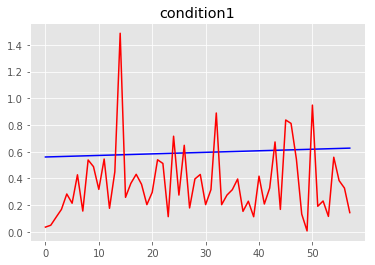

MSE condition1: 0.11979936874355704
R2 condition1: -315.23000499106973


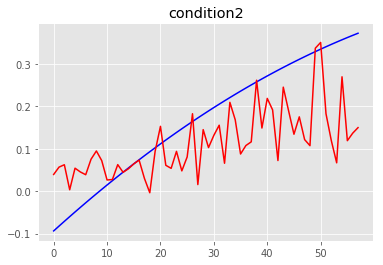

MSE condition2: 0.014035528457501039
R2 condition2: 0.2598455121640587


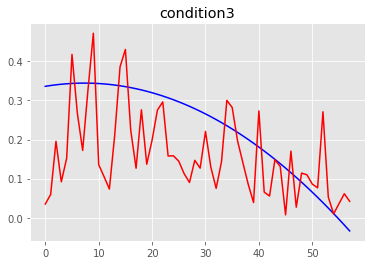

MSE condition3: 0.018258725398880273
R2 condition3: -0.37493895181853554


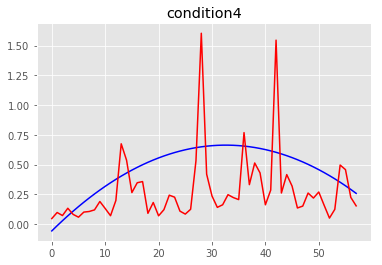

MSE condition4: 0.11772759683015317
R2 condition4: -2.129407526365534
==== the test person number # 9 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.97904517e-09 4.29517726e-09 3.56737857e-09 3.65153522e-09]
Global min values from training is:  [-3.96538492e-09 -4.307

n_neighbors: 24 weights_type:uniform All_MSE: 0.2984852277314229 All_R2: 0.46958067390537583
n_neighbors: 24 weights_type:distance All_MSE: 0.2951787075044524 All_R2: 0.4754564830495591
n_neighbors: 25 weights_type:uniform All_MSE: 0.30164322303861374 All_R2: 0.46396879905521604
n_neighbors: 25 weights_type:distance All_MSE: 0.29723732965605376 All_R2: 0.4717982350932536
n_neighbors: 26 weights_type:uniform All_MSE: 0.3052247210916111 All_R2: 0.45760434411009765
n_neighbors: 26 weights_type:distance All_MSE: 0.29985747073993296 All_R2: 0.4671421471570205
n_neighbors: 27 weights_type:uniform All_MSE: 0.30401560825866997 All_R2: 0.45975298248290875
n_neighbors: 27 weights_type:distance All_MSE: 0.29861991571477414 All_R2: 0.46934132836085696
n_neighbors: 28 weights_type:uniform All_MSE: 0.304138592200876 All_R2: 0.45953443545382733
n_neighbors: 28 weights_type:distance All_MSE: 0.2980330801370575 All_R2: 0.47038415695919844
n_neighbors: 29 weights_type:uniform All_MSE: 0.3060725381308053

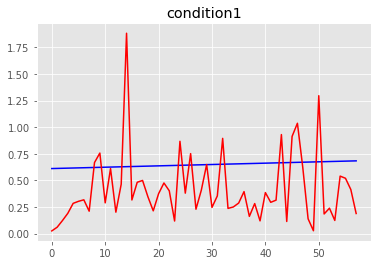

MSE condition1: 0.1599727483189968
R2 condition1: -353.70892208634564


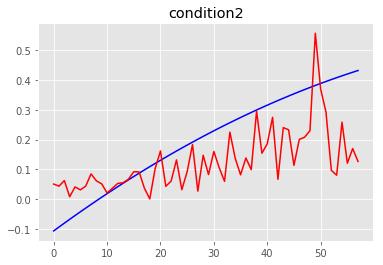

MSE condition2: 0.020155352689424314
R2 condition2: 0.1996665388663763


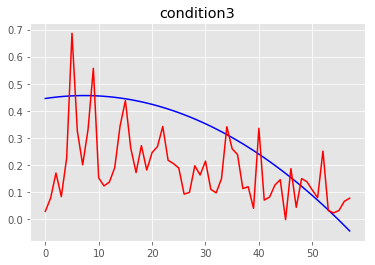

MSE condition3: 0.03686189479520446
R2 condition3: -0.5887280858894914


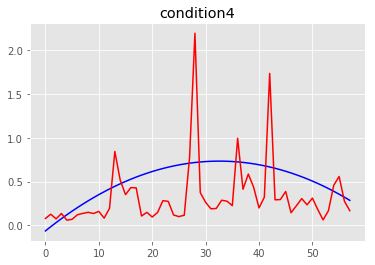

MSE condition4: 0.16340445987178312
R2 condition4: -2.546976162614397
==== the test person number # 9 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.28160350e-09 4.58967486e-09 3.98312051e-09 3.91791941e-09]
Global min values from training is:  [-4.27360096e-09 -4.599

n_neighbors: 26 weights_type:distance All_MSE: 0.002424911122813631 All_R2: 0.21728876830705968
n_neighbors: 27 weights_type:uniform All_MSE: 0.0024664573357830277 All_R2: 0.2038785087641357
n_neighbors: 27 weights_type:distance All_MSE: 0.0024148876231763375 All_R2: 0.2205241469867849
n_neighbors: 28 weights_type:uniform All_MSE: 0.0024581971555322265 All_R2: 0.20654472436159999
n_neighbors: 28 weights_type:distance All_MSE: 0.0024089705958029576 All_R2: 0.22243404122571486
The best neighbors is: 28 The best weigths :distance The best mse: 0.0024089705958029576
n_neighbors: 29 weights_type:uniform All_MSE: 0.002473564499478155 All_R2: 0.20158446309898914
n_neighbors: 29 weights_type:distance All_MSE: 0.0024223398136000132 All_R2: 0.21811873381908176
n_neighbors: 30 weights_type:uniform All_MSE: 0.002438124597389907 All_R2: 0.2130237315957182
n_neighbors: 30 weights_type:distance All_MSE: 0.0023946635672270748 All_R2: 0.22705205458428368
The best neighbors is: 30 The best weigths :dist

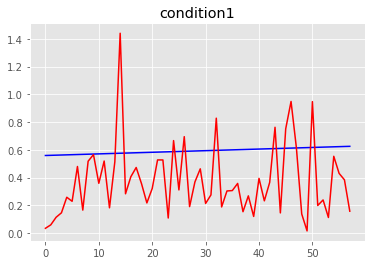

MSE condition1: 0.11428383604237895
R2 condition1: -302.2074955683933


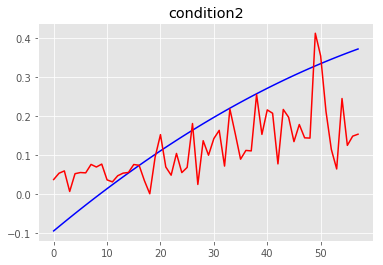

MSE condition2: 0.01336896452487076
R2 condition2: 0.296631589939198


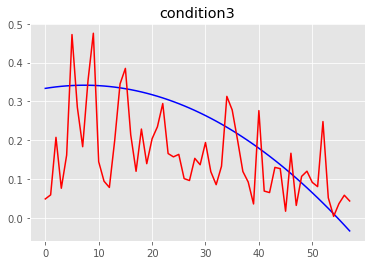

MSE condition3: 0.01772229129478519
R2 condition3: -0.3554284219493218


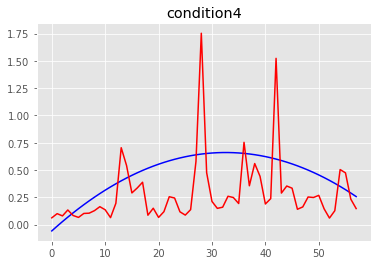

MSE condition4: 0.11987864629908347
R2 condition4: -2.216070862975195
==== the test person number # 10 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.26748806e-09 4.05633511e-09 3.78175176e-09 3.74285703e-09]
Global min values from training is:  [-4.25543456e-09 -4.067

n_neighbors: 26 weights_type:uniform All_MSE: 0.09740581095791068 All_R2: -0.8762021164607678
n_neighbors: 26 weights_type:distance All_MSE: 0.09813535218838308 All_R2: -0.8902543253300021
n_neighbors: 27 weights_type:uniform All_MSE: 0.09412284292832339 All_R2: -0.8129665506889656
The best neighbors is: 27 The best weigths :uniform The best mse: 0.09412284292832339
n_neighbors: 27 weights_type:distance All_MSE: 0.0953956183794199 All_R2: -0.8374823775338183
n_neighbors: 28 weights_type:uniform All_MSE: 0.0939278820932541 All_R2: -0.8092112723561151
The best neighbors is: 28 The best weigths :uniform The best mse: 0.0939278820932541
n_neighbors: 28 weights_type:distance All_MSE: 0.09515429950854139 All_R2: -0.8328341643334802
n_neighbors: 29 weights_type:uniform All_MSE: 0.09277213293034517 All_R2: -0.7869495714963535
The best neighbors is: 29 The best weigths :uniform The best mse: 0.09277213293034517
n_neighbors: 29 weights_type:distance All_MSE: 0.09420145322910906 All_R2: -0.814480

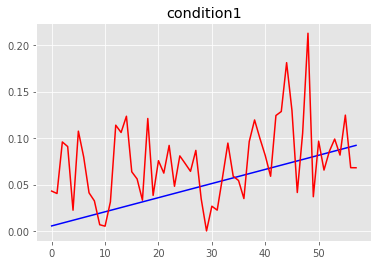

MSE condition1: 0.0022868521697474034
R2 condition1: -2.5353818233486467


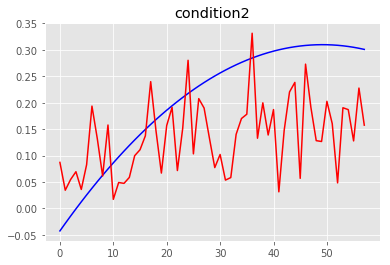

MSE condition2: 0.01470770705024441
R2 condition2: -0.2776509588746292


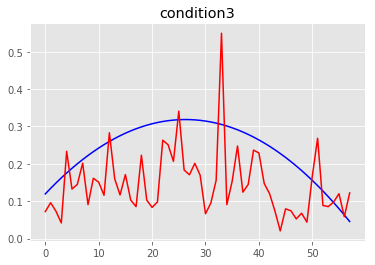

MSE condition3: 0.016523765021281705
R2 condition3: -1.8970542784796947


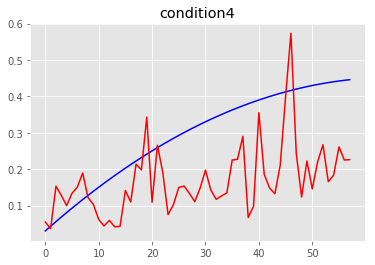

MSE condition4: 0.028170596812837876
R2 condition4: -0.8171355753638736
==== the test person number # 10 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.32292210e-09 4.52755976e-09 3.94341082e-09 3.95794671e-09]
Global min values from training is:  [-4.30775870e-09 -4.5

n_neighbors: 27 weights_type:distance All_MSE: 0.01390254305161457 All_R2: -0.7152072440656843
n_neighbors: 28 weights_type:uniform All_MSE: 0.013947206534864438 All_R2: -0.7207175402561703
n_neighbors: 28 weights_type:distance All_MSE: 0.013906247445986293 All_R2: -0.7156642686573482
n_neighbors: 29 weights_type:uniform All_MSE: 0.013659541791620846 All_R2: -0.6852272957993188
The best neighbors is: 29 The best weigths :uniform The best mse: 0.013659541791620846
n_neighbors: 29 weights_type:distance All_MSE: 0.013670334778134749 All_R2: -0.6865588657563417
n_neighbors: 30 weights_type:uniform All_MSE: 0.013671908932188948 All_R2: -0.6867530748608928
n_neighbors: 30 weights_type:distance All_MSE: 0.013682685241548285 All_R2: -0.6880825872967691
n_neighbors: 31 weights_type:uniform All_MSE: 0.013607818729884575 All_R2: -0.6788460337635931
The best neighbors is: 31 The best weigths :uniform The best mse: 0.013607818729884575
n_neighbors: 31 weights_type:distance All_MSE: 0.01361435534548

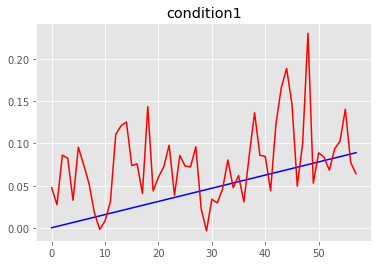

MSE condition1: 0.002897925369817678
R2 condition1: -3.2885695669382145


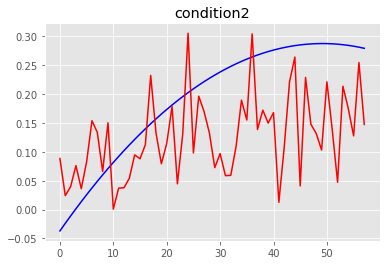

MSE condition2: 0.012922457541765046
R2 condition2: -0.32595544093448336


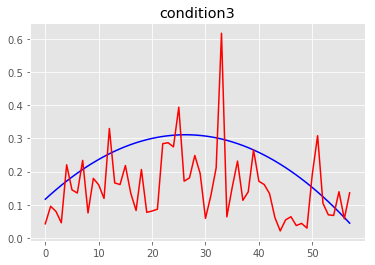

MSE condition3: 0.016332990370032698
R2 condition3: -2.0088657904226337


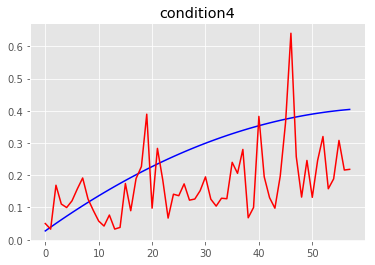

MSE condition4: 0.021539573668583903
R2 condition4: -0.6843867406213733
==== the test person number # 10 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37618561e-09 4.57096406e-09 4.00309898e-09 3.91814952e-09]
Global min values from training is:  [-4.36323090e-09 -4.5

n_neighbors: 28 weights_type:distance All_MSE: 0.004459192224040285 All_R2: -0.3625669254880326
n_neighbors: 29 weights_type:uniform All_MSE: 0.004466624474604069 All_R2: -0.36483795088710735
n_neighbors: 29 weights_type:distance All_MSE: 0.0044356664750592875 All_R2: -0.35537831242802054
n_neighbors: 30 weights_type:uniform All_MSE: 0.00449158566872519 All_R2: -0.37246518376277593
n_neighbors: 30 weights_type:distance All_MSE: 0.0044516269854594295 All_R2: -0.3602552637888292
n_neighbors: 31 weights_type:uniform All_MSE: 0.004477563327343908 All_R2: -0.36818046634668633
n_neighbors: 31 weights_type:distance All_MSE: 0.004441270908730248 All_R2: -0.3570908234776615
n_neighbors: 32 weights_type:uniform All_MSE: 0.004454605699699552 All_R2: -0.3611654504998192
n_neighbors: 32 weights_type:distance All_MSE: 0.004421946562840075 All_R2: -0.35118600636197717
n_neighbors: 33 weights_type:uniform All_MSE: 0.004432243973373714 All_R2: -0.3543325204179677
n_neighbors: 33 weights_type:distance A

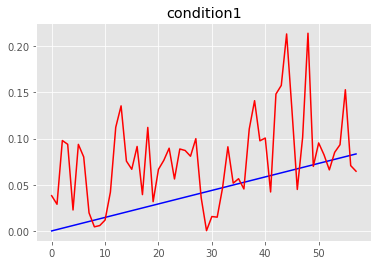

MSE condition1: 0.003128838265002958
R2 condition1: -4.24707349641783


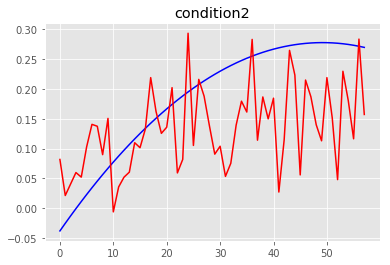

MSE condition2: 0.010543043954318822
R2 condition2: -0.1390127901201923


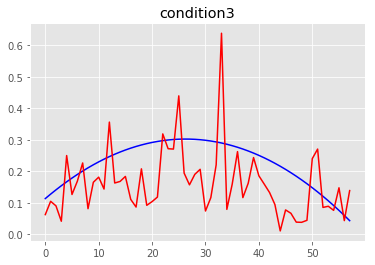

MSE condition3: 0.014806129475659076
R2 condition3: -1.8777165531707247


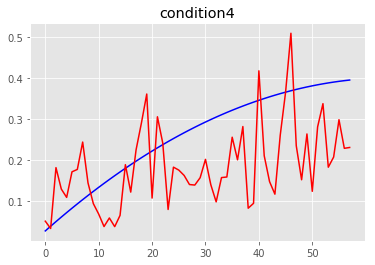

MSE condition4: 0.01724319545121513
R2 condition4: -0.4120358126569852
==== the test person number # 10 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.36415243e-09 4.53223722e-09 3.99598558e-09 3.91543067e-09]
Global min values from training is:  [-4.35246455e-09 -4.54

n_neighbors: 26 weights_type:distance All_MSE: 0.007757218641335952 All_R2: 0.28088783625087943
n_neighbors: 27 weights_type:uniform All_MSE: 0.007835694019873538 All_R2: 0.273612986608189
n_neighbors: 27 weights_type:distance All_MSE: 0.007816159168318492 All_R2: 0.2754239126655532
n_neighbors: 28 weights_type:uniform All_MSE: 0.007931865289693725 All_R2: 0.26469768679152883
n_neighbors: 28 weights_type:distance All_MSE: 0.00789500526943754 All_R2: 0.268114696179535
n_neighbors: 29 weights_type:uniform All_MSE: 0.00791279590649319 All_R2: 0.2664654628526063
n_neighbors: 29 weights_type:distance All_MSE: 0.007876823144360652 All_R2: 0.26980022135423176
n_neighbors: 30 weights_type:uniform All_MSE: 0.007797991076375015 All_R2: 0.2771081369362277
n_neighbors: 30 weights_type:distance All_MSE: 0.007780111113432956 All_R2: 0.27876565098005046
n_neighbors: 31 weights_type:uniform All_MSE: 0.007911223875185912 All_R2: 0.26661119380169085
n_neighbors: 31 weights_type:distance All_MSE: 0.00786

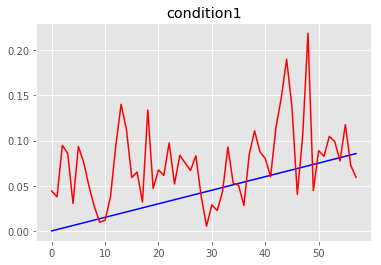

MSE condition1: 0.002690208284794194
R2 condition1: -3.272329006517549


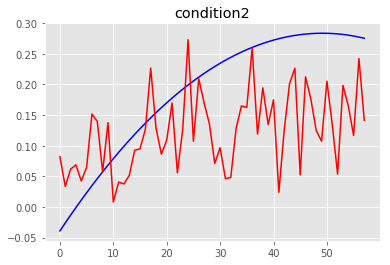

MSE condition2: 0.012213391341989645
R2 condition2: -0.26659017292433584


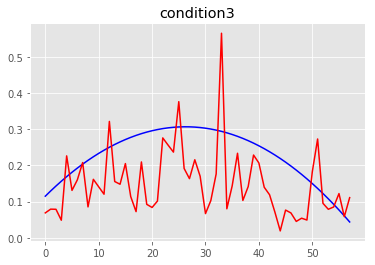

MSE condition3: 0.015091058566541396
R2 condition3: -1.8547360973999005


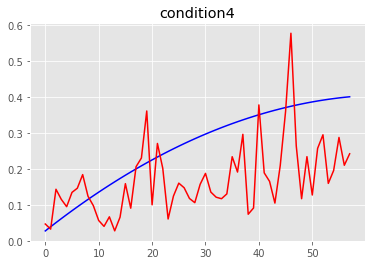

MSE condition4: 0.020144487033234786
R2 condition4: -0.6043713515888394
==== the test person number # 10 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.45036525e-09 4.65305309e-09 3.98186034e-09 3.99971145e-09]
Global min values from training is:  [-4.43627908e-09 -4.6

n_neighbors: 31 weights_type:distance All_MSE: 0.0030069242093537164 All_R2: -3.2763319514417333
n_neighbors: 32 weights_type:uniform All_MSE: 0.0030351931905511927 All_R2: -3.3165350091554684
n_neighbors: 32 weights_type:distance All_MSE: 0.003003547549234751 All_R2: -3.2715297953012588
n_neighbors: 33 weights_type:uniform All_MSE: 0.0030511419271734667 All_R2: -3.3392166889233863
n_neighbors: 33 weights_type:distance All_MSE: 0.0030167031514774898 All_R2: -3.290239186790436
n_neighbors: 34 weights_type:uniform All_MSE: 0.0030524512361850063 All_R2: -3.341078737838002
n_neighbors: 34 weights_type:distance All_MSE: 0.0030194924018071144 All_R2: -3.29420595132279
n_neighbors: 35 weights_type:uniform All_MSE: 0.003046311166459573 All_R2: -3.3323465668477006
n_neighbors: 35 weights_type:distance All_MSE: 0.0030130670855248146 All_R2: -3.2850681136511115
n_neighbors: 36 weights_type:uniform All_MSE: 0.003064631993499797 All_R2: -3.3584017423673345
n_neighbors: 36 weights_type:distance All_

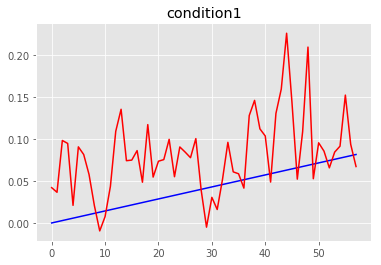

MSE condition1: 0.003429546059099086
R2 condition1: -5.009832753220879


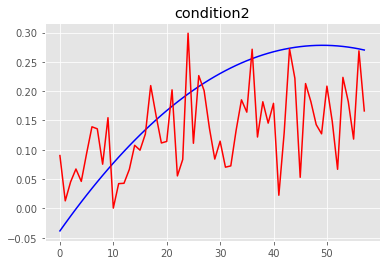

MSE condition2: 0.01027584349637483
R2 condition2: -0.10647982387309596


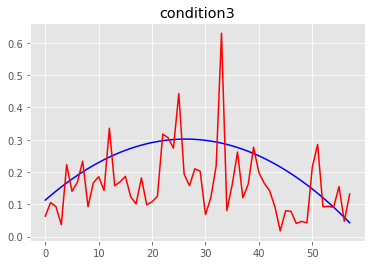

MSE condition3: 0.013952034519407292
R2 condition3: -1.7183342370179413


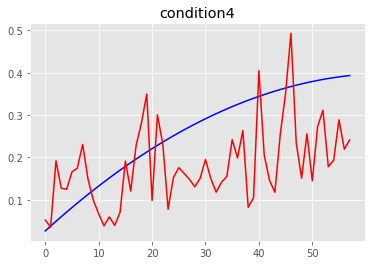

MSE condition4: 0.016959006856736725
R2 condition4: -0.4021859352379158
==== the test person number # 10 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43086748e-09 4.37393040e-09 3.97492183e-09 3.95490830e-09]
Global min values from training is:  [-4.41773053e-09 -4.3

n_neighbors: 29 weights_type:distance All_MSE: 0.005839339177139272 All_R2: -4.560124254410036
n_neighbors: 30 weights_type:uniform All_MSE: 0.00590070931185354 All_R2: -4.618559903405576
n_neighbors: 30 weights_type:distance All_MSE: 0.0059653838606551855 All_R2: -4.680141962012972
n_neighbors: 31 weights_type:uniform All_MSE: 0.005707394955735878 All_R2: -4.434489102315024
The best neighbors is: 31 The best weigths :uniform The best mse: 0.005707394955735878
n_neighbors: 31 weights_type:distance All_MSE: 0.00578864733974303 All_R2: -4.511856307291826
n_neighbors: 32 weights_type:uniform All_MSE: 0.005885313320704239 All_R2: -4.603900089818271
n_neighbors: 32 weights_type:distance All_MSE: 0.005942677395929228 All_R2: -4.658521233806437
n_neighbors: 33 weights_type:uniform All_MSE: 0.005772028794787273 All_R2: -4.49603239775712
n_neighbors: 33 weights_type:distance All_MSE: 0.005840977839925133 All_R2: -4.561684562592875
n_neighbors: 34 weights_type:uniform All_MSE: 0.0059769380834496

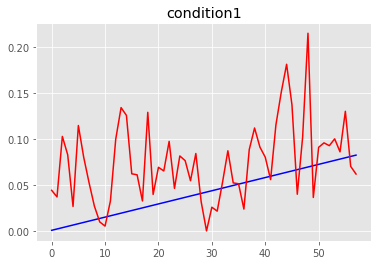

MSE condition1: 0.0028729331240359285
R2 condition1: -3.9660287564926344


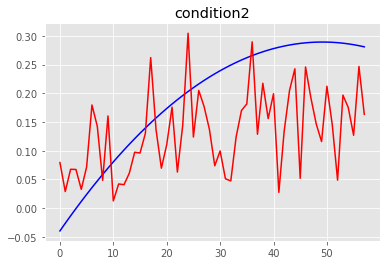

MSE condition2: 0.012250018114162101
R2 condition2: -0.221396654876018


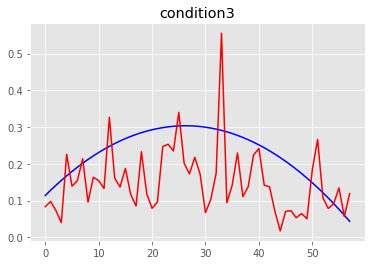

MSE condition3: 0.013926524763886398
R2 condition3: -1.6903882249365862


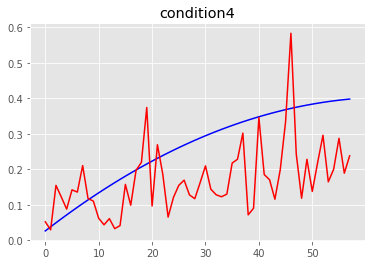

MSE condition4: 0.019698687851997347
R2 condition4: -0.588154341221911
==== the test person number # 10 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43148416e-09 4.64050508e-09 3.99658294e-09 3.97408342e-09]
Global min values from training is:  [-4.41807066e-09 -4.65

n_neighbors: 25 weights_type:uniform All_MSE: 0.0031476934831612133 All_R2: -2.549663691184909
The best neighbors is: 25 The best weigths :uniform The best mse: 0.0031476934831612133
n_neighbors: 25 weights_type:distance All_MSE: 0.0031455254819479426 All_R2: -2.5472188295011526
The best neighbors is: 25 The best weigths :distance The best mse: 0.0031455254819479426
n_neighbors: 26 weights_type:uniform All_MSE: 0.003149135872024687 All_R2: -2.551290277574159
n_neighbors: 26 weights_type:distance All_MSE: 0.003143415577415913 All_R2: -2.54483948362479
The best neighbors is: 26 The best weigths :distance The best mse: 0.003143415577415913
n_neighbors: 27 weights_type:uniform All_MSE: 0.0031367915181478552 All_R2: -2.5373695114696657
The best neighbors is: 27 The best weigths :uniform The best mse: 0.0031367915181478552
n_neighbors: 27 weights_type:distance All_MSE: 0.00313459352649812 All_R2: -2.53489082947781
The best neighbors is: 27 The best weigths :distance The best mse: 0.003134593

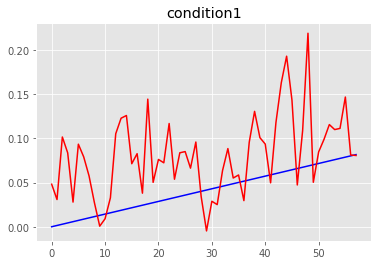

MSE condition1: 0.0033356836478954034
R2 condition1: -4.822281409556237


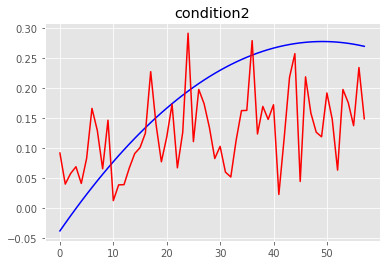

MSE condition2: 0.011183922774636364
R2 condition2: -0.21091670388185713


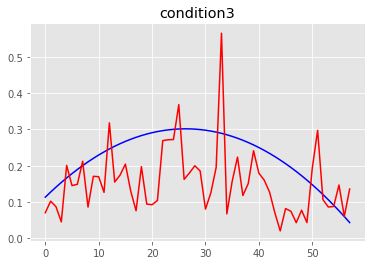

MSE condition3: 0.013691561963752189
R2 condition3: -1.6714236777644982


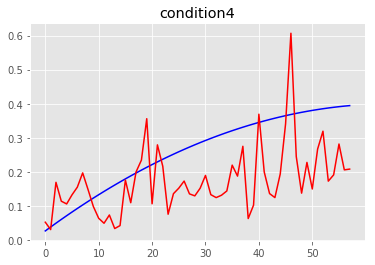

MSE condition4: 0.018827416982084302
R2 condition4: -0.5475937932349635
==== the test person number # 10 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.02702681e-09 4.28997113e-09 3.64075142e-09 3.58800997e-09]
Global min values from training is:  [-4.01720638e-09 -4.2

n_neighbors: 27 weights_type:distance All_MSE: 0.2780421303477296 All_R2: -5.0818080197300235
n_neighbors: 28 weights_type:uniform All_MSE: 0.27088475055636396 All_R2: -4.925249696137333
The best neighbors is: 28 The best weigths :uniform The best mse: 0.27088475055636396
n_neighbors: 28 weights_type:distance All_MSE: 0.2751752100486939 All_R2: -5.019097887115243
n_neighbors: 29 weights_type:uniform All_MSE: 0.26667178722654516 All_R2: -4.833096632376542
The best neighbors is: 29 The best weigths :uniform The best mse: 0.26667178722654516
n_neighbors: 29 weights_type:distance All_MSE: 0.2715618551161523 All_R2: -4.940060472967326
n_neighbors: 30 weights_type:uniform All_MSE: 0.2601001124278147 All_R2: -4.6893498396009585
The best neighbors is: 30 The best weigths :uniform The best mse: 0.2601001124278147
n_neighbors: 30 weights_type:distance All_MSE: 0.2657755497786006 All_R2: -4.81349261016712
n_neighbors: 31 weights_type:uniform All_MSE: 0.25304076048209534 All_R2: -4.534935746945725

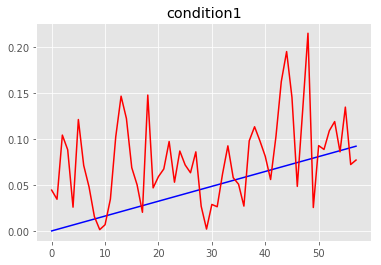

MSE condition1: 0.002963147227299235
R2 condition1: -3.0527290294448948


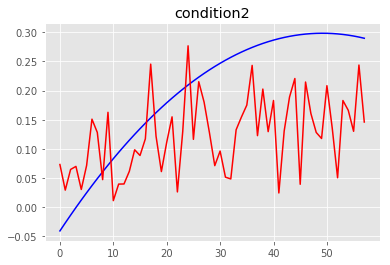

MSE condition2: 0.014617067867059007
R2 condition2: -0.3667915498133729


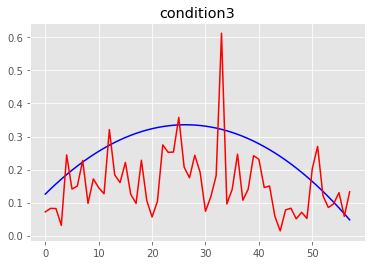

MSE condition3: 0.018440404757477276
R2 condition3: -1.9082068031407373


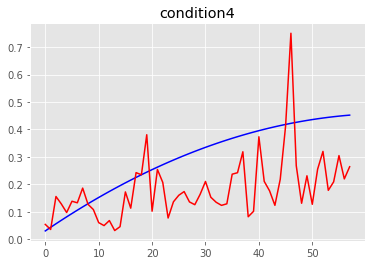

MSE condition4: 0.027901974711314025
R2 condition4: -0.750116193114285
==== the test person number # 10 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40673648e-09 4.61434192e-09 3.97824610e-09 3.86238834e-09]
Global min values from training is:  [-4.39197405e-09 -4.62

n_neighbors: 29 weights_type:distance All_MSE: 0.005006882384676537 All_R2: -2.6708517553388753
n_neighbors: 30 weights_type:uniform All_MSE: 0.004978734638030768 All_R2: -2.650214920429455
The best neighbors is: 30 The best weigths :uniform The best mse: 0.004978734638030768
n_neighbors: 30 weights_type:distance All_MSE: 0.00493139716555039 All_R2: -2.6155089236439664
The best neighbors is: 30 The best weigths :distance The best mse: 0.00493139716555039
n_neighbors: 31 weights_type:uniform All_MSE: 0.004833116370595599 All_R2: -2.543453260866659
The best neighbors is: 31 The best weigths :uniform The best mse: 0.004833116370595599
n_neighbors: 31 weights_type:distance All_MSE: 0.0048086844949157305 All_R2: -2.5255407582682063
The best neighbors is: 31 The best weigths :distance The best mse: 0.0048086844949157305
n_neighbors: 32 weights_type:uniform All_MSE: 0.004834770448556815 All_R2: -2.5446659666026634
n_neighbors: 32 weights_type:distance All_MSE: 0.004807864123325158 All_R2: -2.

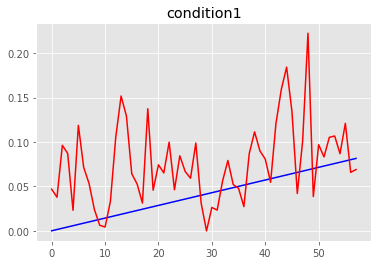

MSE condition1: 0.0031230890829539873
R2 condition1: -4.466747323777675


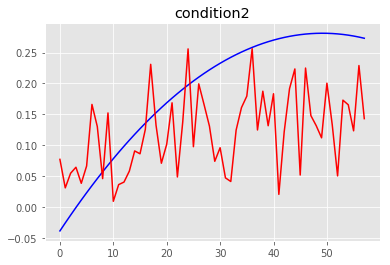

MSE condition2: 0.012212261969300788
R2 condition2: -0.28877532497947556


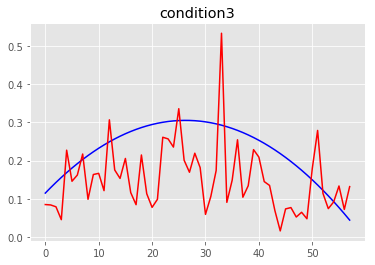

MSE condition3: 0.013992247933601177
R2 condition3: -1.6663731775156103


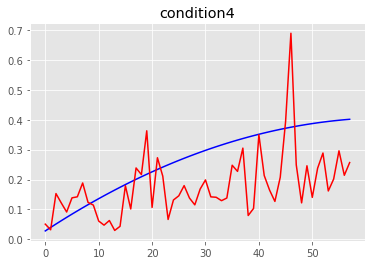

MSE condition4: 0.019769263824799214
R2 condition4: -0.5728713984967733
==== the test person number # 10 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 11, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.23915348e-09 4.52339788e-09 3.89178982e-09 3.80377949e-09]
Global min values from training is:  [-4.22839821e-09 -4.5

n_neighbors: 28 weights_type:distance All_MSE: 0.0729565592829435 All_R2: -0.5138282464858335
n_neighbors: 29 weights_type:uniform All_MSE: 0.07400250272498203 All_R2: -0.535531281036076
n_neighbors: 29 weights_type:distance All_MSE: 0.07292430554807079 All_R2: -0.5131589904876768
n_neighbors: 30 weights_type:uniform All_MSE: 0.07422506701508076 All_R2: -0.5401494279487318
n_neighbors: 30 weights_type:distance All_MSE: 0.0731619694042862 All_R2: -0.5180904491836977
n_neighbors: 31 weights_type:uniform All_MSE: 0.07519276635607987 All_R2: -0.560228919236538
n_neighbors: 31 weights_type:distance All_MSE: 0.07393243617765766 All_R2: -0.5340774197312683
n_neighbors: 32 weights_type:uniform All_MSE: 0.0752397001354224 All_R2: -0.5612027820609555
n_neighbors: 32 weights_type:distance All_MSE: 0.07396562342821655 All_R2: -0.5347660459194143
n_neighbors: 33 weights_type:uniform All_MSE: 0.07479955310963711 All_R2: -0.5520698540995859
n_neighbors: 33 weights_type:distance All_MSE: 0.07362000830

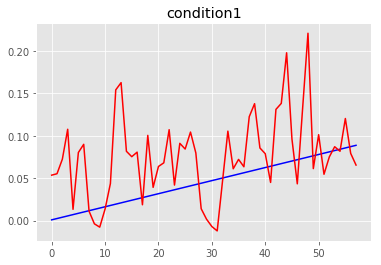

MSE condition1: 0.003168226383256904
R2 condition1: -3.7669073939889017


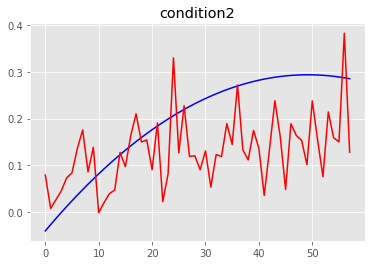

MSE condition2: 0.013413540918753377
R2 condition2: -0.3015562635773734


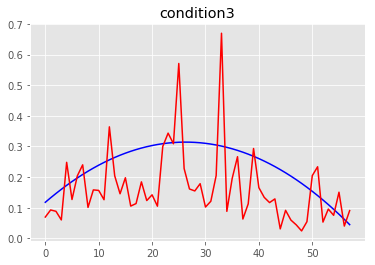

MSE condition3: 0.01683869259412737
R2 condition3: -2.0323670966098817


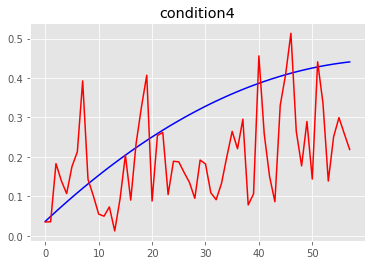

MSE condition4: 0.024810547017557836
R2 condition4: -0.6864411692832184
==== the test person number # 10 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.97889942e-09 4.18855556e-09 3.67368186e-09 3.60467574e-09]
Global min values from training is:  [-3.97184628e-09 -4.2

n_neighbors: 38 weights_type:uniform All_MSE: 8.149775146983096 All_R2: -4.694732029174345
n_neighbors: 38 weights_type:distance All_MSE: 7.945449610228763 All_R2: -4.551957638771208
n_neighbors: 39 weights_type:uniform All_MSE: 8.17355319056558 All_R2: -4.71134716075014
n_neighbors: 39 weights_type:distance All_MSE: 7.969209174225367 All_R2: -4.568559857562578
n_neighbors: 40 weights_type:uniform All_MSE: 8.200869170533085 All_R2: -4.730434458647779
n_neighbors: 40 weights_type:distance All_MSE: 7.995950941537018 All_R2: -4.587245918966709
n_neighbors: 41 weights_type:uniform All_MSE: 8.220127998478954 All_R2: -4.743891745796161
n_neighbors: 41 weights_type:distance All_MSE: 8.01581392597786 All_R2: -4.601125366147792
n_neighbors: 42 weights_type:uniform All_MSE: 8.240131377448115 All_R2: -4.757869294974259
n_neighbors: 42 weights_type:distance All_MSE: 8.036453133319476 All_R2: -4.6155472063808425
n_neighbors: 43 weights_type:uniform All_MSE: 8.269413686189898 All_R2: -4.778330583595

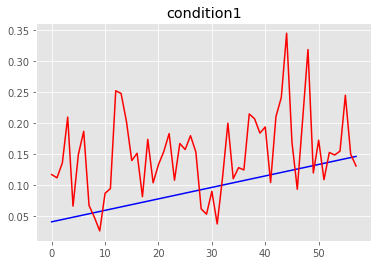

MSE condition1: 0.007084444803534261
R2 condition1: -6.376141068971899


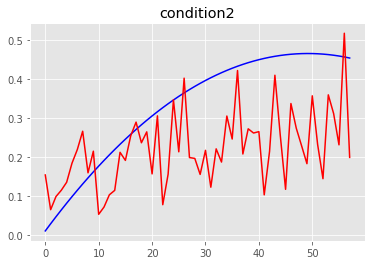

MSE condition2: 0.028158476803742505
R2 condition2: -0.4682320248553957


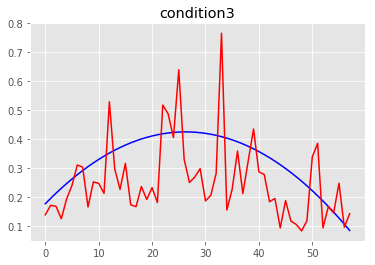

MSE condition3: 0.020327670893397758
R2 condition3: -1.2867571256665173


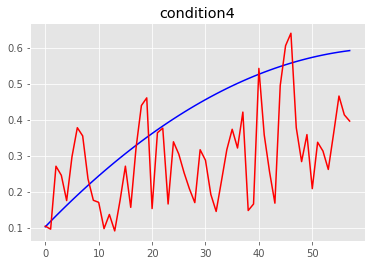

MSE condition4: 0.035594473132627986
R2 condition4: -0.6529071501259365
==== the test person number # 10 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.33609326e-09 4.49952756e-09 3.88845744e-09 3.89355538e-09]
Global min values from training is:  [-4.32232067e-09 -4.5

n_neighbors: 29 weights_type:uniform All_MSE: 0.017606018135271476 All_R2: -0.2489008246728608
n_neighbors: 29 weights_type:distance All_MSE: 0.01727380900061314 All_R2: -0.22533523141657175
n_neighbors: 30 weights_type:uniform All_MSE: 0.01765188845732907 All_R2: -0.2521546826778671
n_neighbors: 30 weights_type:distance All_MSE: 0.017312769231287512 All_R2: -0.22809891505274793
n_neighbors: 31 weights_type:uniform All_MSE: 0.017546579237305134 All_R2: -0.2446844659188565
n_neighbors: 31 weights_type:distance All_MSE: 0.017229301265368337 All_R2: -0.22217802989465607
n_neighbors: 32 weights_type:uniform All_MSE: 0.01738223626702295 All_R2: -0.23302662997107815
n_neighbors: 32 weights_type:distance All_MSE: 0.017081937499174662 All_R2: -0.21172463107885742
The best neighbors is: 32 The best weigths :distance The best mse: 0.017081937499174662
n_neighbors: 33 weights_type:uniform All_MSE: 0.017383486876170886 All_R2: -0.23311534320448501
n_neighbors: 33 weights_type:distance All_MSE: 0.0

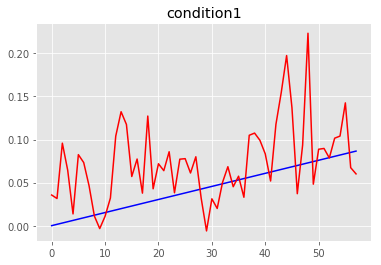

MSE condition1: 0.0026622746986012477
R2 condition1: -3.1385601845608857


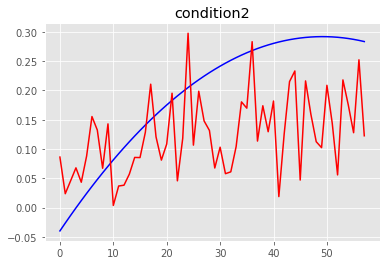

MSE condition2: 0.01364026415257182
R2 condition2: -0.33599827025836615


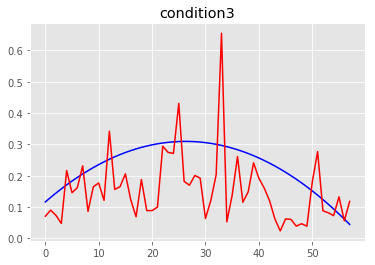

MSE condition3: 0.01656716224566966
R2 condition3: -2.0786641751962156


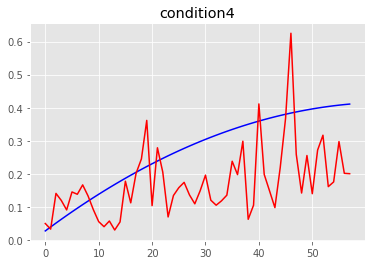

MSE condition4: 0.02177873589641511
R2 condition4: -0.6497033189385386
==== the test person number # 10 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.39044430e-09 4.58807365e-09 3.93517959e-09 3.96267740e-09]
Global min values from training is:  [-4.37827926e-09 -4.59

n_neighbors: 24 weights_type:uniform All_MSE: 0.003754789283000353 All_R2: -0.34376103419441617
n_neighbors: 24 weights_type:distance All_MSE: 0.0037686094025552435 All_R2: -0.3487069677065442
n_neighbors: 25 weights_type:uniform All_MSE: 0.0037588490084365395 All_R2: -0.3452139255391782
n_neighbors: 25 weights_type:distance All_MSE: 0.0037715232446848407 All_R2: -0.3497497712351667
n_neighbors: 26 weights_type:uniform All_MSE: 0.003711708196543843 All_R2: -0.3283432088711373
The best neighbors is: 26 The best weigths :uniform The best mse: 0.003711708196543843
n_neighbors: 26 weights_type:distance All_MSE: 0.003730096722030097 All_R2: -0.3349240799033928
n_neighbors: 27 weights_type:uniform All_MSE: 0.003745630303615255 All_R2: -0.34048322585869806
n_neighbors: 27 weights_type:distance All_MSE: 0.0037548986133028456 All_R2: -0.34380016123704715
n_neighbors: 28 weights_type:uniform All_MSE: 0.0037165065400975093 All_R2: -0.3300604362866111
n_neighbors: 28 weights_type:distance All_MSE:

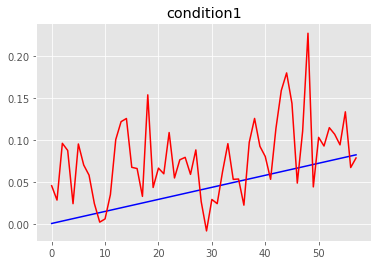

MSE condition1: 0.0030944887783275147
R2 condition1: -4.3442640777518395


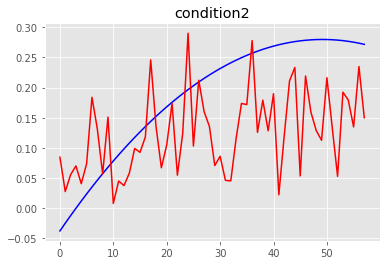

MSE condition2: 0.012024233770051986
R2 condition2: -0.2815873980844057


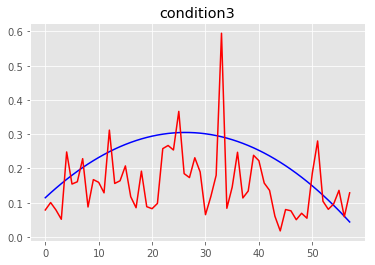

MSE condition3: 0.014475244290911456
R2 condition3: -1.7661571826042324


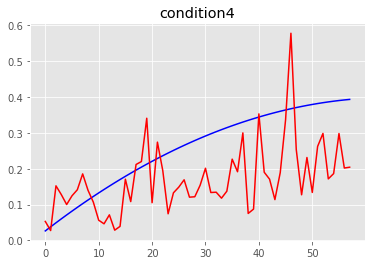

MSE condition4: 0.018635566782850534
R2 condition4: -0.5387228829963522
==== the test person number # 10 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.13495985e-09 4.34970896e-09 3.60456974e-09 3.75166167e-09]
Global min values from training is:  [-4.11622616e-09 -4.3

n_neighbors: 24 weights_type:uniform All_MSE: 0.2757804024286276 All_R2: 0.5114891407032152
n_neighbors: 24 weights_type:distance All_MSE: 0.2713772507709749 All_R2: 0.5192887790420948
n_neighbors: 25 weights_type:uniform All_MSE: 0.2787456698479225 All_R2: 0.5062365363764108
n_neighbors: 25 weights_type:distance All_MSE: 0.2736601271211578 All_R2: 0.5152449460587676
n_neighbors: 26 weights_type:uniform All_MSE: 0.2781194698072159 All_R2: 0.5073457722658479
n_neighbors: 26 weights_type:distance All_MSE: 0.2725338667701066 All_R2: 0.5172399769131675
n_neighbors: 27 weights_type:uniform All_MSE: 0.28028900194763473 All_R2: 0.5035027145255058
n_neighbors: 27 weights_type:distance All_MSE: 0.27412269351784196 All_R2: 0.5144255669225563
n_neighbors: 28 weights_type:uniform All_MSE: 0.28225446626452166 All_R2: 0.5000211376842794
n_neighbors: 28 weights_type:distance All_MSE: 0.27533567001796644 All_R2: 0.5122769291398698
n_neighbors: 29 weights_type:uniform All_MSE: 0.2811957031342816 All_R2

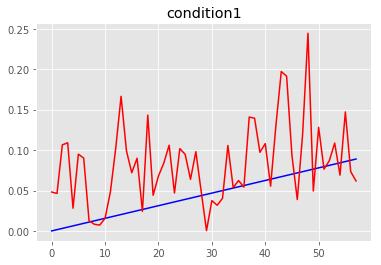

MSE condition1: 0.003719452724067061
R2 condition1: -4.464474206610316


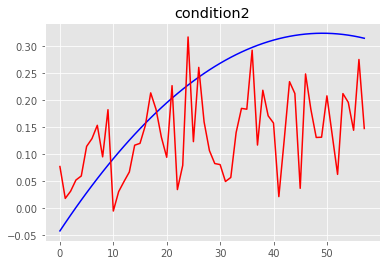

MSE condition2: 0.017540843688528457
R2 condition2: -0.41761629850686033


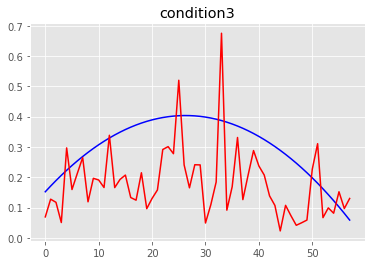

MSE condition3: 0.028209000055451912
R2 condition3: -2.0966527364216647


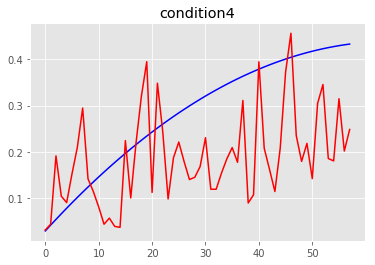

MSE condition4: 0.02307247407888867
R2 condition4: -0.5728162520915223
==== the test person number # 10 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43751818e-09 4.64420657e-09 4.02031168e-09 4.01804586e-09]
Global min values from training is:  [-4.42444219e-09 -4.65

n_neighbors: 23 weights_type:uniform All_MSE: 0.0023685808188167842 All_R2: 0.20898369488619772
n_neighbors: 23 weights_type:distance All_MSE: 0.002298641816449372 All_R2: 0.23234067337581177
n_neighbors: 24 weights_type:uniform All_MSE: 0.002337313462673127 All_R2: 0.2194258078725675
n_neighbors: 24 weights_type:distance All_MSE: 0.002272660880710378 All_R2: 0.2410173221219266
The best neighbors is: 24 The best weigths :distance The best mse: 0.002272660880710378
n_neighbors: 25 weights_type:uniform All_MSE: 0.002317640354542576 All_R2: 0.22599588104883628
n_neighbors: 25 weights_type:distance All_MSE: 0.0022559228627646176 All_R2: 0.2466071863162156
The best neighbors is: 25 The best weigths :distance The best mse: 0.0022559228627646176
n_neighbors: 26 weights_type:uniform All_MSE: 0.0022931816863616754 All_R2: 0.23416415007253177
n_neighbors: 26 weights_type:distance All_MSE: 0.0022371831410229557 All_R2: 0.25286554378208215
The best neighbors is: 26 The best weigths :distance The b

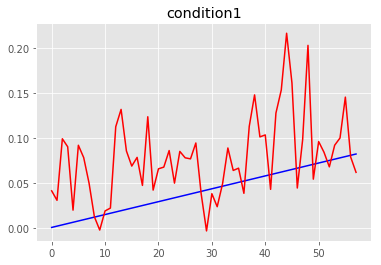

MSE condition1: 0.003134992004639518
R2 condition1: -4.439870036096803


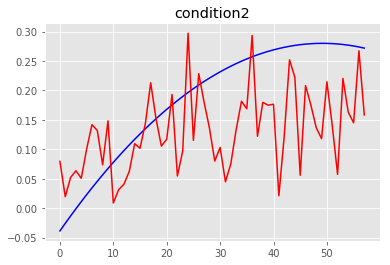

MSE condition2: 0.010766675505733863
R2 condition2: -0.1449514262781897


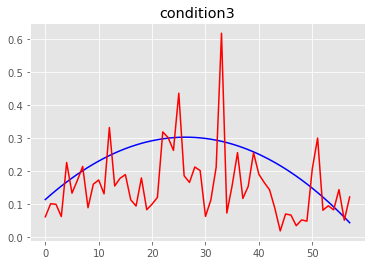

MSE condition3: 0.014527915802286358
R2 condition3: -1.8194192495574963


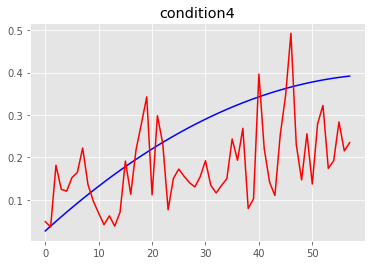

MSE condition4: 0.016991435279972007
R2 condition4: -0.41527969899800743
==== the test person number # 11 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.85131932e-09 3.66696108e-09 3.52645263e-09 3.44362682e-09]
Global min values from training is:  [-3.84804139e-09 -3.

n_neighbors: 33 weights_type:distance All_MSE: 0.10378813645206024 All_R2: -0.1202567673685202
n_neighbors: 34 weights_type:uniform All_MSE: 0.10625814833377993 All_R2: -0.14691730508089385
n_neighbors: 34 weights_type:distance All_MSE: 0.10381488593826822 All_R2: -0.12054549297794437
n_neighbors: 35 weights_type:uniform All_MSE: 0.10645481830564595 All_R2: -0.14904009940452867
n_neighbors: 35 weights_type:distance All_MSE: 0.10399254704013143 All_R2: -0.12246311148872979
n_neighbors: 36 weights_type:uniform All_MSE: 0.10695650591468372 All_R2: -0.15445515895123418
n_neighbors: 36 weights_type:distance All_MSE: 0.10442833937663915 All_R2: -0.12716691802027502
n_neighbors: 37 weights_type:uniform All_MSE: 0.10784659478702988 All_R2: -0.16406250056937544
n_neighbors: 37 weights_type:distance All_MSE: 0.10519086355997274 All_R2: -0.13539736617998543
n_neighbors: 38 weights_type:uniform All_MSE: 0.1081474871455313 All_R2: -0.1673102388213903
n_neighbors: 38 weights_type:distance All_MSE: 0

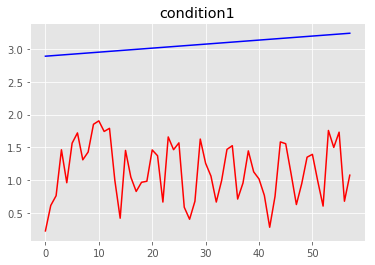

MSE condition1: 3.9098077328847993
R2 condition1: -367.16630902430273


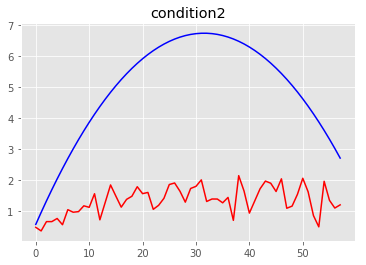

MSE condition2: 15.140466244358167
R2 condition2: -4.355963047542768


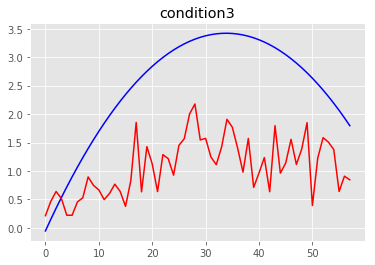

MSE condition3: 2.5051060423911444
R2 condition3: -1.8681836298584673


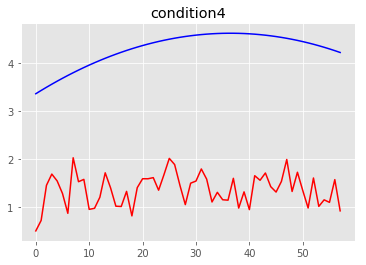

MSE condition4: 8.811270473578993
R2 condition4: -71.89488103341785
==== the test person number # 11 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.90675336e-09 4.13818573e-09 3.68811169e-09 3.65871650e-09]
Global min values from training is:  [-3.90036553e-09 -4.15169

n_neighbors: 25 weights_type:distance All_MSE: 0.020732922297115118 All_R2: -0.38150864886122693
n_neighbors: 26 weights_type:uniform All_MSE: 0.020908292978318532 All_R2: -0.3931942235895378
n_neighbors: 26 weights_type:distance All_MSE: 0.02087440618351755 All_R2: -0.3909362254439386
n_neighbors: 27 weights_type:uniform All_MSE: 0.02087293913177292 All_R2: -0.39083847054742704
n_neighbors: 27 weights_type:distance All_MSE: 0.020843488841232608 All_R2: -0.38887609252324573
n_neighbors: 28 weights_type:uniform All_MSE: 0.020696884992681155 All_R2: -0.37910735457942213
The best neighbors is: 28 The best weigths :uniform The best mse: 0.020696884992681155
n_neighbors: 28 weights_type:distance All_MSE: 0.02068748759950342 All_R2: -0.37848117271437975
The best neighbors is: 28 The best weigths :distance The best mse: 0.02068748759950342
n_neighbors: 29 weights_type:uniform All_MSE: 0.020700617211538673 All_R2: -0.3793560456494611
n_neighbors: 29 weights_type:distance All_MSE: 0.02067958865

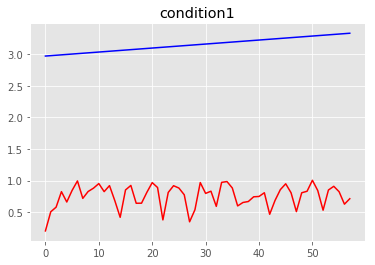

MSE condition1: 5.798600963570076
R2 condition1: -514.4394313131723


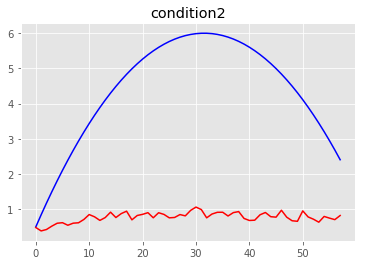

MSE condition2: 15.039072653865007
R2 condition2: -5.737804421356941


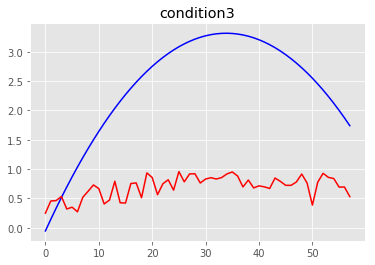

MSE condition3: 3.5441983366545142
R2 condition3: -3.3221506530939227


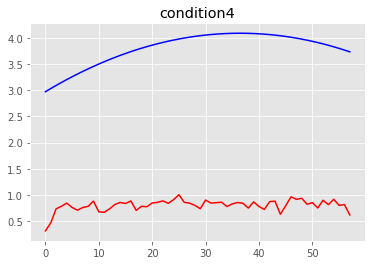

MSE condition4: 9.039308155486266
R2 condition4: -94.88069210799054
==== the test person number # 11 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.96001687e-09 4.18159003e-09 3.74779986e-09 3.61891930e-09]
Global min values from training is:  [-3.95583773e-09 -4.19495

n_neighbors: 30 weights_type:uniform All_MSE: 0.007129413370882606 All_R2: -0.47391025451904967
n_neighbors: 30 weights_type:distance All_MSE: 0.007109256688900513 All_R2: -0.46974313182255645
n_neighbors: 31 weights_type:uniform All_MSE: 0.007117420821757293 All_R2: -0.47143095640374977
n_neighbors: 31 weights_type:distance All_MSE: 0.007097987498307112 All_R2: -0.46741337834752605
The best neighbors is: 31 The best weigths :distance The best mse: 0.007097987498307112
n_neighbors: 32 weights_type:uniform All_MSE: 0.0070396984859036485 All_R2: -0.4553629095869218
The best neighbors is: 32 The best weigths :uniform The best mse: 0.0070396984859036485
n_neighbors: 32 weights_type:distance All_MSE: 0.007025293757147394 All_R2: -0.45238492580018863
The best neighbors is: 32 The best weigths :distance The best mse: 0.007025293757147394
n_neighbors: 33 weights_type:uniform All_MSE: 0.0070364846485146655 All_R2: -0.4546984919641026
n_neighbors: 33 weights_type:distance All_MSE: 0.007022502746

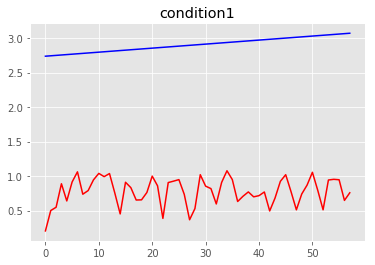

MSE condition1: 4.566724751891977
R2 condition1: -477.261097663736


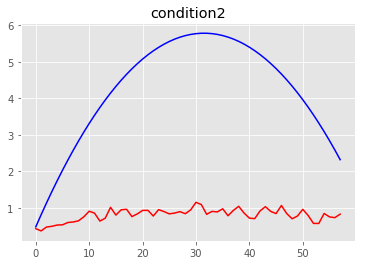

MSE condition2: 13.50858068144031
R2 condition2: -5.500714649679476


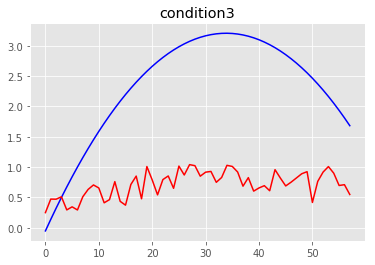

MSE condition3: 3.1623957450172497
R2 condition3: -3.127266606526195


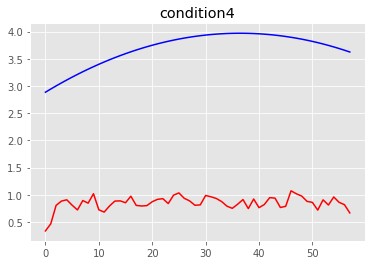

MSE condition4: 8.135189760157832
R2 condition4: -90.49127266072735
==== the test person number # 11 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.94798369e-09 4.14286319e-09 3.74068645e-09 3.61620046e-09]
Global min values from training is:  [-3.94507138e-09 -4.15617

n_neighbors: 23 weights_type:uniform All_MSE: 0.012101222122212858 All_R2: 0.3174052901194785
n_neighbors: 23 weights_type:distance All_MSE: 0.012110637711686916 All_R2: 0.31687418412865453
n_neighbors: 24 weights_type:uniform All_MSE: 0.01214718417869629 All_R2: 0.3148127043216167
n_neighbors: 24 weights_type:distance All_MSE: 0.012140888366293165 All_R2: 0.3151678327704107
n_neighbors: 25 weights_type:uniform All_MSE: 0.012021498368856515 All_R2: 0.3219022749482231
The best neighbors is: 25 The best weigths :uniform The best mse: 0.012021498368856515
n_neighbors: 25 weights_type:distance All_MSE: 0.012031695808177775 All_R2: 0.3213270670837015
n_neighbors: 26 weights_type:uniform All_MSE: 0.012023872613243404 All_R2: 0.32176835073444654
n_neighbors: 26 weights_type:distance All_MSE: 0.01202789993902528 All_R2: 0.32154118101175966
n_neighbors: 27 weights_type:uniform All_MSE: 0.012030007860262515 All_R2: 0.3214222793115141
n_neighbors: 27 weights_type:distance All_MSE: 0.0120288577029

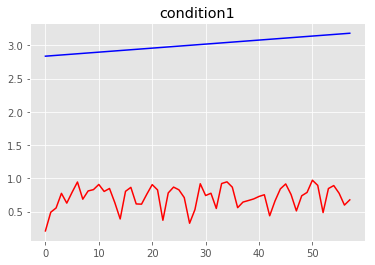

MSE condition1: 5.280103819977123
R2 condition1: -514.0595901023014


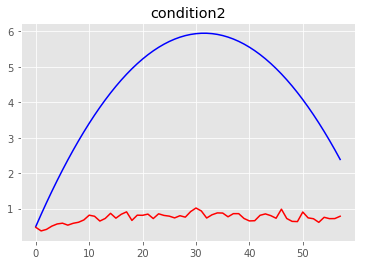

MSE condition2: 15.020306134647292
R2 condition2: -5.829785868433438


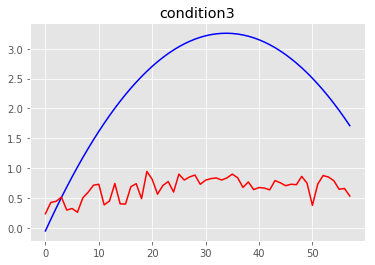

MSE condition3: 3.496039130396888
R2 condition3: -3.4091786677696776


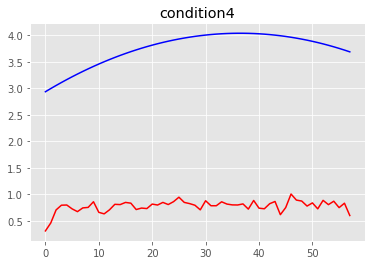

MSE condition4: 8.922378855930624
R2 condition4: -95.86770728168216
==== the test person number # 11 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.03419651e-09 4.26367906e-09 3.72656121e-09 3.70048123e-09]
Global min values from training is:  [-4.02888591e-09 -4.27872

n_neighbors: 29 weights_type:uniform All_MSE: 0.0056154543535570055 All_R2: -6.32413412387102
n_neighbors: 29 weights_type:distance All_MSE: 0.0055522169441901675 All_R2: -6.241654730630921
n_neighbors: 30 weights_type:uniform All_MSE: 0.005607008758989019 All_R2: -6.3131186897712706
n_neighbors: 30 weights_type:distance All_MSE: 0.005543852947340252 All_R2: -6.230745722938319
n_neighbors: 31 weights_type:uniform All_MSE: 0.0056205499003956485 All_R2: -6.330780152158482
n_neighbors: 31 weights_type:distance All_MSE: 0.005553979323447301 All_R2: -6.243953369573324
n_neighbors: 32 weights_type:uniform All_MSE: 0.005596870500406129 All_R2: -6.299895545040953
n_neighbors: 32 weights_type:distance All_MSE: 0.00553325010967982 All_R2: -6.216916636237712
n_neighbors: 33 weights_type:uniform All_MSE: 0.005633828529578668 All_R2: -6.348099224667011
n_neighbors: 33 weights_type:distance All_MSE: 0.005556729056883919 All_R2: -6.247539796463595
n_neighbors: 34 weights_type:uniform All_MSE: 0.00561

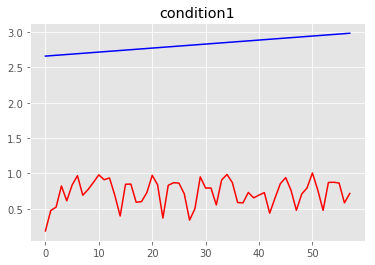

MSE condition1: 4.421571067193259
R2 condition1: -489.1722497538278


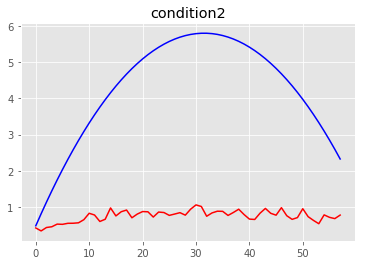

MSE condition2: 13.98484999210138
R2 condition2: -5.699231552077336


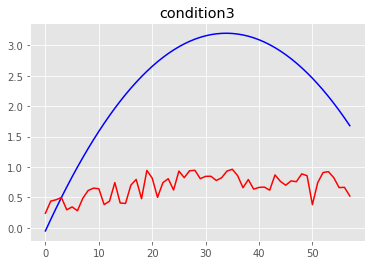

MSE condition3: 3.257947265060621
R2 condition3: -3.265069711703971


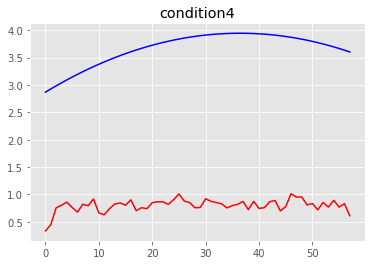

MSE condition4: 8.296517613053014
R2 condition4: -93.44747578206247
==== the test person number # 11 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.01469873e-09 3.98455637e-09 3.71962270e-09 3.65567808e-09]
Global min values from training is:  [-4.01033736e-09 -3.98133

n_neighbors: 26 weights_type:distance All_MSE: 0.008485827198873353 All_R2: -4.921597797554913
n_neighbors: 27 weights_type:uniform All_MSE: 0.008302504315477521 All_R2: -4.793671037191197
The best neighbors is: 27 The best weigths :uniform The best mse: 0.008302504315477521
n_neighbors: 27 weights_type:distance All_MSE: 0.008421469292526906 All_R2: -4.876687427882647
n_neighbors: 28 weights_type:uniform All_MSE: 0.008088294934072485 All_R2: -4.644190995774365
The best neighbors is: 28 The best weigths :uniform The best mse: 0.008088294934072485
n_neighbors: 28 weights_type:distance All_MSE: 0.00822834264668496 All_R2: -4.741919385373053
n_neighbors: 29 weights_type:uniform All_MSE: 0.007991846613536377 All_R2: -4.576887225725841
The best neighbors is: 29 The best weigths :uniform The best mse: 0.007991846613536377
n_neighbors: 29 weights_type:distance All_MSE: 0.008128877786092092 All_R2: -4.672510606992669
n_neighbors: 30 weights_type:uniform All_MSE: 0.00799915093733166 All_R2: -4.5

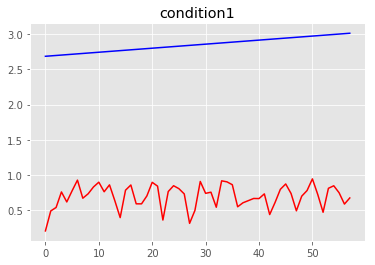

MSE condition1: 4.644339494148076
R2 condition1: -504.85020944958865


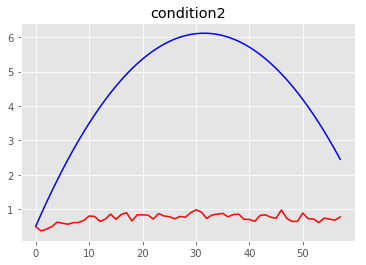

MSE condition2: 16.03645531731804
R2 condition2: -5.901977624854429


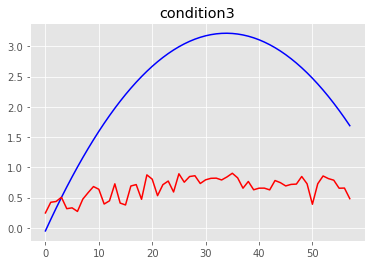

MSE condition3: 3.4122247484490997
R2 condition3: -3.4193543377003452


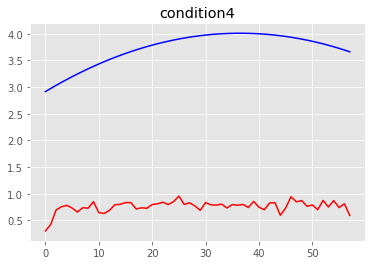

MSE condition4: 8.858731250550704
R2 condition4: -96.67975522160759
==== the test person number # 11 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.01531542e-09 4.25113105e-09 3.74128381e-09 3.67485321e-09]
Global min values from training is:  [-4.01067749e-09 -4.26565

n_neighbors: 28 weights_type:uniform All_MSE: 0.0054857414044529726 All_R2: -4.4987392031354485
The best neighbors is: 28 The best weigths :uniform The best mse: 0.0054857414044529726
n_neighbors: 28 weights_type:distance All_MSE: 0.005520005145905828 All_R2: -4.533084128366517
n_neighbors: 29 weights_type:uniform All_MSE: 0.005486589652674064 All_R2: -4.499589461177783
n_neighbors: 29 weights_type:distance All_MSE: 0.0055145731933308375 All_R2: -4.527639305438949
n_neighbors: 30 weights_type:uniform All_MSE: 0.005505262359855496 All_R2: -4.518306411073354
n_neighbors: 30 weights_type:distance All_MSE: 0.005523980789967193 All_R2: -4.537069192234127
n_neighbors: 31 weights_type:uniform All_MSE: 0.005527901555710815 All_R2: -4.54099924775648
n_neighbors: 31 weights_type:distance All_MSE: 0.005537308587805024 All_R2: -4.550428568671896
n_neighbors: 32 weights_type:uniform All_MSE: 0.00554684715049637 All_R2: -4.559989731830243
n_neighbors: 32 weights_type:distance All_MSE: 0.005552247923

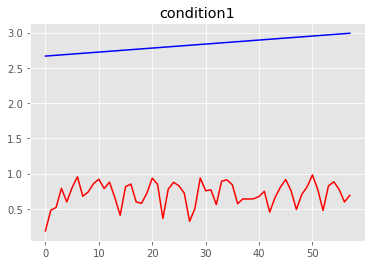

MSE condition1: 4.527924599849969
R2 condition1: -498.4072394140893


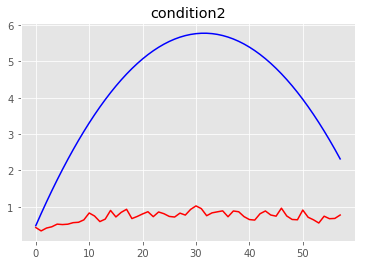

MSE condition2: 14.037443801395339
R2 condition2: -5.775810760622386


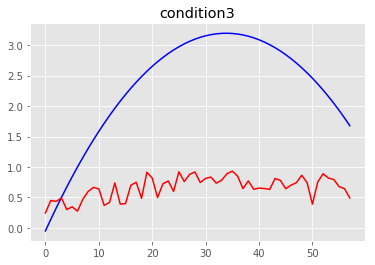

MSE condition3: 3.334550135157081
R2 condition3: -3.373276367625964


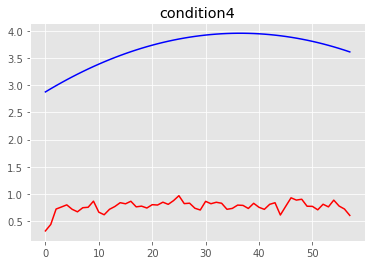

MSE condition4: 8.556668899833225
R2 condition4: -95.69171850764778
==== the test person number # 11 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.61085806e-09 3.90059710e-09 3.38545229e-09 3.28877976e-09]
Global min values from training is:  [-3.60981321e-09 -3.91431

n_neighbors: 27 weights_type:distance All_MSE: 0.0999348400237621 All_R2: -0.19384140114234083
The best neighbors is: 27 The best weigths :distance The best mse: 0.0999348400237621
n_neighbors: 28 weights_type:uniform All_MSE: 0.09967279829195602 All_R2: -0.19071099869027552
The best neighbors is: 28 The best weigths :uniform The best mse: 0.09967279829195602
n_neighbors: 28 weights_type:distance All_MSE: 0.09965451847198771 All_R2: -0.1904926243387639
The best neighbors is: 28 The best weigths :distance The best mse: 0.09965451847198771
n_neighbors: 29 weights_type:uniform All_MSE: 0.09961655777990988 All_R2: -0.1900391383892419
The best neighbors is: 29 The best weigths :uniform The best mse: 0.09961655777990988
n_neighbors: 29 weights_type:distance All_MSE: 0.09959904646648544 All_R2: -0.1898299447691838
The best neighbors is: 29 The best weigths :distance The best mse: 0.09959904646648544
n_neighbors: 30 weights_type:uniform All_MSE: 0.10008560537601498 All_R2: -0.19564247391470424

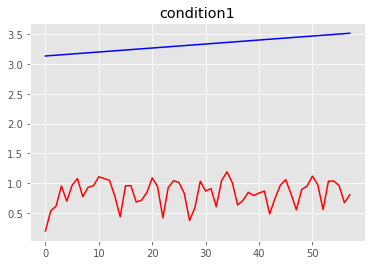

MSE condition1: 6.2108163804574295
R2 condition1: -496.02941945971673


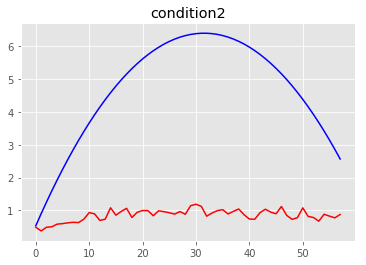

MSE condition2: 16.850163141957474
R2 condition2: -5.623825688611519


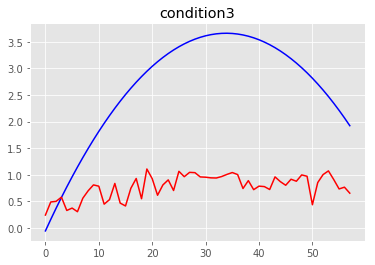

MSE condition3: 4.287516861254655
R2 condition3: -3.2824585565060422


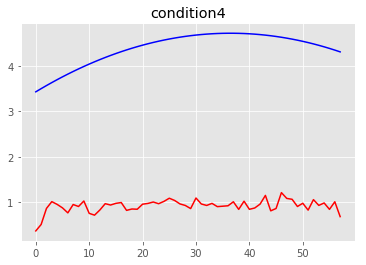

MSE condition4: 12.065642721091669
R2 condition4: -95.21707738777471
==== the test person number # 11 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.99056774e-09 4.22496789e-09 3.72294697e-09 3.56315813e-09]
Global min values from training is:  [-3.98458088e-09 -4.2378

n_neighbors: 28 weights_type:uniform All_MSE: 0.007415848838906969 All_R2: -1.9942057104876971
The best neighbors is: 28 The best weigths :uniform The best mse: 0.007415848838906969
n_neighbors: 28 weights_type:distance All_MSE: 0.007411194332284773 All_R2: -1.9923264178253968
The best neighbors is: 28 The best weigths :distance The best mse: 0.007411194332284773
n_neighbors: 29 weights_type:uniform All_MSE: 0.007366173378849712 All_R2: -1.9741488634017381
The best neighbors is: 29 The best weigths :uniform The best mse: 0.007366173378849712
n_neighbors: 29 weights_type:distance All_MSE: 0.007363274092499094 All_R2: -1.9729782543540164
The best neighbors is: 29 The best weigths :distance The best mse: 0.007363274092499094
n_neighbors: 30 weights_type:uniform All_MSE: 0.007289131710722503 All_R2: -1.9430427004171662
The best neighbors is: 30 The best weigths :uniform The best mse: 0.007289131710722503
n_neighbors: 30 weights_type:distance All_MSE: 0.0072932077683068135 All_R2: -1.944688

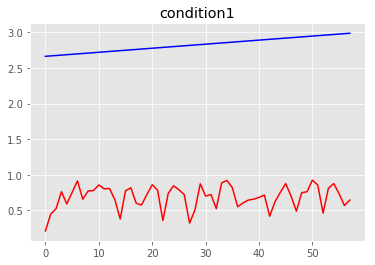

MSE condition1: 4.588780619119779
R2 condition1: -506.982336813633


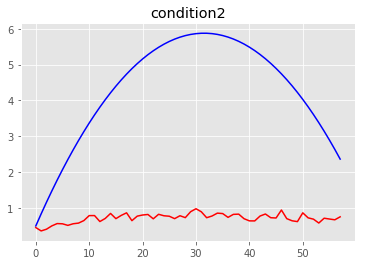

MSE condition2: 14.843769831390137
R2 condition2: -5.915213960438209


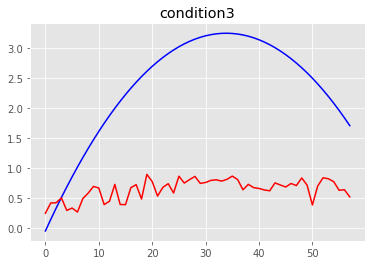

MSE condition3: 3.5402939513894673
R2 condition3: -3.506657798677126


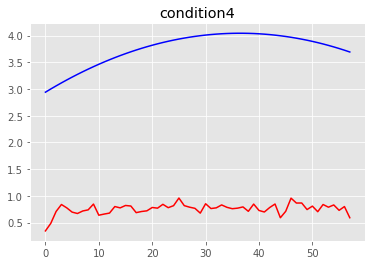

MSE condition4: 9.09353349174158
R2 condition4: -97.5971940980592
==== the test person number # 11 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.82298474e-09 4.13402385e-09 3.63649069e-09 3.50454928e-09]
Global min values from training is:  [-3.82100504e-09 -4.1466429

n_neighbors: 32 weights_type:distance All_MSE: 0.10605958142026228 All_R2: -0.2694357122107365
n_neighbors: 33 weights_type:uniform All_MSE: 0.1091179456594362 All_R2: -0.30604152126792616
n_neighbors: 33 weights_type:distance All_MSE: 0.10613926898877729 All_R2: -0.27038949916649835
n_neighbors: 34 weights_type:uniform All_MSE: 0.10961159219464071 All_R2: -0.31195001659296984
n_neighbors: 34 weights_type:distance All_MSE: 0.10658819913392846 All_R2: -0.2757627804006062
n_neighbors: 35 weights_type:uniform All_MSE: 0.11021428100831555 All_R2: -0.3191636477725721
n_neighbors: 35 weights_type:distance All_MSE: 0.1071230363752963 All_R2: -0.2821642906208124
n_neighbors: 36 weights_type:uniform All_MSE: 0.1109241129060439 All_R2: -0.327659683195078
n_neighbors: 36 weights_type:distance All_MSE: 0.10776261460040935 All_R2: -0.2898194541509578
n_neighbors: 37 weights_type:uniform All_MSE: 0.11113403706268724 All_R2: -0.33017228241270824
n_neighbors: 37 weights_type:distance All_MSE: 0.107993

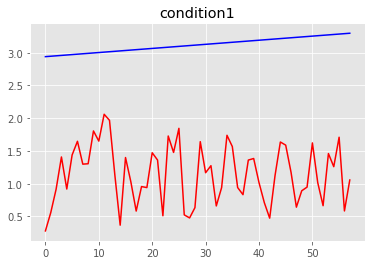

MSE condition1: 4.08396067839547
R2 condition1: -370.06539691190477


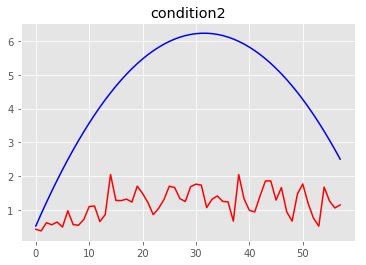

MSE condition2: 13.290580138666865
R2 condition2: -4.505688479475986


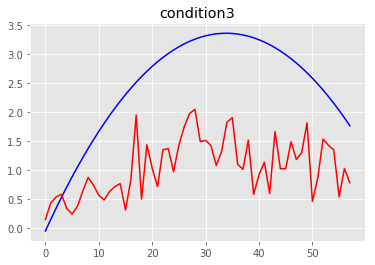

MSE condition3: 2.4452523637656594
R2 condition3: -1.897020689948142


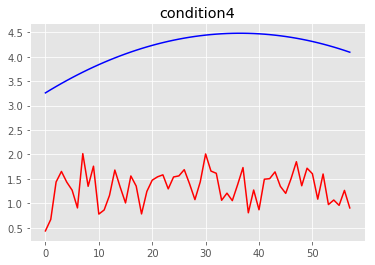

MSE condition4: 8.224636801509316
R2 condition4: -71.85138713142734
==== the test person number # 11 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.97889942e-09 4.18855556e-09 3.67368186e-09 3.60467574e-09]
Global min values from training is:  [-3.97184628e-09 -4.20078

n_neighbors: 30 weights_type:distance All_MSE: 0.022764181708049475 All_R2: 0.14428039350902955
n_neighbors: 31 weights_type:uniform All_MSE: 0.023444891028532814 All_R2: 0.11869211103398825
n_neighbors: 31 weights_type:distance All_MSE: 0.022943763044882923 All_R2: 0.13752982048782136
n_neighbors: 32 weights_type:uniform All_MSE: 0.023368221790369504 All_R2: 0.12157415490239887
n_neighbors: 32 weights_type:distance All_MSE: 0.022885375209830087 All_R2: 0.13972465515730592
n_neighbors: 33 weights_type:uniform All_MSE: 0.023470931451596178 All_R2: 0.11771323549774348
n_neighbors: 33 weights_type:distance All_MSE: 0.022980507131568996 All_R2: 0.13614858764566917
n_neighbors: 34 weights_type:uniform All_MSE: 0.0236672206566659 All_R2: 0.110334603422368
n_neighbors: 34 weights_type:distance All_MSE: 0.023150299493372134 All_R2: 0.12976598822299912
n_neighbors: 35 weights_type:uniform All_MSE: 0.023822269892864595 All_R2: 0.10450620716862713
n_neighbors: 35 weights_type:distance All_MSE: 0.

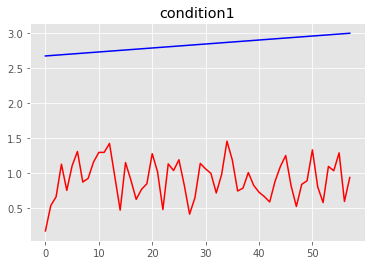

MSE condition1: 3.7815998144295317
R2 condition1: -413.6380988179822


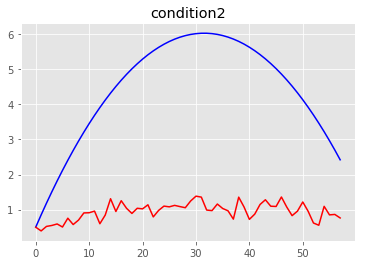

MSE condition2: 13.876666731157734
R2 condition2: -5.1448025340198456


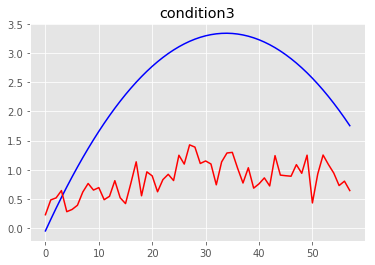

MSE condition3: 3.070650292844212
R2 condition3: -2.6927313679049862


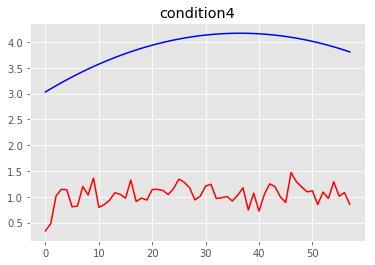

MSE condition4: 8.124978635141288
R2 condition4: -81.97231805726946
==== the test person number # 11 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.91992451e-09 4.11015353e-09 3.63315831e-09 3.59432516e-09]
Global min values from training is:  [-3.91492751e-09 -4.12391

n_neighbors: 23 weights_type:uniform All_MSE: 0.027320219194965776 All_R2: -0.090067415605249
n_neighbors: 23 weights_type:distance All_MSE: 0.02709067955334606 All_R2: -0.08090886229593042
n_neighbors: 24 weights_type:uniform All_MSE: 0.02757890885747408 All_R2: -0.10038904479284283
n_neighbors: 24 weights_type:distance All_MSE: 0.027301320493116125 All_R2: -0.08931336385564426
n_neighbors: 25 weights_type:uniform All_MSE: 0.027388758938575952 All_R2: -0.0928021279679212
n_neighbors: 25 weights_type:distance All_MSE: 0.0271340977032886 All_R2: -0.08264123165067372
n_neighbors: 26 weights_type:uniform All_MSE: 0.02764374782011824 All_R2: -0.10297609725884449
n_neighbors: 26 weights_type:distance All_MSE: 0.027340644048718533 All_R2: -0.09088236029458319
n_neighbors: 27 weights_type:uniform All_MSE: 0.027510884434078897 All_R2: -0.09767489353075898
n_neighbors: 27 weights_type:distance All_MSE: 0.027205429501614174 All_R2: -0.08548734604296104
n_neighbors: 28 weights_type:uniform All_MS

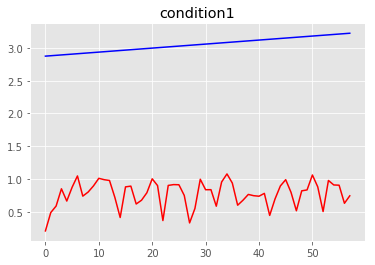

MSE condition1: 5.233980557965003
R2 condition1: -495.4468062996926


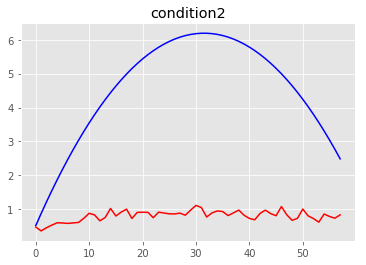

MSE condition2: 16.00680100280166
R2 condition2: -5.718898742095573


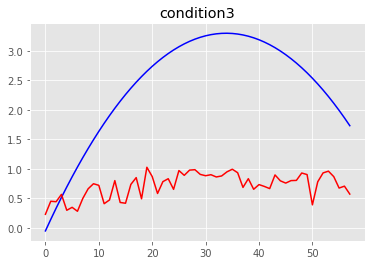

MSE condition3: 3.392005312495358
R2 condition3: -3.182494942950547


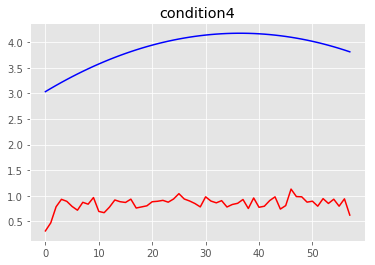

MSE condition4: 9.243923291397518
R2 condition4: -93.14605541092432
==== the test person number # 11 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.97427556e-09 4.19869962e-09 3.67988046e-09 3.66344718e-09]
Global min values from training is:  [-3.97088609e-09 -4.21408

n_neighbors: 22 weights_type:uniform All_MSE: 0.006044049398995937 All_R2: -0.9909704527612384
n_neighbors: 22 weights_type:distance All_MSE: 0.006024832233420796 All_R2: -0.9846401258032416
n_neighbors: 23 weights_type:uniform All_MSE: 0.005924360566218739 All_R2: -0.9515437515790028
The best neighbors is: 23 The best weigths :uniform The best mse: 0.005924360566218739
n_neighbors: 23 weights_type:distance All_MSE: 0.005923564109406757 All_R2: -0.9512813907220883
The best neighbors is: 23 The best weigths :distance The best mse: 0.005923564109406757
n_neighbors: 24 weights_type:uniform All_MSE: 0.005892960837750236 All_R2: -0.9412003662956365
The best neighbors is: 24 The best weigths :uniform The best mse: 0.005892960837750236
n_neighbors: 24 weights_type:distance All_MSE: 0.005895086547755447 All_R2: -0.9419005964777749
n_neighbors: 25 weights_type:uniform All_MSE: 0.005846022682294441 All_R2: -0.925738467417853
The best neighbors is: 25 The best weigths :uniform The best mse: 0.005

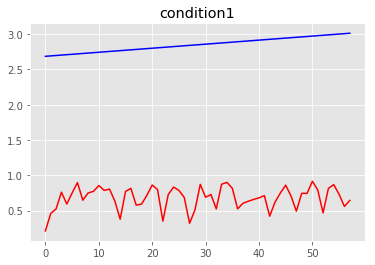

MSE condition1: 4.725366562986236
R2 condition1: -513.0863713945517


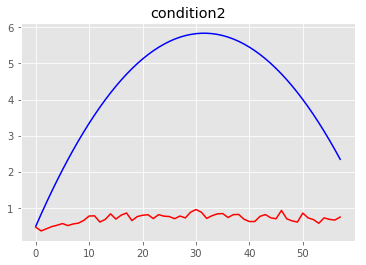

MSE condition2: 14.652026208599423
R2 condition2: -5.920396528555122


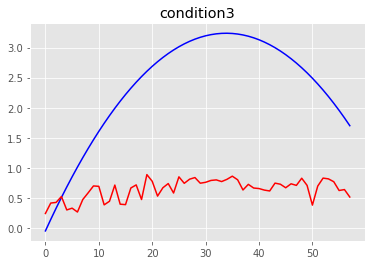

MSE condition3: 3.5345840495253698
R2 condition3: -3.5153714170129247


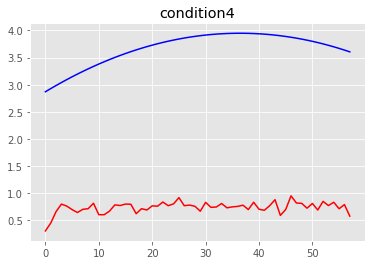

MSE condition4: 8.657778355869786
R2 condition4: -97.39172565257189
==== the test person number # 11 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.71879111e-09 3.96033493e-09 3.34927062e-09 3.45243146e-09]
Global min values from training is:  [-3.70883299e-09 -3.97700

n_neighbors: 37 weights_type:uniform All_MSE: 1.4979121436044627 All_R2: -0.3996598715910893
n_neighbors: 37 weights_type:distance All_MSE: 1.4850981277086752 All_R2: -0.3876863630513254
n_neighbors: 38 weights_type:uniform All_MSE: 1.500171313664863 All_R2: -0.401770856330844
n_neighbors: 38 weights_type:distance All_MSE: 1.4872257653169527 All_R2: -0.3896744429225707
n_neighbors: 39 weights_type:uniform All_MSE: 1.5042891078710228 All_R2: -0.4056185528292269
n_neighbors: 39 weights_type:distance All_MSE: 1.4909817418107858 All_R2: -0.39318405435038617
n_neighbors: 40 weights_type:uniform All_MSE: 1.5060081495843989 All_R2: -0.4072248377599397
n_neighbors: 40 weights_type:distance All_MSE: 1.4927120962545912 All_R2: -0.3948009099777101
n_neighbors: 41 weights_type:uniform All_MSE: 1.5081045124897985 All_R2: -0.4091836943240632
n_neighbors: 41 weights_type:distance All_MSE: 1.4947242865107924 All_R2: -0.39668111501352343
n_neighbors: 42 weights_type:uniform All_MSE: 1.5109476233780466 

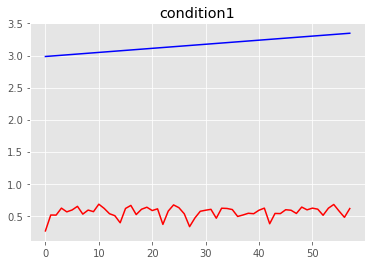

MSE condition1: 6.829891425721048
R2 condition1: -600.294168723307


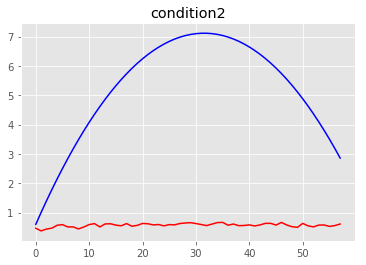

MSE condition2: 24.60371750186667
R2 condition2: -6.835042466110778


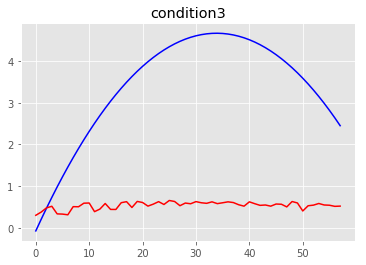

MSE condition3: 9.618804857561543
R2 condition3: -4.916272731736165


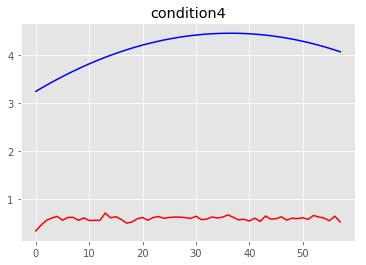

MSE condition4: 12.84892588608757
R2 condition4: -113.23785869369927
==== the test person number # 11 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.02134944e-09 4.25483254e-09 3.76501255e-09 3.71881565e-09]
Global min values from training is:  [-4.01704903e-09 -4.2694

n_neighbors: 25 weights_type:distance All_MSE: 0.004137360205651133 All_R2: 0.13511411568331055
n_neighbors: 26 weights_type:uniform All_MSE: 0.004221260133002833 All_R2: 0.11757542935801357
n_neighbors: 26 weights_type:distance All_MSE: 0.004099176233110528 All_R2: 0.1430962050388367
The best neighbors is: 26 The best weigths :distance The best mse: 0.004099176233110528
n_neighbors: 27 weights_type:uniform All_MSE: 0.004203344559860603 All_R2: 0.12132055319301194
n_neighbors: 27 weights_type:distance All_MSE: 0.004086220530663747 All_R2: 0.14580450298986414
The best neighbors is: 27 The best weigths :distance The best mse: 0.004086220530663747
n_neighbors: 28 weights_type:uniform All_MSE: 0.004152282315124225 All_R2: 0.1319947542533152
n_neighbors: 28 weights_type:distance All_MSE: 0.004040765551195214 All_R2: 0.15530654491034823
The best neighbors is: 28 The best weigths :distance The best mse: 0.004040765551195214
n_neighbors: 29 weights_type:uniform All_MSE: 0.004133251884897866 Al

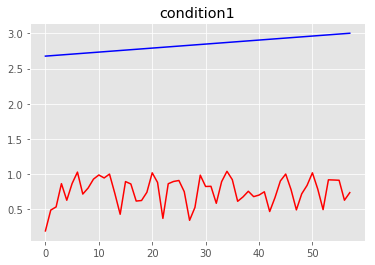

MSE condition1: 4.383795734892946
R2 condition1: -478.84893544467906


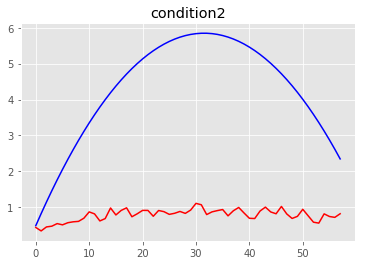

MSE condition2: 14.049004796195742
R2 condition2: -5.614765336372867


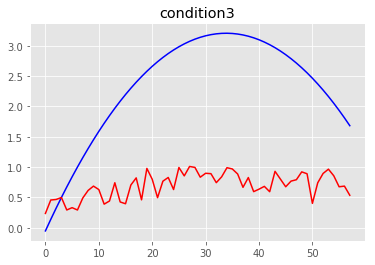

MSE condition3: 3.2264822651964504
R2 condition3: -3.202959584340628


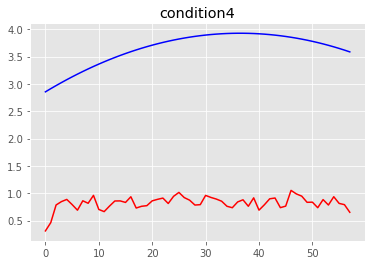

MSE condition4: 8.069772858348731
R2 condition4: -91.72714426660198
==== the test person number # 12 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.20851316e-09 3.97793309e-09 3.74122821e-09 3.73250645e-09]
Global min values from training is:  [-4.19851579e-09 -3.99064

n_neighbors: 28 weights_type:uniform All_MSE: 0.09842181995232464 All_R2: -0.8239695054678173
The best neighbors is: 28 The best weigths :uniform The best mse: 0.09842181995232464
n_neighbors: 28 weights_type:distance All_MSE: 0.09987650420508876 All_R2: -0.8509279555189466
n_neighbors: 29 weights_type:uniform All_MSE: 0.0985446972923015 All_R2: -0.8262466887300182
n_neighbors: 29 weights_type:distance All_MSE: 0.09989170051592645 All_R2: -0.8512095760739922
n_neighbors: 30 weights_type:uniform All_MSE: 0.09786566520099235 All_R2: -0.8136627532939344
The best neighbors is: 30 The best weigths :uniform The best mse: 0.09786566520099235
n_neighbors: 30 weights_type:distance All_MSE: 0.09926803462724576 All_R2: -0.8396516962958587
n_neighbors: 31 weights_type:uniform All_MSE: 0.09603886937636326 All_R2: -0.7798082698221449
The best neighbors is: 31 The best weigths :uniform The best mse: 0.09603886937636326
n_neighbors: 31 weights_type:distance All_MSE: 0.09769138849271447 All_R2: -0.8104

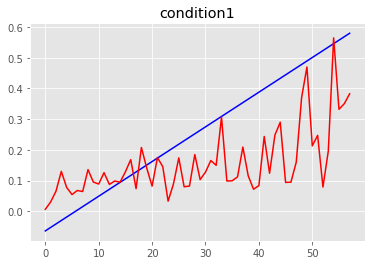

MSE condition1: 0.03160076232732627
R2 condition1: 0.11712827674956228


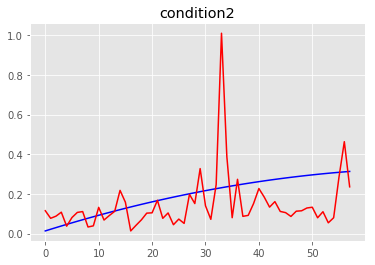

MSE condition2: 0.023951932144334765
R2 condition2: -2.0166254359599955


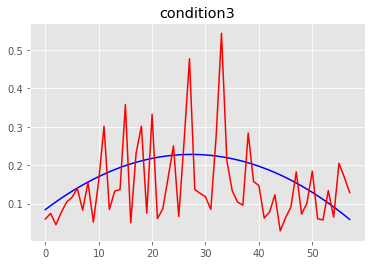

MSE condition3: 0.010357159850702508
R2 condition3: -3.340594082001397


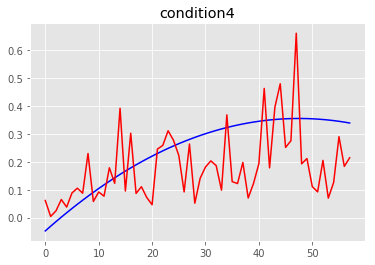

MSE condition4: 0.020521981706591984
R2 condition4: -0.3797939932831511
==== the test person number # 12 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.26394720e-09 4.44915774e-09 3.90288727e-09 3.94759614e-09]
Global min values from training is:  [-4.25083993e-09 -4.4

n_neighbors: 27 weights_type:distance All_MSE: 0.014586762405276727 All_R2: -0.5371460806720683
n_neighbors: 28 weights_type:uniform All_MSE: 0.014602720140501523 All_R2: -0.5388276992160383
n_neighbors: 28 weights_type:distance All_MSE: 0.014659060713451265 All_R2: -0.5447648419819469
n_neighbors: 29 weights_type:uniform All_MSE: 0.014393777517258465 All_R2: -0.5168094250109807
The best neighbors is: 29 The best weigths :uniform The best mse: 0.014393777517258465
n_neighbors: 29 weights_type:distance All_MSE: 0.014479183690639249 All_R2: -0.5258094869184797
n_neighbors: 30 weights_type:uniform All_MSE: 0.014533431398327003 All_R2: -0.5315260845390397
n_neighbors: 30 weights_type:distance All_MSE: 0.014559656502706332 All_R2: -0.5342896735584453
n_neighbors: 31 weights_type:uniform All_MSE: 0.014717140426381146 All_R2: -0.5508852544913347
n_neighbors: 31 weights_type:distance All_MSE: 0.014705774017117406 All_R2: -0.5496874676922057
n_neighbors: 32 weights_type:uniform All_MSE: 0.01480

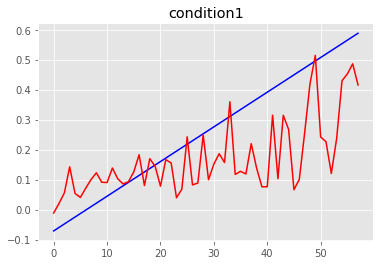

MSE condition1: 0.02819196450161988
R2 condition1: 0.24805842722815719


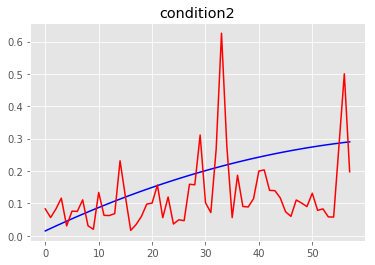

MSE condition2: 0.015660357232086496
R2 condition2: -1.3374702681950033


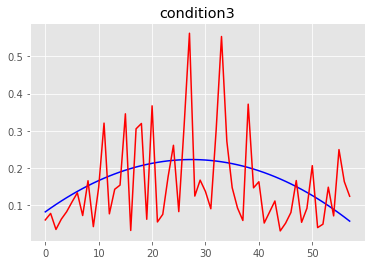

MSE condition3: 0.01290301764339643
R2 condition3: -4.679072835768174


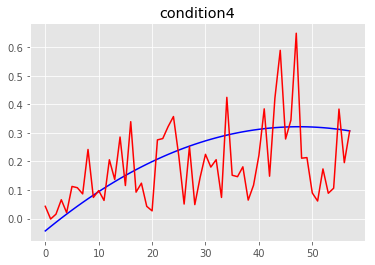

MSE condition4: 0.018347532326923165
R2 condition4: -0.49581131357063235
==== the test person number # 12 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.31721071e-09 4.49256203e-09 3.96257543e-09 3.90779894e-09]
Global min values from training is:  [-4.30631213e-09 -4.

n_neighbors: 27 weights_type:uniform All_MSE: 0.0045939902360902785 All_R2: -0.27419054633769724
n_neighbors: 27 weights_type:distance All_MSE: 0.004579867934772989 All_R2: -0.27027358049618155
n_neighbors: 28 weights_type:uniform All_MSE: 0.004568555248788841 All_R2: -0.2671358904285257
The best neighbors is: 28 The best weigths :uniform The best mse: 0.004568555248788841
n_neighbors: 28 weights_type:distance All_MSE: 0.004558259786772773 All_R2: -0.2642803379138521
The best neighbors is: 28 The best weigths :distance The best mse: 0.004558259786772773
n_neighbors: 29 weights_type:uniform All_MSE: 0.004593237668407882 All_R2: -0.27398181393359766
n_neighbors: 29 weights_type:distance All_MSE: 0.004574400397066458 All_R2: -0.2687571025544835
n_neighbors: 30 weights_type:uniform All_MSE: 0.004599659634273073 All_R2: -0.2757630123632431
n_neighbors: 30 weights_type:distance All_MSE: 0.004577533296665659 All_R2: -0.2696260445519145
n_neighbors: 31 weights_type:uniform All_MSE: 0.004581827

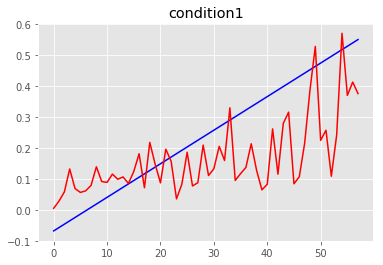

MSE condition1: 0.02381635781387375
R2 condition1: 0.27470235560113465


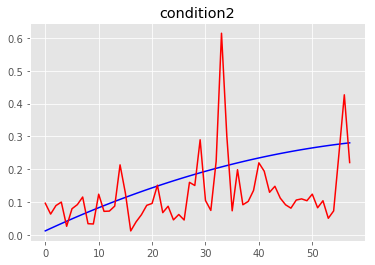

MSE condition2: 0.013102992847951092
R2 condition2: -1.0611859442642708


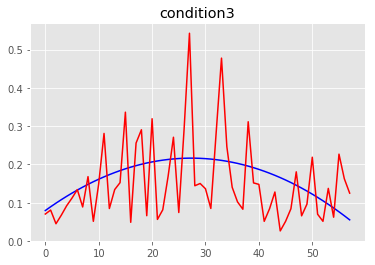

MSE condition3: 0.010084267082727487
R2 condition3: -3.6803275131875566


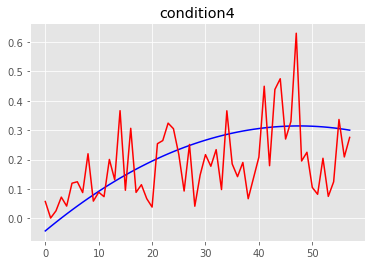

MSE condition4: 0.015441037575586817
R2 condition4: -0.3183154784614399
==== the test person number # 12 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30517753e-09 4.45383519e-09 3.95546202e-09 3.90508009e-09]
Global min values from training is:  [-4.29554578e-09 -4.4

n_neighbors: 24 weights_type:uniform All_MSE: 0.008526664575717123 All_R2: 0.2692550691734752
n_neighbors: 24 weights_type:distance All_MSE: 0.00845647307290157 All_R2: 0.2752705614464602
n_neighbors: 25 weights_type:uniform All_MSE: 0.008507006048187207 All_R2: 0.2709398275232888
n_neighbors: 25 weights_type:distance All_MSE: 0.008446208578245696 All_R2: 0.27615024040775493
n_neighbors: 26 weights_type:uniform All_MSE: 0.008384641050467134 All_R2: 0.28142664813180596
n_neighbors: 26 weights_type:distance All_MSE: 0.008339830137909003 All_R2: 0.2852669947183035
n_neighbors: 27 weights_type:uniform All_MSE: 0.008281673316684612 All_R2: 0.2902511009799401
The best neighbors is: 27 The best weigths :uniform The best mse: 0.008281673316684612
n_neighbors: 27 weights_type:distance All_MSE: 0.008245046116625538 All_R2: 0.2933900940218104
The best neighbors is: 27 The best weigths :distance The best mse: 0.008245046116625538
n_neighbors: 28 weights_type:uniform All_MSE: 0.008184626008138286 A

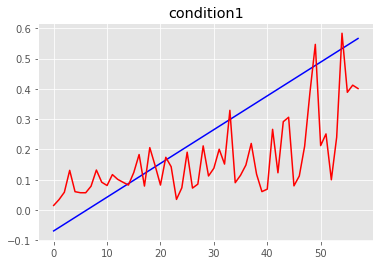

MSE condition1: 0.02635622889202938
R2 condition1: 0.2423479824283422


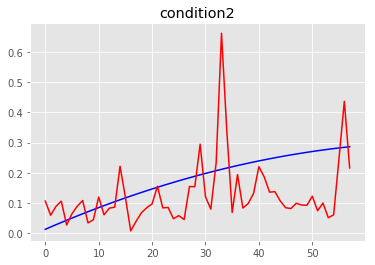

MSE condition2: 0.015088892818999857
R2 condition2: -1.2767014831801178


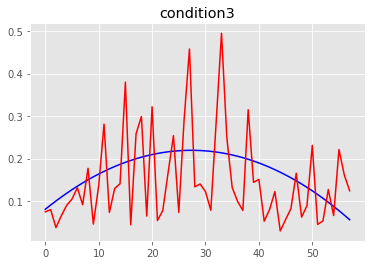

MSE condition3: 0.010194840797354807
R2 condition3: -3.606429300395229


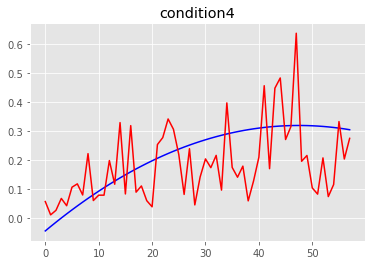

MSE condition4: 0.016346593199661117
R2 condition4: -0.35730847021845946
==== the test person number # 12 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.39139035e-09 4.57465106e-09 3.94133679e-09 3.98936087e-09]
Global min values from training is:  [-4.37936031e-09 -4.

n_neighbors: 31 weights_type:uniform All_MSE: 0.0030454750505326082 All_R2: -3.459178159501853
The best neighbors is: 31 The best weigths :uniform The best mse: 0.0030454750505326082
n_neighbors: 31 weights_type:distance All_MSE: 0.003030341693431267 All_R2: -3.4370199298836397
The best neighbors is: 31 The best weigths :distance The best mse: 0.003030341693431267
n_neighbors: 32 weights_type:uniform All_MSE: 0.0030846768987022486 All_R2: -3.516577423087873
n_neighbors: 32 weights_type:distance All_MSE: 0.0030587249354856686 All_R2: -3.4785786131644985
n_neighbors: 33 weights_type:uniform All_MSE: 0.0030486083625830564 All_R2: -3.463765948411771
n_neighbors: 33 weights_type:distance All_MSE: 0.0030277570735930065 All_R2: -3.433235534956033
The best neighbors is: 33 The best weigths :distance The best mse: 0.0030277570735930065
n_neighbors: 34 weights_type:uniform All_MSE: 0.003034481241934958 All_R2: -3.4430810480906757
n_neighbors: 34 weights_type:distance All_MSE: 0.00301712436688592

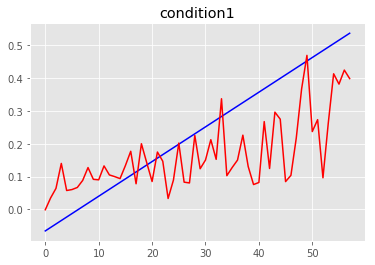

MSE condition1: 0.021331069137173888
R2 condition1: 0.3194728639212471


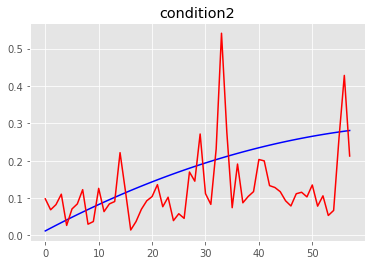

MSE condition2: 0.012093080238644095
R2 condition2: -0.8959207758395584


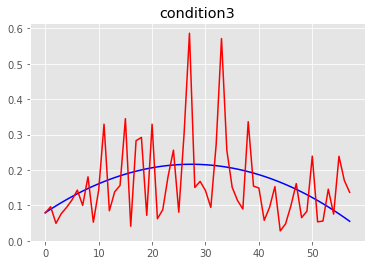

MSE condition3: 0.01188607532347683
R2 condition3: -4.529924344101871


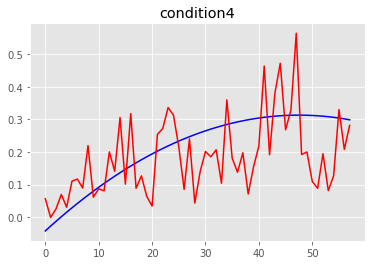

MSE condition4: 0.014085540006172285
R2 condition4: -0.2142212077944814
==== the test person number # 12 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37189258e-09 4.29552838e-09 3.93439827e-09 3.94455772e-09]
Global min values from training is:  [-4.36081176e-09 -4.2

n_neighbors: 28 weights_type:distance All_MSE: 0.0064349260025121586 All_R2: -4.93702972318238
n_neighbors: 29 weights_type:uniform All_MSE: 0.006192928490657158 All_R2: -4.713756538648723
The best neighbors is: 29 The best weigths :uniform The best mse: 0.006192928490657158
n_neighbors: 29 weights_type:distance All_MSE: 0.006272770626909937 All_R2: -4.787420965545018
n_neighbors: 30 weights_type:uniform All_MSE: 0.006120859066681273 All_R2: -4.64726341780935
The best neighbors is: 30 The best weigths :uniform The best mse: 0.006120859066681273
n_neighbors: 30 weights_type:distance All_MSE: 0.0062043455091582884 All_R2: -4.7242901762018
n_neighbors: 31 weights_type:uniform All_MSE: 0.00632441597459575 All_R2: -4.8350703035723805
n_neighbors: 31 weights_type:distance All_MSE: 0.006385709166008224 All_R2: -4.891620992593901
n_neighbors: 32 weights_type:uniform All_MSE: 0.00620971393072092 All_R2: -4.729243221251809
n_neighbors: 32 weights_type:distance All_MSE: 0.006277888448483599 All_R

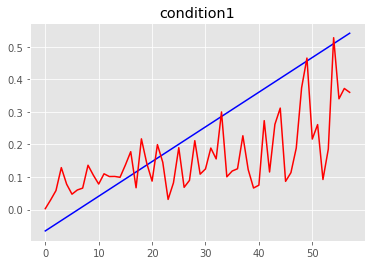

MSE condition1: 0.024289130226020278
R2 condition1: 0.23622916171288832


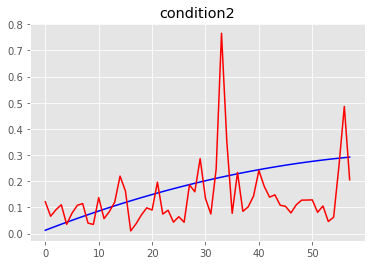

MSE condition2: 0.017019477142602293
R2 condition2: -1.467096334399196


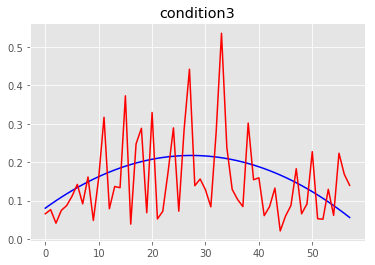

MSE condition3: 0.010350101476717801
R2 condition3: -3.7749327076182


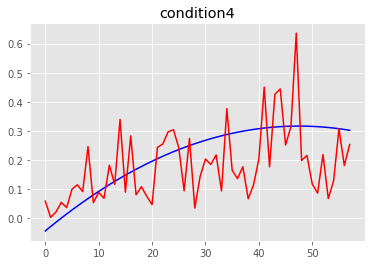

MSE condition4: 0.015493798254310244
R2 condition4: -0.3023308980829875
==== the test person number # 12 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37250926e-09 4.56210305e-09 3.95605939e-09 3.96373285e-09]
Global min values from training is:  [-4.36115189e-09 -4.5

n_neighbors: 26 weights_type:distance All_MSE: 0.0030892664648677673 All_R2: -2.246000159813404
n_neighbors: 27 weights_type:uniform All_MSE: 0.0030766077619415956 All_R2: -2.232699218574221
n_neighbors: 27 weights_type:distance All_MSE: 0.0030894888224422767 All_R2: -2.2462337986822423
n_neighbors: 28 weights_type:uniform All_MSE: 0.0030899631334206515 All_R2: -2.2467321737913877
n_neighbors: 28 weights_type:distance All_MSE: 0.0030985486337388904 All_R2: -2.2557532588036424
n_neighbors: 29 weights_type:uniform All_MSE: 0.003116646368408939 All_R2: -2.2747691806411763
n_neighbors: 29 weights_type:distance All_MSE: 0.003116181077944272 All_R2: -2.274280283700804
n_neighbors: 30 weights_type:uniform All_MSE: 0.0030901196260377383 All_R2: -2.2468966060492876
n_neighbors: 30 weights_type:distance All_MSE: 0.0030921536650390857 All_R2: -2.249033841861907
n_neighbors: 31 weights_type:uniform All_MSE: 0.0030623924499516104 All_R2: -2.217762693830874
The best neighbors is: 31 The best weigths

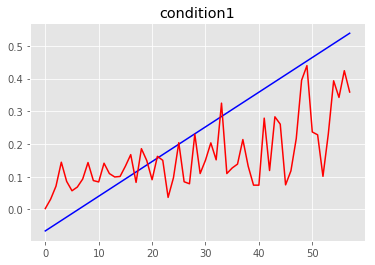

MSE condition1: 0.022951732925793732
R2 condition1: 0.27082298451820475


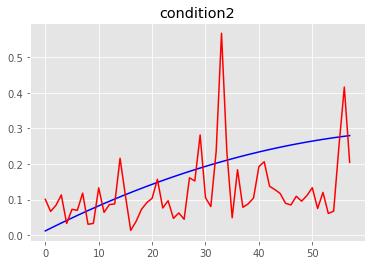

MSE condition2: 0.01250255579630266
R2 condition2: -0.9711554208121178


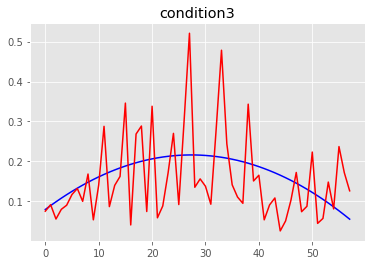

MSE condition3: 0.009968537244041792
R2 condition3: -3.6444115560472


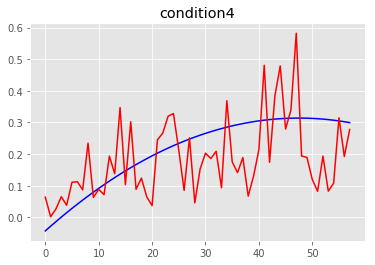

MSE condition4: 0.015102754677816148
R2 condition4: -0.29431197901313166
==== the test person number # 12 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.96805190e-09 4.21156910e-09 3.60022786e-09 3.57765940e-09]
Global min values from training is:  [-3.96028761e-09 -4.

n_neighbors: 29 weights_type:distance All_MSE: 0.2910550211118245 All_R2: -4.917611223770387
n_neighbors: 30 weights_type:uniform All_MSE: 0.2842693541073287 All_R2: -4.779647827457272
The best neighbors is: 30 The best weigths :uniform The best mse: 0.2842693541073287
n_neighbors: 30 weights_type:distance All_MSE: 0.29006101607670687 All_R2: -4.897401521392373
n_neighbors: 31 weights_type:uniform All_MSE: 0.2752900647755947 All_R2: -4.597084602373669
The best neighbors is: 31 The best weigths :uniform The best mse: 0.2752900647755947
n_neighbors: 31 weights_type:distance All_MSE: 0.2822781375704761 All_R2: -4.739163230138097
n_neighbors: 32 weights_type:uniform All_MSE: 0.27076559808675743 All_R2: -4.505095002753768
The best neighbors is: 32 The best weigths :uniform The best mse: 0.27076559808675743
n_neighbors: 32 weights_type:distance All_MSE: 0.2781038991327889 All_R2: -4.654294327567056
n_neighbors: 33 weights_type:uniform All_MSE: 0.2691547860461188 All_R2: -4.472344633512052
Th

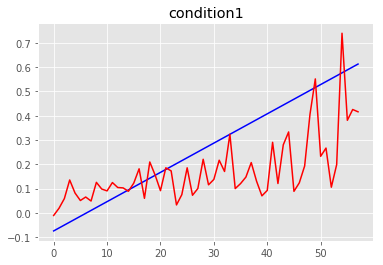

MSE condition1: 0.03288084932500593
R2 condition1: 0.1935208615550187


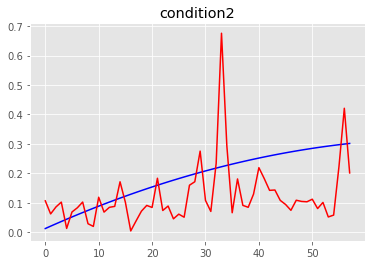

MSE condition2: 0.016326799534069708
R2 condition2: -1.2167241255434416


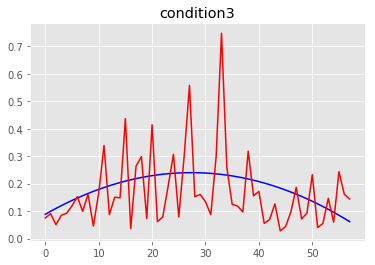

MSE condition3: 0.016161748348449693
R2 condition3: -5.099233326885615


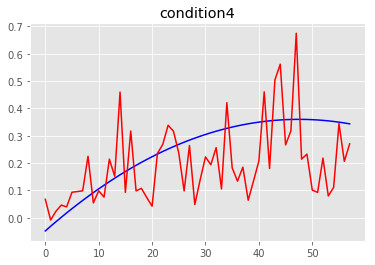

MSE condition4: 0.021542819610314054
R2 condition4: -0.4083941555490722
==== the test person number # 12 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.34776158e-09 4.53593989e-09 3.93772255e-09 3.85203777e-09]
Global min values from training is:  [-4.33505528e-09 -4.5

n_neighbors: 28 weights_type:distance All_MSE: 0.004884711108245546 All_R2: -2.8002997089636796
The best neighbors is: 28 The best weigths :distance The best mse: 0.004884711108245546
n_neighbors: 29 weights_type:uniform All_MSE: 0.004893604822858831 All_R2: -2.807219008858287
n_neighbors: 29 weights_type:distance All_MSE: 0.004853397713765525 All_R2: -2.7759379235290784
The best neighbors is: 29 The best weigths :distance The best mse: 0.004853397713765525
n_neighbors: 30 weights_type:uniform All_MSE: 0.004778419486930028 All_R2: -2.7176049479841047
The best neighbors is: 30 The best weigths :uniform The best mse: 0.004778419486930028
n_neighbors: 30 weights_type:distance All_MSE: 0.004754541094532423 All_R2: -2.699027585747481
The best neighbors is: 30 The best weigths :distance The best mse: 0.004754541094532423
n_neighbors: 31 weights_type:uniform All_MSE: 0.004763215618680575 All_R2: -2.705776355708507
n_neighbors: 31 weights_type:distance All_MSE: 0.004742128234079839 All_R2: -2.

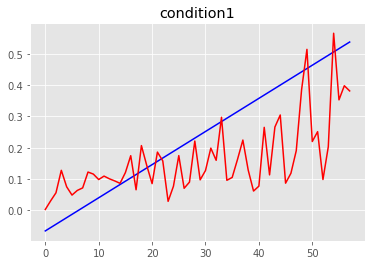

MSE condition1: 0.023082681413491447
R2 condition1: 0.2644527913087348


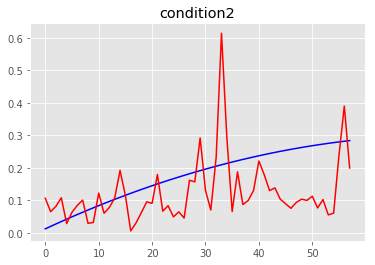

MSE condition2: 0.013750134487256357
R2 condition2: -1.1119364528334041


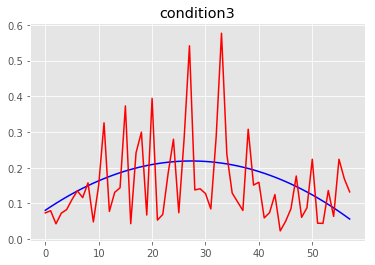

MSE condition3: 0.012325575298080493
R2 condition3: -4.609804986031966


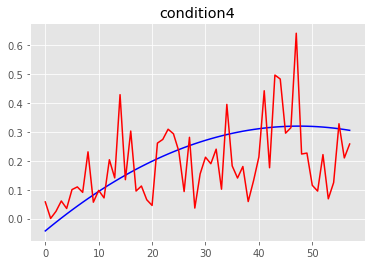

MSE condition4: 0.016475123415061566
R2 condition4: -0.3665752665967208
==== the test person number # 12 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.18017858e-09 4.44499586e-09 3.85126626e-09 3.79342892e-09]
Global min values from training is:  [-4.17147944e-09 -4.4

n_neighbors: 33 weights_type:uniform All_MSE: 0.0806695891832289 All_R2: -0.5351391941329162
n_neighbors: 33 weights_type:distance All_MSE: 0.07924642201314988 All_R2: -0.5080563773650115
n_neighbors: 34 weights_type:uniform All_MSE: 0.08059849836169743 All_R2: -0.5337863385205217
n_neighbors: 34 weights_type:distance All_MSE: 0.07920463867390283 All_R2: -0.5072612420186022
n_neighbors: 35 weights_type:uniform All_MSE: 0.08089503774192303 All_R2: -0.5394294715747165
n_neighbors: 35 weights_type:distance All_MSE: 0.07942943927047695 All_R2: -0.511539188766063
n_neighbors: 36 weights_type:uniform All_MSE: 0.08040311297587842 All_R2: -0.5300681621077192
n_neighbors: 36 weights_type:distance All_MSE: 0.0790414150501159 All_R2: -0.5041551027061211
n_neighbors: 37 weights_type:uniform All_MSE: 0.08028038093760578 All_R2: -0.5277325761175615
n_neighbors: 37 weights_type:distance All_MSE: 0.07900112132427385 All_R2: -0.5033883146457867
n_neighbors: 38 weights_type:uniform All_MSE: 0.0801643110

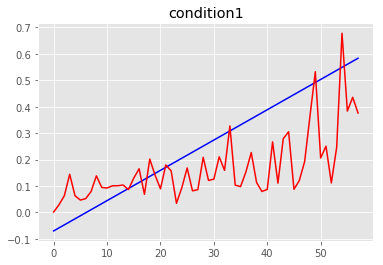

MSE condition1: 0.0287942808111506
R2 condition1: 0.21836049594054552


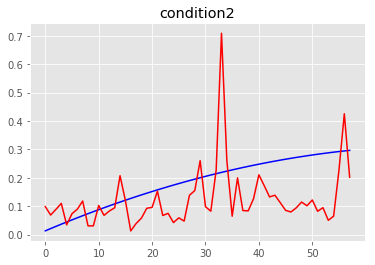

MSE condition2: 0.01656259340116188
R2 condition2: -1.3352671691833482


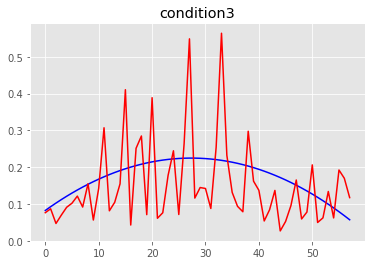

MSE condition3: 0.011966287480380509
R2 condition3: -4.149658920342732


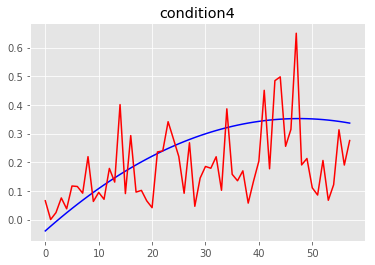

MSE condition4: 0.02026066053813211
R2 condition4: -0.4355479044572703
==== the test person number # 12 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.33609326e-09 4.49952756e-09 3.88845744e-09 3.89355538e-09]
Global min values from training is:  [-4.32232067e-09 -4.50

n_neighbors: 28 weights_type:uniform All_MSE: 0.013678435249172888 All_R2: 0.06554904465885225
n_neighbors: 28 weights_type:distance All_MSE: 0.013413135991450697 All_R2: 0.08367313124578768
n_neighbors: 29 weights_type:uniform All_MSE: 0.013813641547181163 All_R2: 0.05631234089556081
n_neighbors: 29 weights_type:distance All_MSE: 0.013513327629866474 All_R2: 0.07682847609852006
n_neighbors: 30 weights_type:uniform All_MSE: 0.013825919727817325 All_R2: 0.05547354921973624
n_neighbors: 30 weights_type:distance All_MSE: 0.013530325851456703 All_R2: 0.07566723183960167
n_neighbors: 31 weights_type:uniform All_MSE: 0.014050426270540485 All_R2: 0.040136242758408214
n_neighbors: 31 weights_type:distance All_MSE: 0.01369592782329448 All_R2: 0.06435402839408721
n_neighbors: 32 weights_type:uniform All_MSE: 0.014140439710720596 All_R2: 0.03398691766108508
n_neighbors: 32 weights_type:distance All_MSE: 0.013770689302482946 All_R2: 0.05924665065842083
n_neighbors: 33 weights_type:uniform All_MSE:

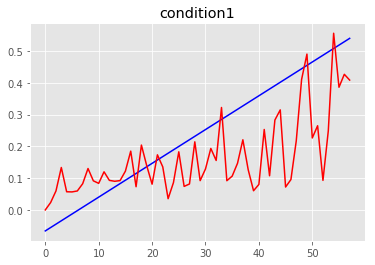

MSE condition1: 0.022658926319676698
R2 condition1: 0.283593503098893


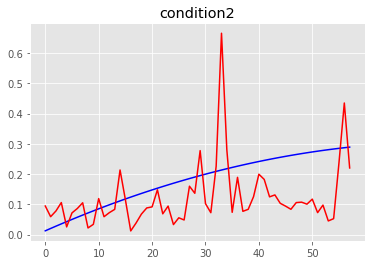

MSE condition2: 0.015382433218708365
R2 condition2: -1.2764808509581282


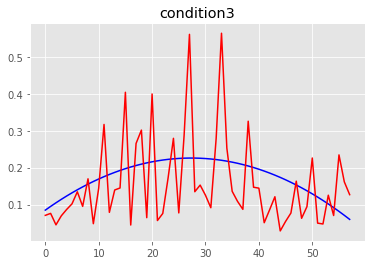

MSE condition3: 0.012779724044452052
R2 condition3: -4.563978589597557


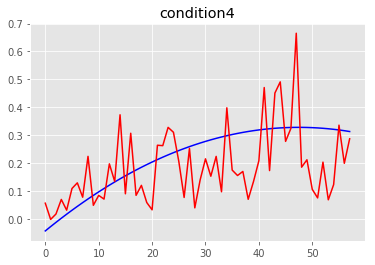

MSE condition4: 0.017899657723386017
R2 condition4: -0.4164789204239425
==== the test person number # 12 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.91992451e-09 4.11015353e-09 3.63315831e-09 3.59432516e-09]
Global min values from training is:  [-3.91492751e-09 -4.1

n_neighbors: 38 weights_type:uniform All_MSE: 8.496896869618878 All_R2: -4.71588358837576
n_neighbors: 38 weights_type:distance All_MSE: 8.290386617640287 All_R2: -4.576963629921714
n_neighbors: 39 weights_type:uniform All_MSE: 8.52169235387731 All_R2: -4.7325635721055095
n_neighbors: 39 weights_type:distance All_MSE: 8.31507108970281 All_R2: -4.593568935472071
n_neighbors: 40 weights_type:uniform All_MSE: 8.555416211392316 All_R2: -4.755249694658789
n_neighbors: 40 weights_type:distance All_MSE: 8.347015833335599 All_R2: -4.6150582437062795
n_neighbors: 41 weights_type:uniform All_MSE: 8.580587375357052 All_R2: -4.772182399058295
n_neighbors: 41 weights_type:distance All_MSE: 8.371978231412303 All_R2: -4.631850510775369
n_neighbors: 42 weights_type:uniform All_MSE: 8.602795229840456 All_R2: -4.787121677823534
n_neighbors: 42 weights_type:distance All_MSE: 8.394476558170762 All_R2: -4.64698519096013
n_neighbors: 43 weights_type:uniform All_MSE: 8.62031839982967 All_R2: -4.7989095577159

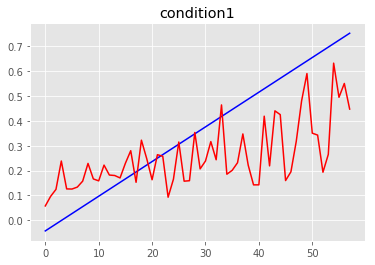

MSE condition1: 0.04076093219927191
R2 condition1: 0.25331357061183857


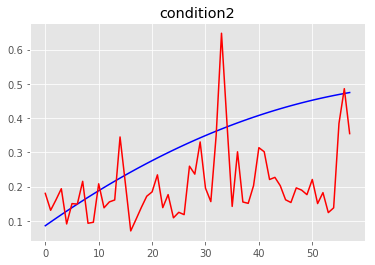

MSE condition2: 0.028405133250931948
R2 condition2: -1.1213336954971056


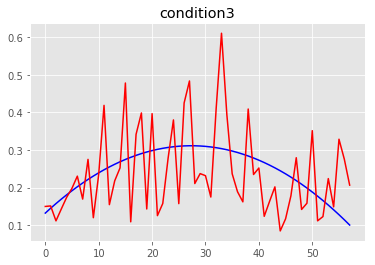

MSE condition3: 0.01220832649585114
R2 condition3: -2.299133433764939


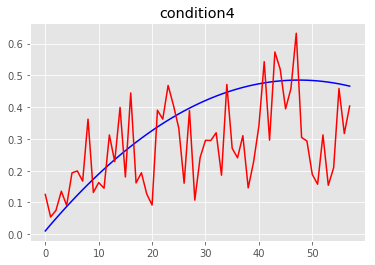

MSE condition4: 0.02450149722601214
R2 condition4: -0.18545622780149928
==== the test person number # 12 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.33146940e-09 4.50967163e-09 3.89465604e-09 3.95232682e-09]
Global min values from training is:  [-4.32136049e-09 -4.5

n_neighbors: 25 weights_type:distance All_MSE: 0.0039012908552837704 All_R2: -0.4192589781954663
n_neighbors: 26 weights_type:uniform All_MSE: 0.0039053967083131766 All_R2: -0.4207526552862795
n_neighbors: 26 weights_type:distance All_MSE: 0.003907746483931656 All_R2: -0.421607485204627
n_neighbors: 27 weights_type:uniform All_MSE: 0.0038833753286456967 All_R2: -0.412741450286531
The best neighbors is: 27 The best weigths :uniform The best mse: 0.0038833753286456967
n_neighbors: 27 weights_type:distance All_MSE: 0.003884122690247852 All_R2: -0.4130133345687248
n_neighbors: 28 weights_type:uniform All_MSE: 0.0038423764392336948 All_R2: -0.397826376262963
The best neighbors is: 28 The best weigths :uniform The best mse: 0.0038423764392336948
n_neighbors: 28 weights_type:distance All_MSE: 0.003850053647626728 All_R2: -0.4006192843909311
n_neighbors: 29 weights_type:uniform All_MSE: 0.003863464006353521 All_R2: -0.40549786759065487
n_neighbors: 29 weights_type:distance All_MSE: 0.003863748

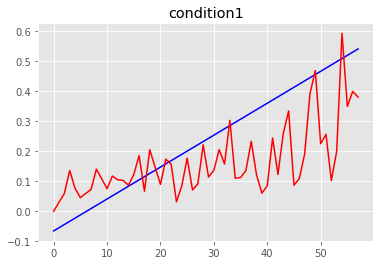

MSE condition1: 0.023487621562867628
R2 condition1: 0.2621240474551161


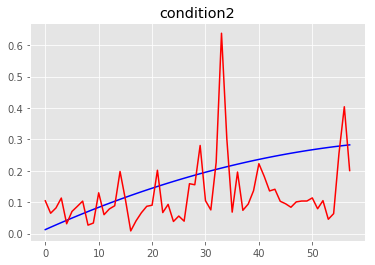

MSE condition2: 0.014075825570260499
R2 condition2: -1.18393013646832


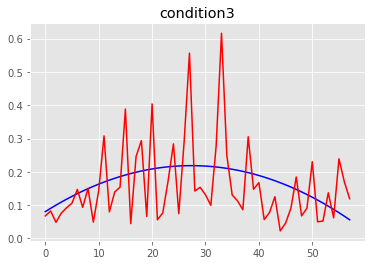

MSE condition3: 0.012866019716602629
R2 condition3: -4.872062103251172


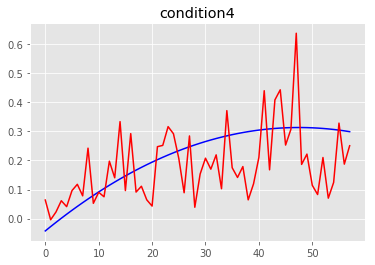

MSE condition4: 0.015197518845377013
R2 condition4: -0.30830508071788687
==== the test person number # 12 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.07598495e-09 4.27130693e-09 3.56404619e-09 3.74131110e-09]
Global min values from training is:  [-4.05930739e-09 -4.

n_neighbors: 24 weights_type:uniform All_MSE: 0.27498545320377404 All_R2: 0.49386342874868927
n_neighbors: 24 weights_type:distance All_MSE: 0.27059304541855445 All_R2: 0.5019480680997795
n_neighbors: 25 weights_type:uniform All_MSE: 0.27642822090880437 All_R2: 0.49120787918841846
n_neighbors: 25 weights_type:distance All_MSE: 0.2714485653147615 All_R2: 0.5003734033243936
n_neighbors: 26 weights_type:uniform All_MSE: 0.27817438991750487 All_R2: 0.4879938910134365
n_neighbors: 26 weights_type:distance All_MSE: 0.27280457513011686 All_R2: 0.49787753981404825
n_neighbors: 27 weights_type:uniform All_MSE: 0.27596024703962824 All_R2: 0.4920692290773686
n_neighbors: 27 weights_type:distance All_MSE: 0.27080103938905065 All_R2: 0.5015652356486757
n_neighbors: 28 weights_type:uniform All_MSE: 0.272009351835366 All_R2: 0.4993412230274512
n_neighbors: 28 weights_type:distance All_MSE: 0.26765349026150875 All_R2: 0.5073585956417171
n_neighbors: 29 weights_type:uniform All_MSE: 0.27091310702796634

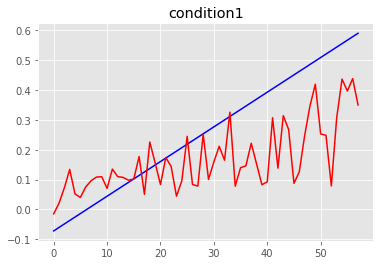

MSE condition1: 0.028064535140441542
R2 condition1: 0.2572140059528053


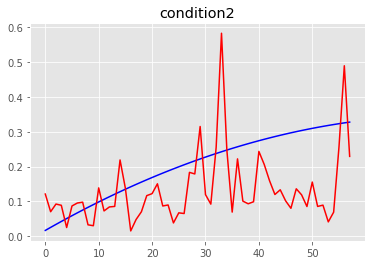

MSE condition2: 0.017420711897376515
R2 condition2: -1.0380787977849981


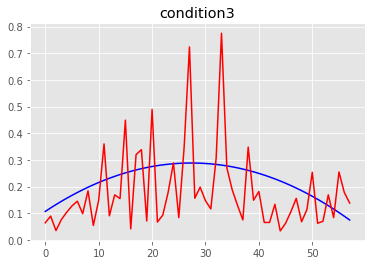

MSE condition3: 0.021305695410683514
R2 condition3: -4.62010879984668


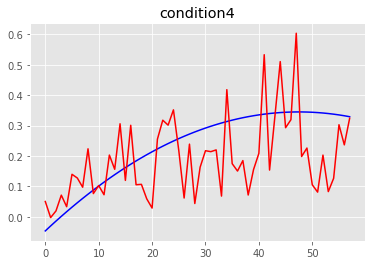

MSE condition4: 0.018258049396237364
R2 condition4: -0.29738483425005646
==== the test person number # 12 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37854328e-09 4.56580454e-09 3.97978813e-09 4.00769529e-09]
Global min values from training is:  [-4.36752342e-09 -4.

n_neighbors: 23 weights_type:uniform All_MSE: 0.002472814824648482 All_R2: 0.21958775109326922
n_neighbors: 23 weights_type:distance All_MSE: 0.0024115032285123277 All_R2: 0.23893748975858942
n_neighbors: 24 weights_type:uniform All_MSE: 0.0024603036431415457 All_R2: 0.22353623894564878
n_neighbors: 24 weights_type:distance All_MSE: 0.0024024328564190424 All_R2: 0.24180006944437227
The best neighbors is: 24 The best weigths :distance The best mse: 0.0024024328564190424
n_neighbors: 25 weights_type:uniform All_MSE: 0.002404857099553359 All_R2: 0.24103498626164033
n_neighbors: 25 weights_type:distance All_MSE: 0.002355758405780927 All_R2: 0.256530372993954
The best neighbors is: 25 The best weigths :distance The best mse: 0.002355758405780927
n_neighbors: 26 weights_type:uniform All_MSE: 0.0023933939493165587 All_R2: 0.2446527188822496
n_neighbors: 26 weights_type:distance All_MSE: 0.0023476774221400385 All_R2: 0.2590807049289223
The best neighbors is: 26 The best weigths :distance The b

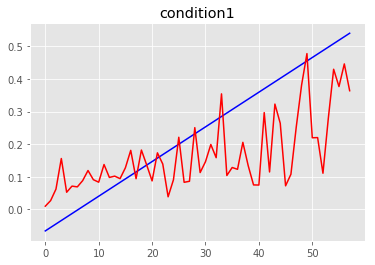

MSE condition1: 0.022241656467280414
R2 condition1: 0.29776538510407446


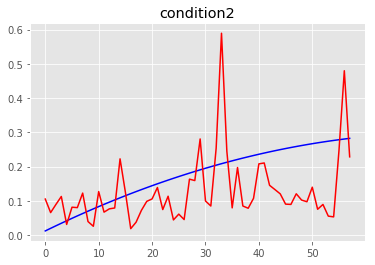

MSE condition2: 0.01338872484510541
R2 condition2: -1.0725268321129908


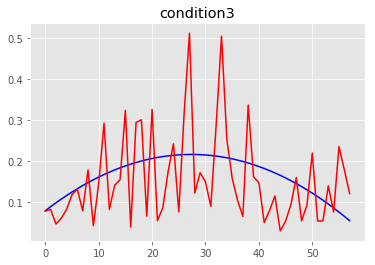

MSE condition3: 0.010486979122688882
R2 condition3: -3.860023282917055


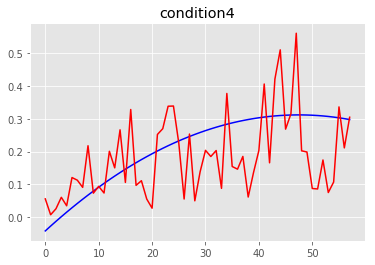

MSE condition4: 0.015253937286827335
R2 condition4: -0.3246968669666366
==== the test person number # 13 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.26286420e-09 4.06647918e-09 3.78795036e-09 3.80162848e-09]
Global min values from training is:  [-4.25447437e-09 -4.0

n_neighbors: 28 weights_type:distance All_MSE: 0.08625407256616999 All_R2: -0.7612663092923726
n_neighbors: 29 weights_type:uniform All_MSE: 0.08463499597188076 All_R2: -0.728205550851108
The best neighbors is: 29 The best weigths :uniform The best mse: 0.08463499597188076
n_neighbors: 29 weights_type:distance All_MSE: 0.08600320303571442 All_R2: -0.7561436752082782
n_neighbors: 30 weights_type:uniform All_MSE: 0.08257693403184316 All_R2: -0.6861809246556971
The best neighbors is: 30 The best weigths :uniform The best mse: 0.08257693403184316
n_neighbors: 30 weights_type:distance All_MSE: 0.08421687162323688 All_R2: -0.719667654535588
n_neighbors: 31 weights_type:uniform All_MSE: 0.08248266106119372 All_R2: -0.6842559163385027
The best neighbors is: 31 The best weigths :uniform The best mse: 0.08248266106119372
n_neighbors: 31 weights_type:distance All_MSE: 0.08409800576670974 All_R2: -0.7172404714218188
n_neighbors: 32 weights_type:uniform All_MSE: 0.08283594547562856 All_R2: -0.69146

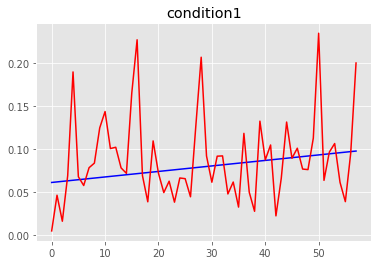

MSE condition1: 0.002546750321305418
R2 condition1: -21.178021784688806


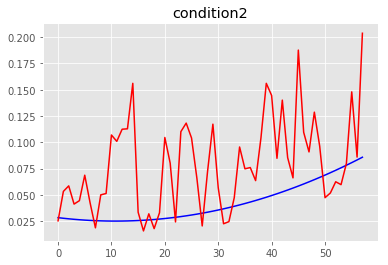

MSE condition2: 0.003001143881547948
R2 condition2: -7.933027255122594


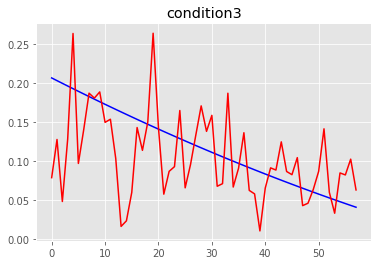

MSE condition3: 0.0034144352339457807
R2 condition3: -0.440268229223717


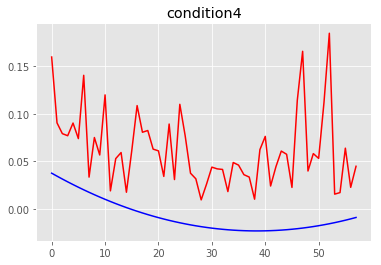

MSE condition4: 0.006223458895554645
R2 condition4: -20.232633270621633
==== the test person number # 13 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.31829824e-09 4.53770383e-09 3.94960942e-09 4.01671816e-09]
Global min values from training is:  [-4.30679851e-09 -4.5

n_neighbors: 26 weights_type:distance All_MSE: 0.012600829061688364 All_R2: -0.5026904294178716
n_neighbors: 27 weights_type:uniform All_MSE: 0.01242089850157921 All_R2: -0.4812331166242325
The best neighbors is: 27 The best weigths :uniform The best mse: 0.01242089850157921
n_neighbors: 27 weights_type:distance All_MSE: 0.012493045545675142 All_R2: -0.48983688960956506
n_neighbors: 28 weights_type:uniform All_MSE: 0.012177945981560412 All_R2: -0.45226022723354964
The best neighbors is: 28 The best weigths :uniform The best mse: 0.012177945981560412
n_neighbors: 28 weights_type:distance All_MSE: 0.012295819680856458 All_R2: -0.466317054680784
n_neighbors: 29 weights_type:uniform All_MSE: 0.012216206743272763 All_R2: -0.4568229492707996
n_neighbors: 29 weights_type:distance All_MSE: 0.012314804948167366 All_R2: -0.4685811104304789
n_neighbors: 30 weights_type:uniform All_MSE: 0.012317165004640872 All_R2: -0.4688625549495864
n_neighbors: 30 weights_type:distance All_MSE: 0.01238209512791

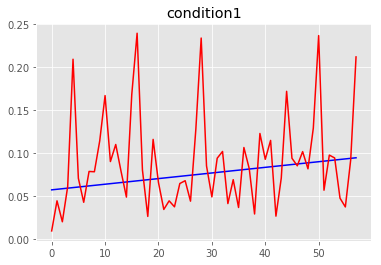

MSE condition1: 0.0031919516870506
R2 condition1: -25.604689953089657


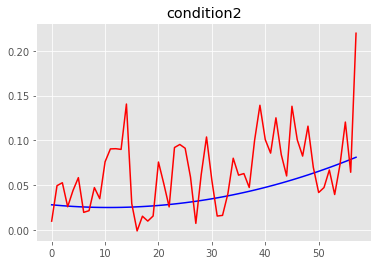

MSE condition2: 0.0020187792036712314
R2 condition2: -6.0696398833557


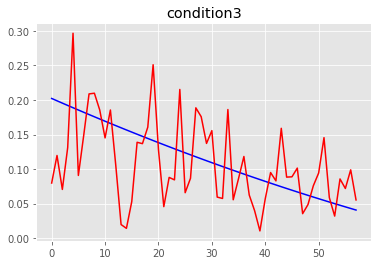

MSE condition3: 0.0037412968706173285
R2 condition3: -0.6562545470493861


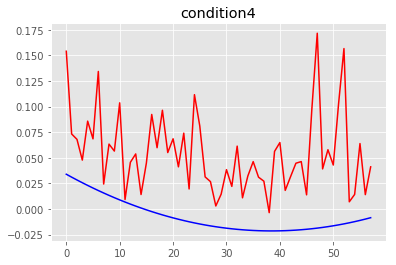

MSE condition4: 0.005201447231292263
R2 condition4: -20.337967511213897
==== the test person number # 13 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37156176e-09 4.58110812e-09 4.00929758e-09 3.97692096e-09]
Global min values from training is:  [-4.36227072e-09 -4.5

n_neighbors: 27 weights_type:uniform All_MSE: 0.004744518823728356 All_R2: -0.453415901048307
n_neighbors: 27 weights_type:distance All_MSE: 0.004710068158724431 All_R2: -0.442862429520704
The best neighbors is: 27 The best weigths :distance The best mse: 0.004710068158724431
n_neighbors: 28 weights_type:uniform All_MSE: 0.0046756558785583545 All_R2: -0.4323207166425578
The best neighbors is: 28 The best weigths :uniform The best mse: 0.0046756558785583545
n_neighbors: 28 weights_type:distance All_MSE: 0.0046478932860799715 All_R2: -0.4238160410660581
The best neighbors is: 28 The best weigths :distance The best mse: 0.0046478932860799715
n_neighbors: 29 weights_type:uniform All_MSE: 0.00466389851703288 All_R2: -0.42871901606334717
n_neighbors: 29 weights_type:distance All_MSE: 0.004639252892075557 All_R2: -0.42116917918102703
The best neighbors is: 29 The best weigths :distance The best mse: 0.004639252892075557
n_neighbors: 30 weights_type:uniform All_MSE: 0.00466891523791643 All_R2:

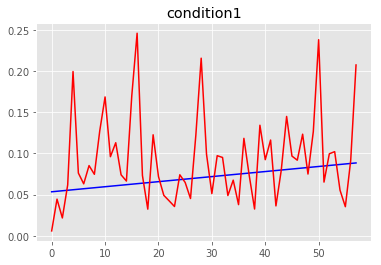

MSE condition1: 0.0032306585278333937
R2 condition1: -29.526318494175097


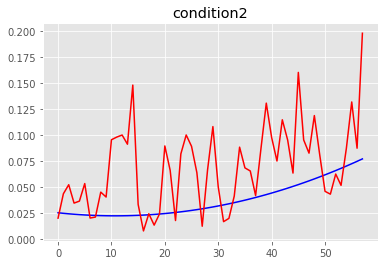

MSE condition2: 0.0022627061815309077
R2 condition2: -7.333182253183654


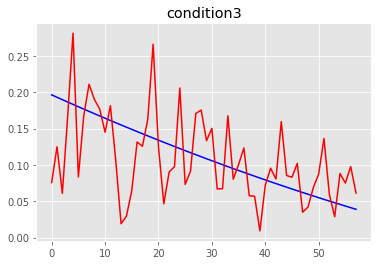

MSE condition3: 0.003274844722247101
R2 condition3: -0.5276625791920804


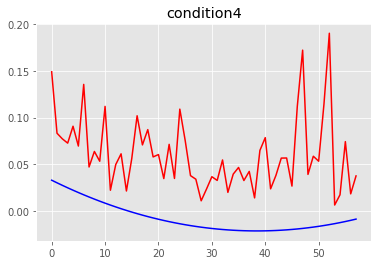

MSE condition4: 0.005981785961627229
R2 condition4: -24.649497256869328
==== the test person number # 13 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.35952858e-09 4.54238128e-09 4.00218418e-09 3.97420212e-09]
Global min values from training is:  [-4.35150437e-09 -4.5

n_neighbors: 22 weights_type:distance All_MSE: 0.007099953761361319 All_R2: 0.3314097623490121
The best neighbors is: 22 The best weigths :distance The best mse: 0.007099953761361319
n_neighbors: 23 weights_type:uniform All_MSE: 0.0070623634646316095 All_R2: 0.334949574898308
The best neighbors is: 23 The best weigths :uniform The best mse: 0.0070623634646316095
n_neighbors: 23 weights_type:distance All_MSE: 0.0070417563496390214 All_R2: 0.3368901109036515
The best neighbors is: 23 The best weigths :distance The best mse: 0.0070417563496390214
n_neighbors: 24 weights_type:uniform All_MSE: 0.007079548366406613 All_R2: 0.33333130273091915
n_neighbors: 24 weights_type:distance All_MSE: 0.007057220815572916 All_R2: 0.3354338491727433
n_neighbors: 25 weights_type:uniform All_MSE: 0.007142247939282437 All_R2: 0.3274269935285413
n_neighbors: 25 weights_type:distance All_MSE: 0.007097262183966052 All_R2: 0.33166322348845656
n_neighbors: 26 weights_type:uniform All_MSE: 0.007107641906774631 All

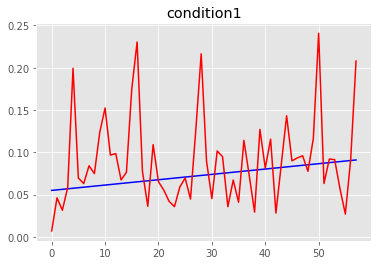

MSE condition1: 0.0029553847684439566
R2 condition1: -25.440414430153066


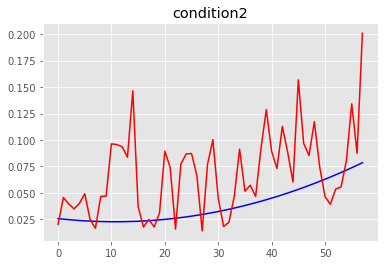

MSE condition2: 0.0021006433288082915
R2 condition2: -6.4331296041213335


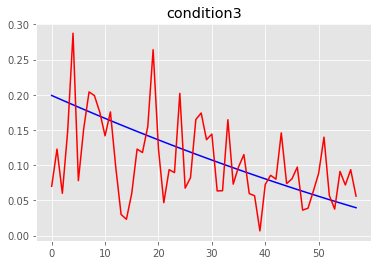

MSE condition3: 0.0033689013135433546
R2 condition3: -0.5305048911155394


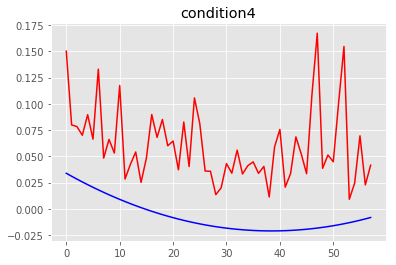

MSE condition4: 0.005594486353422011
R2 condition4: -22.356722072050147
==== the test person number # 13 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44574140e-09 4.66319716e-09 3.98805894e-09 4.05848289e-09]
Global min values from training is:  [-4.43531889e-09 -4.6

n_neighbors: 32 weights_type:uniform All_MSE: 0.0034564182453669877 All_R2: -4.336477204724026
n_neighbors: 32 weights_type:distance All_MSE: 0.003420381536477841 All_R2: -4.280838950939786
n_neighbors: 33 weights_type:uniform All_MSE: 0.0034732011040828435 All_R2: -4.362388809341701
n_neighbors: 33 weights_type:distance All_MSE: 0.003435658719669667 All_R2: -4.304425893858181
n_neighbors: 34 weights_type:uniform All_MSE: 0.0034532648506318 All_R2: -4.331608575429993
n_neighbors: 34 weights_type:distance All_MSE: 0.0034189121995060667 All_R2: -4.2785703935201385
n_neighbors: 35 weights_type:uniform All_MSE: 0.0034858611079340946 All_R2: -4.381935003455935
n_neighbors: 35 weights_type:distance All_MSE: 0.003444236280505776 All_R2: -4.31766907064542
n_neighbors: 36 weights_type:uniform All_MSE: 0.003469192879208752 All_R2: -4.356200379830699
n_neighbors: 36 weights_type:distance All_MSE: 0.0034283903584051085 All_R2: -4.293204033119538
n_neighbors: 37 weights_type:uniform All_MSE: 0.0034

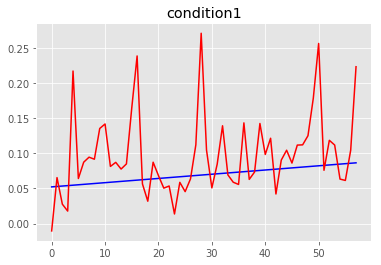

MSE condition1: 0.003937967744564378
R2 condition1: -37.88708855782181


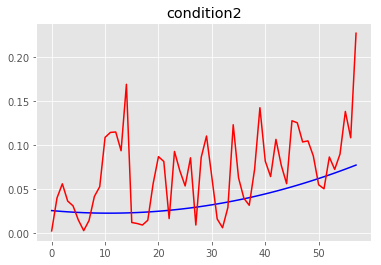

MSE condition2: 0.002679322219781672
R2 condition2: -8.835650847783747


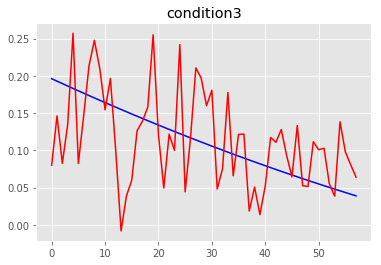

MSE condition3: 0.003988815827416926
R2 condition3: -0.8651571348677993


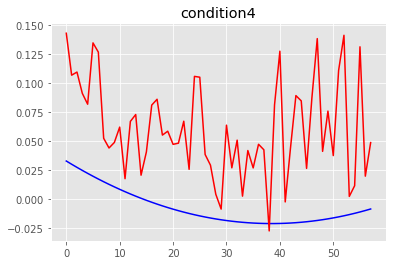

MSE condition4: 0.006120042339514991
R2 condition4: -25.48586268376413
==== the test person number # 13 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.42624362e-09 4.38407447e-09 3.98112043e-09 4.01367974e-09]
Global min values from training is:  [-4.41677034e-09 -4.37

n_neighbors: 28 weights_type:uniform All_MSE: 0.006391133982337221 All_R2: -5.441497576368634
The best neighbors is: 28 The best weigths :uniform The best mse: 0.006391133982337221
n_neighbors: 28 weights_type:distance All_MSE: 0.0064471072104492705 All_R2: -5.497911886289492
n_neighbors: 29 weights_type:uniform All_MSE: 0.0062726522189378246 All_R2: -5.322082149639934
The best neighbors is: 29 The best weigths :uniform The best mse: 0.0062726522189378246
n_neighbors: 29 weights_type:distance All_MSE: 0.006335110438300215 All_R2: -5.385032554021851
n_neighbors: 30 weights_type:uniform All_MSE: 0.006191871826915178 All_R2: -5.240665189696669
The best neighbors is: 30 The best weigths :uniform The best mse: 0.006191871826915178
n_neighbors: 30 weights_type:distance All_MSE: 0.006257559271346978 All_R2: -5.306870266178348
n_neighbors: 31 weights_type:uniform All_MSE: 0.006277950654290849 All_R2: -5.3274223378724725
n_neighbors: 31 weights_type:distance All_MSE: 0.006338186874119377 All_R2

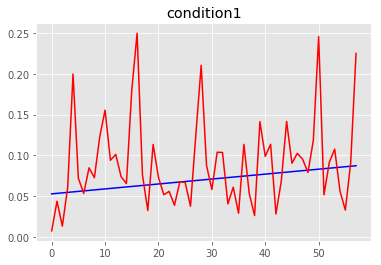

MSE condition1: 0.003376632933787611
R2 condition1: -31.88948862924682


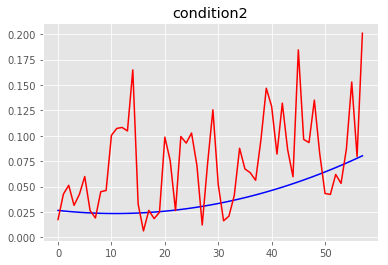

MSE condition2: 0.0028948313899210517
R2 condition2: -8.857220496813847


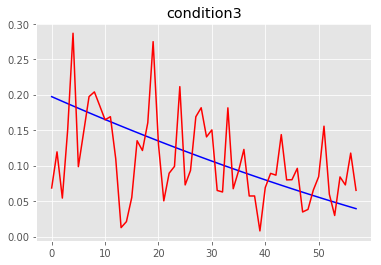

MSE condition3: 0.003603403849714836
R2 condition3: -0.670996508408217


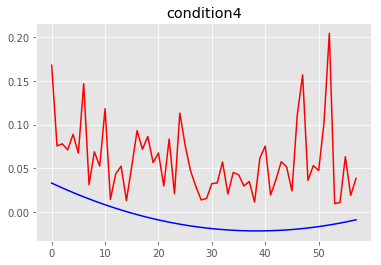

MSE condition4: 0.005931801282935116
R2 condition4: -24.057169963516102
==== the test person number # 13 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.42686031e-09 4.65064915e-09 4.00278154e-09 4.03285487e-09]
Global min values from training is:  [-4.41711047e-09 -4.6

n_neighbors: 27 weights_type:distance All_MSE: 0.0034648609142497355 All_R2: -2.976340411812198
n_neighbors: 28 weights_type:uniform All_MSE: 0.0034409912533321487 All_R2: -2.9489471340813354
The best neighbors is: 28 The best weigths :uniform The best mse: 0.0034409912533321487
n_neighbors: 28 weights_type:distance All_MSE: 0.003446061626392405 All_R2: -2.9547659908266497
n_neighbors: 29 weights_type:uniform All_MSE: 0.0034315651623614313 All_R2: -2.9381295724591254
The best neighbors is: 29 The best weigths :uniform The best mse: 0.0034315651623614313
n_neighbors: 29 weights_type:distance All_MSE: 0.0034373446504107636 All_R2: -2.944762223078847
n_neighbors: 30 weights_type:uniform All_MSE: 0.0033802643665110416 All_R2: -2.879255801549853
The best neighbors is: 30 The best weigths :uniform The best mse: 0.0033802643665110416
n_neighbors: 30 weights_type:distance All_MSE: 0.0033941049914673234 All_R2: -2.895139566497548
n_neighbors: 31 weights_type:uniform All_MSE: 0.00331795037213777

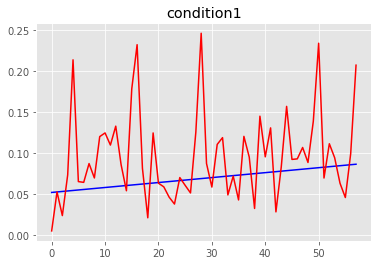

MSE condition1: 0.0035047025036342282
R2 condition1: -33.47163174168153


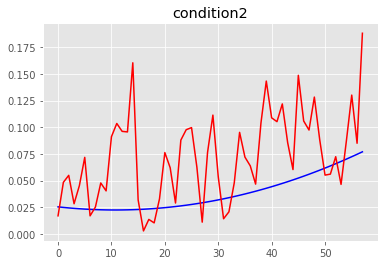

MSE condition2: 0.0025357434699077486
R2 condition2: -8.358888098638268


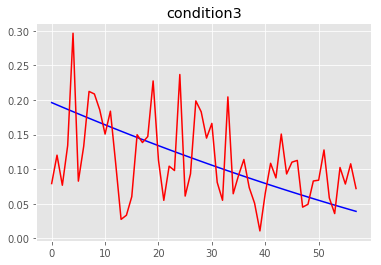

MSE condition3: 0.003539141431322418
R2 condition3: -0.657217862547057


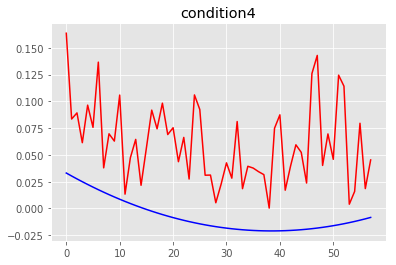

MSE condition4: 0.005781532562014767
R2 condition4: -23.880793901065857
==== the test person number # 13 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.02240295e-09 4.30011519e-09 3.64695002e-09 3.64678142e-09]
Global min values from training is:  [-4.01624620e-09 -4.3

n_neighbors: 27 weights_type:uniform All_MSE: 0.25757707355870935 All_R2: -4.893732593396707
The best neighbors is: 27 The best weigths :uniform The best mse: 0.25757707355870935
n_neighbors: 27 weights_type:distance All_MSE: 0.2617426410734927 All_R2: -4.989046748079334
n_neighbors: 28 weights_type:uniform All_MSE: 0.25052159180042943 All_R2: -4.732293059099753
The best neighbors is: 28 The best weigths :uniform The best mse: 0.25052159180042943
n_neighbors: 28 weights_type:distance All_MSE: 0.2556147967246646 All_R2: -4.848832887167841
n_neighbors: 29 weights_type:uniform All_MSE: 0.24417445607316857 All_R2: -4.587061497169053
The best neighbors is: 29 The best weigths :uniform The best mse: 0.24417445607316857
n_neighbors: 29 weights_type:distance All_MSE: 0.2498409756385417 All_R2: -4.716719585880694
n_neighbors: 30 weights_type:uniform All_MSE: 0.2412170563526121 All_R2: -4.519391953121791
The best neighbors is: 30 The best weigths :uniform The best mse: 0.2412170563526121
n_neigh

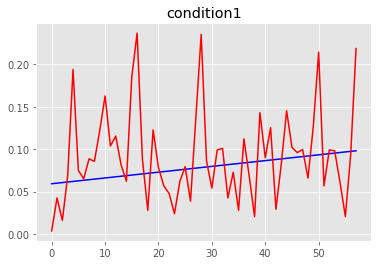

MSE condition1: 0.003134818390514202
R2 condition1: -23.14175249341952


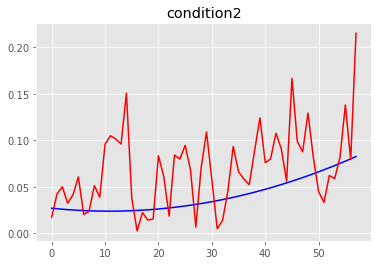

MSE condition2: 0.0022459779753575887
R2 condition2: -6.183140643830239


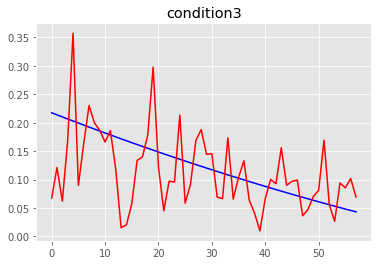

MSE condition3: 0.004550720349782656
R2 condition3: -0.731185502461879


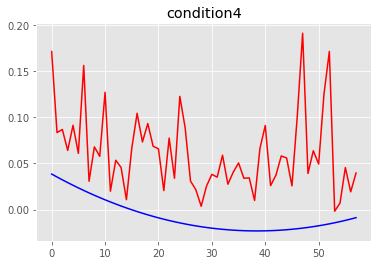

MSE condition4: 0.006382878841856756
R2 condition4: -20.201877842156463
==== the test person number # 13 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40211262e-09 4.62448599e-09 3.98444470e-09 3.92115979e-09]
Global min values from training is:  [-4.39101386e-09 -4.6

n_neighbors: 31 weights_type:uniform All_MSE: 0.004875407788932245 All_R2: -3.0002654742907255
The best neighbors is: 31 The best weigths :uniform The best mse: 0.004875407788932245
n_neighbors: 31 weights_type:distance All_MSE: 0.004837660591138554 All_R2: -2.969293949728592
The best neighbors is: 31 The best weigths :distance The best mse: 0.004837660591138554
n_neighbors: 32 weights_type:uniform All_MSE: 0.004853071722186392 All_R2: -2.9819387618385433
n_neighbors: 32 weights_type:distance All_MSE: 0.004817923643465282 All_R2: -2.9530998109481392
The best neighbors is: 32 The best weigths :distance The best mse: 0.004817923643465282
n_neighbors: 33 weights_type:uniform All_MSE: 0.004771743444293653 All_R2: -2.91520902020003
The best neighbors is: 33 The best weigths :uniform The best mse: 0.004771743444293653
n_neighbors: 33 weights_type:distance All_MSE: 0.00474683860132589 All_R2: -2.8947746303439157
The best neighbors is: 33 The best weigths :distance The best mse: 0.004746838601

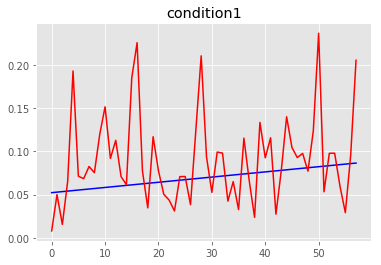

MSE condition1: 0.0031074159659658764
R2 condition1: -29.651384717985298


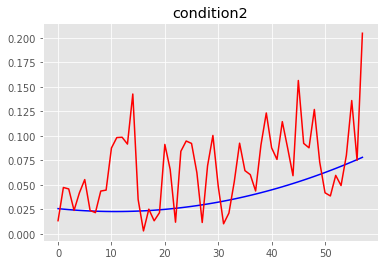

MSE condition2: 0.002185787057580064
R2 condition2: -6.867505347792684


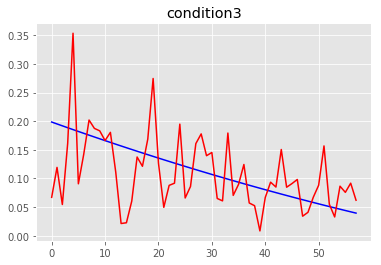

MSE condition3: 0.0038277298356607847
R2 condition3: -0.7514646814915087


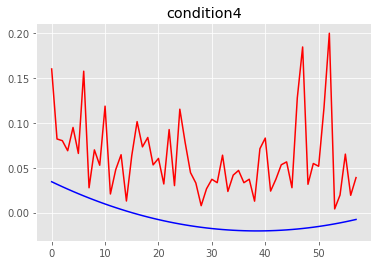

MSE condition4: 0.006403336667810058
R2 condition4: -25.707300781448772
==== the test person number # 13 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.23452963e-09 4.53354195e-09 3.89798842e-09 3.86255094e-09]
Global min values from training is:  [-4.22743802e-09 -4.5

n_neighbors: 34 weights_type:distance All_MSE: 0.06709218544901648 All_R2: -0.4306413529874831
n_neighbors: 35 weights_type:uniform All_MSE: 0.06821171011767843 All_R2: -0.4545135562248408
n_neighbors: 35 weights_type:distance All_MSE: 0.06705256230267291 All_R2: -0.42979644815519613
n_neighbors: 36 weights_type:uniform All_MSE: 0.06797458683968803 All_R2: -0.44945725398965997
n_neighbors: 36 weights_type:distance All_MSE: 0.06687157020299032 All_R2: -0.4259370600515442
n_neighbors: 37 weights_type:uniform All_MSE: 0.0673803182015503 All_R2: -0.4367853566172091
n_neighbors: 37 weights_type:distance All_MSE: 0.06638211167852709 All_R2: -0.41550008291355156
n_neighbors: 38 weights_type:uniform All_MSE: 0.06694260922402515 All_R2: -0.4274518618200065
n_neighbors: 38 weights_type:distance All_MSE: 0.06604700144767263 All_R2: -0.40835435422904065
n_neighbors: 39 weights_type:uniform All_MSE: 0.06706845635403998 All_R2: -0.4301353652287727
n_neighbors: 39 weights_type:distance All_MSE: 0.066

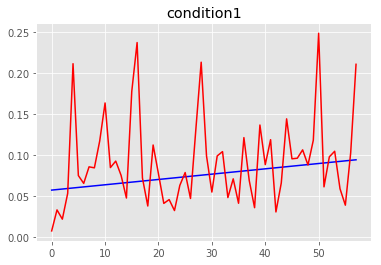

MSE condition1: 0.0030741219902489297
R2 condition1: -25.052040589942635


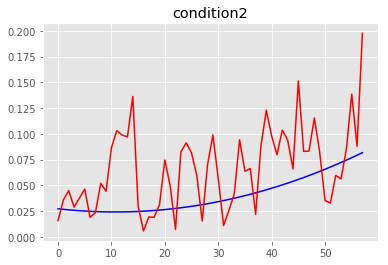

MSE condition2: 0.001926653840205288
R2 condition2: -5.38865489290929


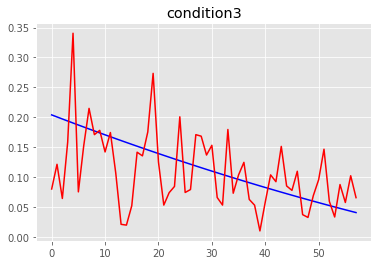

MSE condition3: 0.003915596809366662
R2 condition3: -0.6953966326817507


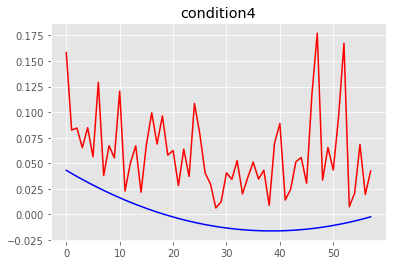

MSE condition4: 0.005054377228979173
R2 condition4: -17.12938873295074
==== the test person number # 13 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.39044430e-09 4.58807365e-09 3.93517959e-09 3.96267740e-09]
Global min values from training is:  [-4.37827926e-09 -4.59

n_neighbors: 29 weights_type:uniform All_MSE: 0.011925577089630391 All_R2: 0.12734467304191455
n_neighbors: 29 weights_type:distance All_MSE: 0.011638678949575399 All_R2: 0.14833847387282373
n_neighbors: 30 weights_type:uniform All_MSE: 0.011968669893670021 All_R2: 0.12419135268549808
n_neighbors: 30 weights_type:distance All_MSE: 0.011689326566832716 All_R2: 0.14463232928416792
n_neighbors: 31 weights_type:uniform All_MSE: 0.01198791375647024 All_R2: 0.12278318105089736
n_neighbors: 31 weights_type:distance All_MSE: 0.011707167747603511 All_R2: 0.143326799050969
n_neighbors: 32 weights_type:uniform All_MSE: 0.012285420508646706 All_R2: 0.10101309393967994
n_neighbors: 32 weights_type:distance All_MSE: 0.011933922231983805 All_R2: 0.12673401639408965
n_neighbors: 33 weights_type:uniform All_MSE: 0.012407546982458963 All_R2: 0.09207647668972374
n_neighbors: 33 weights_type:distance All_MSE: 0.012023479847715216 All_R2: 0.12018062867538237
n_neighbors: 34 weights_type:uniform All_MSE: 0.

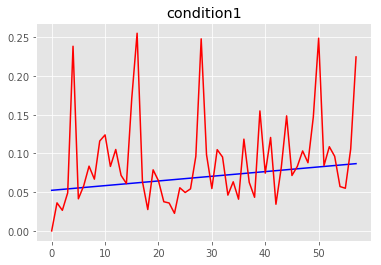

MSE condition1: 0.0036818134282878725
R2 condition1: -35.04811312304469


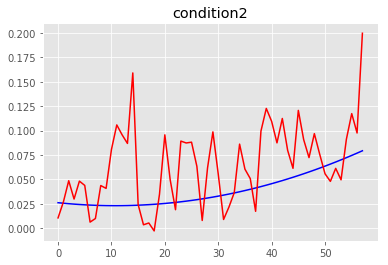

MSE condition2: 0.002012021615715614
R2 condition2: -5.988575577661449


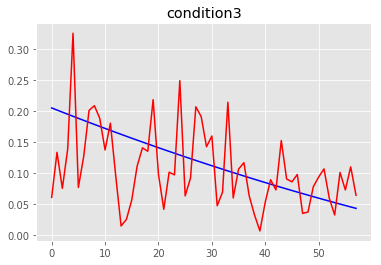

MSE condition3: 0.004228532913463724
R2 condition3: -0.8519864433689006


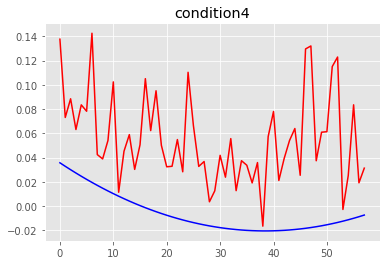

MSE condition4: 0.0049723217042039435
R2 condition4: -18.82422227791052
==== the test person number # 13 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.97427556e-09 4.19869962e-09 3.67988046e-09 3.66344718e-09]
Global min values from training is:  [-3.97088609e-09 -4.2

n_neighbors: 38 weights_type:uniform All_MSE: 7.642990245889481 All_R2: -4.883262503690805
n_neighbors: 38 weights_type:distance All_MSE: 7.453404091787591 All_R2: -4.737326806305024
n_neighbors: 39 weights_type:uniform All_MSE: 7.6703449726887465 All_R2: -4.904319057905744
n_neighbors: 39 weights_type:distance All_MSE: 7.480078277225716 All_R2: -4.757859507506496
n_neighbors: 40 weights_type:uniform All_MSE: 7.690648609033995 All_R2: -4.919947969961836
n_neighbors: 40 weights_type:distance All_MSE: 7.500900002504623 All_R2: -4.77388722331595
n_neighbors: 41 weights_type:uniform All_MSE: 7.709093157647448 All_R2: -4.934145832024186
n_neighbors: 41 weights_type:distance All_MSE: 7.51977989189837 All_R2: -4.788420192974495
n_neighbors: 42 weights_type:uniform All_MSE: 7.731543413424331 All_R2: -4.951427124262056
n_neighbors: 42 weights_type:distance All_MSE: 7.542230361628418 All_R2: -4.805701649904794
n_neighbors: 43 weights_type:uniform All_MSE: 7.75524530766519 All_R2: -4.969671876795

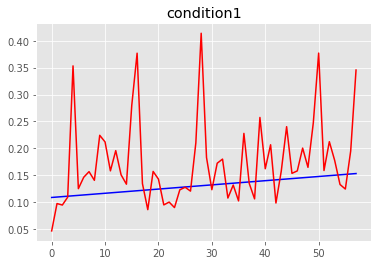

MSE condition1: 0.007579532636530855
R2 condition1: -43.3909595507072


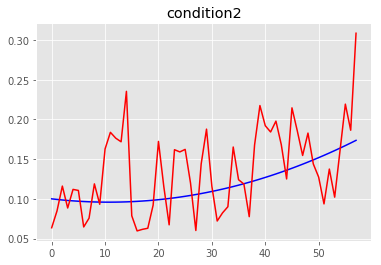

MSE condition2: 0.0025758962879084166
R2 condition2: -3.6686319072191464


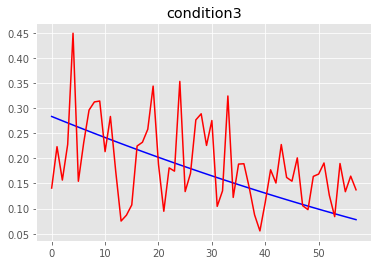

MSE condition3: 0.006468214088203399
R2 condition3: -0.7715432143401202


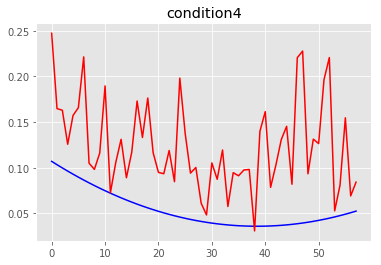

MSE condition4: 0.006943527078634866
R2 condition4: -16.32631772346555
==== the test person number # 13 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.33146940e-09 4.50967163e-09 3.89465604e-09 3.95232682e-09]
Global min values from training is:  [-4.32136049e-09 -4.52

n_neighbors: 26 weights_type:distance All_MSE: 0.015751746302785457 All_R2: -0.1367420872212748
n_neighbors: 27 weights_type:uniform All_MSE: 0.016367474628449095 All_R2: -0.18117679868894077
n_neighbors: 27 weights_type:distance All_MSE: 0.0159506057600663 All_R2: -0.15109299855439762
n_neighbors: 28 weights_type:uniform All_MSE: 0.016280759033927242 All_R2: -0.17491887248719817
n_neighbors: 28 weights_type:distance All_MSE: 0.015881470792606996 All_R2: -0.14610379763032166
n_neighbors: 29 weights_type:uniform All_MSE: 0.016353623928529522 All_R2: -0.18017724770371002
n_neighbors: 29 weights_type:distance All_MSE: 0.015936354400749708 All_R2: -0.1500645335433517
n_neighbors: 30 weights_type:uniform All_MSE: 0.016120825261543535 All_R2: -0.1633770759941655
n_neighbors: 30 weights_type:distance All_MSE: 0.0157417868504553 All_R2: -0.1360233523958312
n_neighbors: 31 weights_type:uniform All_MSE: 0.016068827886878502 All_R2: -0.15962462829277624
n_neighbors: 31 weights_type:distance All_M

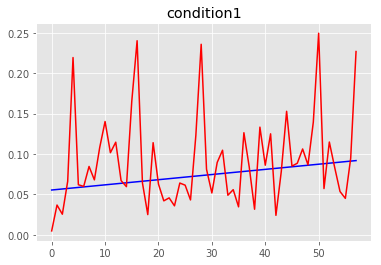

MSE condition1: 0.003360078403295687
R2 condition1: -28.423322458818983


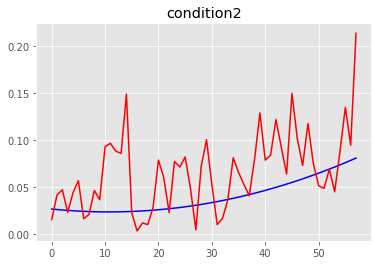

MSE condition2: 0.0019895076808603756
R2 condition2: -5.657632885512483


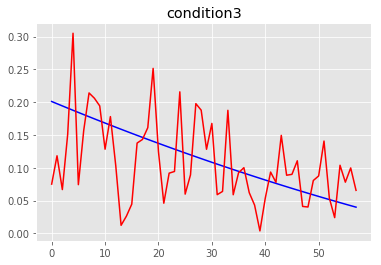

MSE condition3: 0.003907502322535329
R2 condition3: -0.74458858326821


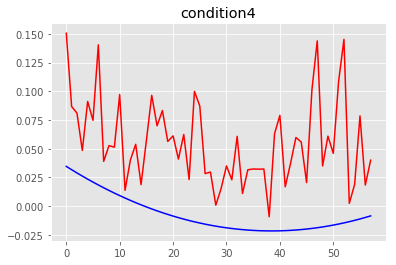

MSE condition4: 0.005150429930717172
R2 condition4: -19.493056795568467
==== the test person number # 13 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.13033600e-09 4.35985303e-09 3.61076834e-09 3.81043312e-09]
Global min values from training is:  [-4.11526597e-09 -4.3

n_neighbors: 24 weights_type:uniform All_MSE: 0.2567861785754929 All_R2: 0.5140341069196392
n_neighbors: 24 weights_type:distance All_MSE: 0.2527341833264788 All_R2: 0.5217024771600789
n_neighbors: 25 weights_type:uniform All_MSE: 0.26227906073600876 All_R2: 0.5036388691403773
n_neighbors: 25 weights_type:distance All_MSE: 0.25684789980206085 All_R2: 0.5139172999670318
n_neighbors: 26 weights_type:uniform All_MSE: 0.26325031010057665 All_R2: 0.5018007870929933
n_neighbors: 26 weights_type:distance All_MSE: 0.2572345107054643 All_R2: 0.5131856417680223
n_neighbors: 27 weights_type:uniform All_MSE: 0.2634783902133776 All_R2: 0.5013691472114153
n_neighbors: 27 weights_type:distance All_MSE: 0.2571557415985771 All_R2: 0.5133347117046829
n_neighbors: 28 weights_type:uniform All_MSE: 0.2635744536431729 All_R2: 0.5011873478999733
n_neighbors: 28 weights_type:distance All_MSE: 0.257192027394195 All_R2: 0.5132660411120078
n_neighbors: 29 weights_type:uniform All_MSE: 0.2650456502670605 All_R2: 

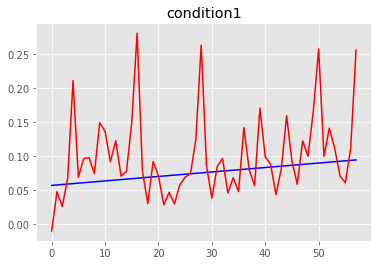

MSE condition1: 0.0040581214486558334
R2 condition1: -32.57844918901315


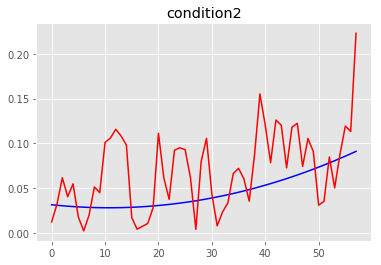

MSE condition2: 0.00211752136448875
R2 condition2: -4.874500838022392


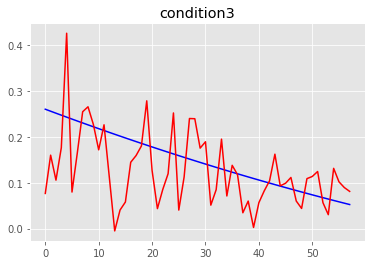

MSE condition3: 0.006657235647994194
R2 condition3: -0.780540288198549


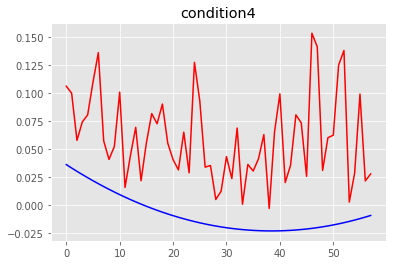

MSE condition4: 0.006041922964976565
R2 condition4: -20.73128762162314
==== the test person number # 13 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43289432e-09 4.65435063e-09 4.02651028e-09 4.07681731e-09]
Global min values from training is:  [-4.42348201e-09 -4.66

n_neighbors: 24 weights_type:distance All_MSE: 0.00242793897088826 All_R2: 0.1682313147132528
The best neighbors is: 24 The best weigths :distance The best mse: 0.00242793897088826
n_neighbors: 25 weights_type:uniform All_MSE: 0.0024915924179269248 All_R2: 0.14642477649621122
n_neighbors: 25 weights_type:distance All_MSE: 0.002424783328709269 All_R2: 0.16931238156786765
The best neighbors is: 25 The best weigths :distance The best mse: 0.002424783328709269
n_neighbors: 26 weights_type:uniform All_MSE: 0.002454153899830211 All_R2: 0.15925054656282656
n_neighbors: 26 weights_type:distance All_MSE: 0.0023941800733041536 All_R2: 0.17979651227255944
The best neighbors is: 26 The best weigths :distance The best mse: 0.0023941800733041536
n_neighbors: 27 weights_type:uniform All_MSE: 0.002441077079936646 All_R2: 0.16373043235115126
n_neighbors: 27 weights_type:distance All_MSE: 0.0023834851311701826 All_R2: 0.1834604091269092
The best neighbors is: 27 The best weigths :distance The best mse: 

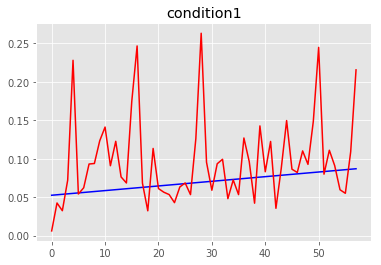

MSE condition1: 0.0037235685500895755
R2 condition1: -35.40877393769655


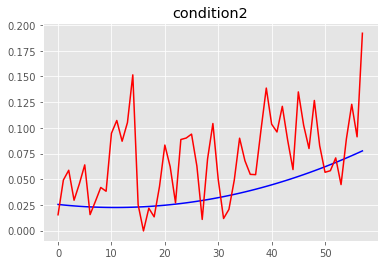

MSE condition2: 0.0022985310662507626
R2 condition2: -7.335452734106045


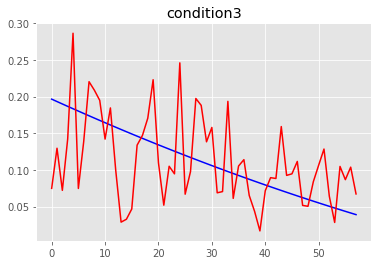

MSE condition3: 0.0036252120215912098
R2 condition3: -0.6886313272225719


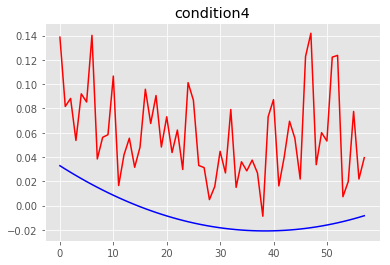

MSE condition4: 0.005464169975606876
R2 condition4: -22.8157552341588
==== the test person number # 14 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.00737975e-09 3.82811449e-09 3.45734051e-09 3.59061275e-09]
Global min values from training is:  [-3.99242127e-09 -3.843

n_neighbors: 26 weights_type:distance All_MSE: 0.12652600901942115 All_R2: -1.041247036247325
n_neighbors: 27 weights_type:uniform All_MSE: 0.12161650470775053 All_R2: -0.9620418893901055
The best neighbors is: 27 The best weigths :uniform The best mse: 0.12161650470775053
n_neighbors: 27 weights_type:distance All_MSE: 0.12558555090551254 All_R2: -1.026074603696828
n_neighbors: 28 weights_type:uniform All_MSE: 0.12134180222408207 All_R2: -0.9576101078537738
The best neighbors is: 28 The best weigths :uniform The best mse: 0.12134180222408207
n_neighbors: 28 weights_type:distance All_MSE: 0.12527686171020727 All_R2: -1.0210945137538845
n_neighbors: 29 weights_type:uniform All_MSE: 0.12043789205312065 All_R2: -0.9430273041139863
The best neighbors is: 29 The best weigths :uniform The best mse: 0.12043789205312065
n_neighbors: 29 weights_type:distance All_MSE: 0.12429852034320399 All_R2: -1.0053109098031183
n_neighbors: 30 weights_type:uniform All_MSE: 0.11979501074281543 All_R2: -0.93265

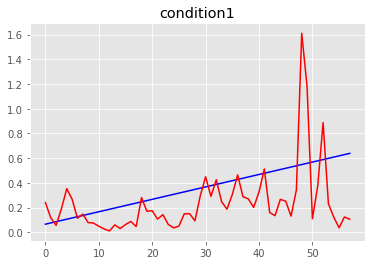

MSE condition1: 0.08010792931583023
R2 condition1: -1.8282716685531817


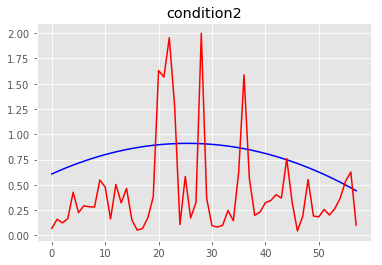

MSE condition2: 0.3078233618902178
R2 condition2: -18.014669291217025


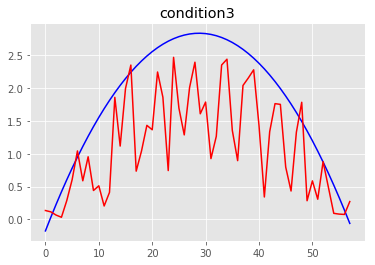

MSE condition3: 0.8488797766242484
R2 condition3: -0.021236291475666524


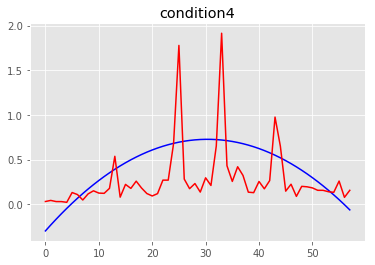

MSE condition4: 0.1398533167532034
R2 condition4: -0.6983042103644379
==== the test person number # 14 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06281379e-09 4.29933914e-09 3.61899957e-09 3.80570244e-09]
Global min values from training is:  [-4.04474541e-09 -4.312

n_neighbors: 26 weights_type:uniform All_MSE: 0.01570260124747836 All_R2: -0.6019517913020058
The best neighbors is: 26 The best weigths :uniform The best mse: 0.01570260124747836
n_neighbors: 26 weights_type:distance All_MSE: 0.01566256780821996 All_R2: -0.5978676501637805
The best neighbors is: 26 The best weigths :distance The best mse: 0.01566256780821996
n_neighbors: 27 weights_type:uniform All_MSE: 0.015516464084557903 All_R2: -0.58296240496602
The best neighbors is: 27 The best weigths :uniform The best mse: 0.015516464084557903
n_neighbors: 27 weights_type:distance All_MSE: 0.015504435631722883 All_R2: -0.5817352833406304
The best neighbors is: 27 The best weigths :distance The best mse: 0.015504435631722883
n_neighbors: 28 weights_type:uniform All_MSE: 0.015370320052409096 All_R2: -0.5680530475672594
The best neighbors is: 28 The best weigths :uniform The best mse: 0.015370320052409096
n_neighbors: 28 weights_type:distance All_MSE: 0.01537880195676697 All_R2: -0.56891835654795

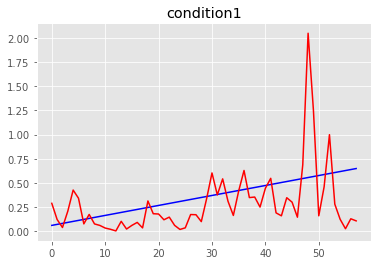

MSE condition1: 0.10081346893749135
R2 condition1: -2.3931315645618656


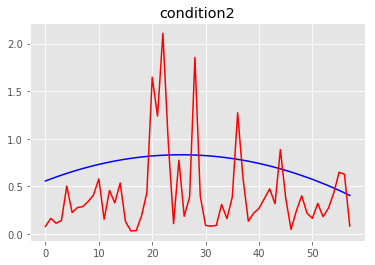

MSE condition2: 0.25325391123505914
R2 condition2: -17.87430889900779


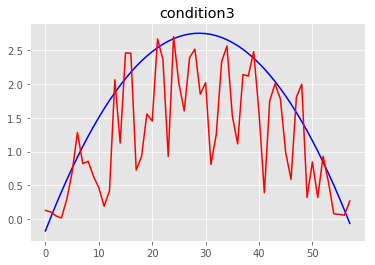

MSE condition3: 0.6405430514386065
R2 condition3: 0.17857148164653025


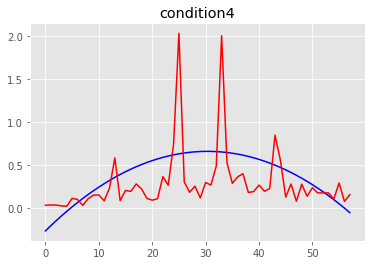

MSE condition4: 0.13261552393245063
R2 condition4: -0.9739512201738569
==== the test person number # 14 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.11607731e-09 4.34274343e-09 3.67868774e-09 3.76590524e-09]
Global min values from training is:  [-4.10021761e-09 -4.35

n_neighbors: 25 weights_type:distance All_MSE: 0.005193936746805497 All_R2: -0.33435048502242437
n_neighbors: 26 weights_type:uniform All_MSE: 0.005147720894738512 All_R2: -0.3224773822821505
The best neighbors is: 26 The best weigths :uniform The best mse: 0.005147720894738512
n_neighbors: 26 weights_type:distance All_MSE: 0.005172458667044322 All_R2: -0.3288326499882761
n_neighbors: 27 weights_type:uniform All_MSE: 0.005130703429069277 All_R2: -0.31810550317069186
The best neighbors is: 27 The best weigths :uniform The best mse: 0.005130703429069277
n_neighbors: 27 weights_type:distance All_MSE: 0.0051544574474307854 All_R2: -0.3242080391596802
n_neighbors: 28 weights_type:uniform All_MSE: 0.005125627573171921 All_R2: -0.316801488295519
The best neighbors is: 28 The best weigths :uniform The best mse: 0.005125627573171921
n_neighbors: 28 weights_type:distance All_MSE: 0.005148666144748306 All_R2: -0.32272022212994256
n_neighbors: 29 weights_type:uniform All_MSE: 0.005083973553513843 

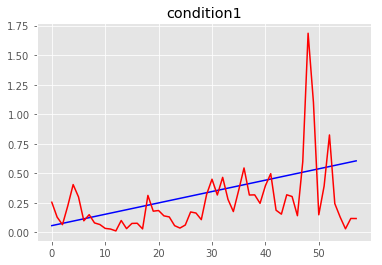

MSE condition1: 0.07265672783760536
R2 condition1: -1.8033682147676715


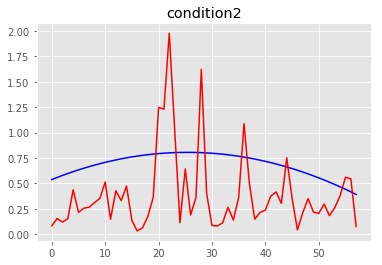

MSE condition2: 0.22215885405153718
R2 condition2: -16.54031573140857


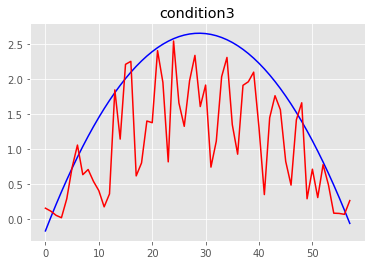

MSE condition3: 0.697972813639679
R2 condition3: 0.04130946086249654


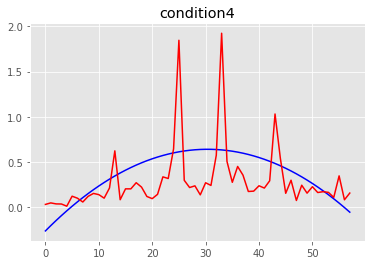

MSE condition4: 0.11915372734372381
R2 condition4: -0.86186690288986
==== the test person number # 14 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.10404413e-09 4.30401659e-09 3.67157433e-09 3.76318639e-09]
Global min values from training is:  [-4.08945127e-09 -4.3169

n_neighbors: 32 weights_type:uniform All_MSE: 0.008994330979162215 All_R2: 0.33028969154725374
n_neighbors: 32 weights_type:distance All_MSE: 0.008898599927084798 All_R2: 0.3374177450471535
n_neighbors: 33 weights_type:uniform All_MSE: 0.008939731047102866 All_R2: 0.33435515649686265
n_neighbors: 33 weights_type:distance All_MSE: 0.008852576638864783 All_R2: 0.3408446003209079
n_neighbors: 34 weights_type:uniform All_MSE: 0.008922519852614276 All_R2: 0.3356366875408612
n_neighbors: 34 weights_type:distance All_MSE: 0.008841996659042416 All_R2: 0.3416323767065754
n_neighbors: 35 weights_type:uniform All_MSE: 0.0089273527977882 All_R2: 0.33527683051417834
n_neighbors: 35 weights_type:distance All_MSE: 0.008841399530349502 All_R2: 0.34167683840606633
n_neighbors: 36 weights_type:uniform All_MSE: 0.008938189574616487 All_R2: 0.3344699332397595
n_neighbors: 36 weights_type:distance All_MSE: 0.008842735962010836 All_R2: 0.3415773288302889
n_neighbors: 37 weights_type:uniform All_MSE: 0.00898

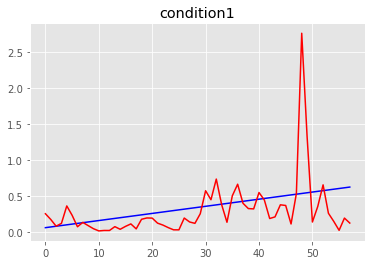

MSE condition1: 0.14302166421446452
R2 condition1: -4.200070387238608


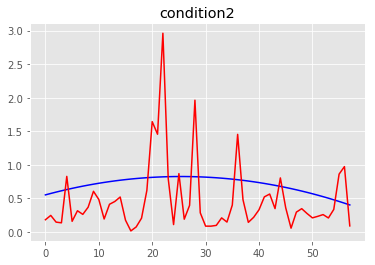

MSE condition2: 0.3104935012261189
R2 condition2: -22.417612139351302


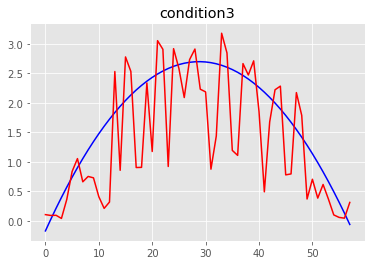

MSE condition3: 0.595693043891292
R2 condition3: 0.2096481672314281


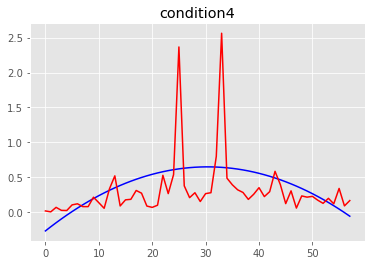

MSE condition4: 0.17416291239132853
R2 condition4: -1.6428444567253218
==== the test person number # 14 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.19025695e-09 4.42483247e-09 3.65744909e-09 3.84746717e-09]
Global min values from training is:  [-4.17326579e-09 -4.43

n_neighbors: 32 weights_type:uniform All_MSE: 0.003772033832509853 All_R2: -2.8610282572306716
n_neighbors: 32 weights_type:distance All_MSE: 0.0037396096012055234 All_R2: -2.8278390338981487
n_neighbors: 33 weights_type:uniform All_MSE: 0.003804776679445321 All_R2: -2.8945436133630693
n_neighbors: 33 weights_type:distance All_MSE: 0.0037664544218775483 All_R2: -2.855317210334868
n_neighbors: 34 weights_type:uniform All_MSE: 0.003823602195399836 All_R2: -2.913813283860421
n_neighbors: 34 weights_type:distance All_MSE: 0.0037801615405244435 All_R2: -2.8693477240499745
n_neighbors: 35 weights_type:uniform All_MSE: 0.003833482395037763 All_R2: -2.9239265892237865
n_neighbors: 35 weights_type:distance All_MSE: 0.003789128814852021 All_R2: -2.878526565255139
n_neighbors: 36 weights_type:uniform All_MSE: 0.003824261914972456 All_R2: -2.914488568342173
n_neighbors: 36 weights_type:distance All_MSE: 0.0037813026569029065 All_R2: -2.8705157630384006
n_neighbors: 37 weights_type:uniform All_MSE:

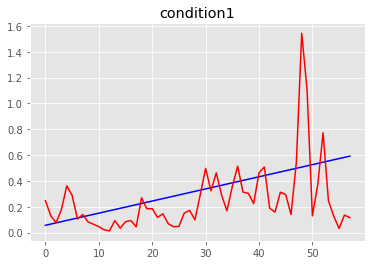

MSE condition1: 0.06483209114493953
R2 condition1: -1.6240300880581269


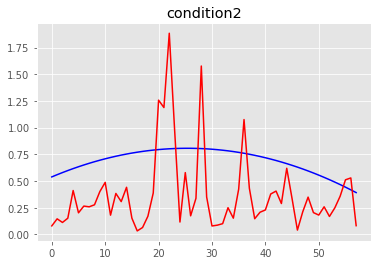

MSE condition2: 0.2212064753196357
R2 condition2: -16.400643780954


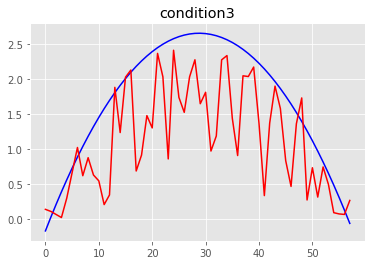

MSE condition3: 0.6342345676707667
R2 condition3: 0.12614095571024475


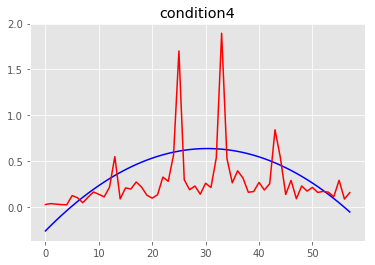

MSE condition4: 0.11016328332515776
R2 condition4: -0.7389065269647068
==== the test person number # 14 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.17075917e-09 4.14570978e-09 3.65051058e-09 3.80266402e-09]
Global min values from training is:  [-4.15471724e-09 -4.14

n_neighbors: 28 weights_type:distance All_MSE: 0.00610794171036061 All_R2: -3.9724531251321356
n_neighbors: 29 weights_type:uniform All_MSE: 0.006114783922456522 All_R2: -3.9780233451068003
n_neighbors: 29 weights_type:distance All_MSE: 0.006088289170795414 All_R2: -3.9564540641699164
n_neighbors: 30 weights_type:uniform All_MSE: 0.006234616346414101 All_R2: -4.075578485488918
n_neighbors: 30 weights_type:distance All_MSE: 0.006199907195934024 All_R2: -4.047321892358275
n_neighbors: 31 weights_type:uniform All_MSE: 0.006070644188974046 All_R2: -3.942089348663261
n_neighbors: 31 weights_type:distance All_MSE: 0.006053301147184451 All_R2: -3.927970441437987
n_neighbors: 32 weights_type:uniform All_MSE: 0.006060435097767938 All_R2: -3.9337781646540133
n_neighbors: 32 weights_type:distance All_MSE: 0.006038437315073506 All_R2: -3.9158698497925
n_neighbors: 33 weights_type:uniform All_MSE: 0.005904148474592278 All_R2: -3.8065457933122966
n_neighbors: 33 weights_type:distance All_MSE: 0.0059

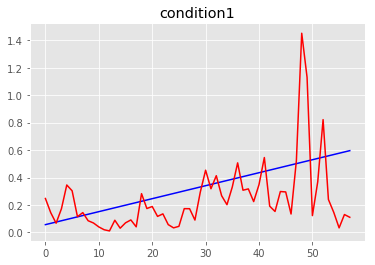

MSE condition1: 0.0634167122258503
R2 condition1: -1.5288381931473403


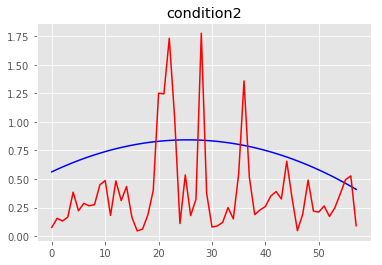

MSE condition2: 0.2371975331620281
R2 condition2: -16.11727603509546


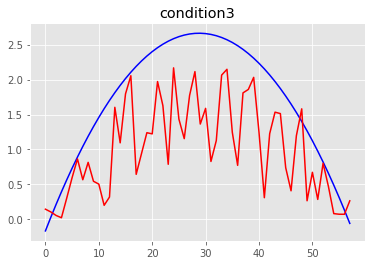

MSE condition3: 0.80821991107856
R2 condition3: -0.10155203829452986


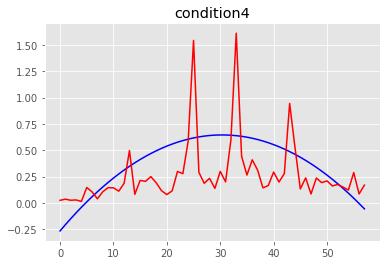

MSE condition4: 0.09767274134441883
R2 condition4: -0.5013463948027439
==== the test person number # 14 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.17137586e-09 4.41228446e-09 3.67217169e-09 3.82183914e-09]
Global min values from training is:  [-4.15505737e-09 -4.42

n_neighbors: 25 weights_type:uniform All_MSE: 0.003606870118191801 All_R2: -2.3762004431250063
n_neighbors: 25 weights_type:distance All_MSE: 0.003572170162161468 All_R2: -2.3437196486724576
The best neighbors is: 25 The best weigths :distance The best mse: 0.003572170162161468
n_neighbors: 26 weights_type:uniform All_MSE: 0.0036162395943840574 All_R2: -2.3849707144781664
n_neighbors: 26 weights_type:distance All_MSE: 0.0035800421634193985 All_R2: -2.3510882129024973
n_neighbors: 27 weights_type:uniform All_MSE: 0.0036182118041514447 All_R2: -2.3868167957820106
n_neighbors: 27 weights_type:distance All_MSE: 0.0035798296737065798 All_R2: -2.350889312515439
n_neighbors: 28 weights_type:uniform All_MSE: 0.003616408862611396 All_R2: -2.385129157517539
n_neighbors: 28 weights_type:distance All_MSE: 0.003577774605728748 All_R2: -2.3489656720210355
n_neighbors: 29 weights_type:uniform All_MSE: 0.0035951340977960545 All_R2: -2.3652149748485645
n_neighbors: 29 weights_type:distance All_MSE: 0.0

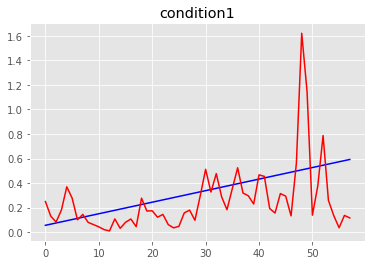

MSE condition1: 0.06843220311842557
R2 condition1: -1.757859648171031


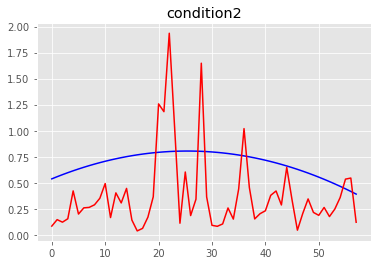

MSE condition2: 0.22265722785420666
R2 condition2: -16.62304962731629


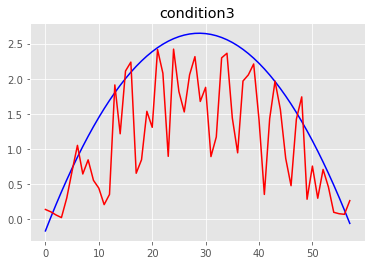

MSE condition3: 0.6298028225740852
R2 condition3: 0.13065341709508338


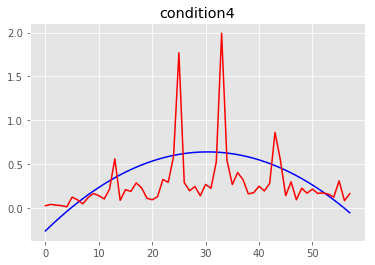

MSE condition4: 0.11722039741438654
R2 condition4: -0.8389474875683649
==== the test person number # 14 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.76691850e-09 4.06175050e-09 3.31634017e-09 3.43576569e-09]
Global min values from training is:  [-3.75419309e-09 -4.07

n_neighbors: 28 weights_type:uniform All_MSE: 0.36365154146094725 All_R2: -6.305040548186315
The best neighbors is: 28 The best weigths :uniform The best mse: 0.36365154146094725
n_neighbors: 28 weights_type:distance All_MSE: 0.37548331498172444 All_R2: -6.542717487431509
n_neighbors: 29 weights_type:uniform All_MSE: 0.3530091411327742 All_R2: -6.09125576505297
The best neighbors is: 29 The best weigths :uniform The best mse: 0.3530091411327742
n_neighbors: 29 weights_type:distance All_MSE: 0.3658812573408086 All_R2: -6.3498311321829775
n_neighbors: 30 weights_type:uniform All_MSE: 0.3408248739484052 All_R2: -5.84649792496745
The best neighbors is: 30 The best weigths :uniform The best mse: 0.3408248739484052
n_neighbors: 30 weights_type:distance All_MSE: 0.3549344265061401 All_R2: -6.129930942017064
n_neighbors: 31 weights_type:uniform All_MSE: 0.3324523450365291 All_R2: -5.678310371172396
The best neighbors is: 31 The best weigths :uniform The best mse: 0.3324523450365291
n_neighbors

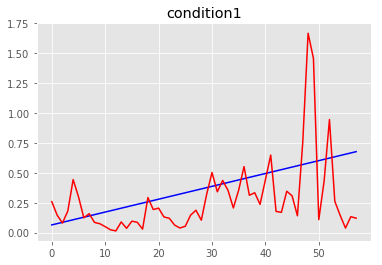

MSE condition1: 0.0911144739031111
R2 condition1: -1.8125334552868058


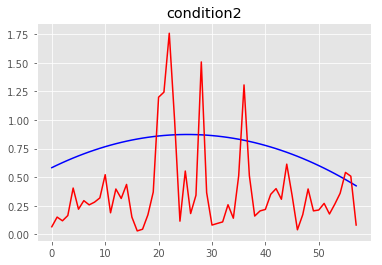

MSE condition2: 0.2547956218349507
R2 condition2: -16.105408601153773


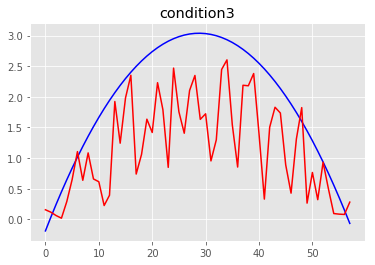

MSE condition3: 1.0191826401820645
R2 condition3: -0.06773568636048832


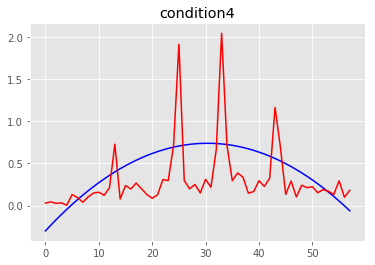

MSE condition4: 0.15083404542889792
R2 condition4: -0.7780552830585494
==== the test person number # 14 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.14662817e-09 4.38612130e-09 3.65383485e-09 3.71014406e-09]
Global min values from training is:  [-4.12896076e-09 -4.39

n_neighbors: 25 weights_type:uniform All_MSE: 0.004979208611988136 All_R2: -1.6867347762855296
The best neighbors is: 25 The best weigths :uniform The best mse: 0.004979208611988136
n_neighbors: 25 weights_type:distance All_MSE: 0.0049677867405026645 All_R2: -1.680571640389517
The best neighbors is: 25 The best weigths :distance The best mse: 0.0049677867405026645
n_neighbors: 26 weights_type:uniform All_MSE: 0.0048439337417363814 All_R2: -1.6137417112052979
The best neighbors is: 26 The best weigths :uniform The best mse: 0.0048439337417363814
n_neighbors: 26 weights_type:distance All_MSE: 0.004854210235291203 All_R2: -1.6192868117952863
n_neighbors: 27 weights_type:uniform All_MSE: 0.004757594620844398 All_R2: -1.567153922516165
The best neighbors is: 27 The best weigths :uniform The best mse: 0.004757594620844398
n_neighbors: 27 weights_type:distance All_MSE: 0.0047804577125918745 All_R2: -1.5794906347285154
n_neighbors: 28 weights_type:uniform All_MSE: 0.004673244163970515 All_R2: 

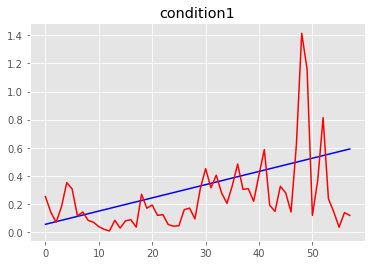

MSE condition1: 0.062317602877819164
R2 condition1: -1.5192222802009998


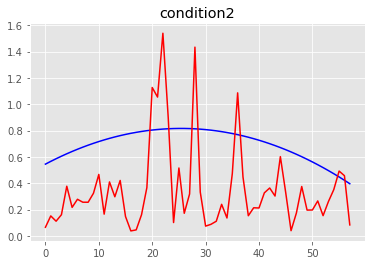

MSE condition2: 0.2138397277289281
R2 condition2: -15.446402768991504


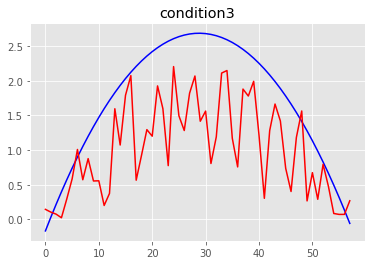

MSE condition3: 0.8278641749587735
R2 condition3: -0.10876430470837795


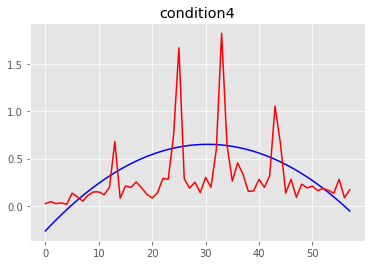

MSE condition4: 0.1136045485918577
R2 condition4: -0.7220337284016305
==== the test person number # 14 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.97904517e-09 4.29517726e-09 3.56737857e-09 3.65153522e-09]
Global min values from training is:  [-3.96538492e-09 -4.307

n_neighbors: 32 weights_type:distance All_MSE: 0.09437286083676287 All_R2: -0.7409065350067798
n_neighbors: 33 weights_type:uniform All_MSE: 0.0967135116390453 All_R2: -0.7840847775834314
n_neighbors: 33 weights_type:distance All_MSE: 0.09521859111009066 All_R2: -0.7565078143007935
n_neighbors: 34 weights_type:uniform All_MSE: 0.09556398446766275 All_R2: -0.762879323525095
n_neighbors: 34 weights_type:distance All_MSE: 0.09425262091713126 All_R2: -0.7386884559955116
n_neighbors: 35 weights_type:uniform All_MSE: 0.09405402230203642 All_R2: -0.7350248855177666
n_neighbors: 35 weights_type:distance All_MSE: 0.09303183763359257 All_R2: -0.7161685326055061
n_neighbors: 36 weights_type:uniform All_MSE: 0.09382957110746591 All_R2: -0.7308844096653522
n_neighbors: 36 weights_type:distance All_MSE: 0.09285086269926604 All_R2: -0.712830068103657
n_neighbors: 37 weights_type:uniform All_MSE: 0.09544650607944138 All_R2: -0.7607121867872315
n_neighbors: 37 weights_type:distance All_MSE: 0.094165378

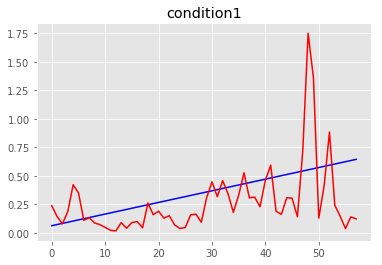

MSE condition1: 0.08659365618487899
R2 condition1: -1.9678881680934737


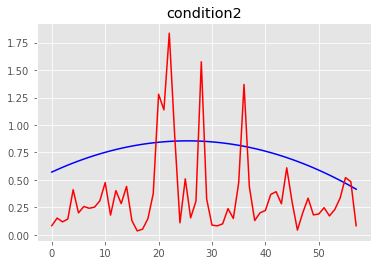

MSE condition2: 0.2590105987647653
R2 condition2: -17.128978461609226


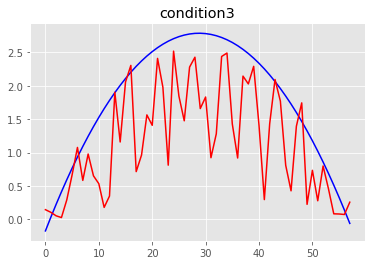

MSE condition3: 0.7497958032609183
R2 condition3: 0.06619564153533697


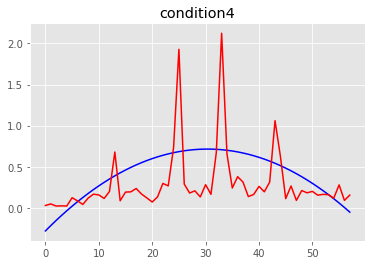

MSE condition4: 0.15469376734414314
R2 condition4: -0.9856811991830996
==== the test person number # 14 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.13495985e-09 4.34970896e-09 3.60456974e-09 3.75166167e-09]
Global min values from training is:  [-4.11622616e-09 -4.36

n_neighbors: 30 weights_type:uniform All_MSE: 0.01872232182169712 All_R2: 0.034597701734174535
n_neighbors: 30 weights_type:distance All_MSE: 0.018381169709717583 All_R2: 0.05218895115825006
n_neighbors: 31 weights_type:uniform All_MSE: 0.01863210089385488 All_R2: 0.03924987532247559
n_neighbors: 31 weights_type:distance All_MSE: 0.018318807102619742 All_R2: 0.05540463160597808
n_neighbors: 32 weights_type:uniform All_MSE: 0.018780358845244566 All_R2: 0.031605066715355457
n_neighbors: 32 weights_type:distance All_MSE: 0.018442188085418997 All_R2: 0.04904258498104197
n_neighbors: 33 weights_type:uniform All_MSE: 0.01897811941809181 All_R2: 0.021407693048172582
n_neighbors: 33 weights_type:distance All_MSE: 0.01860772887387406 All_R2: 0.040506600013298866
n_neighbors: 34 weights_type:uniform All_MSE: 0.01897975321971933 All_R2: 0.021323447308721044
n_neighbors: 34 weights_type:distance All_MSE: 0.018618910512671703 All_R2: 0.03993002730525397
n_neighbors: 35 weights_type:uniform All_MSE:

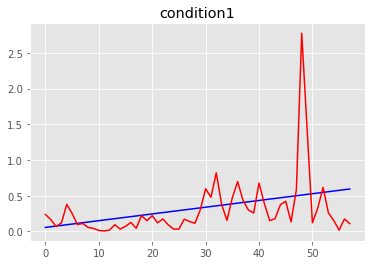

MSE condition1: 0.14874510694486331
R2 condition1: -4.964815754253254


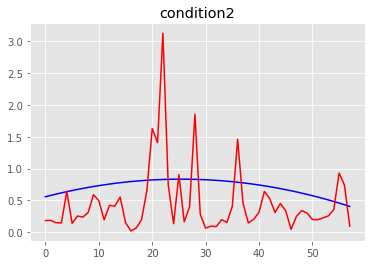

MSE condition2: 0.3243069655542485
R2 condition2: -22.9437846942206


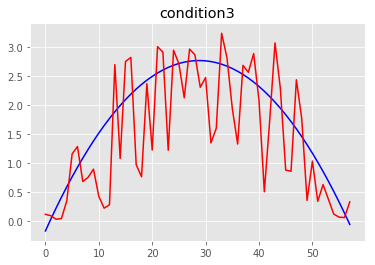

MSE condition3: 0.5625036417990023
R2 condition3: 0.2887735991178637


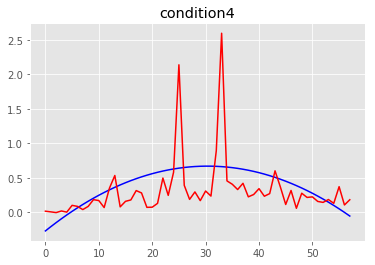

MSE condition4: 0.16588435137606117
R2 condition4: -1.3928697048510363
==== the test person number # 14 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [3.71879111e-09 3.96033493e-09 3.34927062e-09 3.45243146e-09]
Global min values from training is:  [-3.70883299e-09 -3.97

n_neighbors: 37 weights_type:distance All_MSE: 13.244765460857412 All_R2: -6.107452909693761
n_neighbors: 38 weights_type:uniform All_MSE: 13.314684257113672 All_R2: -6.144972981556299
n_neighbors: 38 weights_type:distance All_MSE: 13.251977443816052 All_R2: -6.111323029509436
n_neighbors: 39 weights_type:uniform All_MSE: 13.329507817853134 All_R2: -6.152927653175141
n_neighbors: 39 weights_type:distance All_MSE: 13.26629317276634 All_R2: -6.119005186636552
n_neighbors: 40 weights_type:uniform All_MSE: 13.344011125892802 All_R2: -6.16071046965697
n_neighbors: 40 weights_type:distance All_MSE: 13.280236744646906 All_R2: -6.126487635519995
n_neighbors: 41 weights_type:uniform All_MSE: 13.360059057920315 All_R2: -6.169322167728983
n_neighbors: 41 weights_type:distance All_MSE: 13.29536561681468 All_R2: -6.1346061444378766
n_neighbors: 42 weights_type:uniform All_MSE: 13.372607838805958 All_R2: -6.176056138933105
n_neighbors: 42 weights_type:distance All_MSE: 13.307559397139325 All_R2: -6.

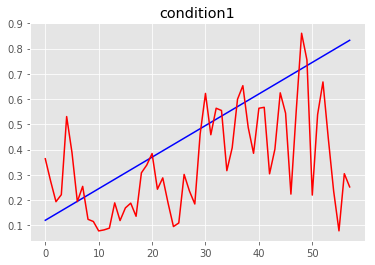

MSE condition1: 0.05983960947172549
R2 condition1: -0.365452846647605


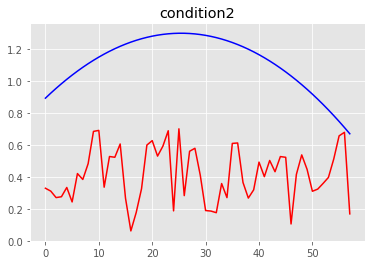

MSE condition2: 0.5442568334470436
R2 condition2: -17.643849014528715


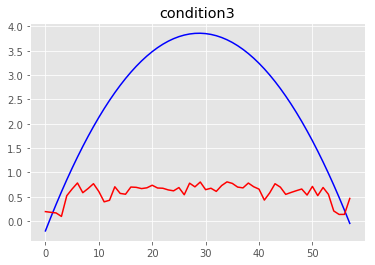

MSE condition3: 4.813130654873871
R2 condition3: -2.18968285080233


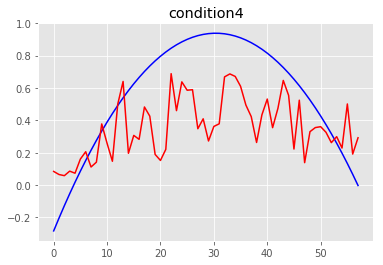

MSE condition4: 0.1109139769199583
R2 condition4: 0.051113621978045254
==== the test person number # 14 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.07598495e-09 4.27130693e-09 3.56404619e-09 3.74131110e-09]
Global min values from training is:  [-4.05930739e-09 -4.28

n_neighbors: 28 weights_type:uniform All_MSE: 0.021423998714978652 All_R2: -0.30076120057195266
n_neighbors: 28 weights_type:distance All_MSE: 0.02071621471285955 All_R2: -0.25778799185446033
n_neighbors: 29 weights_type:uniform All_MSE: 0.021766815584071605 All_R2: -0.3215753766811913
n_neighbors: 29 weights_type:distance All_MSE: 0.020993216673889526 All_R2: -0.27460620624028476
n_neighbors: 30 weights_type:uniform All_MSE: 0.021660631597886122 All_R2: -0.31512840050323
n_neighbors: 30 weights_type:distance All_MSE: 0.020910850169098702 All_R2: -0.26960531191220016
n_neighbors: 31 weights_type:uniform All_MSE: 0.02184669220064229 All_R2: -0.3264250970835487
n_neighbors: 31 weights_type:distance All_MSE: 0.021068428917288523 All_R2: -0.27917272854655195
n_neighbors: 32 weights_type:uniform All_MSE: 0.022057658214160097 All_R2: -0.3392339293036255
n_neighbors: 32 weights_type:distance All_MSE: 0.021262247961184734 All_R2: -0.2909404800100488
n_neighbors: 33 weights_type:uniform All_MSE

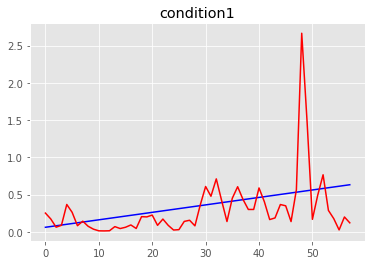

MSE condition1: 0.1397409826189466
R2 condition1: -3.9635325660090137


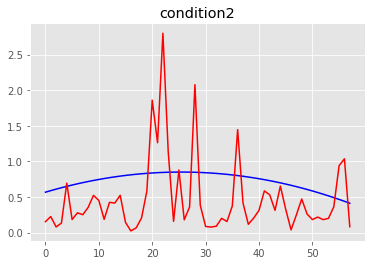

MSE condition2: 0.3263659951202333
R2 condition2: -22.085135569182743


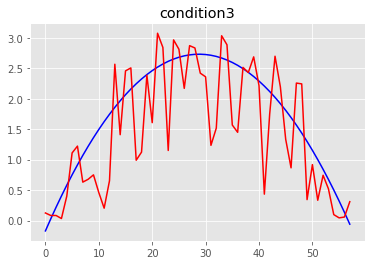

MSE condition3: 0.47361094880834337
R2 condition3: 0.3858157455620185


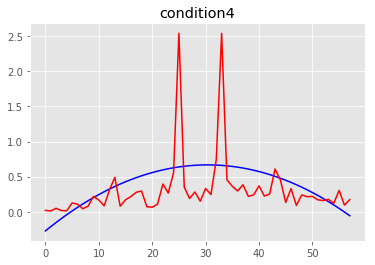

MSE condition4: 0.18597517270634967
R2 condition4: -1.6767450685622456
==== the test person number # 14 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 15] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.13033600e-09 4.35985303e-09 3.61076834e-09 3.81043312e-09]
Global min values from training is:  [-4.11526597e-09 -4.37

n_neighbors: 28 weights_type:distance All_MSE: 0.004588300485331529 All_R2: -0.050154868612812153
n_neighbors: 29 weights_type:uniform All_MSE: 0.004528146395868041 All_R2: -0.03638700181354593
The best neighbors is: 29 The best weigths :uniform The best mse: 0.004528146395868041
n_neighbors: 29 weights_type:distance All_MSE: 0.0045314618501929894 All_R2: -0.03714583191025378
n_neighbors: 30 weights_type:uniform All_MSE: 0.004503849647663276 All_R2: -0.03082604334967387
The best neighbors is: 30 The best weigths :uniform The best mse: 0.004503849647663276
n_neighbors: 30 weights_type:distance All_MSE: 0.004505352896695144 All_R2: -0.031170101960176888
n_neighbors: 31 weights_type:uniform All_MSE: 0.004462863571261312 All_R2: -0.021445287268754498
The best neighbors is: 31 The best weigths :uniform The best mse: 0.004462863571261312
n_neighbors: 31 weights_type:distance All_MSE: 0.004470360965451526 All_R2: -0.023161265774506834
n_neighbors: 32 weights_type:uniform All_MSE: 0.0043787569

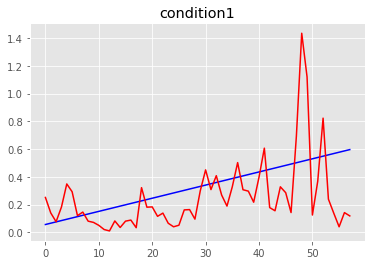

MSE condition1: 0.06306097559425385
R2 condition1: -1.5122307394157293


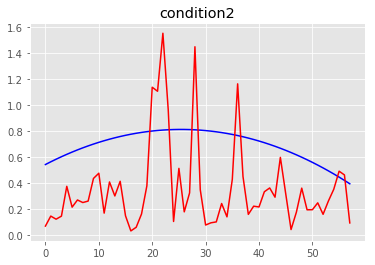

MSE condition2: 0.21190953261410586
R2 condition2: -15.479982980884298


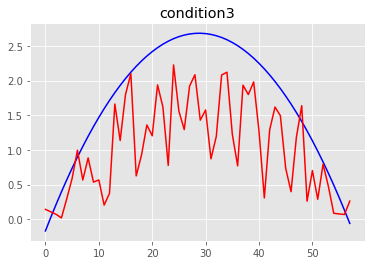

MSE condition3: 0.7947350807753746
R2 condition3: -0.06822033324721422


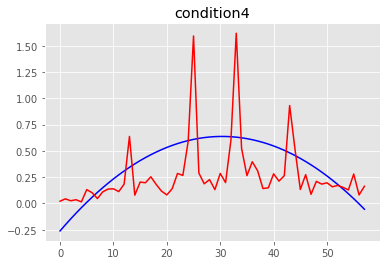

MSE condition4: 0.0993503145226497
R2 condition4: -0.5659943855623497
==== the test person number # 14 ====
==== the validated person number # 15 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.17740987e-09 4.41598594e-09 3.69590043e-09 3.86580159e-09]
Global min values from training is:  [-4.16142891e-09 -4.430

n_neighbors: 24 weights_type:distance All_MSE: 0.0028425154593086726 All_R2: 0.25583260287226794
n_neighbors: 25 weights_type:uniform All_MSE: 0.0028861727672733948 All_R2: 0.2444031680288027
n_neighbors: 25 weights_type:distance All_MSE: 0.0028283162255968103 All_R2: 0.25954994652222474
The best neighbors is: 25 The best weigths :distance The best mse: 0.0028283162255968103
n_neighbors: 26 weights_type:uniform All_MSE: 0.0028790297658568354 All_R2: 0.2462731978836742
n_neighbors: 26 weights_type:distance All_MSE: 0.0028219813159133253 All_R2: 0.2612084188569168
The best neighbors is: 26 The best weigths :distance The best mse: 0.0028219813159133253
n_neighbors: 27 weights_type:uniform All_MSE: 0.002894984114066076 All_R2: 0.24209636720334848
n_neighbors: 27 weights_type:distance All_MSE: 0.0028383647520013183 All_R2: 0.25691925344545574
n_neighbors: 28 weights_type:uniform All_MSE: 0.0028499456262569478 All_R2: 0.25388739339943456
n_neighbors: 28 weights_type:distance All_MSE: 0.00280

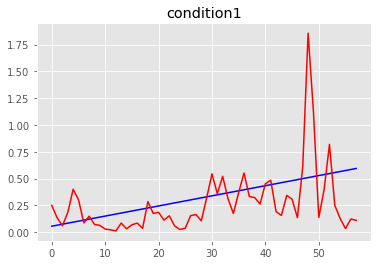

MSE condition1: 0.07992360364869319
R2 condition1: -2.2004200506061227


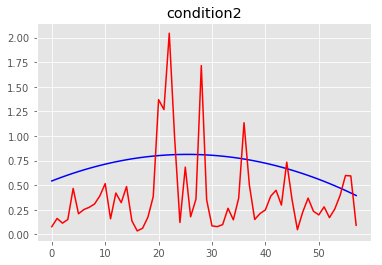

MSE condition2: 0.23356822743326425
R2 condition2: -17.118297091820942


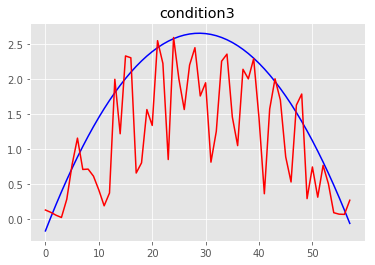

MSE condition3: 0.6118748151075973
R2 condition3: 0.16117291895078745


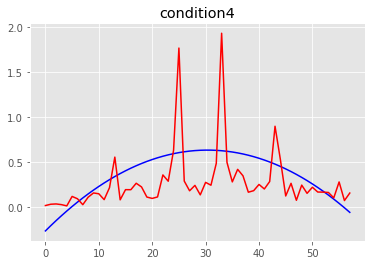

MSE condition4: 0.11290553333027763
R2 condition4: -0.7961004875155795
==== the test person number # 15 ====
==== the validated person number # 0 ====
==== the set of subject training data # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.30993808e-09 4.12261209e-09 3.87308245e-09 3.85699694e-09]
Global min values from training is:  [-4.30063731e-09 -4.13

n_neighbors: 28 weights_type:distance All_MSE: 0.08598780511609083 All_R2: -0.7670752469038105
n_neighbors: 29 weights_type:uniform All_MSE: 0.08433770954722218 All_R2: -0.733165286871259
The best neighbors is: 29 The best weigths :uniform The best mse: 0.08433770954722218
n_neighbors: 29 weights_type:distance All_MSE: 0.08561927942253082 All_R2: -0.7595019331058974
n_neighbors: 30 weights_type:uniform All_MSE: 0.0826896000177727 All_R2: -0.6992961405458635
The best neighbors is: 30 The best weigths :uniform The best mse: 0.0826896000177727
n_neighbors: 30 weights_type:distance All_MSE: 0.08424563214012902 All_R2: -0.7312730684729207
n_neighbors: 31 weights_type:uniform All_MSE: 0.0820464196112774 All_R2: -0.6860785898236776
The best neighbors is: 31 The best weigths :uniform The best mse: 0.0820464196112774
n_neighbors: 31 weights_type:distance All_MSE: 0.08367463386329868 All_R2: -0.7195388822165161
n_neighbors: 32 weights_type:uniform All_MSE: 0.08117394481161724 All_R2: -0.66814897

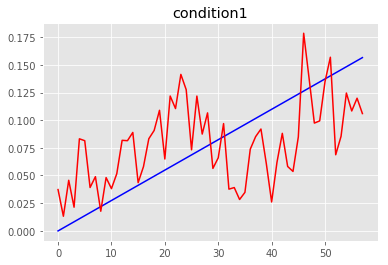

MSE condition1: 0.0018588471440400569
R2 condition1: 0.12472871935148888


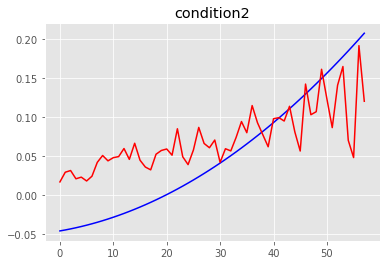

MSE condition2: 0.003078359411389651
R2 condition2: 0.4640864227804158


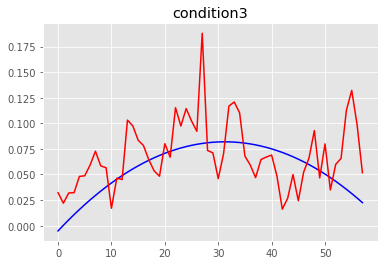

MSE condition3: 0.0012307701042044137
R2 condition3: -1.1716587447095757


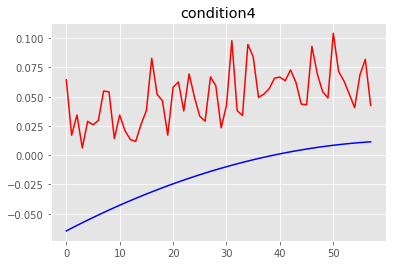

MSE condition4: 0.005003133816075727
R2 condition4: -8.605634408524029
==== the test person number # 15 ====
==== the validated person number # 1 ====
==== the set of subject training data # [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.36537212e-09 4.59383674e-09 4.03474151e-09 4.07208662e-09]
Global min values from training is:  [-4.35296145e-09 -4.60

n_neighbors: 25 weights_type:uniform All_MSE: 0.012415867839733842 All_R2: -0.4833615546063357
The best neighbors is: 25 The best weigths :uniform The best mse: 0.012415867839733842
n_neighbors: 25 weights_type:distance All_MSE: 0.012426923295363195 All_R2: -0.484682383569798
n_neighbors: 26 weights_type:uniform All_MSE: 0.012273142382567439 All_R2: -0.4663097094387574
The best neighbors is: 26 The best weigths :uniform The best mse: 0.012273142382567439
n_neighbors: 26 weights_type:distance All_MSE: 0.01231061360328844 All_R2: -0.4707865103309046
n_neighbors: 27 weights_type:uniform All_MSE: 0.012085424392184366 All_R2: -0.44388246926219144
The best neighbors is: 27 The best weigths :uniform The best mse: 0.012085424392184366
n_neighbors: 27 weights_type:distance All_MSE: 0.012148823147804612 All_R2: -0.451456911734589
n_neighbors: 28 weights_type:uniform All_MSE: 0.011879500737966371 All_R2: -0.41928014296539584
The best neighbors is: 28 The best weigths :uniform The best mse: 0.0118

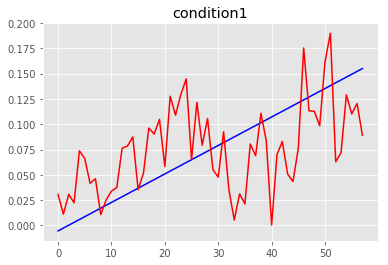

MSE condition1: 0.0021627228872015515
R2 condition1: 0.025204532887605158


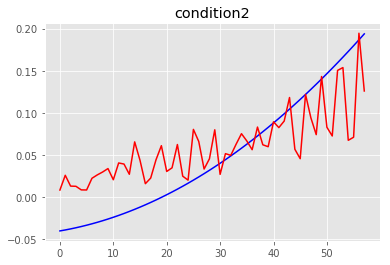

MSE condition2: 0.002088830242309379
R2 condition2: 0.5720841686980213


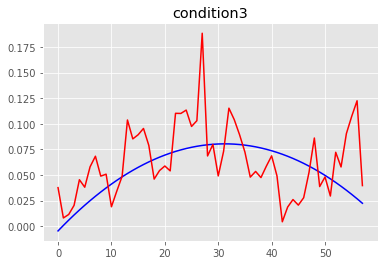

MSE condition3: 0.0011996278949350653
R2 condition3: -1.2206452477706886


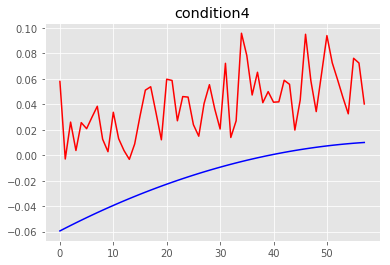

MSE condition4: 0.003675299388176836
R2 condition4: -7.477604587164109
==== the test person number # 15 ====
==== the validated person number # 2 ====
==== the set of subject training data # [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.41863563e-09 4.63724104e-09 4.09442967e-09 4.03228943e-09]
Global min values from training is:  [-4.40843365e-09 -4.64

n_neighbors: 28 weights_type:uniform All_MSE: 0.004750843983288184 All_R2: -0.45819031745936556
n_neighbors: 28 weights_type:distance All_MSE: 0.004717275322463386 All_R2: -0.4478869910699945
The best neighbors is: 28 The best weigths :distance The best mse: 0.004717275322463386
n_neighbors: 29 weights_type:uniform All_MSE: 0.004713076521668785 All_R2: -0.4465982409689251
The best neighbors is: 29 The best weigths :uniform The best mse: 0.004713076521668785
n_neighbors: 29 weights_type:distance All_MSE: 0.00468590531248713 All_R2: -0.4382585029599051
The best neighbors is: 29 The best weigths :distance The best mse: 0.00468590531248713
n_neighbors: 30 weights_type:uniform All_MSE: 0.00465733630318481 All_R2: -0.4294897341073409
The best neighbors is: 30 The best weigths :uniform The best mse: 0.00465733630318481
n_neighbors: 30 weights_type:distance All_MSE: 0.004639220250895608 All_R2: -0.4239293216560742
The best neighbors is: 30 The best weigths :distance The best mse: 0.00463922025

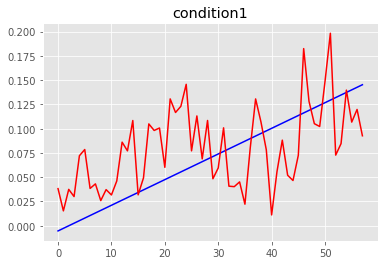

MSE condition1: 0.002053850008462023
R2 condition1: -0.049126170466488706


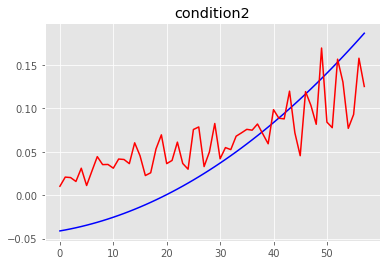

MSE condition2: 0.0021833476924259
R2 condition2: 0.52958975130719


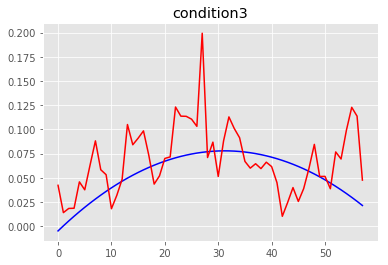

MSE condition3: 0.00134516531889293
R2 condition3: -1.6228198443005262


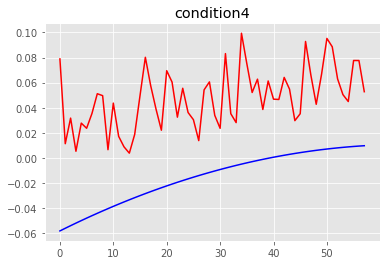

MSE condition4: 0.004513757801691194
R2 condition4: -9.880682336543316
==== the test person number # 15 ====
==== the validated person number # 3 ====
==== the set of subject training data # [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.40660245e-09 4.59851420e-09 4.08731627e-09 4.02957058e-09]
Global min values from training is:  [-4.39766730e-09 -4.60

n_neighbors: 23 weights_type:distance All_MSE: 0.007035293741352599 All_R2: 0.33444582825784885
The best neighbors is: 23 The best weigths :distance The best mse: 0.007035293741352599
n_neighbors: 24 weights_type:uniform All_MSE: 0.007073174925250878 All_R2: 0.3308621854277225
n_neighbors: 24 weights_type:distance All_MSE: 0.007042615010602673 All_R2: 0.33375322017764986
n_neighbors: 25 weights_type:uniform All_MSE: 0.00707669756656808 All_R2: 0.33052893585628895
n_neighbors: 25 weights_type:distance All_MSE: 0.007042481546734442 All_R2: 0.3337658461514248
n_neighbors: 26 weights_type:uniform All_MSE: 0.007030236013383729 All_R2: 0.33492430038324594
The best neighbors is: 26 The best weigths :uniform The best mse: 0.007030236013383729
n_neighbors: 26 weights_type:distance All_MSE: 0.007003427590288739 All_R2: 0.33746043582899476
The best neighbors is: 26 The best weigths :distance The best mse: 0.007003427590288739
n_neighbors: 27 weights_type:uniform All_MSE: 0.007005227075982843 All_

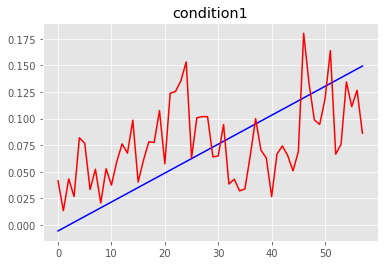

MSE condition1: 0.0019786231597658595
R2 condition1: 0.04291447849352037


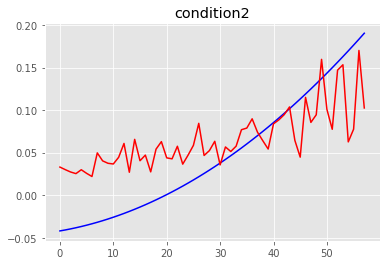

MSE condition2: 0.002584711280881579
R2 condition2: 0.4649636999572201


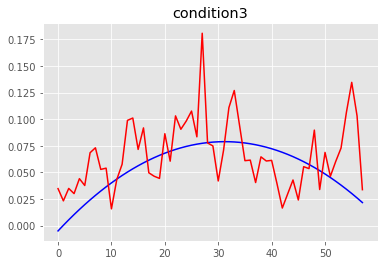

MSE condition3: 0.0012220530052635102
R2 condition3: -1.321019299081792


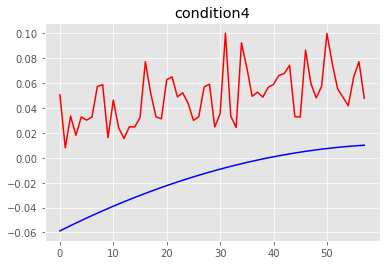

MSE condition4: 0.004575647254779096
R2 condition4: -9.740467270444341
==== the test person number # 15 ====
==== the validated person number # 4 ====
==== the set of subject training data # [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.49281527e-09 4.71933007e-09 4.07319103e-09 4.11385136e-09]
Global min values from training is:  [-4.48148183e-09 -4.73

n_neighbors: 29 weights_type:uniform All_MSE: 0.003688329671804457 All_R2: -4.750603897241686
n_neighbors: 29 weights_type:distance All_MSE: 0.0036531416421232833 All_R2: -4.695741008447417
n_neighbors: 30 weights_type:uniform All_MSE: 0.0036921672189597432 All_R2: -4.756587151340619
n_neighbors: 30 weights_type:distance All_MSE: 0.0036543763345590033 All_R2: -4.697666060643002
n_neighbors: 31 weights_type:uniform All_MSE: 0.0037108581598267014 All_R2: -4.785728851502161
n_neighbors: 31 weights_type:distance All_MSE: 0.0036702323850927136 All_R2: -4.722387784053753
n_neighbors: 32 weights_type:uniform All_MSE: 0.0037184693454560287 All_R2: -4.7975957174380435
n_neighbors: 32 weights_type:distance All_MSE: 0.003674500883523978 All_R2: -4.7290429493720385
n_neighbors: 33 weights_type:uniform All_MSE: 0.003753333776727617 All_R2: -4.8519540726247214
n_neighbors: 33 weights_type:distance All_MSE: 0.0037027060635679604 All_R2: -4.773018632869977
n_neighbors: 34 weights_type:uniform All_MSE:

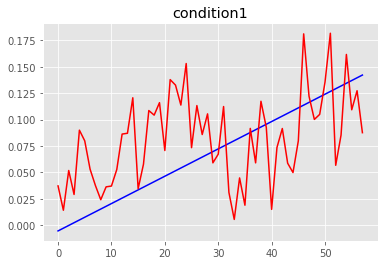

MSE condition1: 0.002338250677127015
R2 condition1: -0.24811455497092805


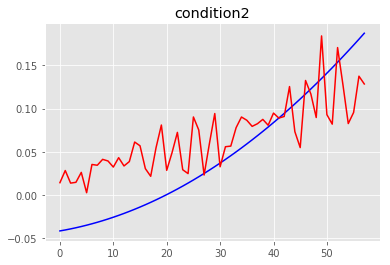

MSE condition2: 0.002329761145256274
R2 condition2: 0.4996669831674758


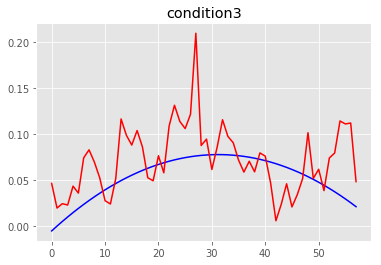

MSE condition3: 0.0015416673155610097
R2 condition3: -2.013078665974143


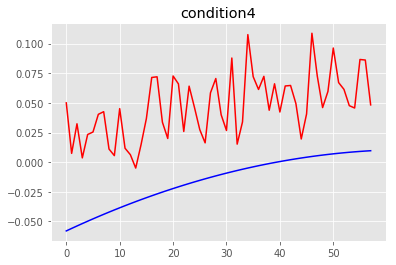

MSE condition4: 0.004442832897553147
R2 condition4: -9.80868202722641
==== the test person number # 15 ====
==== the validated person number # 5 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.47331750e-09 4.44020738e-09 4.06625252e-09 4.06904821e-09]
Global min values from training is:  [-4.46293328e-09 -4.434

n_neighbors: 29 weights_type:distance All_MSE: 0.005956008462171634 All_R2: -5.023955969044361
n_neighbors: 30 weights_type:uniform All_MSE: 0.005796721104451563 All_R2: -4.862851424713129
The best neighbors is: 30 The best weigths :uniform The best mse: 0.005796721104451563
n_neighbors: 30 weights_type:distance All_MSE: 0.0058499138154337535 All_R2: -4.916650970309138
n_neighbors: 31 weights_type:uniform All_MSE: 0.005899862382945192 All_R2: -4.967169362503637
n_neighbors: 31 weights_type:distance All_MSE: 0.005949491797793965 All_R2: -5.017364961068895
n_neighbors: 32 weights_type:uniform All_MSE: 0.005796297098975225 All_R2: -4.862422582085333
The best neighbors is: 32 The best weigths :uniform The best mse: 0.005796297098975225
n_neighbors: 32 weights_type:distance All_MSE: 0.005848605734075306 All_R2: -4.915327966059352
n_neighbors: 33 weights_type:uniform All_MSE: 0.005626750475231634 All_R2: -4.6909417316771505
The best neighbors is: 33 The best weigths :uniform The best mse: 0.

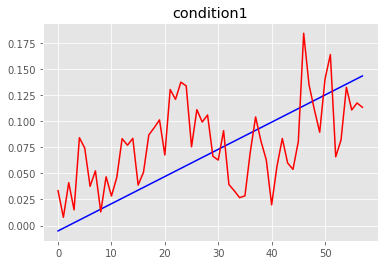

MSE condition1: 0.0018643572465697686
R2 condition1: 0.018372836001223414


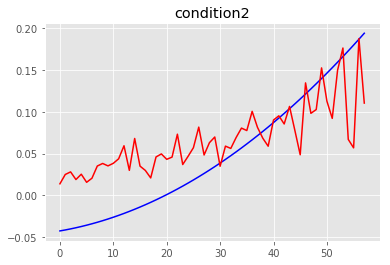

MSE condition2: 0.00242546299462499
R2 condition2: 0.5168758738454569


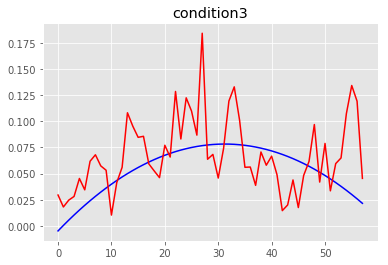

MSE condition3: 0.0013931516277419765
R2 condition3: -1.700450841668684


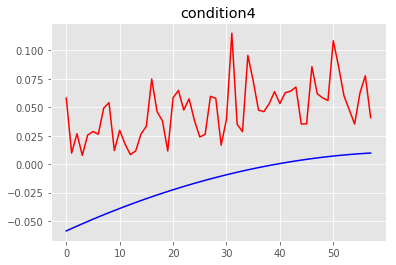

MSE condition4: 0.004444844753134545
R2 condition4: -9.555999253922907
==== the test person number # 15 ====
==== the validated person number # 6 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.47393418e-09 4.70678206e-09 4.08791363e-09 4.08822333e-09]
Global min values from training is:  [-4.46327341e-09 -4.71

n_neighbors: 26 weights_type:distance All_MSE: 0.003721469323274303 All_R2: -3.2725003866831655
n_neighbors: 27 weights_type:uniform All_MSE: 0.0036945235310487843 All_R2: -3.2415647809580266
The best neighbors is: 27 The best weigths :uniform The best mse: 0.0036945235310487843
n_neighbors: 27 weights_type:distance All_MSE: 0.0037016442231513494 All_R2: -3.2497398207390598
n_neighbors: 28 weights_type:uniform All_MSE: 0.0037138485524553845 All_R2: -3.263751222457352
n_neighbors: 28 weights_type:distance All_MSE: 0.00371624177581686 All_R2: -3.2664988059651288
n_neighbors: 29 weights_type:uniform All_MSE: 0.003622159793884731 All_R2: -3.1584862793883213
The best neighbors is: 29 The best weigths :uniform The best mse: 0.003622159793884731
n_neighbors: 29 weights_type:distance All_MSE: 0.0036386082772615854 All_R2: -3.177370259204694
n_neighbors: 30 weights_type:uniform All_MSE: 0.0035606122401614553 All_R2: -3.0878254934891824
The best neighbors is: 30 The best weigths :uniform The bes

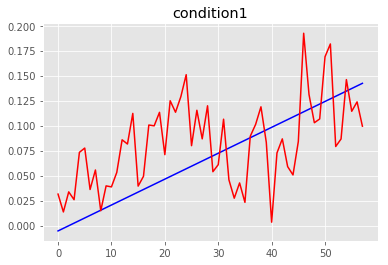

MSE condition1: 0.002081482872186911
R2 condition1: -0.10666884121150866


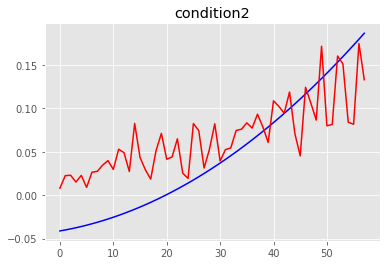

MSE condition2: 0.002235380623666658
R2 condition2: 0.5173385547468041


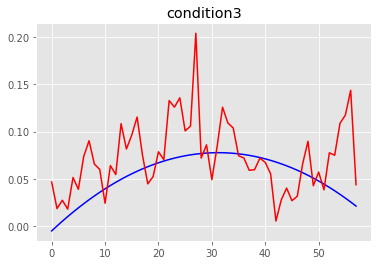

MSE condition3: 0.0016954372302802477
R2 condition3: -2.318235655019626


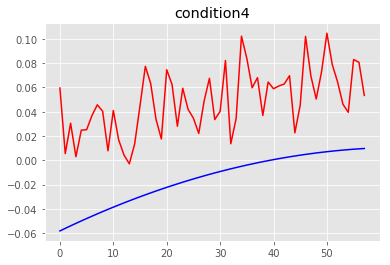

MSE condition4: 0.004589117827050967
R2 condition4: -10.102320228203814
==== the test person number # 15 ====
==== the validated person number # 7 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.06947682e-09 4.35624811e-09 3.73208211e-09 3.70214988e-09]
Global min values from training is:  [-4.06240913e-09 -4.3

n_neighbors: 28 weights_type:uniform All_MSE: 0.2518447796865358 All_R2: -4.804345306263196
The best neighbors is: 28 The best weigths :uniform The best mse: 0.2518447796865358
n_neighbors: 28 weights_type:distance All_MSE: 0.2563776675048998 All_R2: -4.908816187752527
n_neighbors: 29 weights_type:uniform All_MSE: 0.243858470293549 All_R2: -4.620282338997225
The best neighbors is: 29 The best weigths :uniform The best mse: 0.243858470293549
n_neighbors: 29 weights_type:distance All_MSE: 0.2493904144331103 All_R2: -4.747778783596705
n_neighbors: 30 weights_type:uniform All_MSE: 0.2413632394027019 All_R2: -4.562773973219867
The best neighbors is: 30 The best weigths :uniform The best mse: 0.2413632394027019
n_neighbors: 30 weights_type:distance All_MSE: 0.2469720226602422 All_R2: -4.692041352973669
n_neighbors: 31 weights_type:uniform All_MSE: 0.2343491919171617 All_R2: -4.4011190298405545
The best neighbors is: 31 The best weigths :uniform The best mse: 0.2343491919171617
n_neighbors: 3

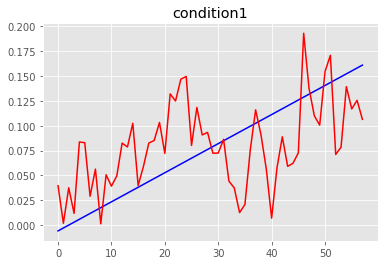

MSE condition1: 0.002282588536258581
R2 condition1: 0.04921046441060828


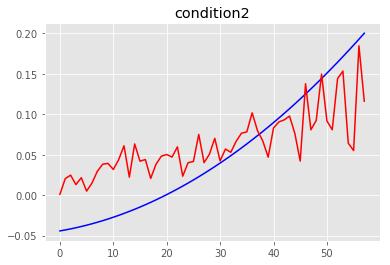

MSE condition2: 0.002519120799476881
R2 condition2: 0.5287416683785372


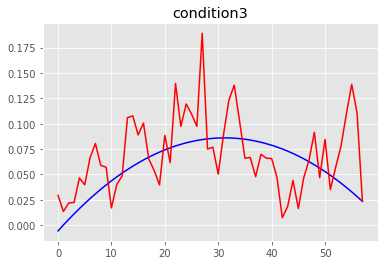

MSE condition3: 0.0014221065470448398
R2 condition3: -1.264886154782428


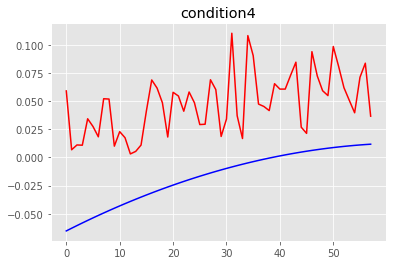

MSE condition4: 0.004795112560581498
R2 condition4: -7.964447096317398
==== the test person number # 15 ====
==== the validated person number # 8 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.44918650e-09 4.68061890e-09 4.06957679e-09 3.97652825e-09]
Global min values from training is:  [-4.43717680e-09 -4.69

n_neighbors: 31 weights_type:uniform All_MSE: 0.004603220215437185 All_R2: -2.8318985347802315
The best neighbors is: 31 The best weigths :uniform The best mse: 0.004603220215437185
n_neighbors: 31 weights_type:distance All_MSE: 0.004548539465727059 All_R2: -2.7863801639683725
The best neighbors is: 31 The best weigths :distance The best mse: 0.004548539465727059
n_neighbors: 32 weights_type:uniform All_MSE: 0.004560654577454279 All_R2: -2.7964652515165516
n_neighbors: 32 weights_type:distance All_MSE: 0.004509903251821015 All_R2: -2.7542178852749633
The best neighbors is: 32 The best weigths :distance The best mse: 0.004509903251821015
n_neighbors: 33 weights_type:uniform All_MSE: 0.004473270797366698 All_R2: -2.7237236134436578
The best neighbors is: 33 The best weigths :uniform The best mse: 0.004473270797366698
n_neighbors: 33 weights_type:distance All_MSE: 0.004435395389347788 All_R2: -2.692194658994522
The best neighbors is: 33 The best weigths :distance The best mse: 0.004435395

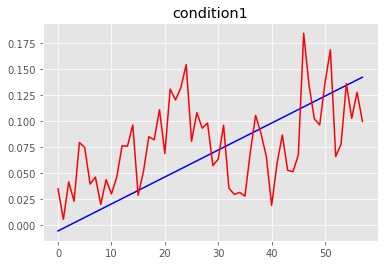

MSE condition1: 0.0019567399991348125
R2 condition1: -0.04331407981697066


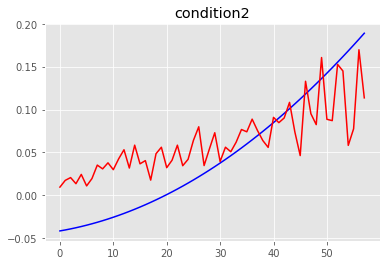

MSE condition2: 0.0021830852214086306
R2 condition2: 0.5403153437223835


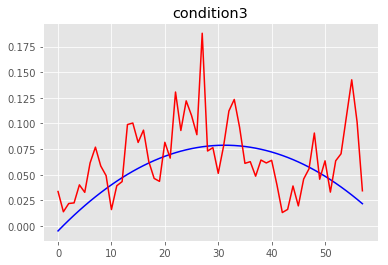

MSE condition3: 0.0013303039179348142
R2 condition3: -1.5446601032749627


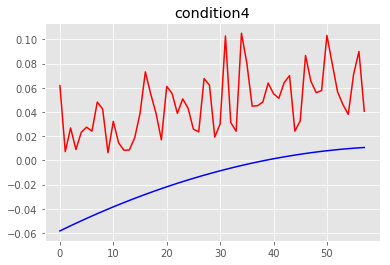

MSE condition4: 0.004270124650937829
R2 condition4: -9.013479274559534
==== the test person number # 15 ====
==== the validated person number # 9 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.28160350e-09 4.58967486e-09 3.98312051e-09 3.91791941e-09]
Global min values from training is:  [-4.27360096e-09 -4.59

n_neighbors: 32 weights_type:uniform All_MSE: 0.06778736617973653 All_R2: -0.45365286867450383
n_neighbors: 32 weights_type:distance All_MSE: 0.06661310627236815 All_R2: -0.42847168257576174
n_neighbors: 33 weights_type:uniform All_MSE: 0.06718847047795264 All_R2: -0.4408099673494006
n_neighbors: 33 weights_type:distance All_MSE: 0.06610699477623841 All_R2: -0.4176184739370399
n_neighbors: 34 weights_type:uniform All_MSE: 0.06786313719463553 All_R2: -0.45527772533110067
n_neighbors: 34 weights_type:distance All_MSE: 0.06665121730138308 All_R2: -0.4292889470570047
n_neighbors: 35 weights_type:uniform All_MSE: 0.06753305786314519 All_R2: -0.44819940389523194
n_neighbors: 35 weights_type:distance All_MSE: 0.06640502727372323 All_R2: -0.4240095733312592
n_neighbors: 36 weights_type:uniform All_MSE: 0.06752288223393545 All_R2: -0.44798119461192587
n_neighbors: 36 weights_type:distance All_MSE: 0.06643062659028591 All_R2: -0.42455853285063005
n_neighbors: 37 weights_type:uniform All_MSE: 0.0

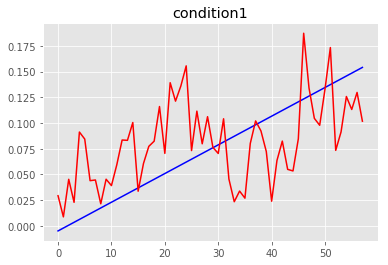

MSE condition1: 0.0020876183634920974
R2 condition1: 0.04332572160697812


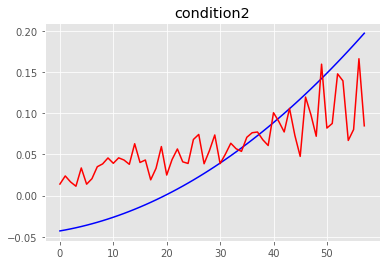

MSE condition2: 0.0025125892309720414
R2 condition2: 0.5126434543218138


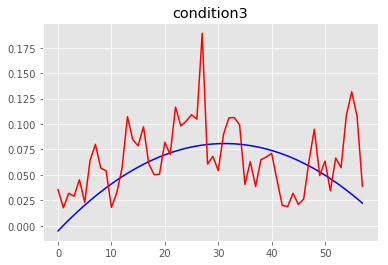

MSE condition3: 0.0012901559192392343
R2 condition3: -1.3362394193955422


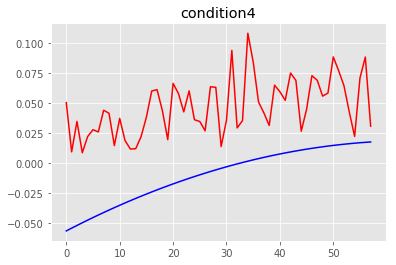

MSE condition4: 0.0037265494036331738
R2 condition4: -6.520264886989185
==== the test person number # 15 ====
==== the validated person number # 10 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43751818e-09 4.64420657e-09 4.02031168e-09 4.01804586e-09]
Global min values from training is:  [-4.42444219e-09 -4.6

n_neighbors: 29 weights_type:distance All_MSE: 0.011441384079308482 All_R2: 0.15480270149324227
n_neighbors: 30 weights_type:uniform All_MSE: 0.011671971446289255 All_R2: 0.13776876413994654
n_neighbors: 30 weights_type:distance All_MSE: 0.01141227965266587 All_R2: 0.15695270210526713
n_neighbors: 31 weights_type:uniform All_MSE: 0.011699673525749115 All_R2: 0.13572235764225404
n_neighbors: 31 weights_type:distance All_MSE: 0.01143580571929562 All_R2: 0.15521478579880255
n_neighbors: 32 weights_type:uniform All_MSE: 0.011803648828270069 All_R2: 0.12804149978511226
n_neighbors: 32 weights_type:distance All_MSE: 0.011505861008205992 All_R2: 0.15003966533062085
n_neighbors: 33 weights_type:uniform All_MSE: 0.011856373385163915 All_R2: 0.1241466342039248
n_neighbors: 33 weights_type:distance All_MSE: 0.011551252396403476 All_R2: 0.1466865151860185
n_neighbors: 34 weights_type:uniform All_MSE: 0.01192678711459936 All_R2: 0.1189450350368928
n_neighbors: 34 weights_type:distance All_MSE: 0.01

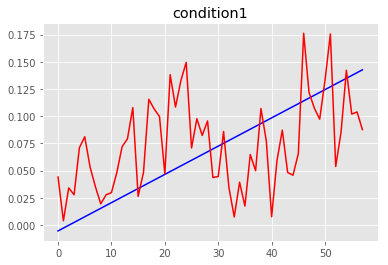

MSE condition1: 0.002208981772640509
R2 condition1: -0.1691002218317954


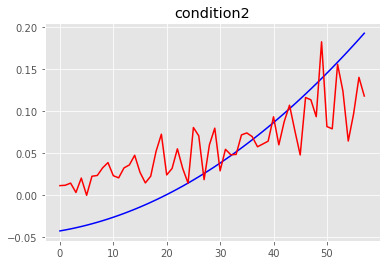

MSE condition2: 0.002030871231332899
R2 condition2: 0.5873506882857074


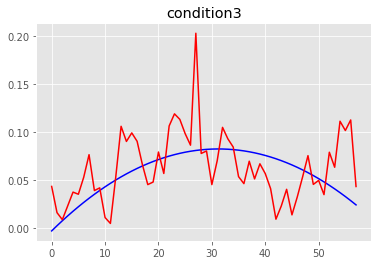

MSE condition3: 0.0012529438867757102
R2 condition3: -1.2947910215691252


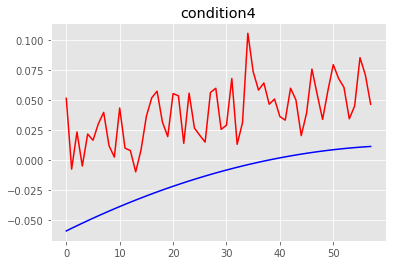

MSE condition4: 0.0034559356733427048
R2 condition4: -6.748324571148306
==== the test person number # 15 ====
==== the validated person number # 11 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.02134944e-09 4.25483254e-09 3.76501255e-09 3.71881565e-09]
Global min values from training is:  [-4.01704903e-09 -4.2

n_neighbors: 38 weights_type:uniform All_MSE: 7.6187048957479355 All_R2: -4.821111975081051
n_neighbors: 38 weights_type:distance All_MSE: 7.432263913658467 All_R2: -4.678660751633272
n_neighbors: 39 weights_type:uniform All_MSE: 7.651601088049813 All_R2: -4.846246485678765
n_neighbors: 39 weights_type:distance All_MSE: 7.4634236648987065 All_R2: -4.702468525207274
n_neighbors: 40 weights_type:uniform All_MSE: 7.6706037208802 All_R2: -4.860765548306951
n_neighbors: 40 weights_type:distance All_MSE: 7.483166141319051 All_R2: -4.717552869263225
n_neighbors: 41 weights_type:uniform All_MSE: 7.694891323205959 All_R2: -4.879322619971898
n_neighbors: 41 weights_type:distance All_MSE: 7.507179057301581 All_R2: -4.735900065367452
n_neighbors: 42 weights_type:uniform All_MSE: 7.708979674860741 All_R2: -4.890086899944546
n_neighbors: 42 weights_type:distance All_MSE: 7.52226936472174 All_R2: -4.747429894968827
n_neighbors: 43 weights_type:uniform All_MSE: 7.730741493006887 All_R2: -4.90671413278

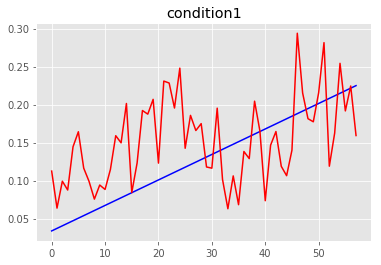

MSE condition1: 0.004274434821903675
R2 condition1: -0.35509644406621077


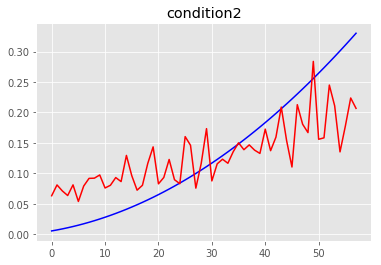

MSE condition2: 0.003941441112548554
R2 condition2: 0.582477404387342


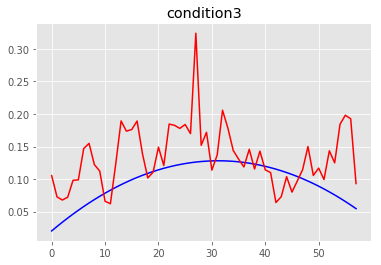

MSE condition3: 0.003529960229279555
R2 condition3: -3.059438642576894


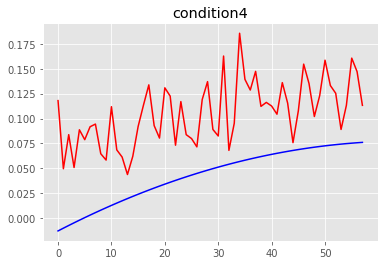

MSE condition4: 0.004650868768710326
R2 condition4: -5.541306459374555
==== the test person number # 15 ====
==== the validated person number # 12 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.37854328e-09 4.56580454e-09 3.97978813e-09 4.00769529e-09]
Global min values from training is:  [-4.36752342e-09 -4.57

n_neighbors: 28 weights_type:distance All_MSE: 0.01561864556246227 All_R2: -0.13242258888588276
n_neighbors: 29 weights_type:uniform All_MSE: 0.016084674955535016 All_R2: -0.16621183198572798
n_neighbors: 29 weights_type:distance All_MSE: 0.015667952526302792 All_R2: -0.13599756722949685
n_neighbors: 30 weights_type:uniform All_MSE: 0.015994444437097986 All_R2: -0.15966971046332423
n_neighbors: 30 weights_type:distance All_MSE: 0.015609459441208624 All_R2: -0.13175655346237125
n_neighbors: 31 weights_type:uniform All_MSE: 0.015886460482330347 All_R2: -0.15184038434621216
n_neighbors: 31 weights_type:distance All_MSE: 0.015524700825854347 All_R2: -0.1256111697127995
n_neighbors: 32 weights_type:uniform All_MSE: 0.01574337806256369 All_R2: -0.1414662604461452
n_neighbors: 32 weights_type:distance All_MSE: 0.015403752535684987 All_R2: -0.11684187052311268
n_neighbors: 33 weights_type:uniform All_MSE: 0.015659874542402853 All_R2: -0.1354118767863426
n_neighbors: 33 weights_type:distance Al

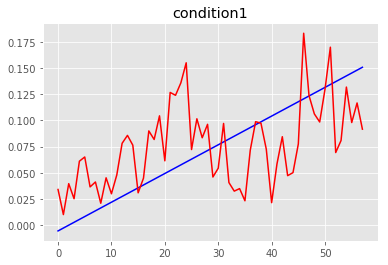

MSE condition1: 0.001927268711450142
R2 condition1: 0.08748266925247217


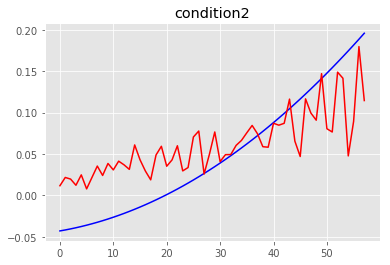

MSE condition2: 0.0023238207850685717
R2 condition2: 0.5451156154493417


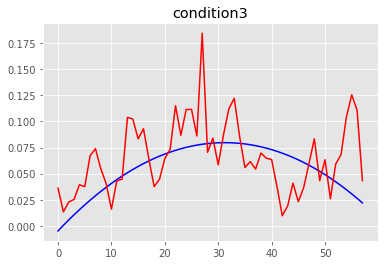

MSE condition3: 0.0012309498401561582
R2 condition3: -1.2979135999743523


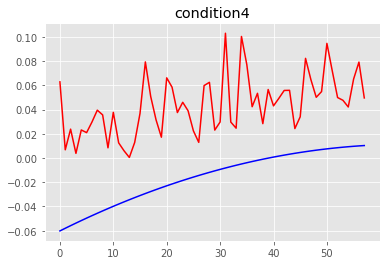

MSE condition4: 0.00405621746664048
R2 condition4: -8.075979720270999
==== the test person number # 15 ====
==== the validated person number # 13 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.43289432e-09 4.65435063e-09 4.02651028e-09 4.07681731e-09]
Global min values from training is:  [-4.42348201e-09 -4.667

n_neighbors: 23 weights_type:uniform All_MSE: 0.003870716058564202 All_R2: -0.48177708250405926
The best neighbors is: 23 The best weigths :uniform The best mse: 0.003870716058564202
n_neighbors: 23 weights_type:distance All_MSE: 0.0038698163323181893 All_R2: -0.48143265172905614
The best neighbors is: 23 The best weigths :distance The best mse: 0.0038698163323181893
n_neighbors: 24 weights_type:uniform All_MSE: 0.0038354718266874104 All_R2: -0.4682849807080778
The best neighbors is: 24 The best weigths :uniform The best mse: 0.0038354718266874104
n_neighbors: 24 weights_type:distance All_MSE: 0.0038378611419343867 All_R2: -0.46919965192711843
n_neighbors: 25 weights_type:uniform All_MSE: 0.0038249527332344896 All_R2: -0.4642580897216493
The best neighbors is: 25 The best weigths :uniform The best mse: 0.0038249527332344896
n_neighbors: 25 weights_type:distance All_MSE: 0.003826561583493573 All_R2: -0.46487398543888103
n_neighbors: 26 weights_type:uniform All_MSE: 0.0038296639339298693

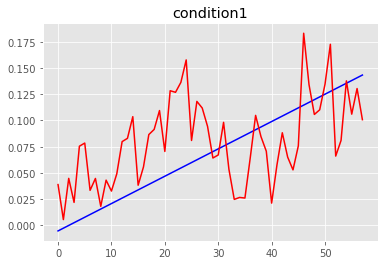

MSE condition1: 0.0020252291866132304
R2 condition1: -0.06538515334698358


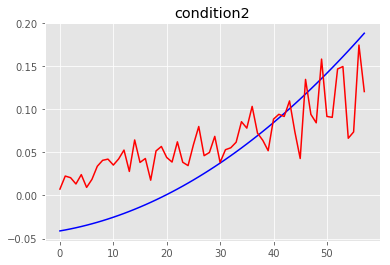

MSE condition2: 0.002214568912229228
R2 condition2: 0.5291353287011801


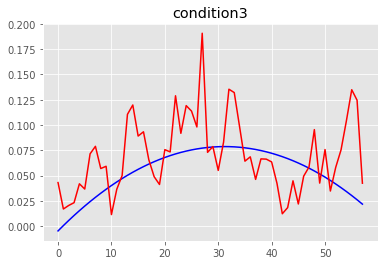

MSE condition3: 0.001547395779891785
R2 condition3: -1.967979367645254


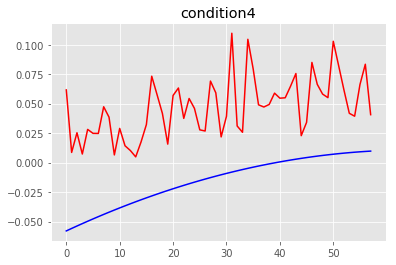

MSE condition4: 0.004366259749050163
R2 condition4: -9.60866012995596
==== the test person number # 15 ====
==== the validated person number # 14 ====
==== the set of subject training data # [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13] ==== 

==== the Dimension of training set ====
Dimension of training data # (14, 4, 58, 750) 

==== the Dimension of testing set ====
Dimension of testing data # (4, 58, 750) 

==== the Dimension of validation data ====
Dimension of validation data # (4, 58, 750) 

==== the Dimension of training set for constructing target signals ====
Dimension of training data # (14, 4, 58) 

==== the Dimension of validatio set for constructing target signals ====
Dimension of training data # (4, 58) 

==== the Dimension of testing set for constructing target signals ====
Dimension of training data # (4, 58) 

Global max values from training is:  [4.17740987e-09 4.41598594e-09 3.69590043e-09 3.86580159e-09]
Global min values from training is:  [-4.16142891e-09 -4.430

n_neighbors: 24 weights_type:distance All_MSE: 0.25492236315413935 All_R2: 0.5070229056680458
n_neighbors: 25 weights_type:uniform All_MSE: 0.2614835821785755 All_R2: 0.4943346085334932
n_neighbors: 25 weights_type:distance All_MSE: 0.2568104618654487 All_R2: 0.5033716394354697
n_neighbors: 26 weights_type:uniform All_MSE: 0.2631865091617846 All_R2: 0.4910414333657488
n_neighbors: 26 weights_type:distance All_MSE: 0.2577162517588025 All_R2: 0.5016199937023302
n_neighbors: 27 weights_type:uniform All_MSE: 0.2645169549115274 All_R2: 0.4884685744303484
n_neighbors: 27 weights_type:distance All_MSE: 0.2586651210250002 All_R2: 0.49978503968745547
n_neighbors: 28 weights_type:uniform All_MSE: 0.2660161673034069 All_R2: 0.48556934911488125
n_neighbors: 28 weights_type:distance All_MSE: 0.25970649198402646 All_R2: 0.4977712029131901
n_neighbors: 29 weights_type:uniform All_MSE: 0.2643520930957603 All_R2: 0.48878738953114054
n_neighbors: 29 weights_type:distance All_MSE: 0.2582309024195385 All_

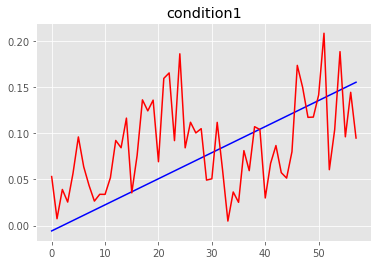

MSE condition1: 0.00283700336021311
R2 condition1: -0.26944617588926456


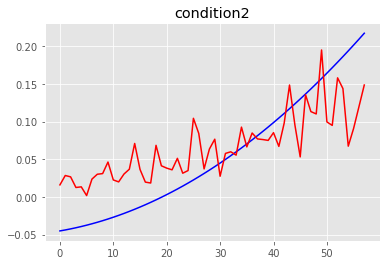

MSE condition2: 0.002620915905489924
R2 condition2: 0.5747721557332962


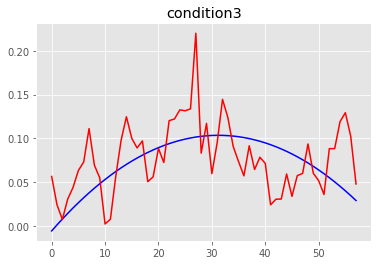

MSE condition3: 0.0015967941441939143
R2 condition3: -0.7936440185928766


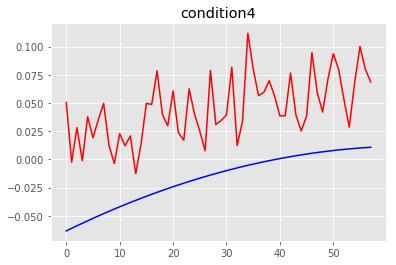

MSE condition4: 0.004396102636365284
R2 condition4: -7.895766188335262


In [3]:
## DATA pre-processing

#import datasetsJ
X_import = np.load('Extracted_timeseries_win3.npy')
print("Dimesion of dataset: ", X_import.shape)
print("'''''Import successfully'''''")

# Characteristic of the data
num_win = X_import.shape[2]
num_cond = int(X_import.shape[0]) 
person_num = int(X_import.shape[1])
smp_freq = 250  # 250 Hz
win_len = int(X_import.shape[3]/smp_freq) # 3s  Using sliding window size 3 secs

y_extractedFFT = np.load("PSD_amplitudes_win3.npy")
y_swapped = np.swapaxes(y_extractedFFT, 0, 1)
print(y_swapped.shape)

## Swapping dimension data to easily understand

X_swapped = np.swapaxes(X_import, 0, 1)
print("Dimension of data after applying swappaxes function", X_swapped.shape)

## Leave one out for testing and applying cross-validation training

#Manipulate training data set 
train_people = list(range(person_num))

# Leave one out for Testing
#Choose test person 
# all_person_num.remove(test_person_num)
for test_person_num in train_people:
    rest_of_training = [p for p in train_people if p != test_person_num]
    # Randomly leave ont for validation set
    for idx_run, vp in enumerate(rest_of_training):
        val_person_num = vp
        remain_person = [k for k in rest_of_training if k!= val_person_num]

        print("==== the test person number #", test_person_num, "====")
        print("==== the validated person number #", val_person_num, "====")

        #Check the remaining which use for training set
        num_train_people = int(len(remain_person))
        print("==== the set of subject training data #", remain_person, "====", "\n")
        
        #Slicing to get training data
        X_train = np.zeros((person_num-2, num_cond, X_swapped.shape[2], X_swapped.shape[3]))
        y_train = np.zeros((person_num-2, num_cond, y_swapped.shape[2]))

        for x, value in enumerate(remain_person):
            X_train[x,:,:,:] = X_swapped[value, :, :, :]
            y_train[x,:,:] = y_swapped[value, :, :]

        #Set up testing set as follwing (test_person_number) 
        X_test = np.zeros((num_cond, X_swapped.shape[2], X_swapped.shape[3]))
        X_test[:,:,:] = X_swapped[test_person_num,:,:,:]

        #Set up validation set as follwing (val_person_number) 
        X_val = np.zeros((num_cond, X_swapped.shape[2], X_swapped.shape[3]))
        X_val[:,:,:] = X_swapped[val_person_num,:,:,:]

        y_val = np.zeros((num_cond, y_swapped.shape[2]))
        y_test = np.zeros((num_cond, y_swapped.shape[2]))

        y_val[:,:] = y_swapped[val_person_num, :, :]
        y_test[:,:] = y_swapped[test_person_num, :, :]

        print("==== the Dimension of training set ====")
        print("Dimension of training data #", X_train.shape, "\n")

        print("==== the Dimension of testing set ====")
        print("Dimension of testing data #", X_test.shape, "\n")

        print("==== the Dimension of validation data ====")
        print("Dimension of validation data #", X_val.shape, "\n")

        print("==== the Dimension of training set for constructing target signals ====")
        print("Dimension of training data #", y_train.shape, "\n")

        print("==== the Dimension of validatio set for constructing target signals ====")
        print("Dimension of training data #", y_val.shape, "\n")

        print("==== the Dimension of testing set for constructing target signals ====")
        print("Dimension of training data #", y_test.shape, "\n")

        ## Min-Max scalar with global max and min from training

        #Calculate global max and global min from training set
        max_values_train = np.zeros((X_train.shape[0], X_train.shape[1]))
        min_values_train = np.zeros((X_train.shape[0], X_train.shape[1]))
        for p in range(X_train.shape[0]):
            for c in range(X_train.shape[1]):
                max_values_train[p, c] = np.max(X_train[p, c, :, :]) 
                min_values_train[p, c] = np.min(X_train[p, c, :, :])  

        max_values_train = np.swapaxes(max_values_train, 0, 1)
        min_values_train = np.swapaxes(min_values_train, 0, 1)   

        global_max = max_values_train.mean(axis=1)
        global_min = min_values_train.mean(axis=1)

        print("Global max values from training is: ", global_max)
        print("Global min values from training is: ", global_min)

        #Calculate global max and global min from target set
        max_values_tar = np.zeros((y_train.shape[0], y_train.shape[1]))
        min_values_tar = np.zeros((y_train.shape[0], y_train.shape[1]))
        for p_tar in range(y_train.shape[0]):
            for c_tar in range(y_train.shape[1]):
                max_values_tar[p_tar, c_tar] = np.max(y_train[p_tar, c_tar, :]) 
                min_values_tar[p_tar, c_tar] = np.min(y_train[p_tar, c_tar, :])  

        max_values_tar = np.swapaxes(max_values_tar, 0, 1)
        min_values_tar = np.swapaxes(min_values_tar, 0, 1)   

        global_max_tar = max_values_tar.mean(axis=1)
        global_min_tar = min_values_tar.mean(axis=1)

        print("Global max values from training is: ", global_max_tar)
        print("Global min values from training is: ", global_min_tar)

        ## Perform Min-Max scalar on training set

        X_train_normalized = np.zeros((X_train.shape[0], X_train.shape[1], X_train.shape[2], X_train.shape[3]))
        #Define new scales
        new_max = 1
        new_min = 0
        for per_idx in range(X_train.shape[0]):
            for con_idx in range(X_train.shape[1]):
                for win_idx in range(X_train.shape[2]):
                    X_std = (X_train[per_idx, con_idx, win_idx, :]-global_min[con_idx])/ (global_max[con_idx] - global_min[con_idx])
                    X_train_normalized[per_idx, con_idx, win_idx, :] = X_std*(new_max-new_min) + new_min
        print(X_train_normalized.shape)

        y_train_normalized = np.zeros((y_train.shape[0], y_train.shape[1], y_train.shape[2]))

        #Define new scales
        new_max = 1
        new_min = 0
        for per_idx_tar in range(y_train.shape[0]):
            for con_idx_tar in range(y_train.shape[1]):
                y_std = (y_train[per_idx_tar, con_idx_tar, :]-global_min_tar[con_idx_tar])/ (global_max_tar[con_idx_tar] - global_min_tar[con_idx_tar])
                y_train_normalized[per_idx_tar, con_idx_tar, :] = y_std*(new_max-new_min) + new_min
        print(y_train_normalized.shape)

        ## Perform Min-Max scalar on both testing set and validation set
        X_val_normalized = np.zeros((X_val.shape[0], X_val.shape[1], X_val.shape[2]))
        X_test_normalized = np.zeros((X_test.shape[0], X_test.shape[1], X_test.shape[2]))

        for c_idx in range(X_val.shape[0]):
            for w_idx in range(X_val.shape[1]):
                X_val_std = (X_val[c_idx, w_idx, :]-global_min[c_idx])/ (global_max[c_idx] - global_min[c_idx])
                X_test_std = (X_test[c_idx, w_idx, :]-global_min[c_idx])/ (global_max[c_idx] - global_min[c_idx])
                X_val_normalized[c_idx, w_idx, :] = X_val_std*(new_max-new_min) + new_min
                X_test_normalized[c_idx, w_idx, :] = X_test_std*(new_max-new_min) + new_min
        print(X_val_normalized.shape)
        print(X_test_normalized.shape)

        y_test_normalized = np.zeros((y_test.shape[0], y_test.shape[1]))
        y_val_normalized = np.zeros((y_val.shape[0], y_val.shape[1]))
        for c_idx_tar in range(y_test.shape[0]):
            for w_idx_tar in range(y_test.shape[1]):
                y_test_std = (y_test[c_idx_tar, w_idx_tar]-global_min_tar[c_idx_tar])/ (global_max_tar[c_idx_tar] - global_min_tar[c_idx_tar])
                y_test_normalized[c_idx_tar, w_idx_tar] = y_test_std*(new_max-new_min) + new_min

                y_val_std = (y_val[c_idx_tar, w_idx_tar]-global_min_tar[c_idx_tar])/ (global_max_tar[c_idx_tar] - global_min_tar[c_idx_tar])
                y_val_normalized[c_idx_tar, w_idx_tar] = y_val_std*(new_max-new_min) + new_min
        print(y_test_normalized.shape)
        print(y_val_normalized.shape)
        ## Polynomial Regression for curve fitting

        ## Curve fitting function to construct target signals
        target_data = curve_fitting(y_train_normalized)
        target_data_val = curve_fitting(y_val_normalized)
        target_data_test = curve_fitting(y_test_normalized)
        print(target_data.shape)
        print(target_data_val.shape)
        print(target_data_test.shape)

        ## Random Forest Regressor
        ## Data preparation
        X_train_used = X_train_normalized.reshape(-1, X_train_normalized.shape[3])
        X_val_used = X_val_normalized.reshape(-1, X_test_normalized.shape[2])
        X_test_used = X_test_normalized.reshape(-1, X_test_normalized.shape[2])

        #Target signals
        y_train_used = target_data .reshape(-1)
        y_val_used = target_data_val.reshape(-1)
        y_test_used = target_data_test.reshape(-1)

        print("Checking data dimension before performimng training")
        print(X_train_used.shape)
        print(X_val_used.shape)
        print(X_test_used.shape,"\n")

        print("Checking target data dimesion before performimng training")
        print(y_train_used.shape)
        print(y_val_used.shape)
        print(y_test_used.shape,"\n")

        # Set the parameters by cross-validation
        list_k = range(1, 51)
        list_w = ['uniform', 'distance']
        min_mse = 1
        for k_val in list_k:
            for w_val in list_w:
                model = neighbors.KNeighborsRegressor(n_neighbors = k_val, weights = w_val)
                model.fit(X_train_used, y_train_used) 
                model_predict = model.predict(X_val_used)

                all_mse = mean_squared_error(y_val_used, model_predict)
                all_r2_score = my_r2_score(y_val_used, model_predict)
                print("n_neighbors: {} weights_type:{} All_MSE: {} All_R2: {}".format(k_val,  w_val, all_mse, all_r2_score))

                if all_mse < min_mse:
                    min_mse = all_mse
                    best_k = k_val 
                    best_w = w_val
                    print("The best neighbors is: {} The best weigths :{} The best mse: {}".format(best_k, best_w, all_mse))

        regression = neighbors.KNeighborsRegressor(n_neighbors = best_k, weights = best_w)
        regression.fit(X_train_used, y_train_used)

        #Monitor time during prediction process
        start = time.time()
        Y_pred = regression.predict(X_test_used)
        end = time.time()
        Monitor_timing = end - start
        print("This model have just taken time into prediction is : ", Monitor_timing)

        mse = mean_squared_error(y_test_used, Y_pred)
        rmse = sqrt(mean_squared_error(y_test_used, Y_pred))
        mae = mean_absolute_error(y_test_used, Y_pred)
        r2_score = my_r2_score(y_test_used, Y_pred)
        print("MSE_score: {} RMSE_score:{} All_MAE: {} All_R2: {}".format(mse, rmse, mae, r2_score))

        plt.title('condition1')
        plt.plot(y_test_used[:int(len(y_test_used)/num_cond)], c='b')
        plt.plot(Y_pred[:int(len(Y_pred)/num_cond)], 'r')
        plt.show()
        mae1 = mean_absolute_error(y_test_used[:int(len(y_test_used)/num_cond)], Y_pred[:int(len(Y_pred)/num_cond)])
        rmse1 = sqrt(mean_squared_error(y_test_used[:int(len(y_test_used)/num_cond)], Y_pred[:int(len(Y_pred)/num_cond)]))
        mse1 = mean_squared_error(y_test_used[:int(len(y_test_used)/num_cond)], Y_pred[:int(len(Y_pred)/num_cond)])
        r2_score1 = my_r2_score(y_test_used[:int(len(y_test_used)/num_cond)], Y_pred[:int(len(Y_pred)/num_cond)])
        print('MSE condition1:', mse1)
        print('R2 condition1:', r2_score1)

        plt.title('condition2')
        plt.plot(y_test_used[int(len(y_test_used)/num_cond):int(len(y_test_used)/num_cond*2)], c='b')
        plt.plot(Y_pred[int(len(Y_pred)/num_cond):int(len(Y_pred)/num_cond*2)],'r')
        plt.show()
        mae2 = mean_absolute_error(y_test_used[int(len(y_test_used)/num_cond):int(len(y_test_used)/num_cond*2)], Y_pred[int(len(Y_pred)/num_cond):int(len(Y_pred)/num_cond*2)])
        rmse2 = sqrt(mean_squared_error(y_test_used[int(len(y_test_used)/num_cond):int(len(y_test_used)/num_cond*2)], Y_pred[int(len(Y_pred)/num_cond):int(len(Y_pred)/num_cond*2)]))
        mse2 = mean_squared_error(y_test_used[int(len(y_test_used)/num_cond):int(len(y_test_used)/num_cond*2)], Y_pred[int(len(Y_pred)/num_cond):int(len(Y_pred)/num_cond*2)])
        r2_score2 = my_r2_score(y_test_used[int(len(y_test_used)/num_cond):int(len(y_test_used)/num_cond*2)], Y_pred[int(len(Y_pred)/num_cond):int(len(Y_pred)/num_cond*2)])
        print('MSE condition2:', mse2)
        print('R2 condition2:', r2_score2)

        plt.title('condition3')

        plt.plot(y_test_used[int(len(y_test_used)/num_cond*2):int(len(y_test_used)/num_cond*3)], c='b')
        plt.plot(Y_pred[int(len(Y_pred)/num_cond*2):int(len(Y_pred)/num_cond*3)],'r')
        plt.show()
        mae3 = mean_absolute_error(y_test_used[int(len(y_test_used)/num_cond*2):int(len(y_test_used)/num_cond*3)], Y_pred[int(len(Y_pred)/num_cond*2):int(len(Y_pred)/num_cond*3)])
        rmse3 = sqrt(mean_squared_error(y_test_used[int(len(y_test_used)/num_cond*2):int(len(y_test_used)/num_cond*3)], Y_pred[int(len(Y_pred)/num_cond*2):int(len(Y_pred)/num_cond*3)]))
        mse3 = mean_squared_error(y_test_used[int(len(y_test_used)/num_cond*2):int(len(y_test_used)/num_cond*3)], Y_pred[int(len(Y_pred)/num_cond*2):int(len(Y_pred)/num_cond*3)])
        r2_score3 = my_r2_score(y_test_used[int(len(y_test_used)/num_cond*2):int(len(y_test_used)/num_cond*3)], Y_pred[int(len(Y_pred)/num_cond*2):int(len(Y_pred)/num_cond*3)])
        print('MSE condition3:', mse3)
        print('R2 condition3:', r2_score3)

        plt.title('condition4')

        plt.plot(y_test_used[int(len(y_test_used)/num_cond*3):], c='b')
        plt.plot(Y_pred[int(len(Y_pred)/num_cond*3):],'r')
        plt.show()
        mae4 = mean_absolute_error(y_test_used[int(len(y_test_used)/num_cond*3):], Y_pred[int(len(Y_pred)/num_cond*3):])
        rmse4 = sqrt(mean_squared_error(y_test_used[int(len(y_test_used)/num_cond*3):], Y_pred[int(len(Y_pred)/num_cond*3):]))
        mse4 = mean_squared_error(y_test_used[int(len(y_test_used)/num_cond*3):], Y_pred[int(len(Y_pred)/num_cond*3):])
        r2_score4 = my_r2_score(y_test_used[int(len(y_test_used)/num_cond*3):], Y_pred[int(len(Y_pred)/num_cond*3):])
        print('MSE condition4:', mse4)
        print('R2 condition4:', r2_score4)
        
        list_row = range(0,257,16)
        # Initialize a workbook
        read_book = open_workbook("knn_allcon_win3.xls")
        write_book = copy(read_book)

        # Add a sheet to the workbook
        row = write_book.get_sheet(0)

        #The fill data on table
        row.write(idx_run+list_row[test_person_num]+2,0, test_person_num+1)
        row.write(idx_run+list_row[test_person_num]+2,1, val_person_num+1)
        row.write(idx_run+list_row[test_person_num]+2,2, best_k)
        row.write(idx_run+list_row[test_person_num]+2,3, best_w)
        row.write(idx_run+list_row[test_person_num]+2,4, Monitor_timing)
        row.write(idx_run+list_row[test_person_num]+2,5, mse1)
        row.write(idx_run+list_row[test_person_num]+2,6, rmse1)
        row.write(idx_run+list_row[test_person_num]+2,7, mae1)
        row.write(idx_run+list_row[test_person_num]+2,8, r2_score1)
        row.write(idx_run+list_row[test_person_num]+2,9, mse2)
        row.write(idx_run+list_row[test_person_num]+2,10, rmse2)
        row.write(idx_run+list_row[test_person_num]+2,11, mae2)
        row.write(idx_run+list_row[test_person_num]+2,12, r2_score2)
        row.write(idx_run+list_row[test_person_num]+2,13, mse3)
        row.write(idx_run+list_row[test_person_num]+2,14, rmse3)
        row.write(idx_run+list_row[test_person_num]+2,15, mae3)
        row.write(idx_run+list_row[test_person_num]+2,16, r2_score3)
        row.write(idx_run+list_row[test_person_num]+2,17, mse4)
        row.write(idx_run+list_row[test_person_num]+2,18, rmse4)
        row.write(idx_run+list_row[test_person_num]+2,19, mae4)
        row.write(idx_run+list_row[test_person_num]+2,20, r2_score4)
        write_book.save("knn_allcon_win3.xls")


In [4]:
print("Done!!!")

Done!!!
